# Documentation for Hydra Multi-Asset Verification Test
ACTION_LIST = [['test_add', 'test_q_for_r', 'test_r_for_r','test_r_for_q', 'test_remove']]



## Model Description

The methodology for the tests is to create two universes - one for Hydra and one for Uniswap - to subsequently be able to represent sequences of actions on each side. As the Hydra system is unique in its design and has no counterpart yet for approprate comparisons the role of the benchmark will be fulfilled by assembling several Uniswaps together in a way that everything that can be done in Hydra can be accordingly reproduced. This allows next to compare the implications on both systems and ultimately assess the quantitative and qualitative differences of results and impacts on the Hydra system and its agents. 

This approach necessitates the definition and specification of two models:
   - 1 Hydra Omnipool model with one instance that is defined in line with the [Hydra Mathematical Specification](https://hackmd.io/M7OeWimITKGVxBDHGQa6gQ?view)
   - 1 Uniswap model with several instances that each are responsible for a particular mechanism
        - which of 1 instance is used for liquidity provision in asset $R_i$: this is modeled as a Uniswap of $R_i$ and $Q$
        - which of 1 instance is used for liquidity provision in asset $R_j$: this is modeled as a Uniswap of $R_j$ and $Q$
        - which of 1 instance is used for swaps between assets $R_i$ and $R_j$: this is modeled as a Uniswap of $R_i$ and $R_j$
        
![](https://i.imgur.com/yb6Zh3T.png)
        
## Test cases

A variety of testcases can be explored with this model resulting from a combination of the following parameters
   
   - Event: Add Liquidity, Remove Liquidity, Swap Asset, Swap Asset for Base
   - Asset: $R_i$, $R_j$, $R_k$, $Q$
   - Multiple Action Type: Alternating, $i$ only, $j$ only
   - Composite Action Type: Alternating, Trade Bias
   - Enable Symmetric Liquidity: True, False
    
In addition to these settings also a fee structure can be imposed:

   - Fixed Fee

## Test agents

The model specifies a number of eight agents that each have their local balances, can interact with the system and are modeled to be responsible for **one action only**. This allows to track for each testcase how the balances will develop and to show independently which events will trigger changes to local and global states. Most importantly directly and indirectly affected variables can be easily identified.

Two dataframes of agents are initialized identically for both the Uniswap and the Hydra world and then work their way through on each side according to the testcase. Afterwards the effects on both sides can be compared.

![](https://i.imgur.com/r9IAJMr.png)



## Composite Action Tests

Besides being able to test all mechanisms individually also compositions of actions can be performed. This means selecting and combining two from the above testcases and letting the respective agents take the actions repeadetly. A composition action test therefore is defined as two actions which each can be a combination of *event* and *asset* selected from the list of testcases above, for example:
- Add liquidity in $R_i$ and Add liquidity in $R_j$
- Add liquidity in $R_i$ and Swap $R_i$ for $Q$
- Remove liquidity in $R_j$ and Swap $R_i$ for $Q$
- ...

In total there would be 28 composit pairs which can be derived from this decision tree:
selecting any one of the four primitive mechanisms of: **trade in/out** or **add/remove liquidity** of some given asset and then the subsequent action could be the three remaining mechanisms of the same asset or doing anyone of the four mechanisms in another asset.  

These basic combinations can be explored before further proceeding with
- trade sizes,
- trade frequencies,
- randomization,...



## Introduction to Uniswap
>Uniswap is an automated market maker for exchanging ERC20 tokens. Anyone can become a liquidity provider, and invest in the liquidity pool of an ERC20 token. This allows other users to trade that token for other tokens at an exchange rate based on their relative availibility. When a token trade is executed, a small fee is paid to the liquidity providers that enabled the transaction.
https://uniswap.io/

There are basically eight ways (_mechanisms_) in which an agent can interact with an instance of Uniswap (https://github.com/Uniswap/uniswap-v1/blob/master/contracts/uniswap_exchange.vy):
1. `addLiquidity`: deposit ETH and tokens in the liquidity pool; mint UNI tokens - "shares" of that Uniswap instance - in exchange;
1. `removeLiquidity`: burn UNI tokens; withdraw a proportional amount of ETH and tokens in exchange;
1. `ethToTokenInput`: user specifies an exact amount of ETH they send; receives corresponding amount of tokens
1. `ethToTokenOutput`: user sends some ETH and specifies an exact amount of tokens they want to buy; Uniswap refunds ETH sent in excess
1. `tokenToEthInput`: user specifies an exact amount of tokens they send; receives corresponding amount of ETH
1. `tokenToEthOutput`: user specifies an exact amount of ETH they want to buy; Uniswap takes the corresponding amount of tokens from the user account
1. `tokenToTokenInput`: user specifies an exact amount of "token A" they send; receives corresponding amount of "token B" (effectively a `tokenToEthInput` in instance A combined with a `ethToTokenInput` in instance B)
1. `tokenToTokenOutput`: user specifies an exact amount of "token B˜ they want to buy; Uniswap takes the corresponding amount of "token A" from the user account (effectively a `ethToTokenOutput` in instance B combined with a `tokenToEthOutput` in instance A)

## Limitations and simplifications of this model
* When triggering mechanisms, Uniswap users may include conditions they would like to apply to the transaction. For example, they could define a minimum amount of UNI tokens they wish to receive as a result of adding liquidity to the pool; or the maximum number of tokens they are willing to pay for the amount of ETH requested in a `tokenToEthOutput` operation; or a deadline after which the transaction should not be processed. **This simplified model does not account for this kind conditioning.**

* The `ethToTokenOutput`, `tokenToEthOutput` mechanisms are not implemented. **All swaps are treated as of the "input defined" type.**

* The `tokenToToken` mechanism are not implemented, as they are merely a `tokenToEth` in the context of a single Uniswap instance.

* **User _behavior_ has not been modeled**. User _actions_ are derived from the history of events of the Uniswap instance being analyzed.

## Introduction to Hydra
>Hydra is an automated market maker that generalizes the concept of Uniswap and Balancer to a) an arbitrary number of dimensions and b) a variant weight distaribution of assets in the pool that changes in accordance with action sequences in the pool. Anyone can become a liquidity provider, and invest in the 'Omnipool'. This allows other users to trade that token for other tokens at an exchange rate based on their relative availibility. When a token trade is executed, a small fee is paid to the liquidity providers that enabled the transaction.
https://hydradx.io/

There is a predefined set of (_mechanisms_) in which an agent can interact with an the Hydra Protocol :
1. `addLiquidity`: deposit a risk asset in the omnipool; mint HDX tokens - "shares" of this risk asset - in exchange;
1. `removeLiquidity`: burn HDX tokens; withdraw a proportional amount of the risk asset in exchange;
1. `tokenToTokenInput`: user specifies an exact amount of "token A" they send; receives corresponding amount of "token B" 
1. `tokenToTokenOutput`: user specifies an exact amount of "token B˜ they want to buy; Hydra takes the corresponding amount of "token A" from the user account 



## Model File structure

The folder **model** contains:

 - a file config.py: 

    This file configures the simulation experiments by setting the number of monte carlo runs, the number of timesteps for the simulation and the simulation parameters. It also aggregates the partial states and the initial state variables.
    
    The purpose of this file is to *configure and initialize* the experiment.
    
    
 - a file partial_state_update_block.py

    This file defines each partial state update block individually. This feature allows cadCAD to divide each simulation timestep into several 'blocks' where different state variables are mutated conditioned upon the policy input.
    
    In the current setting 
    - the first block maps the user action to the appropriate mechanism in the uniswap world
    - the second block maps the user action to the appropriate mechanism in the hydra world
    - the third block resolves the quantities of HDX and weights in the hydra world
    - the forth block calculates the metrics: the swap prices in the uniswap world and the pool prices in the hydra world

    This file corresponds to the system specification diagram, where each column is one partial state update block 
    
    The purpose of this file is to *define* the sequence and details of state updates for each simulation timestep. The relevant mechanisms are imported from the files in the **parts** folder
    
    
 - a file plot_utils.py

    This file defines all plot functions that can be called in the jupyter notebook to visualize the results. In general there are three types of plots:
    - plots related to the uniswap world (do not contain the word 'hydra')
    - plots related to the hydra world (contain the word 'hydra')
    - general plots applicable to both worlds (f.e Impermanent Loss)

    It also can be distinguished between plots related to global system variables and local agent variables:
    - global variables (do not contain the word 'agent')
    - local variables (contain the word 'agent')

    The purpose of this file is to *define* the way how particular properties can be plotted over time.
    

 - a file run.py

    This file *defines* the run and postprocessing methods and is used to execute the simulation run:
    - run() is used to execute the simulation and create a dataframe
    - postprocessing is used to extract relevant metrics from the simulation output in the dataframe

     The purpose of this file is to *execute* the simulation and *create* metrics.
     
     
 - a file state_variables.py

    This file *sets* the number of agents and *defines* the local (agent-level) state variables, *sets* the number of assets and *defines* the global (system-state) variables of the system, *computes* the prices of the assets and *defines* the initial state object
    - the agent states describe their holdings of assets that agents have contributed to the pool or still hold outside as well as their quantities of shares they received for their contribution
    - the global states describe the quantities of assets in the system
    - price variables are computed from the states both in the uniswap and hydra world
    - the initial state object consists of 
        - two agent dataframes, one for each world respectively
        - two sets of global variables, one for each world respectively
        - prices for each world (? is pool = prices ?)

    The purpose of this file is to *define* the global and local states of the system.
    
    
 - a file sys_params.py

    This file *contains* the system parameters and allows to select items from a list for them. Following parameters can be defined:
    - trade action type
    - liquidity action type
    - multiple asset action type
    - composite action type
    - liquidity add type (symmetry)

    In addition the following is set
    - initial values for assets 
    - hard coded fee value
    - choice of the system parameters from the list above
    

 - a folder **parts** which itself contains general files relevant for both instances, files related specifically to Uniswap and files related specifically to Hydra 
      - [action.py](model/parts/action.py)
       This is an action dictionary which drives the model. As there are no behavioral assumptions in the model yet, currently actions are prescribed actions in testing mode derived from events. However, action schema respects https://www.kaggle.com/markusbkoch/uniswap-ethdai-exchange as much as possible, allowing for future analysis against uniswap transaction datasets.
        This file contains a function called 'actionDecoder' which takes its inputs from the file sys_params.py and maps those encoded events to agent actions. At first an arbitrary action dictionary is defined which then is adapted according to the choices of system parameters. In particular relevant are the parameter definitions of the asset, the composite and whether there is a trade or liquidity event defined.
        
    - [uniswap.py](model/parts/uniswap.py)
     Reads in action output and directs the action to the appropriate Uniswap mechanism for each corresponding Uniswap instance. Currently there are two instances in place, namely the R_i<>Q pair and the R_j<>Q pair. Both instances have their respective requisite state variables: UNI_Qx, UNI_Rx, and UNI_Sx.

    - [utils.py](model/parts/utils.py)
    Computes the state update for each Uniswap state variable and outputs the updated global state variables.
        
     - [agent_utils.py](model/parts/agent_utils.py)
     Computes the corresponding agent local state for each Uniswap agent resolving their action and outputs the updates local state variables.

      -  [hydra.py](model/prts/hydra.py)
     Reads in action output and directs the action to the appropriate Hydra mechanism for each state variable: Q, Sq, and pool.
    
      - [hydra_utils.py](model/parts/hydra_utils.py)
     Computes the state update for each Hydra state variable

    -  [asset_utils.py](model/parts/asset_utils.py)
     Computes the state update for each Reserve Asset in a Hydra Omnipool

    -  [hydra_agent_utils_class.py](model/parts/hydra_agent_utils_class.py)
     Computes the corresponding agent local state for each Hydra agent resolving their action and outputs the updates local state variables.
     
     #### The interrelations between the files are shown here:
     
    ![](https://i.imgur.com/mNhfQE4.png)



# Testcase Definition

#### Simulation Settings
- There are 100 timesteps for each simulation run
- Each testcase has 100 MC runs with different randomized variables
- Block 1 randomizes starting liquidity balances (explained below in section 'Block 1')



#### Agent Activities - Action Sequence

There are two agents acting during the simulation. The trading agent performs "R-for-R" trades of equal size but varying direction over most simulation timesteps. The liquidity agent provides liquidity to the pool at timestep 10 and removes the liquidity from the pool at timestep 90.

##### Trading agent

- One Agent performs random "R-for-R" trades during the simulation. 
- The direction of the trade is a random coin flip for each timestep.
- The size of the trade is fixed at $1000$ for each timestep.
- The agent does not act at timestep 10 nor timestep 90.

##### Liquidity agent

- One Agent provides liquidity in Asset "i" to the pool 
- He provides the liquidity at timestep 10
- He removes the liquidity at timestep 90
- He does not act at other timesteps

#### Block 1:

| #   |   Run   | a  | $\mu_i$ |          $\sigma_i$          | $\mu_j$ |          $\sigma_j$          | $\mu$ | $\sigma$ | Total runs         |
| --- |:-------:|:-------:|:-------:|:----------------------------:|:-------:|:----------------------------:| ----- | -------- | ------------------ |
| 1   | 001-100 |   0.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 2   | 101-200 |   0.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |
| 3   | 201-300 |    1    |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 4   | 301-400 |    1    |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$  | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |
| 5   | 401-500 |   1.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 6   | 501-600 |   1.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |

All tests in block 1 are performed as 100 **MonteCarlo Experiments** with the following randomization:
- The initial balances of the liquidity pools are drawn randomly for each MC run from the same lognormal distribution with $\mu_i$ and $\mu_j$ fixed at $100000$
    - The underlying mean for the lognormal liquidity draw is $\log{100000}$
    - The underlying standard deviation for the lognormal liquidity draw is $\sqrt{\log{1 + \frac{2000^2}{100000^2}}}$
- The action sequence of the agents is randomized in that sense that:
    - For each individual MC run the sequence is identical for the Uniswap and Hydra side of the model. For each timestep of the simulation exactly the same event takes place on both sides.
    - For each individual MC run the trading directions are randomized for each timestep. Therefore the event sequence for each run will be different.
    - For all MC runs the trading amount is always equal to $1000$




# Testcase in this notebook


This notebook documents the results of the following experiment:
- Settings from Block 1 as outlined above
- Testcases **1**, **3** and **5**
- Sweep over three values for $a \in \{0.5, 1, 1.5 \}$ with a fixed $\mu$-to-$\sigma$-ratio of $2$.

The experiment result dataframe is saved into a pickle file and analyzed throughout this notebook.

## Run Model

The following command lines import all packages, experiments and run the model 

This is the execution of cadcad. This writes the config object, does the execution and returns the rdf - which is a data object that shows the rows and columns of results in a dataframe

Here is one additional option as well. The postprocessing causes the index of the results to be every forth because of the cadcad architecture where the partial state updates are the substeps. With this option selected we see only the end of each timestep - the last substep. Therefore only final results are shown. To get a line for each substep the postprocessing needs to be deactivated. 

In [1]:
from model.config_wrapper import ConfigWrapper

from model import run_wrapper
from cadCAD import configs

# parametric_experiment = ConfigWrapper()
# get_keys = parametric_experiment.get_config()
# get_keys[0]['M']
# parametric_experiment.get_config()

running file: config_wrapper.py
end of file: config_wrapper.py
running file: run_wrapper.py
end of file: run_wrapper.py


In [2]:
# import model as model


In [3]:
# parametric_experiment = ConfigWrapper(model)


In [4]:
# del configs[:]

# parametric_experiment.append()

In [5]:
# get_keys = parametric_experiment.get_config()
# get_keys[0]['M']

In [6]:
# Dependences
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Experiments
from model import run
from model.parts.utils import *
from model.plot_utils import *

pd.options.display.float_format = '{:.2f}'.format

%matplotlib inline

# df = run.run()
# rdf = run.postprocessing(df)
# rdf = df # debugging substeps
# pd.set_option("mode.chained_assignment", None)


running file: run.py
running file: state_variables.py
running file: initialize_liquidity.py
end of file: initialize_liquidity.py
running file: asset_utils.py
end of file: asset_utils.py
end of file: state_variables.py
running file: partial_state_update_block.py
end of file: action_list.py
end of file: partial_state_update_block.py
running file: sim_setup.py
end of file: sim_setup.py
[102513.07919145  99311.49114414 103289.36311277 107907.47516136
  98836.78217111  98836.8632545  108210.8396583  103909.25524514
  97681.39567448 102748.19189447  97710.96299701  97699.67501518
 101216.39487923  90882.35636359  91741.80142467  97229.42162275
  95064.94010846 101582.64927056  95564.10889559  93186.14722757
 107598.51912228  98878.1631456  100338.00021993  93128.21875062
  97316.44990982 100555.8056843   94410.89003523 101895.05002056
  97043.27335419  98553.01252306  97038.09499273 109697.46842654
  99932.57873647  94851.98731243 104195.7937909   94081.93986744
 101049.13135016  90671.93084

Omni_P_RQi ================== 0.09241218376621953
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 108210.83965830287, 'S': 10000, 'W': 10000, 'P': 0.09241218376621953, 'dP': 0}, 'j': {'R': 109883.48942634628, 'S': 10000, 'W': 10000, 'P': 0.09100548273635678}, 'k': {'R': 109883.48942634628, 'S': 10000, 'W': 10000, 'P': 0.09100548273635678}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09241218376621953
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 108210.83965830287, 'S': 10000, 'W': 10000, 'P': 0.09241218376621953, 'dP': 0}, 'j': {'R': 109883.48942634628, 'S': 10000, 'W': 10000, 'P': 0.09100548273635678}, 'k': {'R': 109883.48942634628, 'S': 10000, 'W': 10000, 'P': 0.09100548273635678}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09241218376621953
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

Omni_P_RQi ================== 0.09879822346895265
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 101216.39487923081, 'S': 10000, 'W': 10000, 'P': 0.09879822346895265, 'dP': 0}, 'j': {'R': 100301.41643333314, 'S': 10000, 'W': 10000, 'P': 0.0996994893551344}, 'k': {'R': 100301.41643333314, 'S': 10000, 'W': 10000, 'P': 0.0996994893551344}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09879822346895265
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 101216.39487923081, 'S': 10000, 'W': 10000, 'P': 0.09879822346895265, 'dP': 0}, 'j': {'R': 100301.41643333314, 'S': 10000, 'W': 10000, 'P': 0.0996994893551344}, 'k': {'R': 100301.41643333314, 'S': 10000, 'W': 10000, 'P': 0.0996994893551344}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.11003235831599574
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'

Omni_P_RQi ================== 0.10113456482069816
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 98878.16314559751, 'S': 10000, 'W': 10000, 'P': 0.10113456482069816, 'dP': 0}, 'j': {'R': 95557.5986771451, 'S': 10000, 'W': 10000, 'P': 0.10464892523917871}, 'k': {'R': 95557.5986771451, 'S': 10000, 'W': 10000, 'P': 0.10464892523917871}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.10113456482069816
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 98878.16314559751, 'S': 10000, 'W': 10000, 'P': 0.10113456482069816, 'dP': 0}, 'j': {'R': 95557.5986771451, 'S': 10000, 'W': 10000, 'P': 0.10464892523917871}, 'k': {'R': 95557.5986771451, 'S': 10000, 'W': 10000, 'P': 0.10464892523917871}}}
config_param a value =============  1
Omni_P_RQi ================== 0.10113456482069816
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'p

Omni_P_RQi ================== 0.1030468125647614
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 97043.27335418882, 'S': 10000, 'W': 10000, 'P': 0.1030468125647614, 'dP': 0}, 'j': {'R': 100499.1876465191, 'S': 10000, 'W': 10000, 'P': 0.09950329185915924}, 'k': {'R': 100499.1876465191, 'S': 10000, 'W': 10000, 'P': 0.09950329185915924}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.10146823261906608
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 98553.0125230641, 'S': 10000, 'W': 10000, 'P': 0.10146823261906608, 'dP': 0}, 'j': {'R': 97515.5756621723, 'S': 10000, 'W': 10000, 'P': 0.10254772052665168}, 'k': {'R': 97515.5756621723, 'S': 10000, 'W': 10000, 'P': 0.10254772052665168}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.10146823261906608
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'

Omni_P_RQi ================== 0.11028771425925808
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90671.93084165812, 'S': 10000, 'W': 10000, 'P': 0.11028771425925808, 'dP': 0}, 'j': {'R': 98403.57758753373, 'S': 10000, 'W': 10000, 'P': 0.10162232151676213}, 'k': {'R': 98403.57758753373, 'S': 10000, 'W': 10000, 'P': 0.10162232151676213}}}
config_param a value =============  1
Omni_P_RQi ================== 0.11028771425925808
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90671.93084165812, 'S': 10000, 'W': 10000, 'P': 0.11028771425925808, 'dP': 0}, 'j': {'R': 98403.57758753373, 'S': 10000, 'W': 10000, 'P': 0.10162232151676213}, 'k': {'R': 98403.57758753373, 'S': 10000, 'W': 10000, 'P': 0.10162232151676213}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.10686197395760351
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>:

Omni_P_RQi ================== 0.10232845113831943
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 97724.53202172287, 'S': 10000, 'W': 10000, 'P': 0.10232845113831943, 'dP': 0}, 'j': {'R': 94006.24844659505, 'S': 10000, 'W': 10000, 'P': 0.1063759076151305}, 'k': {'R': 94006.24844659505, 'S': 10000, 'W': 10000, 'P': 0.1063759076151305}}}
config_param a value =============  1
Omni_P_RQi ================== 0.10232845113831943
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 97724.53202172287, 'S': 10000, 'W': 10000, 'P': 0.10232845113831943, 'dP': 0}, 'j': {'R': 94006.24844659505, 'S': 10000, 'W': 10000, 'P': 0.1063759076151305}, 'k': {'R': 94006.24844659505, 'S': 10000, 'W': 10000, 'P': 0.1063759076151305}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09485477759206824
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'p

Omni_P_RQi ================== 0.096989765302268
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 103103.6622146168, 'S': 10000, 'W': 10000, 'P': 0.096989765302268, 'dP': 0}, 'j': {'R': 101167.30410958314, 'S': 10000, 'W': 10000, 'P': 0.09884616465778436}, 'k': {'R': 101167.30410958314, 'S': 10000, 'W': 10000, 'P': 0.09884616465778436}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.096989765302268
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 103103.6622146168, 'S': 10000, 'W': 10000, 'P': 0.096989765302268, 'dP': 0}, 'j': {'R': 101167.30410958314, 'S': 10000, 'W': 10000, 'P': 0.09884616465778436}, 'k': {'R': 101167.30410958314, 'S': 10000, 'W': 10000, 'P': 0.09884616465778436}}}
config_param a value =============  1
Omni_P_RQi ================== 0.096989765302268
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'poo

Omni_P_RQi ================== 0.1056838836259224
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 94621.80662659879, 'S': 10000, 'W': 10000, 'P': 0.1056838836259224, 'dP': 0}, 'j': {'R': 105960.22711167675, 'S': 10000, 'W': 10000, 'P': 0.09437503365730335}, 'k': {'R': 105960.22711167675, 'S': 10000, 'W': 10000, 'P': 0.09437503365730335}}}
config_param a value =============  1
Omni_P_RQi ================== 0.1056838836259224
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 94621.80662659879, 'S': 10000, 'W': 10000, 'P': 0.1056838836259224, 'dP': 0}, 'j': {'R': 105960.22711167675, 'S': 10000, 'W': 10000, 'P': 0.09437503365730335}, 'k': {'R': 105960.22711167675, 'S': 10000, 'W': 10000, 'P': 0.09437503365730335}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.106159553730506
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {

Omni_P_RQi ================== 0.10327610584336185
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 96827.81819026882, 'S': 10000, 'W': 10000, 'P': 0.10327610584336185, 'dP': 0}, 'j': {'R': 96303.7154584188, 'S': 10000, 'W': 10000, 'P': 0.10383815362053933}, 'k': {'R': 96303.7154584188, 'S': 10000, 'W': 10000, 'P': 0.10383815362053933}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.10327610584336185
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 96827.81819026882, 'S': 10000, 'W': 10000, 'P': 0.10327610584336185, 'dP': 0}, 'j': {'R': 96303.7154584188, 'S': 10000, 'W': 10000, 'P': 0.10383815362053933}, 'k': {'R': 96303.7154584188, 'S': 10000, 'W': 10000, 'P': 0.10383815362053933}}}
config_param a value =============  1
Omni_P_RQi ================== 0.10327610584336185
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'p

Omni_P_RQi ================== 0.09956598091014957
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100435.91102692204, 'S': 10000, 'W': 10000, 'P': 0.09956598091014957, 'dP': 0}, 'j': {'R': 100064.98999275643, 'S': 10000, 'W': 10000, 'P': 0.09993505221680317}, 'k': {'R': 100064.98999275643, 'S': 10000, 'W': 10000, 'P': 0.09993505221680317}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.1015053211431881
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 98517.00272829577, 'S': 10000, 'W': 10000, 'P': 0.1015053211431881, 'dP': 0}, 'j': {'R': 107533.40336873739, 'S': 10000, 'W': 10000, 'P': 0.09299435976846657}, 'k': {'R': 107533.40336873739, 'S': 10000, 'W': 10000, 'P': 0.09299435976846657}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.1015053211431881
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asse

Omni_P_RQi ================== 0.10412266079325881
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 96040.57295323581, 'S': 10000, 'W': 10000, 'P': 0.10412266079325881, 'dP': 0}, 'j': {'R': 98889.59447384594, 'S': 10000, 'W': 10000, 'P': 0.10112287398088961}, 'k': {'R': 98889.59447384594, 'S': 10000, 'W': 10000, 'P': 0.10112287398088961}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.10253891442519447
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 97523.95035638232, 'S': 10000, 'W': 10000, 'P': 0.10253891442519447, 'dP': 0}, 'j': {'R': 103632.18300399445, 'S': 10000, 'W': 10000, 'P': 0.09649512062883549}, 'k': {'R': 103632.18300399445, 'S': 10000, 'W': 10000, 'P': 0.09649512062883549}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.10253891442519447
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asse

config_param a value =============  1.5
Omni_P_RQi ================== 0.10357033334900868
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 96552.74514085278, 'S': 10000, 'W': 10000, 'P': 0.10357033334900868, 'dP': 0}, 'j': {'R': 101075.54340926532, 'S': 10000, 'W': 10000, 'P': 0.0989359014327429}, 'k': {'R': 101075.54340926532, 'S': 10000, 'W': 10000, 'P': 0.0989359014327429}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.10357033334900868
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 96552.74514085278, 'S': 10000, 'W': 10000, 'P': 0.10357033334900868, 'dP': 0}, 'j': {'R': 101075.54340926532, 'S': 10000, 'W': 10000, 'P': 0.0989359014327429}, 'k': {'R': 101075.54340926532, 'S': 10000, 'W': 10000, 'P': 0.0989359014327429}}}
config_param a value =============  1
Omni_P_RQi ================== 0.10357033334900868
Initial Q HDX: 20000.0
config_init_state  

Omni_P_RQi ================== 0.0999744519388102
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100025.55458989207, 'S': 10000, 'W': 10000, 'P': 0.0999744519388102, 'dP': 0}, 'j': {'R': 100291.28534964283, 'S': 10000, 'W': 10000, 'P': 0.09970956065761115}, 'k': {'R': 100291.28534964283, 'S': 10000, 'W': 10000, 'P': 0.09970956065761115}}}
config_param a value =============  1
Omni_P_RQi ================== 0.0999744519388102
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100025.55458989207, 'S': 10000, 'W': 10000, 'P': 0.0999744519388102, 'dP': 0}, 'j': {'R': 100291.28534964283, 'S': 10000, 'W': 10000, 'P': 0.09970956065761115}, 'k': {'R': 100291.28534964283, 'S': 10000, 'W': 10000, 'P': 0.09970956065761115}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.10117910080273107
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'

In [7]:
(data, tensor_field, sessions) = run_wrapper.run(drop_midsteps=True)

experiments = data



                  ___________    ____
  ________ __ ___/ / ____/   |  / __ \
 / ___/ __` / __  / /   / /| | / / / /
/ /__/ /_/ / /_/ / /___/ ___ |/ /_/ /
\___/\__,_/\__,_/\____/_/  |_/_____/
by cadCAD

Execution Mode: local_proc
Configuration Count: 100
Dimensions of the first simulation: (Timesteps, Params, Runs, Vars) = (100, 16, 3, 22)
Execution Method: local_simulations
SimIDs   : [0, 0, 0, 1, 1, 1, 2, 2, 2, 3, 3, 3, 4, 4, 4, 5, 5, 5, 6, 6, 6, 7, 7, 7, 8, 8, 8, 9, 9, 9, 10, 10, 10, 11, 11, 11, 12, 12, 12, 13, 13, 13, 14, 14, 14, 15, 15, 15, 16, 16, 16, 17, 17, 17, 18, 18, 18, 19, 19, 19, 20, 20, 20, 21, 21, 21, 22, 22, 22, 23, 23, 23, 24, 24, 24, 25, 25, 25, 26, 26, 26, 27, 27, 27, 28, 28, 28, 29, 29, 29, 30, 30, 30, 31, 31, 31, 32, 32, 32, 33, 33, 33, 34, 34, 34, 35, 35, 35, 36, 36, 36, 37, 37, 37, 38, 38, 38, 39, 39, 39, 40, 40, 40, 41, 41, 41, 42, 42, 42, 43, 43, 43, 44, 44, 44, 45, 45, 45, 46, 46, 46, 47, 47, 47, 48, 48, 48, 49, 49, 49, 50, 50, 50, 51, 51, 51, 52, 52, 52, 53, 

0 130000.00 180000.00 160000.00    q_sold = 10001000q_sold = q_sold =  1000
 1000

 H_chosen_agent q_sold = 
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123227.17 110000.00 137000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000

delta_Ri = 1000
delta_Ri =  9515.056182721646
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9515.056182721646 from reserve 102039.51286584766
**********
 7686.244006900729
H_agent r out = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109233.04 110000.00 137000.00 170000.00 150000.00 0.00 136668.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83009.07 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

  

       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 69925.76 110000.00 133000.00 170000.00 150000.00 0.00 97852.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  4245.203010481294delta_Ri = 88337.0807115947
H_agent r out =  133655.39673015097
**********
Q ADDED INTO POOL: 1000 to existing amount 41423.15891150867
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4245.203010481294 from reserve 115656.09441398784
**********

delta_Ri =  -4949.919080086597
H_agent r out = 1000q_sold =  
-3796.3870270642838 1000

H_agent r out =  60992.5454174711
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3796.3870270642838 from reserve 64281.90853024016
**********
********** 
q_sold = -4718.22852267000569925.76341843701H_chosen_agent
H_agent r out =  q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE

 1000

 -5974.260402888414
H_agent r out =  76403.7021315171
**********
 q_sold = **********Q ADDED INTO POOL: 1000 to existing amount 39330.853896074535   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58556.68 110000.00 128000.00 170000.00 150000.00 0.00 85348.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -4274.505466431407
H_agent r out =  85348.2226891278
**********
Q ADDED INTO POOL: 1000 to existing amount 43662.52828241718
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4274.505466431407 from reserve 66643.4877035557
**********



 q_sold = H_chosen_agent**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5974.260402888414 from reserve 125240.48430262889
**********
Q ADDED INTO POOL: 1000 to existing amount 46052.94984445773  
1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137900.60 110000.00 125000.00 170000.00 150000.00 

H_chosen_agent**********H_chosen_agent1000

**********
POOL RESERVE ONE REMOVING ASSET i in amount 2567.0275354213454 from reserve 95169.64572543258
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141849.34 110000.00 121000.00 170000.00 150000.00 0.00 174095.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 43092.846348535284 q_sold = 
delta_Ri =  3679.3304376915353
H_agent r out =   1000
 q_sold = 141849.33917077997 1000
q_sold =  
H_chosen_agent 
**********
Q ADDED INTO POOL: 1000 to existing amount 50423.15891150867
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3679.3304376915353 from reserve 107462.15197335884q_sold = **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51549.86 110000.00 123000.00 170000.00 150000.00 0.00 73983.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_

0 180000.00 160000.00  
delta_Ri =  -2591.501412360482
H_agent r out = 
q_sold =  1000
delta_Ri =  2833.7960457245335
H_agent r out =  155194.927971308
**********
Q ADDED INTO POOL: 1000 to existing amount 56423.15891150867
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2833.7960457245335 from reserve 94116.56317283082
q_sold = H_chosen_agent q_sold =  **********
 1000
 H_chosen_agent1000 q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60041.81 110000.00 120000.00 170000.00 150000.00 0.00 61226.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39176.94 110000.00 119000.00 170000.00 150000.00 0.00 64663.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  72889.75590197628H_chosen_agent 1000
q_sold =  1000

delta_Ri =  -3136.9482911085147
H_agent r out =  39176.93913264942
**********
Q ADDED INTO 


1000q_sold =  156140.5710226089
**********
Q ADDED INTO POOL: 1000 to existing amount 56576.23398599382
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2810.439316579096 from reserve 96607.62087185729
**********
q_sold =  delta_Ri =  
 -1677.6186908922202
H_agent r out =  66432.46427906334
**********
Q ADDED INTO POOL: 1000 to existing amount 55112.934697629236
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1677.6186908922202 from reserve 39604.33123490008
**********
158963.4043872311000
H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 55983.92711384841
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2742.442490679149 from reserve 89873.45886727229
**********
q_sold = 1000
 1000
H_chosen_agentH_chosen_agentH_chosen_agent  q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22970.76 110000.00 111000.00 170000.00 150000.00 0.00 59654.60 130000.00   

        q_j       s

0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri = q_sold = H_agent r out = q_sold =  1000
  1443.7714150784568
H_agent r out =  183468.04474909737
**********
Q ADDED INTO POOL: 1000 to existing amount 60983.92711384841
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1443.7714150784568 from reserve 38571.46811675025
**********
1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26405.20 110000.00 106000.00 170000.00 150000.00 0.00 60485.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32938.08 110000.00 108000.00 170000.00 150000.00 0.00 56706.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
1000 
q_sold = q_sold = 53041.218388702975
**********
Q ADDED INTO POOL: 1000 to existing amount 56330.853896074535
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1052.3320856029798 fr

0 180000.00 160000.00  10001000H_chosen_agent 
delta_Ri =  -1201.9100015244328
H_agent r out =  56296.357017474984
**********
Q ADDED INTO POOL: 1000 to existing amount 74052.94984445773
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1201.9100015244328 from reserve 34598.433957080124
**********

  

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27636.53 110000.00 103000.00 170000.00 150000.00 0.00 57069.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = delta_Ri = 
delta_Ri =  -2068.1371861405223
H_agent r out =  27636.52733291203
**********
Q ADDED INTO POOL: 1000 to existing amount 68112.93469762924
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2068.1371861405223 from reserve 80149.60652436518  1307.1757363071029
H_agent r out =  183416.8553361826
**********
Q ADDED INTO POOL: 1000 to existing amount 67576.23398599382
**********
**********
POOL RESERVE ONE REMOVING ASSE

q_sold = H_chosen_agentq_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13082.80 110000.00 96000.00 170000.00 150000.00 0.00 44076.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178803.94 110000.00 98000.00 170000.00 150000.00 0.00 189746.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
**********  delta_Ri =   
delta_Ri =  1676.6334423726273
H_agent r out =  178803.9413807664
**********
Q ADDED INTO POOL: 1000 to existing amount 71983.92711384842
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1676.6334423726273 from reserve 70032.92187373685
**********

Q ADDED INTO POOL: 1000 to existing amount 66330.85389607454
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 870.5850012924674 from reserve 29274.66299629276
**********
q_sold =    m   r_i_out    r_i_in        h       q_i  

  1000
H_chosen_agent 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186453.81 110000.00 92000.00 170000.00 150000.00 0.00 190764.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent H_chosen_agent
delta_Ri =  956.2088372051466
H_agent r out =  190764.48219087673
**********
Q ADDED INTO POOL: 1000 to existing amount 77983.92711384842
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 956.2088372051466 from reserve 31275.030674970898
**********
delta_Ri = 
delta_Ri =   -973.439853591194
H_agent r out =  43041.359068919635
**********
Q ADDED INTO POOL: 1000 to existing amount 77092.84634853528
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 973.439853591194 from reserve 32924.848495265906
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19957.92 110000.00 92000.00 170000.00 150000.00 0.00 51287.61 130000.00   

        q_j       s_j  
0 1

1000

H_chosen_agentq_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 932.635643975073 from reserve 30500.20213419273
**********
q_sold =  H_chosen_agent q_sold = 
POOL RESERVE ONE REMOVING ASSET i in amount 1373.0542306696473 from reserve 64950.0393122393
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187787.46 110000.00 88000.00 170000.00 150000.00 0.00 193467.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  799.9869602352085
H_agent r out =  193467.66524439518
**********
Q ADDED INTO POOL: 1000 to existing amount 81983.92711384842
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 799.9869602352085 from reserve 28571.847621452438
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -889.43 110000.00 84000.00 170000.00 150000.00 0.00 42067.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1101.39

H_agent r out = 1000H_chosen_agent679.1708997370932q_sold = H_chosen_agentH_chosen_agentH_chosen_agent
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189988.71 110000.00 87000.00 170000.00 150000.00 0.00 190938.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   H_agent r out =  195740.16421685915
**********
Q ADDED INTO POOL: 1000 to existing amount 85983.92711384842
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 679.1708997370932 from reserve 26299.34864898845
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10938.71 110000.00 80000.00 170000.00 150000.00 0.00 43274.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
100043210.087630674825q_sold = delta_Ri =  826.7877525932267
H_agent r out =  190938.57559538505
**********
Q ADDED INTO POOL: 1000 to existing amount 85576.23398599382
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 


delta_Ri =  1134.0992918252964
H_agent r out =  190121.75341462495
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7902.94 110000.00 73000.00 170000.00 150000.00 0.00 43170.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 96423.15891150867
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1134.0992918252964 from reserve 59189.73772951387
**********
q_sold =  1000
**********

POOL RESERVE ONE REMOVING ASSET i in amount 1021.0701050240743 from reserve 55160.00784252507
**********
delta_Ri = 

delta_Ri =  -504.9997393130554
H_agent r out =  48349.03101705898
**********
Q ADDED INTO POOL: 1000 to existing amount 92112.93469762924
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 504.9997393130554 from reserve 21520.89797289575
**********
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8021.25 110000.00 7

0 180000.00 160000.00    q_sold =  1000
1000
1000
q_sold =  1000

H_chosen_agentH_chosen_agentq_sold =  q_sold =  1000
delta_Ri =  H_chosen_agent 1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195555.56 110000.00 76000.00 170000.00 150000.00 0.00 195274.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192598.51 110000.00 74000.00 170000.00 150000.00 0.00 199856.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent-460.2624124230664 
delta_Ri =  485.03364308133996
H_agent r out =  199856.08615806827
**********
Q ADDED INTO POOL: 1000 to existing amount 95983.92711384842
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 485.03364308133996 from reserve 22183.42670777934
**********

H_agent r out =  47362.151707596735
**********
Q ADDED INTO POOL: 1000 to existing amount 98112.93469762924
**********
****

q_sold = q_sold =   1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195737.48 110000.00 68000.00 170000.00 150000.00 0.00 201250.24   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2884.77 110000.00 66000.00 170000.00 150000.00 0.00 42253.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -906.3597019066148
H_agent r out =  2884.772904306583
**********
Q ADDED INTO POOL: 1000 to existing amount 108052.94984445773
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 906.3597019066148 from reserve 56174.13601707568
**********
 H_chosen_agentq_sold =  1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197515.57 110000.00 68000.00 170000.00 150000.00 0.00 198470.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m   r_i_o

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200216.36 110000.00 62000.00 170000.00 150000.00 0.00 199773.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
H_chosen_agent
delta_Ri =  842.455741259189
H_agent r out =  200216.36132715736
**********
Q ADDED INTO POOL: 1000 to existing amount 110576.23398599382
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 842.455741259189 from reserve 52531.83056730881
**********
 q_sold =  -854.3372066814895
H_agent r out =  -7804.264776399344
**********
Q ADDED INTO POOL: 1000 to existing amount 107092.84634853528
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 854.3372066814895 from reserve 50406.57488190352
**********
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198544.53 110000.00 64000.00 170000.00 150000.00 0.00 201676.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3359.20 110000.00 57000.00 170000.00 150000.00 0.00 38287.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -812.7172190896744
H_agent r out =  -3359.2001437865865
**********
Q ADDED INTO POOL: 1000 to existing amount 110330.85389607454
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 812.7172190896744 from reserve 45477.582027325174
**********
H_chosen_agentH_chosen_agent  delta_Ri = 
 1000
H_chosen_agent  delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11804.49 110000.00 55000.00 170000.00 150000.00 0.00 31379.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = -372.5649707059812 
H_agent r out =  37934.5083638672
**********
Q ADDED INTO POOL: 1000 to existing amount 112662.52828241719
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 372

q_sold = H_chosen_agent155275.0POOL REMOVE LIQUIDITY Timestep ===  POOL REMOVE LIQUIDITY Timestep === 
 90 delta W  21055.335253989528 delta S  5007
POOL REMOVE LIQUIDITY share fraction of pool = 0.17462259815176612
POOL REMOVE LIQUIDITY share fraction of reserve = 0.31625903108936904
POOL REMOVE LIQUIDITY weight fraction of pool = 0.31625903108936904
1000
155007.0  
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -14571.29 110000.00 51000.00 170000.00 150000.00 0.00 31379.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  90 delta W  21610.244786202704 delta S  5019
POOL REMOVE LIQUIDITY share fraction of pool = 0.18142651628104686
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3172707927229404
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3172707927229404
 POOL REMOVE LIQUIDITY Timestep === 
155019.0   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201855.87 110000.00 54000.00 170000.

H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 100502.689911426541000**********

Q ADDED INTO POOL: 1000 to existing amount 97225.73412505531
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 313.53289618310083 from reserve 17805.21303446521
**********
 
q_sold = 
 1000
H_chosen_agent**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 317.3711563607681 from reserve 17021.592418891556
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2994.70 110000.00 47000.00 170000.00 150000.00 0.00 35897.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9668.20 110000.00 45000.00 170000.00 150000.00 0.00 37377.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5638.68 110000.00 46000.00 1700

delta_Ri = delta_Ri =  -278.43637222915373
H_agent r out =  35310.68940456902
**********
Q ADDED INTO POOL: 1000 to existing amount 106153.6287658097
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 278.43637222915373 from reserve 16605.95441899693
**********

H_chosen_agent
 q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 89850.41 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -9126.62989187679
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9126.62989187679 from reserve 99311.49114413881
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90226.47 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = -571.163577678934
de


delta_Ri =  7671.478684892722
H_agent r out =  129241.63800985082
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7671.478684892722 from reserve 89955.6756388079
**********
H_chosen_agentq_sold = delta_Ri = H_chosen_agent1000q_sold =   1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 69519.06 110000.00 134000.00 170000.00 150000.00 0.00 102634.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

delta_Ri =  -5015.855449357263
H_agent r out =  69519.0617229845
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5015.855449357263 from reserve 73428.31696812602
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76078.21 110000.00 135000.00 170000.00 150000.00 0.00 103195.67   

     r_j_in       q_j       s_j  
0 130000.00 180000

1000
H_chosen_agent      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 139041.65 110000.00 130000.00 170000.00 150000.00 0.00 147136.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -4289.94311335020766831.65391049845 q_sold = 


   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137169.94 110000.00 132000.00 170000.00 150000.00 0.00 137270.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   **********delta_Ri = H_agent r out = 14121.431721918243   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71345.99 110000.00 132000.00 170000.00 150000.00 0.00 91784.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
65487.73538202017
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4289.943113350207 from reserve 68235.92727648634
**********
1000
4501.537961152458q_sol

H_agent r out = H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138042.12 110000.00 126000.00 170000.00 150000.00 0.00 164761.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  57338.81755998493H_chosen_agent

 delta_Ri = q_sold =   66597.4073203198
**********
Q ADDED INTO POOL: 1000 to existing amount 43379.34357079928
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4239.897681501055 from reserve 115908.89846445862
**********
-4919.132618654559
H_agent r out =  90462.41267328218
**********
Q ADDED INTO POOL: 1000 to existing amount 44999.67812225168
**********
******************** 
POOL RESERVE ONE REMOVING ASSET j in amount 4919.132618654559 from reserve 72501.92553912982
**********
q_sold =  delta_Ri =  1000
1000
H_chosen_agent 2909.682669818321
H_agent r out =  164761.7107827221
**********
Q ADDED INTO POOL: 1000 to existing amount 43983.54316792901
**********
**********
POOL RESERVE ONE REMOVING 

0 130000.00 180000.00 160000.00   H_chosen_agent43588.79096054823   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41393.20 110000.00 123000.00 170000.00 150000.00 0.00 86393.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
-3316.670262531592

H_agent r out =  77445.86506345496
**********
Q ADDED INTO POOL: 1000 to existing amount 53121.43172191824
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3316.670262531592 from reserve 58322.02532007788
**********
delta_Ri =  
162080.74444433016H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 49999.67812225168
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2565.5152853698637 from reserve 92425.65421505153
**********

 2852.7043925491603
q_sold = delta_Ri =  -2649.2699821310634
H_agent r out =  41393.19887875951
**********
Q ADDED INTO POOL: 1000 to existing amount 49510.55887980512
**********
**********
POOL RESERVE ONE REMOVING ASSET i i

H_chosen_agentq_sold =  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36294.22 110000.00 117000.00 170000.00 150000.00 0.00 74110.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38316.40 110000.00 117000.00 170000.00 150000.00 0.00 68512.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

  
delta_Ri =  -2440.7730188518112
H_agent r out =  38316.400647290095
**********
Q ADDED INTO POOL: 1000 to existing amount 57121.43172191824
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2440.7730188518112 from reserve 92225.65589243163
**********
delta_Ri = 1000delta_Ri = q_sold =  -2995.443664290341
H_agent r out =  74110.93395697125
**********
Q ADDED INTO POOL: 1000 to existing amount 55999.67812225168
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2995.443664290341 from reserve 56150.4468

q_sold = q_sold = 2277.841728735903   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156055.99 110000.00 113000.00 170000.00 150000.00 0.00 181691.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 
delta_Ri =  1403.0934911791185
H_agent r out =  1000
delta_Ri =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32038.00 110000.00 112000.00 170000.00 150000.00 0.00 65991.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1000H_agent r out =   
delta_Ri =  -1972.9006786001767

q_sold = H_agent r out =  161028.64683945331
**********
Q ADDED INTO POOL: 1000 to existing amount 58220.63800111274
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2277.841728735903 from reserve 86652.74883503074
**********
    32038.00111024598
**********
Q ADDED INTO POOL: 1000 to existing amount 60999.67812225168
**********
**********
POOL RESERVE ONE REMOVING ASSET i i

0 180000.00 160000.00       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28283.99 110000.00 107000.00 170000.00 150000.00 0.00 60854.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1923.5558426921914
H_agent r out =  28283.98913231519
**********
Q ADDED INTO POOL: 1000 to existing amount 64379.34357079928
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1923.5558426921914 from reserve 77595.48027645398
**********
delta_Ri = 
 -1589.3787999685405
H_agent r out =  63016.60818097126
**********
Q ADDED INTO POOL: 1000 to existing amount 67031.22069005575
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1589.3787999685405 from reserve 39087.018148707604
**********
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168578.86 110000.00 107000.00 170000.00 150000.00 0.00 179306.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -122

q_sold = 169474.8609687858     1000
1000

**********
Q ADDED INTO POOL: 1000 to existing amount 66220.63800111273
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1860.5938420165771 from reserve 78206.53470569826
**********
25379.613601492947
**********
Q ADDED INTO POOL: 1000 to existing amount 73121.43172191824
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1811.476977170697 from reserve 79288.86884663446
**********
1000H_chosen_agent1000 
q_sold =   H_chosen_agent1000
 
1000H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19534.98 110000.00 100000.00 170000.00 150000.00 0.00 57958.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23568.14 110000.00 100000.00 170000.00 150000.00 0.00 51825.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

  H_chosen_agentq_sold = delta_R

H_chosen_agentH_chosen_agentH_chosen_agent      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 173260.17 110000.00 99000.00 170000.00 150000.00 0.00 189712.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_chosen_agent
delta_Ri =  874.030396387295
H_agent r out =  189712.41052395978
**********
Q ADDED INTO POOL: 1000 to existing amount 70983.54316792902
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 874.030396387295 from reserve 29484.903124698896
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17110.63 110000.00 99000.00 170000.00 150000.00 0.00 56767.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1471.135431914184
H_agent r out =  17110.627108632863
**********
Q ADDED INTO POOL: 1000 to existing amount 73510.55887980512
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1471.135431914184 from reserve 69858.819003099
**

q_sold =  1000
q_sold =    q_sold = **********  1000
179922.28471803662
**********
Q ADDED INTO POOL: 1000 to existing amount 78604.09574019897
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1599.3008303052338 from reserve 72590.79447341652
**********
H_chosen_agent174802.97000387605
1000 q_sold = 1000Q ADDED INTO POOL: 1000 to existing amount 73983.54316792902
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1852.2948163991405 from reserve 73626.0106292362
**********
 1000
H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10148.53 110000.00 90000.00 170000.00 150000.00 0.00 54344.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********1000

Q ADDED INTO POOL: 1000 to existing amount 76220.63800111273
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1619.0901392435449 from reserve 72878.42567060802
**********
q_sold = q_sold = 
q_sold =  1000
H_chosen_agent  H_chos

delta_Ri =  -1089.032150377879
H_agent r out =  51466.95965771958
**********
Q ADDED INTO POOL: 1000 to existing amount 84999.67812225167
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1089.032150377879 from reserve 33506.472523567216
**********
q_sold = **********H_chosen_agentdelta_Ri =   660.2181671192783
H_agent r out =  193618.98876861995
**********
Q ADDED INTO POOL: 1000 to existing amount 78983.54316792902
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 660.2181671192783 from reserve 25578.32488003873
**********
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9976.12 110000.00 87000.00 170000.00 150000.00 0.00 50377.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176422.06 110000.00 94000.00 170000.00 150000.00 0.00 192153.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   


0 180000.00 160000.00  1000q_sold = H_chosen_agent

 Q ADDED INTO POOL: 1000 to existing amount 90379.34357079928
delta_Ri =  -958.1295856984162
H_agent r out =  49357.44002172553
**********
Q ADDED INTO POOL: 1000 to existing amount 89999.67812225167
**********
**********
H_chosen_agentdelta_Ri = H_chosen_agentq_sold = 1000
  POOL RESERVE ONE REMOVING ASSET j in amount 958.1295856984162 from reserve 31396.952887573167
**********
 1000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 867.8453312520786 from reserve 29312.42991278091
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4499.65 110000.00 85000.00 170000.00 150000.00 0.00 50588.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6851.66 110000.00 83000.00 170000.00 150000.00 0.00 48396.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_s

0 130000.00 180000.00 160000.00  1000
1000
delta_Ri =  -740.4528071468714
H_agent r out =  47613.1409588304
**********
Q ADDED INTO POOL: 1000 to existing amount 93510.55887980512
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 740.4528071468714 from reserve 27241.834761582464
**********
q_sold = 
delta_Ri = 
POOL RESERVE ONE REMOVING ASSET j in amount 638.8124560496526 from reserve 25378.647807408648
**********

     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5073.41 110000.00 79000.00 170000.00 150000.00 0.00 47497.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1278.112816524306
delta_Ri =  -884.0742386701802
H_agent r out =  5073.414780869726
**********
Q ADDED INTO POOL: 1000 to existing amount 93999.67812225167
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 884.0742386701802 from reserve 53910.278035373034
**********

H_agent r out = q_sold = H_chosen_agent 187812.1436434217
****

delta_Ri =  1152.1925208777582-521.0848716548461197620.7322055567 
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0    64.54 110000.00 73000.00 170000.00 150000.00 0.00 46171.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********  1000

**********
delta_Ri =  -845.3403590321712
H_agent r out =  64.54464527384994
**********
Q ADDED INTO POOL: 1000 to existing amount 99510.55887980512
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 845.3403590321712 from reserve 52812.73653973997
**********


Q ADDED INTO POOL: 1000 to existing amount 92983.54316792902
**********
**********
Q ADDED INTO POOL: 1000 to existing amount 98379.34357079928
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 824.7706914330943 from reserve 50591.954145276526
**********

POOL RESERVE ONE REMOVING ASSET j in amount 471.68742828959586 from reserve 21576.58144310201
**********
1000H_agent r out = H_agent r out = q_sold =

0 180000.00 160000.00   H_agent r out = 

delta_Ri =  -773.1433919836926
H_agent r out =  -342.6980203133884
**********
Q ADDED INTO POOL: 1000 to existing amount 102379.34357079928
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 773.1433919836926 from reserve 48968.79312382538
**********
 delta_Ri = q_sold = 186016.72369884618
**********
Q ADDED INTO POOL: 1000 to existing amount 96220.63800111273
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1163.6355008944013 from reserve 61664.671975637844
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1992.23 110000.00 71000.00 170000.00 150000.00 0.00 45582.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
10001000  
-777.8230436683284
H_agent r out =  1702.832326992178
**********
Q ADDED INTO POOL: 1000 to existing amount 100999.67812225167
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 777.8230436683284 from reserve 50539.6

  1000
H_chosen_agent
H_chosen_agent
q_sold = delta_Ri = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   925.01 110000.00 69000.00 170000.00 150000.00 0.00 43689.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6453.01 110000.00 63000.00 170000.00 150000.00 0.00 44158.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 -6016.319476457194
**********
Q ADDED INTO POOL: 1000 to existing amount 110510.55887980512
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 663.021984763411 from reserve 46731.872418008934
**********
delta_Ri = 
delta_Ri =  -808.0575569434022
H_agent r out =  -6453.007829489993
**********
Q ADDED INTO POOL: 1000 to existing amount 109031.22069005575
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 808.0575569434022 from reserve 51454.46733187358
**********
de

**********H_chosen_agent
 
q_sold = 
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197664.92 110000.00 63000.00 170000.00 150000.00 0.00 200172.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentH_chosen_agent 1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1552.45 110000.00 61000.00 170000.00 150000.00 0.00 39460.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_chosen_agentdelta_Ri =  901.7661871005299
H_agent r out =  197664.91946903206
**********
Q ADDED INTO POOL: 1000 to existing amount 106983.54316792902
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 901.7661871005299 from reserve 51171.862702079685
**********
**********q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 415.828006307563 from reserve 19794.94931220875 
 q_sold = 
POOL RESERVE ONE REMOVING ASSET j in amount 440.7153064738638 from reserve 21033.970463784
*

H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193333.78 110000.00 64000.00 170000.00 150000.00 0.00 201530.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  154761.0    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5286.62 110000.00 56000.00 170000.00 150000.00 0.00 43070.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00   


155031.0
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3870.26 110000.00 57000.00 170000.00 150000.00 0.00 39042.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent delta_Ri = POOL REMOVE LIQUIDITY Timestep ===   841.4655825208424
H_agent r out =  200027.65423005362
**********
Q ADDED INTO POOL: 1000 to existing amount 114604.09574019897
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 841.4655825208424 from reserve 52485.42496139949
**********
    m  r_

0 130000.00 180000.00 160000.00   1000

delta_Ri =  760.4882418608239
H_agent r out = 
delta_Ri = 765.3950729955465 201876.8577214786
**********
Q ADDED INTO POOL: 1000 to existing amount 114983.54316792902
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 760.4882418608239 from reserve 46959.9244496331
**********
H_chosen_agent
90H_agent r out =  202473.5768528463
**********
Q ADDED INTO POOL: 1000 to existing amount 118604.09574019897
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 765.3950729955465 from reserve 50039.502338606806
**********
   delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10283.35 110000.00 48000.00 170000.00 150000.00 0.00 40772.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  374.5884326843523q_sold =  1000
 H_chosen_agentdelta W 
-353.1296008268145
H_agent r out =  42160.01646599354
**********
Q ADDED INTO POOL: 1000 to existing amount 102836.12250538023
*********

q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -15185.46 110000.00 43000.00 170000.00 150000.00 0.00 41467.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 100147.75755515842H_chosen_agentH_chosen_agent
delta_Ri =  -520.2214850489403
H_agent r out = 
  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5129.98 110000.00 53000.00 170000.00 150000.00 0.00 39755.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -583.0462614167324
H_agent r out =  -5129.9799802445905
**********
Q ADDED INTO POOL: 1000 to existing amount 119999.67812225167
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 583.0462614167324 from reserve 43706.88327425871
**********
 H_chosen_agent1000
********************
POOL RESERVE ONE REMOVING ASSET j in amount 346.94584035012986 from reserve 18640.468448491985
**********
 -15185.461556377

delta_Ri = delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83198.81 110000.00 137000.00 170000.00 150000.00 0.00 111449.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 155275.0  -445.821776721925
H_agent r out =  39290.07722764078
**********
Q ADDED INTO POOL: 1000 to existing amount 103122.62461011451
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 445.821776721925 from reserve 21329.590093488394
**********
644.1465564799635
H_agent r out =  204758.46979484928
**********
Q ADDED INTO POOL: 1000 to existing amount 99339.29900110664
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 644.1465564799635 from reserve 27733.089771517487
**********
**********
q_sold = 
delta_Ri =  -6403.157917568841
H_agent r out =  83198.80772092551
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6403.157917568841 from re

289.62999635620645 
H_agent r out = delta_Ri = -8576.357347837142q_sold = H_chosen_agent 204268.68454400846
**********
Q ADDED INTO POOL: 1000 to existing amount 101260.13719374515
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 289.62999635620645 from reserve 17026.580470419503
**********
 q_sold = 
addliq - Sq delta Sq H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8576.357347837142 from reserve 93171.86695583671
**********
  614.9510236914415
H_agent r out =  205402.61635132926
**********
Q ADDED INTO POOL: 1000 to existing amount 103339.29900110664
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 614.9510236914415 from reserve 27088.943215037525
**********
1000
 H_chosen_agent1000    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 124419.21 110000.00 137000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in      

H_agent r out =  152634.87490215615
**********
Q ADDED INTO POOL: 1000 to existing amount 45972.20213874173
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4048.71855275038 from reserve 63435.535065580225
**********


 q_sold =  1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 82743.72 110000.00 135000.00 170000.00 150000.00 0.00 98279.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  
delta_Ri =  -5142.252687077732
H_agent r out =  98279.4715237668
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5142.252687077732 from reserve 71451.33847960351
**********
********** q_sold =  q_sold = 
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6049.1709487339895 from reserve 82512.98404939988
**********
1000
   m  r_i_out    r_i_in         h      

delta_Ri =  -3031.371204677799
H_agent r out =  52156.77948317661
**********
Q ADDED INTO POOL: 1000 to existing amount 51285.55191515219
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3031.371204677799 from reserve 99867.74248018871
**********
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155776.07 110000.00 121000.00 170000.00 150000.00 0.00 166221.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 139626.54 110000.00 128000.00 170000.00 150000.00 0.00 158504.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
-5793.372335554151delta_Ri =  3114.9598344373335
H_agent r out = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46272.79 110000.00 118000.00 170000.00 150000.00 0.00 71489.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000
q_sold = -4173.457714598074H_chosen_agent H_chosen_agent
H_agent r out =   
q_sold = 100050862.05971112323 86658.22881628115
**********
Q ADDED INTO POOL: 1000 to existing amount 40952.486444931674
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4173.457714598074 from reserve 65855.54246493986
**********

1000
**********
Q ADDED INTO POOL: 1000 to existing amount 45560.832535982074
**********
**********
H_chosen_agent  q_sold =  1000
1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70303.81 110000.00 127000.00 170000.00 150000.00 0.00 75566.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83568.16 110000.00 136000.

q_sold = delta_Ri =  1000
  H_chosen_agent68875.21890702231
**********
Q ADDED INTO POOL: 1000 to existing amount 46268.640575579644
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1839.3538241378035 from reserve 42047.085862859014
**********
73657.12001660354    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54256.45 110000.00 123000.00 170000.00 150000.00 0.00 72636.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160577.55 110000.00 115000.00 170000.00 150000.00 0.00 177746.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
addliq - Sq delta Sq
delta_Ri =  1819.1489362782584
H_agent r out =  177746.57653025864
**********
Q ADDED INTO POOL: 1000 to existing amount 55913.00315498608
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1819.1489362782584 from reserve 43129.58372636425
*********

 q_sold = -2403.3864836464345
H_agent r out =  41042.268652889274
**********
Q ADDED INTO POOL: 1000 to existing amount 64285.55191515219
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2403.3864836464345 from reserve 88753.23164990138
**********
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41329.96 110000.00 117000.00 170000.00 150000.00 0.00 67652.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  

 H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 62913.00315498608 1000

delta_Ri =  -2148.969258224718
H_agent r out =  67652.11912426424
**********
Q ADDED INTO POOL: 1000 to existing amount 52952.486444931674
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2148.969258224718 from reserve 46849.43277292294
**********
2000.9044156265331delta_Ri = 1000

H_agent r out =  176308.39613544857
**********
Q ADDED INTO POOL: 1000 to existing amount 64972.20213874173
**********
*

delta_Ri =  -2675.1169585066523
H_agent r out =  71679.24853292757
**********
Q ADDED INTO POOL: 1000 to existing amount 47676.45117507817
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2675.1169585066523 from reserve 52974.51354735547
**********
Q ADDED INTO POOL: 1000 to existing amount 57952.486444931674
delta_Ri =  -2714.512377626443
H_agent r out =  34840.4177086044
**********
Q ADDED INTO POOL: 1000 to existing amount 57268.640575579644
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2714.512377626443 from reserve 87353.49690005754
**********
 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1795.7465075439136 from reserve 42740.22165092205
**********
H_chosen_agentq_sold = 1000
q_sold = q_sold = H_chosen_agent   1000
 1000
q_sold = H_chosen_agent 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34202.33 110000.00 103000.00 170000.00 150000.00 0.00 57652.46 130000.00   

        q_j  

0 130000.00 180000.00 160000.00  delta_Ri = 
 -1114.5367310163315
H_agent r out =  54695.68667533321
**********
Q ADDED INTO POOL: 1000 to existing amount 69566.61429664798
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1114.5367310163315 from reserve 32997.763614938354
**********
q_sold = q_sold =  1000
H_chosen_agent
 q_sold = delta_Ri =      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31282.68 110000.00 107000.00 170000.00 150000.00 0.00 57165.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1977.61145658142  q_sold = 1000delta_Ri = 
delta_Ri =  -1306.8853124584423
H_agent r out =  57165.85374082548
**********
Q ADDED INTO POOL: 1000 to existing amount 62952.486444931674
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1306.8853124584423 from reserve 36363.16738948418
**********
1000-3188.957112985503 
 
1148.637013865507
H_agent r out =  186763.2588831939
**********
Q ADDED INTO POOL: 1000 to

delta_Ri =  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189972.09 110000.00 89000.00 170000.00 150000.00 0.00 189213.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18825.95 110000.00 101000.00 170000.00 150000.00 0.00 58669.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00     -1545.3378170692306
H_agent r out =  23263.256644011642
**********
Q ADDED INTO POOL: 1000 to existing amount 80285.55191515219
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1545.3378170692306 from reserve 70974.21964102375
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26457.18 110000.00 108000.00 170000.00 150000.00 0.00 52987.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 1000


delta_Ri =  1393.1909536563587
H_agent r out =  189972

 H_chosen_agent-765.982070844992 18820.81709350668
**********
Q ADDED INTO POOL: 1000 to existing amount 84285.55191515219
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1359.7319486542888 from reserve 66531.78009051879
**********
H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30299.08 110000.00 105000.00 170000.00 150000.00 0.00 53303.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 1000

delta_Ri =  -1159.3301413884997
H_agent r out =  53303.74558926744
**********
Q ADDED INTO POOL: 1000 to existing amount 63676.45117507817
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1159.3301413884997 from reserve 34599.010603695344
**********

 H_chosen_agentH_agent r out =  48975.03822273086
**********
Q ADDED INTO POOL: 1000 to existing amount 80566.61429664798
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 765.982070844992 from reserve 27277.1151

q_sold =  q_sold =  H_chosen_agentq_sold =  1235.0944229616591 -1297.848415488541 1000

H_agent r out =  193987.05268169442
**********
Q ADDED INTO POOL: 1000 to existing amount 90972.20213874173
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1235.0944229616591 from reserve 63920.4224796692
**********
q_sold = 
H_agent r out =  11876.936827753238
q_sold = 1000 1000
H_chosen_agent **********
Q ADDED INTO POOL: 1000 to existing amount 86566.61429664798
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1297.848415488541 from reserve 65166.29994052229
**********
H_chosen_agent 
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197067.65 110000.00 80000.00 170000.00 150000.00 0.00 194198.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13904.63 110000.00 96000.00 170000.00 150000.00 0.00 45744.80 130000.00   

     

H_chosen_agentq_sold =  1000
q_sold =  H_chosen_agent 1000
  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13695.96 110000.00 78000.00 170000.00 150000.00 0.00 49623.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9596.09 110000.00 91000.00 170000.00 150000.00 0.00 43489.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1023.7456517613825
H_agent r out =  
H_chosen_agent43489.80277608004
**********
Q ADDED INTO POOL: 1000 to existing amount 82560.83253598207
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1023.7456517613825 from reserve 33373.292202426295
**********
delta_Ri =  -469.58321347786256
H_agent r out =  49623.1932413263
**********
Q ADDED INTO POOL: 1000 to existing amount 95285.55191515219
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 46

0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5773.30 110000.00 86000.00 170000.00 150000.00 0.00 41503.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
 

delta_Ri =  -907.152479839546
H_agent r out =  41503.30035167835
**********
Q ADDED INTO POOL: 1000 to existing amount 87560.83253598207
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 907.152479839546 from reserve 31386.78977802461
**********

H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201908.55 110000.00 68000.00 170000.00 150000.00 0.00 198471.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  501.04834168650774
H_agent r out =  198471.6268092682
**********
Q ADDED INTO POOL: 1000 to existing amount 102913.00315498607
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 501.04834168650774 from reserve 22404.53344735466

Q ADDED INTO POOL: 1000 to existing amount 84676.45117507817
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 530.8679176238674 from reserve 23295.763534041143
**********
 q_sold = 5773.301845609242
**********
Q ADDED INTO POOL: 1000 to existing amount 91560.83253598207
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1180.3399683060463 from reserve 63984.14150391211
**********
H_chosen_agent  q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4592.96 110000.00 81000.00 170000.00 150000.00 0.00 38164.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1137.557865424424
H_agent r out =  4592.961877303196
**********
10001000 q_sold = Q ADDED INTO POOL: 1000 to existing amount 92560.83253598207
**********

H_chosen_agent  1000delta_Ri = 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6400.73 110000.00 66000.0

0 180000.00 160000.00  q_sold = 1000 1000

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14191.05 110000.00 79000.00 170000.00 150000.00 0.00 40477.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentH_chosen_agent

delta_Ri =  -464.3731010913447
H_agent r out =  40477.4053085585
**********
Q ADDED INTO POOL: 1000 to existing amount 89676.45117507817
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 464.3731010913447 from reserve 21772.6703229864
**********

     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205374.64 110000.00 60000.00 170000.00 150000.00 0.00 197316.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 1000
delta_Ri =  369.72902289947
H_agent r out =  197316.05387371907
**********
Q ADDED INTO POOL: 1000 to existing amount 111972.20213874173
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 369.729

0 180000.00 160000.00   delta_Ri =   q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6483.05 110000.00 64000.00 170000.00 150000.00 0.00 47303.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -720.6105099955852q_sold = delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -710.61 110000.00 73000.00 170000.00 150000.00 0.00 36092.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -624.3575620044534
H_agent r out =  36092.09757202313
**********
Q ADDED INTO POOL: 1000 to existing amount 100560.83253598207
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 624.3575620044534 from reserve 25975.586998369392
**********
1000
H_agent r out =  -4854.191541611322
**********
Q ADDED INTO POOL: 1000 to existing amount 113566.61429664798
**********
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2606.37 1

H_chosen_agentH_chosen_agent H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1399.80 110000.00 53000.00 170000.00 150000.00 0.00 45123.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -287.34066959772525
H_agent r out =  45123.19618916196
**********
Q ADDED INTO POOL: 1000 to existing amount 120285.55191515219
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 287.34066959772525 from reserve 15980.619929523355     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5622.23 110000.00 66000.00 170000.00 150000.00 0.00 37959.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10718.86 110000.00 57000.00 170000.00 150000.00 0.00 46857.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -631.2418008060633
H_agent r out =  -10718.

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1399.80 110000.00 52000.00 170000.00 150000.00 0.00 44835.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000

delta_Ri =  -741.7959510284187
H_agent r out =  1399.7959942043758
**********
Q ADDED INTO POOL: 1000 to existing amount 99355.33946407204
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 741.7959510284187 from reserve 32613.856587589744
**********
delta_Ri =  622.8919294936596
H_agent r out =  211336.41941795
**********
Q ADDED INTO POOL: 1000 to existing amount 104757.95795313176
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 622.8919294936596 from reserve 31454.011086880237
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210721.74 110000.00 50000.00 170000.00 150000.00 0.00 201175.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  388.171039609

POOL REMOVE LIQUIDITY weight fraction of pool = 0.30252888702804337
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  22656.332987333823 delta S  5160
POOL REMOVE LIQUIDITY share fraction of pool = 0.1920801643966306
POOL REMOVE LIQUIDITY share fraction of reserve = 0.35989576054557715
POOL REMOVE LIQUIDITY weight fraction of pool = 0.35989576054557715
-5152.712407075628
H_agent r out =  68911.02473470492
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5152.712407075628 from reserve 76818.49989606846
**********
155004.01000H_chosen_agentPOOL REMOVE LIQUIDITY Timestep === 155160.0
  

   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90450.84 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -7930.320231049489
H_agent r out =  90450.84003837421
**********
Q ADDED INTO POOL: 1000 to existing amoun

 H_chosen_agentH_chosen_agent1000   H_chosen_agent1000

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6365.89 110000.00 45000.00 170000.00 150000.00 0.00 37970.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -14182.62 110000.00 47000.00 170000.00 150000.00 0.00 45249.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48322.52 110000.00 126000.00 170000.00 150000.00 0.00 87525.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

q_sold = delta_Ri =  -362.0443585511758
H_agent r out =  45249.15339504395
**********
Q ADDED INTO POOL: 1000 to existing amount 98885.72089323006
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 362.0443585511758 from reserve 18421.020350880623
**********
   m  r_i_out    r_i_in 

H_chosen_agent delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46628.57 110000.00 125000.00 170000.00 150000.00 0.00 85919.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent q_sold = Q ADDED INTO POOL: 1000 to existing amount 105723.32673379013 1000
H_chosen_agent
 -7735.331229077436**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 621.3355574445167 from reserve 33147.80651677971
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   -33.18 110000.00 56000.00 170000.00 150000.00 0.00 36580.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentq_sold = H_chosen_agent

 1000
 
H_chosen_agentH_agent r out =  90658.93153905185
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7735.331229077436 from reserve 89970.42268319066
**********
delta_Ri =    delta_

H_chosen_agent q_sold =     1000
7950.435892983735
POOL ADD LIQUIDITY Timestep ===  10 delta W  11528.132044826416
7574.983307558447H_chosen_agent
POOL ADD LIQUIDITY Timestep ===  10 delta W  10983.725795959748
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146523.12 110000.00 123000.00 170000.00 150000.00 0.00 163630.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   10189.85959854095
addliq - Sq delta S 10189.85959854095
POOL ADD LIQUIDITY Timestep ===  10 delta W  14775.296417884376

 H_chosen_agentdelta_Ri = q_sold =   1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 110060.42 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38102.55 110000.00 120000.00 170000.00 150000.00 0.00 77938.58 130000.00   

        q_j       s_j  
0 180000.

0 180000.00 160000.00  1000q_sold = H_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51786.67 110000.00 124000.00 170000.00 150000.00 0.00 78697.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 136663.79 110000.00 133000.00 170000.00 150000.00 0.00 138704.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent

delta_Ri =  4533.588759840598
H_agent r out =  136663.78702168076
**********
Q ADDED INTO POOL: 1000 to existing amount 27000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4533.588759840598 from reserve 71547.0526366221
**********
 1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 153627.88 110000.00 118000.00 170000.00 150000.00 0.00 170155.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  3191.1715317

delta_Ri =  -2112.378141649742
H_agent r out =  H_chosen_agent delta_Ri = 67698.9317826178   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154234.77 110000.00 116000.00 170000.00 150000.00 0.00 178006.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
**********
Q ADDED INTO POOL: 1000 to existing amount 56775.296417884376
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2112.378141649742 from reserve 45618.95415550885
**********
q_sold = -2689.0632076826505
H_agent r out =  70660.50784853363
**********
Q ADDED INTO POOL: 1000 to existing amount 50528.132044826416
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2689.0632076826505 from reserve 52700.020714381295
**********
H_chosen_agent q_sold =   1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158353.80 110000.00 125000.00 170000.00 150000.00 0.00 152065.89   

     r_j_in       q_j       s_j  
0 130000.00 180000

q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35570.89 110000.00 115000.00 170000.00 150000.00 0.00 66605.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 1000

delta_Ri =  -2396.317695212934
H_agent r out =  35570.88698685504
**********
Q ADDED INTO POOL: 1000 to existing amount 57363.67080740307
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2396.317695212934 from reserve 89480.14223199658
**********
q_sold =  1000
H_chosen_agent
 q_sold = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159800.98 110000.00 115000.00 170000.00 150000.00 0.00 171947.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    1000
1000
H_chosen_agentH_chosen_agentq_sold = 
delta_Ri =  1640.585907592243
H_agent r out =  171947.49268333643
**********
Q ADDED INTO POOL: 1000 to existing amount 53697.32099908518
**********
**********
POOL RESERVE ONE REMOVING ASSET 

q_sold = q_sold = 
 1000
q_sold =  1000
 1000

delta_Ri =  -1095.237712890347
H_agent r out =  56584.80931686681
**********
Q ADDED INTO POOL: 1000 to existing amount 69449.84073600883
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1095.237712890347 from reserve 32655.219284603147
**********
H_chosen_agentq_sold = q_sold = H_chosen_agent  1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172189.51 110000.00 105000.00 170000.00 150000.00 0.00 178966.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154234.77 110000.00 114000.00 170000.00 150000.00 0.00 181139.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent1000
delta_Ri =  1390.271223114532
H_agent r out = 
delta_Ri =  1110.3205183624461
H_agent r out =  178966.60699963308
**********
Q ADDED INTO POOL: 1000 to existing amount 63697.32099908518


 q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38633.56 110000.00 107000.00 170000.00 150000.00 0.00 54938.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
**********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19419.78 110000.00 99000.00 170000.00 150000.00 0.00 53410.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
1000
 -1109.746780547071
H_agent r out =  54938.961024745746
**********
Q ADDED INTO POOL: 1000 to existing amount 67775.29641788438
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1109.746780547071 from reserve 32858.98339763679
**********
1000
delta_Ri =  -1618.07989449647POOL RESERVE ONE REMOVING ASSET j in amount 4204.652485835844 from reserve 65489.921787332925
H_agent r out =  19419.77980015909
**********
Q ADDED INTO POOL: 1000 to existing amount 73363.67080740308
**********
**********
POOL RESERVE ONE 

H_chosen_agent  **********    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26138.82 110000.00 104000.00 170000.00 150000.00 0.00 54809.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30038.51 110000.00 116000.00 170000.00 150000.00 0.00 77959.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000 
delta_Ri =  -1973.0652789970607
H_agent r out =  30038.512785432824
**********
Q ADDED INTO POOL: 1000 to existing amount 58280.08825449782
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1973.0652789970607 from reserve 82786.704679899
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178079.02 110000.00 95000.00 170000.00 150000.00 0.00 185394.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = q_sold = 
delta_Ri =  712.45840653

 delta_Ri =   1000  -2369.1493520176841678.9099194849287
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14701.01 110000.00 88000.00 170000.00 150000.00 0.00 48814.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181521.50 110000.00 89000.00 170000.00 150000.00 0.00 188023.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 170406.79 110000.00 98000.00 170000.00 150000.00 0.00 191538.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentH_agent r out = 

delta_Ri =  728.2845642190774
H_agent r out =  191538.80629948768
**********
Q ADDED INTO POOL: 1000 to existing amount 72983.72579595975
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 728.2845642190774 from reserve 26763.270640117476
*********

0 180000.00 160000.00   
q_sold = 1000delta_Ri =  -1571.3319487030878
H_agent r out =  21030.896393875388
**********
Q ADDED INTO POOL: 1000 to existing amount 67280.08825449782
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1571.3319487030878 from reserve 73779.08828834156
**********
H_agent r out = H_chosen_agent
 188722.17164395595    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 174686.04 110000.00 94000.00 170000.00 150000.00 0.00 192956.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23475.95 110000.00 92000.00 170000.00 150000.00 0.00 48479.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8205.37 110000.00 84000.00 170000.00 150000.00 0.00 46707.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_

0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176664.53 110000.00 89000.00 170000.00 150000.00 0.00 195385.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  535.9765860413266
H_agent r out =  195385.00289689313
**********
Q ADDED INTO POOL: 1000 to existing amount 81983.72579595975
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 535.9765860413266 from reserve 22917.07404271204
**********

H_chosen_agentH_chosen_agent1000delta_Ri =  -1509.6743609526445
H_agent r out =    19349.275956425925
**********
Q ADDED INTO POOL: 1000 to existing amount 81528.13204482642
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1509.6743609526445 from reserve 68186.13921092922
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13790.91 110000.00 99000.00 170000.00 150000.00 0.00 60863.53 130000.00   

        q_j       s_j  
0 180000.00 

0 130000.00 180000.00 160000.00  q_sold =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190070.24 110000.00 78000.00 170000.00 150000.00 0.00 190633.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  451.98692088970057
H_agent r out =  190633.71855401428
**********
Q ADDED INTO POOL: 1000 to existing amount 90697.32099908518
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 451.98692088970057 from reserve 20223.705186347
**********
 
 delta_Ri = q_sold =  1094.7126952782091
H_agent r out =  195207.85040559285
**********
Q ADDED INTO POOL: 1000 to existing amount 89487.35536058944
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1094.7126952782091 from reserve 34675.63902075343
**********
q_sold = delta_Ri = -609.4791570475826q_sold = q_sold = -1063.2824683509068 1000
 -607.8854201985982
H_agent r out =  43935.52132572976
**********
Q ADDED INTO POOL: 1000 to existing amount 95363.

0 130000.00 180000.00 160000.00    
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17700.41 110000.00 79000.00 170000.00 150000.00 0.00 43154.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1303.5019402909247
H_agent r out =  17700.40533412825
**********
Q ADDED INTO POOL: 1000 to existing amount 95775.29641788438
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1303.5019402909247 from reserve 67011.89647826708
**********
q_sold =  1000

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185230.36 110000.00 80000.00 170000.00 150000.00 0.00 197388.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  1117.5109299124822
H_agent r out =  192449.606633344
**********
Q ADDED INTO POOL: 1000 to existing amount 96697.32099908518
**********
**********-552.9553731530406q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_

 1000q_sold = 
  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202322.78 110000.00 76000.00 170000.00 150000.00 0.00 200067.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 1000H_chosen_agentq_sold =  1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3628.77 110000.00 66000.00 170000.00 150000.00 0.00 45406.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1162.4322944102018
 
delta_Ri =  -479.3120514056265
H_agent r out =  45406.97051313996
**********
Q ADDED INTO POOL: 1000 to existing amount 107449.84073600883
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 479.3120514056265 from reserve 21477.3804808763
**********
delta_Ri =  812.7311899140917
H_agent r out =  200067.12237954984H_chosen_agent
q_sold = 
1000H_chosen_agent
H_chosen_agent H_chosen_agent   1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  

1000 q_sold =  1000
H_chosen_agent1000

     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6760.37 110000.00 70000.00 170000.00 150000.00 0.00 38998.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -441.80476465879
H_agent r out =  38998.00030035117
**********
Q ADDED INTO POOL: 1000 to existing amount 101528.13204482642
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 441.80476465879 from reserve 21037.51316619883
**********
H_chosen_agent1000q_sold = 
H_chosen_agent q_sold =  q_sold =  q_sold = 1000
H_chosen_agent  1000
 1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4471.84 110000.00 61000.00 170000.00 150000.00 0.00 43610.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   -36.20 110000.00 60000.00 170000.00 150000.00 0.00 38190.74 130000.00   


  
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6082.01 110000.00 55000.00 170000.00 150000.00 0.00 42091.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199425.82 110000.00 57000.00 170000.00 150000.00 0.00 194987.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204930.35 110000.00 68000.00 170000.00 150000.00 0.00 203731.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1974.55 110000.00 75000.00 170000.00 150000.00 0.00 46476.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent-334.7123829352087
delta_Ri =  279.6457455035297
H_agent r out =  194987.02808434053
**********

0 180000.00 160000.00   **********POOL REMOVE LIQUIDITY Timestep === 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   262.75 110000.00 70000.00 170000.00 150000.00 0.00 44498.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 

delta_Ri =  -816.3678473585321
H_agent r out =  262.75084523361386
**********
Q ADDED INTO POOL: 1000 to existing amount 104280.08825449782
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 816.3678473585321 from reserve 53010.94273969978
**********
90 delta W  23318.67945674949 delta S  5195
POOL REMOVE LIQUIDITY share fraction of pool = 0.1998218918575885
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4041553239035001
POOL REMOVE LIQUIDITY weight fraction of pool = 0.4041553239035001
delta_Ri = H_chosen_agent H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195556.09 110000.00 62000.00 170000.00 150000.00 0.00 201139.42   

     r_j_in     


 1000
 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195556.09 110000.00 58000.00 170000.00 150000.00 0.00 202288.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent43338.591889474446H_chosen_agent 
delta_Ri =  263.5318091064034
H_agent r out = q_sold = 
 202288.1665769568
**********
Q ADDED INTO POOL: 1000 to existing amount 112983.72579595975
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 263.5318091064034 from reserve 16013.910362648394
**********
delta_Ri =  **********
Q ADDED INTO POOL: 1000 to existing amount 108280.08825449782
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 539.1542677574181 from reserve 22967.28569222652
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10321.46 110000.00 44000.00 170000.00 150000.00 0.00 40494.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold =     m  r_i_

0 130000.00 180000.00 160000.00  H_chosen_agent

delta_Ri =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4285.36 110000.00 60000.00 170000.00 150000.00 0.00 42285.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentdelta_Ri =  delta_Ri = 
delta_Ri =  -683.2036485757513
H_agent r out =  -4285.358484651997
**********
Q ADDED INTO POOL: 1000 to existing amount 114280.08825449782
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 683.2036485757513 from reserve 48462.83340981417
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83552.07 110000.00 137000.00 170000.00 150000.00 0.00 111636.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  214.15459044434132q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3134.93 110000.00 52000.00 170000.00 150000.00 0.00 38399.31 130000.00   

        q_j       s

 -4884.063416820115delta_Ri = H_chosen_agentq_sold = q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71824.51 110000.00 132000.00 170000.00 150000.00 0.00 93804.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -4345.64725544562
H_agent r out =  93804.50590137453
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4345.64725544562 from reserve 64661.9296417359
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 212713.89 110000.00 51000.00 170000.00 150000.00 0.00 207091.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = q_sold =  H_chosen_agent
delta_Ri =  477.5172233038956
H_agent r out =  1000
 207091.50437268455
**********
Q ADDED INTO POOL: 1000 to existing amount 102714.62228373857
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 477.517223

 
delta_Ri = 5916.597559513786
H_agent r out =  115473.90281699058
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5916.597559513786 from reserve 75408.45354659442
**********
addliq - Sq delta SqH_chosen_agent H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7519.07 110000.00 51000.00 170000.00 150000.00 0.00 40443.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -4779.72602454528
H_agent r out =  71824.50809713757
**********
Q ADDED INTO POOL: 1000 to existing amount 41066.80459606312
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4779.72602454528 from reserve 119535.47109414967
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   843.37 110000.00 43000.00 170000.00 150000.00 0.00 36860.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m   r_i_out    r_i_in   

q_sold =  H_chosen_agentq_sold =      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 83647.29 110000.00 135000.00 170000.00 150000.00 0.00 96288.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138036.82 110000.00 130000.00 170000.00 150000.00 0.00 146603.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9772.30 110000.00 44000.00 170000.00 150000.00 0.00 39253.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 20000.0

delta_Ri =  3206.6535530623387
H_agent r out =  138036.81501915993
**********
Q ADDED INTO POOL: 1000 to existing amount 44218.219625964244
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3206.6535530623387 from reserve 102845.54134442509
**********
H_chosen

0 180000.00 160000.00   1000H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117289.20 110000.00 134000.00 170000.00 150000.00 0.00 147433.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 77408.70 110000.00 131000.00 170000.00 150000.00 0.00 81686.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
-9760.290434837972
delta_Ri =  -5415.292108081655
H_agent r out =  77408.69820727754
**********
Q ADDED INTO POOL: 1000 to existing amount 37968.778373843925
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5415.292108081655 from reserve 122473.63831574049
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44832.71 110000.00 117000.00 170000.00 150000.00 0.00 70098.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =    

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54405.26 110000.00 126000.00 170000.00 150000.00 0.00 81686.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold =  -2615.928169944588
H_agent r out =  41616.57823288204
**********
Q ADDED INTO POOL: 1000 to existing amount 53824.197665597465
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2615.928169944588 from reserve 92832.97311211284
********** 1000

 1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56455.16 110000.00 123000.00 170000.00 150000.00 0.00 72768.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = 
delta_Ri =  -2615.1713347510545
H_agent r out = H_chosen_agentq_sold = 
 delta_Ri =  -3706.1053949073985
H_agent r out =  81686.24979597754
**********
Q ADDED INTO POOL: 1000 to existing amount 42968.778373843925
**********
**********
POOL RESERVE ONE REM

0 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156950.00 110000.00 117000.00 170000.00 150000.00 0.00 174420.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  2149.169779858968
H_agent r out =  156949.99977659888
**********
Q ADDED INTO POOL: 1000 to existing amount 57218.219625964244
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2149.169779858968 from reserve 83932.35658698613
**********
q_sold =  
 H_chosen_agentdelta_Ri =  -2164.4727428146216
H_agent r out =  66438.97497245653
**********
Q ADDED INTO POOL: 1000 to existing amount 57824.197665597465
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2164.4727428146216 from reserve 46740.39140578968
**********
q_sold =   
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25856.56 110000.00 106000.00 170000.00 150000.00 0.00 65144.27 130000.00   

 

**********  q_sold = q_sold = 1000
H_chosen_agent 
Q ADDED INTO POOL: 1000 to existing amount 54241.1619433912
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1520.0692662974159 from reserve 39291.41929753339
**********
q_sold =  1000
 1000
H_chosen_agentq_sold =  1000q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50396.77 110000.00 125000.00 170000.00 150000.00 0.00 76173.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59464.48 110000.00 127000.00 170000.00 150000.00 0.00 79946.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41412.43 110000.00 118000.00 170000.00 150000.00 0.00 69131.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000 q_sold = delta_Ri =  -3692.423641089274
H_agent r out =  50396.77

q_sold = q_sold = delta_Ri =  -2354.868485872087
H_agent r out =  38677.387026236545
**********
Q ADDED INTO POOL: 1000 to existing amount 61241.1619433912   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164935.38 110000.00 108000.00 170000.00 150000.00 0.00 186813.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -3232.775347758224 1000
   
delta_Ri =  1764.6426387830995
H_agent r out =  164935.37818983066
**********
Q ADDED INTO POOL: 1000 to existing amount 66218.21962596424
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1764.6426387830995 from reserve 75946.97817375435
**********

q_sold = 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19015.27 110000.00 97000.00 170000.00 150000.00 0.00 59103.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1516.1509914361152
H_agent r out =  19015.269371196933
**********
Q ADDED INTO POOL: 1000 to existin

H_agent r out = H_chosen_agentH_chosen_agent  Q ADDED INTO POOL: 1000 to existing amount 78066.80459606313H_chosen_agent  H_chosen_agent188688.92687345098
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38676.81 110000.00 111000.00 170000.00 150000.00 0.00 57660.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157555.44 110000.00 114000.00 170000.00 150000.00 0.00 177205.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
 
********** 
delta_Ri =  2985.277581382034
H_agent r out =  157555.4351803013
**********
Q ADDED INTO POOL: 1000 to existing amount 55719.44207613074
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2985.277581382034 from reserve 94027.21409025647
**********

1000
delta_Ri = **********

Q ADDED INTO POOL: 1000 to existing amount 70218.21962596424
**********
**********
POOL RESERVE ONE 

q_sold = H_chosen_agentq_sold =  q_sold =  H_chosen_agent1000
H_chosen_agent
 q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18649.83 110000.00 95000.00 170000.00 150000.00 0.00 53663.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
H_agent r out = 
delta_Ri =  -1336.409577047224
H_agent r out =  18649.828413887542
**********
Q ADDED INTO POOL: 1000 to existing amount 74241.1619433912
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1336.409577047224 from reserve 60391.62983855432
**********
  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 171534.18 110000.00 99000.00 170000.00 150000.00 0.00 194881.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31474.24 110000.00 112000.00 170000.00 150000.00 0.00 58315.68 130000.00   

        q_j  

q_sold = delta_Ri =   1000
 2342.247671665835
H_agent r out =  168457.75782406796
**********
Q ADDED INTO POOL: 1000 to existing amount 64719.44207613074
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2342.247671665835 from reserve 83124.89144648984
**********
1000
-1125.2658508610118q_sold =  1000

H_agent r out =  9676.83428143774
**********
Q ADDED INTO POOL: 1000 to existing amount 87066.80459606313
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1125.2658508610118 from reserve 57387.797278449834
**********
H_chosen_agent
1000H_chosen_agent  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43186.22 110000.00 113000.00 170000.00 150000.00 0.00 56050.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178329.69 110000.00 92000.00 170000.00 150000.00 0.00 197371.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179532.00 110000.00 88000.00 170000.00 150000.00 0.00 200552.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri = 

q_sold = H_chosen_agent -1002.661141551326
H_agent r out =  6428.359442338195
**********
Q ADDED INTO POOL: 1000 to existing amount 93066.80459606313
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1002.661141551326 from reserve 54139.32243935029
**********
delta_Ri = 
  
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10391.71 110000.00 83000.00 170000.00 150000.00 0.00 48964.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9773.45 110000.00 85000.00 170000.00 150000.00 0.00 47526.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  1000 2096.037930903144
H_agent r out =  1

delta_Ri = 
delta_Ri =  699.2158939331401
H_agent r out =  188634.1674905267
**********
Q ADDED INTO POOL: 1000 to existing amount 73719.44207613074
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 699.2158939331401 from reserve 25693.331218676492
**********
q_sold = delta_Ri =  -1566.6296843044815
H_agent r out =  20117.77820649792
********** -1060.3041690421603
H_agent r out =  47891.5501981483
**********
Q ADDED INTO POOL: 1000 to existing amount 67291.35999146661
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1060.3041690421603 from reserve 33768.29808273799
**********

delta_Ri =  q_sold = 
1000
H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 74968.77837384393
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1566.6296843044815 from reserve 65182.718314960875
**********
 1000
q_sold = delta_Ri =  H_chosen_agent 1000
1073.7143660922106
H_agent r out =  181803.33286424226
**********
Q ADDED INTO POOL: 1000 to existing amou

0 180000.00 160000.00  H_chosen_agent delta_Ri = q_sold = 
delta_Ri =  -969.9838979004918
H_agent r out =  47596.13478979631
**********
Q ADDED INTO POOL: 1000 to existing amount 76588.98208522196
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 969.9838979004918 from reserve 31627.984244036994
**********


**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 936.8630333385427 from reserve 31712.12308233327
**********
  q_sold = delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184911.50 110000.00 80000.00 170000.00 150000.00 0.00 203213.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15633.41 110000.00 89000.00 170000.00 150000.00 0.00 47133.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -600.0808173683853
H_agent r out =  45446.08728933207
**********
Q ADDED INTO POOL: 1000 to existing am

H_agent r out =  1000

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   844.24 110000.00 67000.00 170000.00 150000.00 0.00 41782.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
delta_Ri =  -833.3535253563622
H_agent r out =  844.2440411097941
**********
Q ADDED INTO POOL: 1000 to existing amount 105824.19766559746
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 833.3535253563622 from reserve 52060.638920340614
**********
H_chosen_agent q_sold = q_sold =  1000
 1000
q_sold = 1000
H_chosen_agent  1000
H_chosen_agent205471.3765387787
**********
Q ADDED INTO POOL: 1000 to existing amount 99218.21962596424
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 678.7335874810886 from reserve 27626.70487600679
**********
 H_chosen_agentH_chosen_agentq_sold =  q_sold =  q_sold =   1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4119.66 110000.00 65000.00 170

27338.14478372666
**********
Q ADDED INTO POOL: 1000 to existing amount 80291.35999146661
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1815.2905276803838 from reserve 72902.25367931623
**********
 H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190240.79 110000.00 69000.00 170000.00 150000.00 0.00 206796.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -796.21 110000.00 62000.00 170000.00 150000.00 0.00 40361.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
 -1143.9859253285902
H_agent r out =  10533.407983158851
**********
Q ADDED INTO POOL: 1000 to existing amount 91968.77837384393
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1143.9859253285902 from reserve 55598.34809162181
**********
delta_Ri =  791.0338479312618
H_agent r out =  190240.78648092112

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2594.99 110000.00 58000.00 170000.00 150000.00 0.00 40145.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  208000.023808107-543.31652335661 
**********
Q ADDED INTO POOL: 1000 to existing amount 109218.21962596424
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 561.4399811913039 from reserve 25098.057606678503
**********

delta_Ri =  -725.0688276813664
H_agent r out =  2594.986814710939
**********
Q ADDED INTO POOL: 1000 to existing amount 111241.1619433912
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 725.0688276813664 from reserve 44336.78823937773
1000
H_chosen_agentH_chosen_agent 1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17654.59 110000.00 84000.00 170000.00 150000.00 0.00 39626.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_

q_sold =  1000 1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192542.03 110000.00 63000.00 170000.00 150000.00 0.00 208561.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  536.8611042393526

q_sold = 
**********H_agent r out = q_sold =  47072.716851028104
**********
Q ADDED INTO POOL: 1000 to existing amount 99187.56350900634
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 352.40465046295054 from reserve 17930.140591389474
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1371.52 110000.00 75000.00 170000.00 150000.00 0.00 40585.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  1000

 208561.46378929832
**********
Q ADDED INTO POOL: 1000 to existing amount 111218.21962596424
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 536.8611042393526 from reserve 24536.6176254872
**********
q_sold = q_sold =  1000

 
q_sold = 1060.7845007611872
H_agent r out =  195912.7435901854
**********
Q ADDED INTO POOL: 1000 to existing amount 99719.44207613074
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1060.7845007611872 from reserve 55669.90568037241
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193263.43 110000.00 59000.00 170000.00 150000.00 0.00 210104.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = delta_Ri = H_chosen_agentq_sold =  -1205.3987924035737
H_agent r out =  13718.557385162729
**********
Q ADDED INTO POOL: 1000 to existing amount 93291.35999146661
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1205.3987924035737 from reserve 59282.66628075232
**********
q_sold = 1000 1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00

H_agent r out = q_sold =   195303.87610698168
**********
Q ADDED INTO POOL: 1000 to existing amount 119218.21962596424
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 641.8285152281034 from reserve 45578.48025660336
**********
-464.57464904891583 q_sold = Q ADDED INTO POOL: 1000 to existing amount 24000.0H_chosen_agent
H_agent r out =  36361.28871026812
q_sold = 1000
37017.55183315542q_sold = 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9411.393996235283 from reserve 99867.60109139713
**********
 1000
 **********H_chosen_agent  H_chosen_agent
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -756.69 110000.00 46000.00 170000.00 150000.00 0.00 37825.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 96291.359991466611000**********1000
delta_Ri =  -286.19127188529495

 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 464.57464904891583 fr

  1000
q_sold = -6342.6743599299725
**********
Q ADDED INTO POOL: 1000 to existing amount 107523.92019080324
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 577.3574341821869 from reserve 29527.655710680752
**********
1000
H_chosen_agentH_chosen_agent q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10124.85 110000.00 61000.00 170000.00 150000.00 0.00 38378.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   
 1000
delta_Ri =  -727.7076903692924
H_agent r out =  -10124.84989433742
**********
Q ADDED INTO POOL: 1000 to existing amount 109588.98208522196
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 727.7076903692924 from reserve 47473.669227940256
**********
 1000
q_sold = H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197764.61 110000.00 51000.00 170000.00 150000.00 0.00 210576.55   

     r_j_in       q_j       s_j  
0 130000.00 18000

0 130000.00 180000.00 160000.00  q_sold = H_chosen_agentq_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11558.28 110000.00 57000.00 170000.00 150000.00 0.00 37416.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   q_sold = delta_Ri =  543.705717797572
H_agent r out =  198329.79467353655
**********
Q ADDED INTO POOL: 1000 to existing amount 102796.14923549516
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 543.705717797572 from reserve 28571.34403326714
**********

1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203400.62 110000.00 54000.00 170000.00 150000.00 0.00 197851.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
4853.755848578175
delta_Ri =  796.680299342096
H_agent r out =  203400.62224069098
**********
Q ADDED INTO POOL: 1000 to existing amount 115719.44207613074
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 796.6802

0 180000.00 160000.00  1000
49680.512131730546
delta_Ri =  -3211.8895627297416
H_agent r out =  55607.78075666509
**********
Q ADDED INTO POOL: 1000 to existing amount 47350.3617583464
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3211.8895627297416 from reserve 102837.20237941146
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206385.08 110000.00 49000.00 170000.00 150000.00 0.00 198141.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = q_sold = H_chosen_agent
delta_Ri =  280.07910030485556
H_agent r out =  198141.72144312662
**********
Q ADDED INTO POOL: 1000 to existing amount 98597.77950656178
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 280.07910030485556 from reserve 16185.777266076582
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2079.13 110000.00 47000.00 170000.00 150000.00 0.00 36281.09 130000.00   

        q_j  

2616.3296728045793
H_chosen_agentq_sold = 
H_chosen_agent      m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -14168.22 110000.00 48000.00 170000.00 150000.00 0.00 35338.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_agent r out = 32134.2064857912371000

delta_Ri =  -592.8341212560088
H_agent r out =  -14168.223998776664
**********
Q ADDED INTO POOL: 1000 to existing amount 101940.06950524403
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 592.8341212560088 from reserve 29976.010728852212
**********
 158041.8215454422
**********
Q ADDED INTO POOL: 1000 to existing amount 48755.111005029234
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2616.3296728045793 from reserve 93174.57333378863
**********
H_chosen_agent 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 108838.24 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130

 q_sold = H_chosen_agentq_sold =  1000
 q_sold = delta_Ri = H_chosen_agent1000
 4229.396525993998
H_agent r out =  154134.21171348233
**********
Q ADDED INTO POOL: 1000 to existing amount 53755.111005029234
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4229.396525993998 from reserve 66167.2047198508
**********
   H_chosen_agent1000
 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2703.77 110000.00 51000.00 170000.00 150000.00 0.00 31532.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -778.9120061402265
H_agent r out =  2703.7715014196356
**********
Q ADDED INTO POOL: 1000 to existing amount 95975.76279440154
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 778.9120061402265 from reserve 28631.987474423375
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76369.18 110000.00 137000.00 170000.00 150000.00 0.00 120000.00   

 

     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173714.84 110000.00 114000.00 170000.00 150000.00 0.00 162084.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 8046.179584341642
delta_Ri =  1818.7976664704568
H_agent r out =  173714.83955930633
**********
Q ADDED INTO POOL: 1000 to existing amount 58755.111005029234
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1818.7976664704568 from reserve 77501.55531992445
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31428.67 110000.00 104000.00 170000.00 150000.00 0.00 54849.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold = -737.7290698624669H_agent r out =  129682.43514302092
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********H_chosen_agent 
POOL RESERVE ONE REMOVING ASSET j in amount 8046.179584341642 from reserve 94349.41431121978
**********

   m  r_i_o

0 180000.00 160000.00    H_chosen_agentH_chosen_agent-7258.230708877403     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24647.06 110000.00 100000.00 170000.00 150000.00 0.00 54849.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178926.77 110000.00 109000.00 170000.00 150000.00 0.00 168328.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -3963.2152926188405
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32473.09 110000.00 104000.00 170000.00 150000.00 0.00 52558.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1214.0692637734048
H_agent r out =  54849.88570124782
**********
Q ADDED INTO POOL: 1000 to existing amount 75017.59821226052
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1214.0692637734048 from reserve 34717.48679264494
****

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30528.80 110000.00 101000.00 170000.00 150000.00 0.00 50331.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00    **********1000
162646.13933530232
**********
Q ADDED INTO POOL: 1000 to existing amount 48540.96496204243
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2844.7976549273044 from reserve 94952.37978697536
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49389.97 110000.00 123000.00 170000.00 150000.00 0.00 77698.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18936.44 110000.00 94000.00 170000.00 150000.00 0.00 52503.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 

delta_Ri =  -1289.4939596220072
H_agent r out =  18936.43576971262
**********
Q ADDED INTO POOL: 1000 to existing amount 810

delta_Ri =  q_sold = delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186214.53 110000.00 99000.00 170000.00 150000.00 0.00 179312.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173087.30 110000.00 115000.00 170000.00 150000.00 0.00 170040.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49654.47 110000.00 115000.00 170000.00 150000.00 0.00 53511.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 -1610.3094398997362
delta_Ri =  -2634.8214649280067
H_agent r out =  49654.47030214607
**********
Q ADDED INTO POOL: 1000 to existing amount 57423.2838028731
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2634.8214649280067 from reserve 90536.82666573105
**********
-2249.7073823434266
H_agent r out = q_sold 

100034379.0778359787
**********
Q ADDED INTO POOL: 1000 to existing amount 57676.2938211543
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2483.293008002229 from reserve 85961.72710653648
**********
10001000q_sold = delta_Ri = 
q_sold =  1000

delta_Ri =  2629.421329965501
H_agent r out =  168154.306926325
**********
Q ADDED INTO POOL: 1000 to existing amount 64341.76538121651
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2629.421329965501 from reserve 51672.39289126611
**********
 

q_sold = 1000 1000q_sold = 
q_sold =  
1000
q_sold =  q_sold = H_chosen_agent-791.0350965230195q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54353.23 110000.00 124000.00 170000.00 150000.00 0.00 76230.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =    1000
H_agent r out = 1000
 -3414.4686131569197 46650.24193748846
**********
Q ADDED INTO POOL: 1000 to exis

0 130000.00 180000.00 160000.00  **********45111.342324958816
**********
Q ADDED INTO POOL: 1000 to existing amount 86350.36175834641
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 708.0620467487524 from reserve 26629.54737418921
**********


    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31895.78 110000.00 107000.00 170000.00 150000.00 0.00 58985.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  q_sold = q_sold =  1590.4132951017789
H_agent r out =  183168.49045041064
**********
Q ADDED INTO POOL: 1000 to existing amount 65540.96496204243
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1590.4132951017789 from reserve 40863.35900383
**********
 1000

-1207.0625018164926H_chosen_agentdelta_Ri =  -1155.1984268005
H_agent r out =  58985.598221560984
**********
Q ADDED INTO POOL: 1000 to existing amount 62676.2938211543
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 115

0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent 1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37844.85 110000.00 101000.00 170000.00 150000.00 0.00 40734.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = H_agent r out = 
 6178.148850533545
**********
Q ADDED INTO POOL: 1000 to existing amount 100017.59821226052
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 846.123947631601 from reserve 53877.823865714505
**********
 q_sold = q_sold = delta_Ri = 186464.5519240097
**********
Q ADDED INTO POOL: 1000 to existing amount 89755.11100502923
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1140.6667697316016 from reserve 33836.864509323445
**********
 1000
 q_sold =  q_sold = 
H_chosen_agentdelta_Ri =  -2001.7884262101063
H_agent r out =  37844.85354589231
**********
Q ADDED INTO POOL: 1000 to existing amount 71423.2838028731
**********
**********
POOL RESERVE ONE REMOVING A

 q_sold = 
delta_Ri =  1134.879900080306
H_agent r out =  182441.3781187803
**********
Q ADDED INTO POOL: 1000 to existing amount 80341.76538121651
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1134.879900080306 from reserve 62623.56198968265
**********
 1000
POOL RESERVE ONE REMOVING ASSET i in amount 2080.8148122685675 from reserve 82374.20069324174delta_Ri = -795.0217850174257 

**********
 1000-637.5601584221582
H_agent r out =  43731.80327918978
**********
Q ADDED INTO POOL: 1000 to existing amount 95350.36175834641
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 637.5601584221582 from reserve 25250.008328420176
**********
q_sold = H_chosen_agent
 H_chosen_agent 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200523.80 110000.00 77000.00 170000.00 150000.00 0.00 189670.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent 1000

delta_Ri =  937.6091860603578
H_agent r

q_sold = delta_Ri =   1000

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28759.48 110000.00 90000.00 170000.00 150000.00 0.00 35509.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7735.76 110000.00 72000.00 170000.00 150000.00 0.00 41361.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_chosen_agent
delta_Ri = **********
delta_Ri =  -524.6641539000018
H_agent r out =  41361.213254712486
**********
Q ADDED INTO POOL: 1000 to existing amount 101350.36175834641
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 524.6641539000018 from reserve 22879.41830394288
**********
q_sold = delta_Ri =  -1571.344142663009
H_agent r out =   
-1463.8078651345627q_sold =  28759.47942494746
**********
Q ADDED INTO POOL: 1000 to existing amount 82423.2838028731
**********
**********
POOL RESERVE ONE REMOVING ASSET i in a

0 130000.00 180000.00 160000.00  q_sold =   1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204219.80 110000.00 67000.00 170000.00 150000.00 0.00 193846.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  1000 -1215.0708408897262
H_agent r out =  20288.887738895937
**********
Q ADDED INTO POOL: 1000 to existing amount 88423.2838028731
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1215.0708408897262 from reserve 61171.244102480894
**********

1000
delta_Ri =  702.155873689063
H_agent r out = 
H_chosen_agentq_sold = 
H_chosen_agentq_sold = 1000 1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37107.24 110000.00 105000.00 170000.00 150000.00 0.00 51026.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -1177.2390122242953
H_agent r out =  51026.49615143759
**********
Q ADDED INTO POOL: 1000 to existing amount 68931.29280716597
****

0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17905.85 110000.00 77000.00 170000.00 150000.00 0.00 32246.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  

q_sold = 
delta_Ri =  -1123.4406800667416
H_agent r out =  17905.848590687474
**********
Q ADDED INTO POOL: 1000 to existing amount 95423.2838028731
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1123.4406800667416 from reserve 58788.204954272434
**********
35128.38063695123
**********
Q ADDED INTO POOL: 1000 to existing amount 72931.29280716597
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1883.7765347156194 from reserve 78314.52786451667
**********
 q_sold = delta_Ri =  -1420.9819477103752
H_agent r out =  13169.871957573763
**********
Q ADDED INTO POOL: 1000 to existing amount 85676.29382115431
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1420.9819477103752 from reserve 64752.5212281

**********
delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187732.64 110000.00 79000.00 170000.00 150000.00 0.00 193522.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
Q ADDED INTO POOL: 1000 to existing amount 101434.6849162505
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 397.2961263187789 from reserve 19714.694997375467
**********

delta_Ri =  953.1458003416808
H_agent r out =  187732.64100903628
**********
Q ADDED INTO POOL: 1000 to existing amount 96341.76538121651
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 953.1458003416808 from reserve 57332.29909942665
**********
  q_sold = delta_Ri =  1000
 -493.6159916928918
H_agent r out =  47323.09911348504
**********
Q ADDED INTO POOL: 1000 to existing amount 89676.29382115431
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 493.6159916928918 from reserve 21650.597822688294
**********
q_sold =    m  r_i_out    r_i_

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14659.56 110000.00 67000.00 170000.00 150000.00 0.00 28757.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3372.43 110000.00 52000.00 170000.00 150000.00 0.00 35404.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00     
delta_Ri =  -787.1965345841196
H_agent r out =  3372.427337980837
**********
Q ADDED INTO POOL: 1000 to existing amount 99221.80370496714
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 787.1965345841196 from reserve 32926.402108393246
**********

1000q_sold =  1000
H_chosen_agent q_sold = 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206189.92 110000.00 54000.00 170000.00 150000.00 0.00 199512.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_i

H_chosen_agentH_chosen_agent H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206189.92 110000.00 50000.00 170000.00 150000.00 0.00 201152.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  618.2929328705703
H_agent r out =  206189.92476045043
**********
Q ADDED INTO POOL: 1000 to existing amount 101326.95590123854
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 618.2929328705703 from reserve 31580.261591365554
**********
  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1834.78 110000.00 47000.00 170000.00 150000.00 0.00 34567.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold = 1000
delta_Ri =  -716.1942785823243
H_agent r out =  1834.784367419983
**********
Q ADDED INTO POOL: 1000 to existing amount 104221.80370496714
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 716.1942785823243 from reserve 31388.7

0 130000.00 180000.00 160000.00   delta_Ri =  1000
 
delta_Ri =  472.90810614073973
H_agent r out =  201941.62493760337
**********
Q ADDED INTO POOL: 1000 to existing amount 109540.96496204243 -590.0839516075354
H_agent r out =  40727.21571228248
**********
Q ADDED INTO POOL: 1000 to existing amount 90931.29280716597 

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 472.90810614073973 from reserve 22090.224516637256
**********
q_sold = 1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196722.80 110000.00 61000.00 170000.00 150000.00 0.00 197736.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri = 1000
5421.078446946064
delta_Ri =  679.4388358731446
H_agent r out =  196722.803830995
**********
Q ADDED INTO POOL: 1000 to existing amount 114341.76538121651
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 679.4388358731446 from reserve 48342.136277467944
**********
 q_sold = 
q_sold =  1000


0 130000.00 180000.00 160000.00   

delta_Ri =  -9232.623730017483
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9232.623730017483 from reserve 100301.41643333314
**********
Q ADDED INTO POOL: 1000 to existing amount 117423.2838028731

 7731.363532095084
H_agent r out =  129334.05410980241
**********
Q ADDED INTO POOL: 1000 to existing amount 27000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7731.363532095084 from reserve 90533.5469815947
**********
delta_Ri =  667.3688957437143
H_agent r out =  211994.49620560068
**********
Q ADDED INTO POOL: 1000 to existing amount 115540.96496204243
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 667.3688957437143 from reserve 45604.02291667703
**********
452.39990079873326q_sold = 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 935.1388265786065 from reserve 53569.31602583745
********

0 180000.00 160000.00  q_sold = 1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128392.68 110000.00 130000.00 170000.00 150000.00 0.00 158664.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    

delta_Ri =  -5536.433720157184
H_agent r out =  96627.04737065916
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5536.433720157184 from reserve 76928.4638039923
**********
 1000

q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17251.79 110000.00 74000.00 170000.00 150000.00 0.00 37566.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201106.94 110000.00 49000.00 170000.00 150000.00 0.00 200004.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = H_chosen_agentq_sold =  delta_Ri = 
q_sold =

0 130000.00 180000.00 160000.00  
delta_Ri =  3700.948682214462
H_agent r out =  158245.44809820782
**********
Q ADDED INTO POOL: 1000 to existing amount 54928.621679525095
**********
q_sold = **********
POOL RESERVE ONE REMOVING ASSET j in amount 3700.948682214462 from reserve 61622.15299318926
**********
H_chosen_agentH_chosen_agent  -276.52908139203873   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17251.79 110000.00 71000.00 170000.00 150000.00 0.00 36273.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3931.90 110000.00 51000.00 170000.00 150000.00 0.00 41710.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_agent r out = 1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 214539.63 110000.00 45000.00 170000.00 150000.00 0.00 205230.37   

     r_j_in       q_j       s_j  
0 130000.0

 
H_chosen_agent  q_sold =  1000
H_chosen_agent 1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 72647.93 110000.00 136000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5402.89 110000.00 46000.00 170000.00 150000.00 0.00 40921.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17251.79 110000.00 67000.00 170000.00 150000.00 0.00 34773.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162260.85 110000.00 116000.00 170000.00 150000.00 0.00 168155.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri =   

delta_Ri =  2629.6302742794114
H_agent r out =  168155.

H_chosen_agent   -5541.751352645302
H_agent r out =  96466.43858629293
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5541.751352645302 from reserve 75509.83888260402
**********
91011.40388368955    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 64147.69 110000.00 132000.00 170000.00 150000.00 0.00 103101.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000
q_sold = 
delta_Ri =  -6464.97459122801
H_agent r out =  103101.1565494819
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6464.97459122801 from reserve 82927.85636707301
**********
**********q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7985.390700411315 from reserve 94416.6470198851
**********

 1000
 q_sold = 
q_sold = 1000
 1000

0 180000.00 160000.00  

 1000

delta_Ri =  -1981.5399195906991
H_agent r out =  64921.77234529769
**********
Q ADDED INTO POOL: 1000 to existing amount 51720.890788947414
**********
**********q_sold =  H_chosen_agent
POOL RESERVE ONE REMOVING ASSET j in amount 1981.5399195906991 from reserve 45223.18877863084
**********
 H_chosen_agent101000
delta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166354.08 110000.00 107000.00 170000.00 150000.00 0.00 182253.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agentq_sold =    
delta W  1000
1333.0826944249743
H_agent r out =  184548.84480052808
**********
Q ADDED INTO POOL: 1000 to existing amount 58741.76057095925
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1333.0826944249743 from reserve 36969.36024870235
**********
q_sold = q_sold = delta_Ri =   1000
 1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in

POOL ADD LIQUIDITY Timestep ===  10 delta W  H_chosen_agent  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51592.56 110000.00 127000.00 170000.00 150000.00 0.00 84860.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00   100010367.859086336228   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12977.10 110000.00 54000.00 170000.00 150000.00 0.00 32100.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 
delta_Ri =  -975.8834940451077
H_agent r out =  12977.101317243276
**********
Q ADDED INTO POOL: 1000 to existing amount 119931.29280716597
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 975.8834940451077 from reserve 56163.24854480871
**********
q_sold =  1000

H_chosen_agentH_chosen_agent  delta_Ri =  -4372.626658456854
H_agent r out =  84860.39923646724
**********
Q ADDED INTO POOL: 1000 to existing amount 44938.58979078103
**********
**********   m   r_

0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  1659.9175372698285
H_agent r out =  171811.36611781432
**********
Q ADDED INTO POOL: 1000 to existing amount 77928.6216795251
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1659.9175372698285 from reserve 75888.3088973665
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 173939.21 110000.00 99000.00 170000.00 150000.00 0.00 191325.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9339.67 110000.00 48000.00 170000.00 150000.00 0.00 31607.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  q_sold = q_sold = 
delta_Ri =  1954.0512002059122
H_agent r out =  173939.2132692248
**********
Q ADDED INTO POOL: 1000 to existing amount 69741.76057095925
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1954.0512002059122 from rese

 delta_Ri = 
H_chosen_agent-1982.7653661419595
H_agent r out =  25423.435340085987
**********
Q ADDED INTO POOL: 1000 to existing amount 65720.8907889474
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1982.7653661419595 from reserve 76639.83021931679
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8544.19 110000.00 43000.00 170000.00 150000.00 0.00 30708.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold =  1000
H_chosen_agent delta_Ri = -3471.8738371284767
 779.9981677416773
H_agent r out =  192007.49887662687
**********
Q ADDED INTO POOL: 1000 to existing amount 80928.6216795251
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 779.9981677416773 from reserve 27860.10221477023
**********
delta_Ri =  -755.4628507919668
H_agent r out =  8544.194646829796
**********
Q ADDED INTO POOL: 1000 to existing amount 108128.72596173311
**********
**********
POOL RESERVE ONE REM

 1000q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30880.45 110000.00 112000.00 170000.00 150000.00 0.00 60660.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2334.3904003425355
H_agent r out =  30880.44703618601
**********
Q ADDED INTO POOL: 1000 to existing amount 59938.58979078103
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2334.3904003425355 from reserve 88478.96615846366
**********
 q_sold = q_sold = q_sold =  1000
1000

 H_chosen_agent1000q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14891.61 110000.00 97000.00 170000.00 150000.00 0.00 53940.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
delta_Ri =  -1149.0091090340136
H_agent r out =  53940.884874253316
**********
Q ADDED INTO POOL: 1000 to existing amount 72720.8907889474
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1149.00910903

H_chosen_agent  14891.608581613167  q_sold = q_sold = 57236.8891246950758781.84507972009 1000q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 76720.8907889474
**********

H_chosen_agent 
**********
Q ADDED INTO POOL: 1000 to existing amount 63938.58979078103
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1727.4321678270303 from reserve 42813.69453396079
**********
**********     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185731.74 110000.00 85000.00 170000.00 150000.00 0.00 196644.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET i in amount 1480.5916953421497 from reserve 66108.00346084396
**********

1000q_sold = 
delta_Ri =  610.55132730156
H_agent r out =  196644.0827047169
**********
Q ADDED INTO POOL: 1000 to existing amount 83741.76057095925
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 610.55132730156 from reserve 24874.122344513497
*****

0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -1828.7771330191852
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20322.08 110000.00 103000.00 170000.00 150000.00 0.00 53987.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold = q_sold =  q_sold =  1000
 1000
 H_chosen_agent  1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32800.33 110000.00 107000.00 170000.00 150000.00 0.00 52375.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
4374.09054756202H_chosen_agentH_chosen_agent
delta_Ri =  -1385.4907715811894
H_agent r out =  52375.51369793475
**********
Q ADDED INTO POOL: 1000 to existing amount 63367.859086336226
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1385.4907715811894 from reserve 38252.26158252442
**********

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187113.77 110000.00 81000.00 1700

 H_chosen_agentq_sold = 1000delta_Ri =   delta_Ri =  -1201.4926206107004
H_agent r out =  49701.483899330175
**********
Q ADDED INTO POOL: 1000 to existing amount 66367.85908633622
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1201.4926206107004 from reserve 35578.231783919844
**********
  1000
q_sold =  1000
H_chosen_agent-1123.9450671994905   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15114.13 110000.00 97000.00 170000.00 150000.00 0.00 50159.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
1000 1000
q_sold =  
delta_Ri =  -1584.5097646847441
H_agent r out =  1000
H_agent r out =  15114.131902297646
**********
Q ADDED INTO POOL: 1000 to existing amount 74938.58979078103
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1584.5097646847441 from reserve 72712.65102457529
**********
q_sold =  54223.8863266856
**********
Q ADDED INTO POOL: 1000 to existing amount 75419.3586571057
*********

0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30682.87 110000.00 100000.00 170000.00 150000.00 0.00 45337.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  
 183330.58220455435
**********
Q ADDED INTO POOL: 1000 to existing amount 105928.6216795251
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1199.134456880946 from reserve 64369.09281062646
**********
q_sold = delta_Ri = -1061.058145743567 -1289.614313966328
H_agent r out =  20004.493669294705
**********
Q ADDED INTO POOL: 1000 to existing amount 83510.63034542676
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1289.614313966328 from reserve 65069.43377775769
**********

H_agent r out =  4653.024970219461
**********
Q ADDED INTO POOL: 1000 to existing amount 89720.8907889474q_sold = 
delta_Ri =  -928.4756299139387
H_agent r out =  45337.99346844796
**********
Q ADDED INTO POOL: 1000 to existing amount 703

q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   637.52 110000.00 74000.00 170000.00 150000.00 0.00 44480.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5306.23 110000.00 87000.00 170000.00 150000.00 0.00 47031.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 152814.91 110000.00 114000.00 170000.00 150000.00 0.00 181371.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = ********** 

delta_Ri =  1000

Q ADDED INTO POOL: 1000 to existing amount 90510.63034542676
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 702.340201268939 from reserve 26554.46238389336
**********
delta_Ri =  
1000delta_Ri =  2349.362607259701
H_agent r out =  152814.9139755511
**********
Q ADDED INTO POOL: 1000 to existing 

0 180000.00 160000.00  
delta_Ri =  -797.4848373586146
H_agent r out =  -2839.173426286473
**********
Q ADDED INTO POOL: 1000 to existing amount 101720.8907889474
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 797.4848373586146 from reserve 48377.22145294432
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2971.65 110000.00 83000.00 170000.00 150000.00 0.00 45246.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198145.70 110000.00 60000.00 170000.00 150000.00 0.00 203123.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
 
delta_Ri =  884.4774728729941
H_agent r out =  198145.7005245865
**********
Q ADDED INTO POOL: 1000 to existing amount 108741.76057095925
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 884.4774728729941 from reserve 49083.72109815987
**********


H_chosen

0 180000.00 160000.00  155326.0
delta_Ri =  -627.1355286795298
H_agent r out =  41568.539386555654
**********
Q ADDED INTO POOL: 1000 to existing amount 93938.58979078103
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 627.1355286795298 from reserve 25600.38884079635
**********
H_chosen_agentq_sold =  

H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201501.98 110000.00 55000.00 170000.00 150000.00 0.00 203459.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -547.6551306643815
H_agent r out =  38014.502001211644
**********
Q ADDED INTO POOL: 1000 to existing amount 87367.85908633622
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 547.6551306643815 from reserve 23891.24988580133
**********

  1000
delta_Ri =  768.51528565676
H_agent r out =  201501.9778375307
**********
Q ADDED INTO POOL: 1000 to existing amount 113741.76057095925
**********
**********
POOL RESERVE ONE REM


delta_Ri =  -968.0176550962606
H_agent r out =  12522.492986302621
**********
Q ADDED INTO POOL: 1000 to existing amount 101419.3586571057
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 968.0176550962606 from reserve 54264.29441096939
**********


delta_Ri =  -925.6525049860827
H_agent r out =  -2172.7033425217014
**********
Q ADDED INTO POOL: 1000 to existing amount 100938.58979078103
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 925.6525049860827 from reserve 55425.81577975593
**********
H_agent r out =  q_sold = q_sold =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 168715.25 110000.00 99000.00 170000.00 150000.00 0.00 191054.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = H_chosen_agentH_chosen_agent   -460.08553903469914
H_agent r out =  41234.10187313502
**********
Q ADDED INTO POOL: 1000 to existing amount 112720.8907889474 1000

203459.29186297636   m  r_i_out    r_

q_sold = 1000
 1000
H_chosen_agentdelta_Ri = 312.3333700559812delta_Ri =   -496.37829591798464
H_agent r out =  38712.28854655417
**********
Q ADDED INTO POOL: 1000 to existing amount 105938.58979078103
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 496.37829591798464 from reserve 22744.138000794865
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 91021.49 110000.00 138000.00 170000.00 150000.00 0.00 110807.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = H_chosen_agentH_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9780.74 110000.00 51000.00 170000.00 150000.00 0.00 39910.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -901.9354940527386H_agent r out =  q_sold = 1000

delta_Ri =  -405.1927414768841
H_agent r out =  39910.4590666245
**********
Q ADDED INTO POOL: 1000 to existing amount 96516.02497898735
**********
**********

H_chosen_agent H_chosen_agentq_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 77236.29 110000.00 134000.00 170000.00 150000.00 0.00 96720.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000

delta_Ri =  -639.1861660485663
H_agent r out =  607.464072371135
**********
Q ADDED INTO POOL: 1000 to existing amount 119510.63034542676
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 639.1861660485663 from reserve 45672.404180834106
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6511.56 110000.00 59000.00 170000.00 150000.00 0.00 36848.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9750.21 110000.00 67000.00 170000.00 150000.00 0.00 33849.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

H_chosen_agentdelta_Ri =  -787.5989952145198
H_agent r out 

0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  -536.0678061733861
H_agent r out =  -2390.55783424453
**********
Q ADDED INTO POOL: 1000 to existing amount 102030.21079447272
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 536.0678061733861 from reserve 28905.45503547749
**********
q_sold = 
1000  1000
 
1254.406767296464
H_agent r out =  177398.14328014432
**********
Q ADDED INTO POOL: 1000 to existing amount 90659.51813428316
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1254.406767296464 from reserve 65788.00394742118
**********
H_chosen_agentdelta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7189.88 110000.00 56000.00 170000.00 150000.00 0.00 38384.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6676.84 110000.00 62000.00 170000.00 150000.00 0.00 33113.81 130000.00   

        q_j      

0 130000.00 180000.00 160000.00    H_chosen_agent
delta_Ri =  -3824.5790110715557
H_agent r out =  68946.03337772592
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3824.5790110715557 from reserve 59828.38974131092
**********
 **********1000q_sold = 78566.05530054332
**********
Q ADDED INTO POOL: 1000 to existing amount 42674.0723673316
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3282.233411606467 from reserve 58433.65639194042
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 102653.94356071172
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 695.2391693694213 from reserve 33721.576721670666
**********
   m  r_i_out    r_i_

0 180000.00 160000.00   q_sold = 
delta_Ri =  -309.89053770678566
H_agent r out =  33911.42288907718
**********
Q ADDED INTO POOL: 1000 to existing amount 106653.94356071172
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 309.89053770678566 from reserve 17943.272343317894
**********

 1000
q_sold = 1000
H_chosen_agentH_chosen_agent H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50088.36 110000.00 120000.00 170000.00 150000.00 0.00 67335.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_agent r out =  
delta_Ri =   
delta_Ri =  -2162.584766930461
H_agent r out =  67335.00797952553
**********
Q ADDED INTO POOL: 1000 to existing amount 48674.0723673316
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2162.584766930461 from reserve 47202.60907092263
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5476.3031426401985 from reserve 79869.20586258033
**********
 10001000   m  r_i_out 

 -2981.3146980854776
H_agent r out = 
**********  q_sold = 10 delta W  11214.376528953939
delta_Ri =  
 -4196.698183793473
H_agent r out =  76522.33824419211
**********
Q ADDED INTO POOL: 1000 to existing amount 47284.74222680062
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4196.698183793473 from reserve 69620.4196589777
**********
203165.5731517390243478.7265130687q_sold =  1000
q_sold = Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 107659.51813428316
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 415.51734078463943 from reserve 20663.22504024731
**********
q_sold = 
q_sold =   1000
**********
Q ADDED INTO POOL: 1000 to existing amount 54674.0723673316
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2981.3146980854776 from reserve 91178.40152824963
**********
q_sold =  
 H_chosen_agent1000
 1000
1000
1000 H_chosen_agentq_sold =    m  r_i_out    r_i_in         h       q_

10006207.26544786145676512.49291949894 -4108.636721375441
H_agent r out = 
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5531.160440650906 from reserve 75390.65606509645
**********
q_sold = 
addliq - Sq delta Sq
 H_agent r out =  116250.79142928701
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6207.265447861456 from reserve 79313.31746630253
**********

H_chosen_agentq_sold = 56723.06125142102 
**********
Q ADDED INTO POOL: 1000 to existing amount 48419.99832019783
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4108.636721375441 from reserve 103952.4828741674
**********
q_sold =  1000
H_chosen_agent  q_sold =  1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187194.95 110000.00 63000.00 170000.00 150000.00 0.00 204363.89   

     r_j_in       q_j       s_j  
0 130000.00 1800

H_chosen_agentq_sold = q_sold = q_sold =  1000
  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48818.19 110000.00 114000.00 170000.00 150000.00 0.00 55789.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent  1000

addliq - Sq delta Sqq_sold = delta_Ri =  -1338.07830184235
H_agent r out =  55789.46438019874
**********
Q ADDED INTO POOL: 1000 to existing amount 53419.99832019783
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1338.07830184235 from reserve 37307.669429429174
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58040.80 110000.00 127000.00 170000.00 150000.00 0.00 83290.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent
delta_Ri =  -3546.2441560362713
H_agent r out =  83290.62228576816
**********
Q ADDED INTO POOL: 1000 to existing amount 44523.50824168916
**********
**********
POOL RESERVE ONE REMOVING A

 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189843.21 110000.00 58000.00 170000.00 150000.00 0.00 205088.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45033.85 110000.00 112000.00 170000.00 150000.00 0.00 51047.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1000

delta_Ri =  -2264.765493245245
H_agent r out =  45033.84816878667
**********
Q ADDED INTO POOL: 1000 to existing amount 62284.74222680062
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2264.765493245245 from reserve 85916.20453237169
**********

delta_Ri =  342.41105336989136    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45296.58 110000.00 107000.00 170000.00 150000.00 0.00 48984.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -899.4698831952159
H_a

delta_Ri =  -757.7649011385092
H_agent r out =  46436.32065651492
**********
Q ADDED INTO POOL: 1000 to existing amount 69419.99832019783
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 757.7649011385092 from reserve 27954.525705745364
**********
delta_Ri = 
q_sold =  740.2143377815918
H_agent r out =  192248.65055522337
**********
Q ADDED INTO POOL: 1000 to existing amount 102199.81656682219
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 740.2143377815918 from reserve 33248.639684108304
**********
 1000
delta_Ri =  -1682.2282598950517
H_agent r out =  33027.77017792473
**********
Q ADDED INTO POOL: 1000 to existing amount 72284.74222680062
**********
**********
H_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 1682.2282598950517 from reserve 73910.12654150973
**********
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35138.60 110000.00 119000.00 170000.00 150000.00 0.00 80247.62 130000.00   



0 130000.00 180000.00 160000.00  H_chosen_agentq_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26728.94 110000.00 96000.00 170000.00 150000.00 0.00 42392.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26392.73 110000.00 92000.00 170000.00 150000.00 0.00 43018.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1123.0568031671114
H_agent r out =  42392.04432839399
**********
Q ADDED INTO POOL: 1000 to existing amount 78284.74222680062q_sold = delta_Ri =  574.3809380125009
H_agent r out = 
 1000
delta_Ri =  -2087.7244204622443
H_agent r out =  26392.725008956724
**********
Q ADDED INTO POOL: 1000 to existing amount 75419.99832019783
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2087.7244204622443 from reserve 73622.1466317031
**********

H_chosen_agent q_sold = **********
**

delta_Ri =  -2823.2433427541714
H_agent r out =  44746.487395190634
**********
Q ADDED INTO POOL: 1000 to existing amount 59523.50824168916
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2823.2433427541714 from reserve 93624.65054078815
**********

H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164436.43 110000.00 111000.00 170000.00 150000.00 0.00 176661.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21419.30 110000.00 89000.00 170000.00 150000.00 0.00 39223.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  1788.5930482780889
H_agent r out =  176661.7909288319
**********
Q ADDED INTO POOL: 1000 to existing amount 59758.656736844234
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1788.5930482780889 from reserve 42381.60936747916
**********

q_sold = de

H_chosen_agentq_sold =  1000
 H_chosen_agent q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64738.05 110000.00 128000.00 170000.00 150000.00 0.00 80636.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159763.07 110000.00 115000.00 170000.00 150000.00 0.00 176271.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 1000
delta_Ri =  2238.147281530355
H_agent r out =  159763.07197469004
**********
Q ADDED INTO POOL: 1000 to existing amount 58513.889376896856
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2238.147281530355 from reserve 85801.03692089948
**********
1000

H_chosen_agentq_sold = delta_Ri =      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168445.62 110000.00 105000.00 170000.00 150000.00 0.00 183011.64   

     r_j_in       q_j       s_j  
0 130000.00 18000

 delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11593.15 110000.00 93000.00 170000.00 150000.00 0.00 56268.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1270.6809491694257
H_agent r out =  11476.859362890893
**********
Q ADDED INTO POOL: 1000 to existing amount 86674.0723673316
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1270.6809491694257 from reserve 59176.53437807182
**********

  H_chosen_agentq_sold = delta_Ri =  -999.9382151838048
H_agent r out =  56268.9654266158
**********
Q ADDED INTO POOL: 1000 to existing amount 78214.37652895393
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 999.9382151838048 from reserve 30596.46413581906
**********    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166144.68 110000.00 108000.00 170000.00 150000.00 0.00 184310.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.

H_chosen_agentH_chosen_agent 1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8989.02 110000.00 78000.00 170000.00 150000.00 0.00 43092.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20888.59 110000.00 92000.00 170000.00 150000.00 0.00 50234.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000

H_chosen_agentdelta_Ri = 
q_sold =  -523.5186408018772
H_agent r out =  43092.49544363893
**********
Q ADDED INTO POOL: 1000 to existing amount 90674.0723673316
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 523.5186408018772 from reserve 22960.096535036024
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10300.17 110000.00 87000.00 170000.00 150000.00 0.00 51847.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000
H_chosen_agent q_sold = delta_Ri = 
 -7

H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13892.06 110000.00 79000.00 170000.00 150000.00 0.00 36574.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = 
delta_Ri =  -789.1715045146996
H_agent r out =  36574.03355926301
**********
Q ADDED INTO POOL: 1000 to existing amount 95284.74222680062
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 789.1715045146996 from reserve 29672.11497404859
**********
 1000
 q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177892.47 110000.00 95000.00 170000.00 150000.00 0.00 192436.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 
delta_Ri =  1400.559446631869
H_agent r out =  177892.47053888085
**********
Q ADDED INTO POOL: 1000 to existing amount 78513.88937689686
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1400.559446631869 from reserve 

delta_Ri =  -814.0874368743936
H_agent r out =  10354.630170503548
**********
Q ADDED INTO POOL: 1000 to existing amount 102284.74222680062
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 814.0874368743936 from reserve 51236.98653408852
**********
 
 1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6720.57 110000.00 83000.00 170000.00 150000.00 0.00 51112.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -695.0058263674806
H_agent r out =  51112.525791830245
**********
Q ADDED INTO POOL: 1000 to existing amount 88214.37652895393
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 695.0058263674806 from reserve 25440.024501033524
**********
delta_Ri =  -827.914437027544
H_agent r out =  -30.4735146942528
**********
Q ADDED INTO POOL: 1000 to existing amount 105674.0723673316
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 827.914437027544 from reserve 4766

H_chosen_agentdelta_Ri =  -1061.162126580887
H_agent r out =   5039.603169778697
**********
Q ADDED INTO POOL: 1000 to existing amount 108419.99832019783
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1061.162126580887 from reserve 52269.02479252507
**********
 q_sold =   1000
H_chosen_agent776.5872946889693-986.6526073284064
 
H_agent r out =  191316.36748602352
**********
Q ADDED INTO POOL: 1000 to existing amount 86758.65673684423
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 776.5872946889693 from reserve 27727.032810287496
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16354.03 110000.00 83000.00 170000.00 150000.00 0.00 46515.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri = H_agent r out =  3532.2360334973732
**********
Q ADDED INTO POOL: 1000 to existing amount 95214.37652895393
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 986.652

0 180000.00 160000.00  
   1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32409.51 110000.00 105000.00 170000.00 150000.00 0.00 54173.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8331.95 110000.00 49000.00 170000.00 150000.00 0.00 39480.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -372.80506040841505
H_agent r out =  39480.52939477302 delta_Ri = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189944.01 110000.00 77000.00 170000.00 150000.00 0.00 194181.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
 H_chosen_agent-472.0127594516512
H_agent r out =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181927.58 110000.00 85000.00 170000.00 150000.00 0.00 198644.73   

     r_j_in       q

delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3232.27 110000.00 56000.00 170000.00 150000.00 0.00 30717.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00   838.4906747294655
H_agent r out =  192643.97523976996
**********
Q ADDED INTO POOL: 1000 to existing amount 97758.65673684423
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 838.4906747294655 from reserve 49097.82618489679
**********

POOL REMOVE LIQUIDITY Timestep === q_sold = 
q_sold = -753.1746032720936delta_Ri =  90 delta W  23991.800290626576 delta S  5221
POOL REMOVE LIQUIDITY share fraction of pool = 0.20786519355223512
POOL REMOVE LIQUIDITY share fraction of reserve = 0.45768411025267713
POOL REMOVE LIQUIDITY weight fraction of pool = 0.45768411025267713

H_agent r out =  -3481.8064423206188
**********
Q ADDED INTO POOL: 1000 to existing amount 106214.37652895393
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 753.174603272093

155712.0H_agent r out = delta_Ri =   

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109192.75 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =  44148.48297592725
**********
Q ADDED INTO POOL: 1000 to existing amount 102523.50824168915
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 413.8533454259668 from reserve 19706.081653072357
**********

**********delta_Ri =  7621.59593581175
H_agent r out =  109192.75439675624
**********
Q ADDED INTO POOL: 1000 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7621.59593581175 from reserve 89685.40874884128
**********
q_sold = -735.208440038051H_chosen_agentq_sold = 549.9938652342692 1000
H_chosen_agent 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25546.42 110000.00 94000.00 170000.00 150000.00 0.00 46305.21 130000.00   

      

q_sold = q_sold = delta_Ri =  895.2043041434364
H_agent r out =  191586.10131937545
**********
Q ADDED INTO POOL: 1000 to existing amount 105513.88937689686
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 895.2043041434364 from reserve 53978.00757621405
**********
 1000
1000196568.66651195596   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2215.69 110000.00 44000.00 170000.00 150000.00 0.00 33484.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_chosen_agent **********
Q ADDED INTO POOL: 1000 to existing amount 107758.65673684423
**********
**********
 1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128733.42 110000.00 133000.00 170000.00 150000.00 0.00 142516.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  4751.21690369115
H_agent r out =  128733.41952566561
**********
Q ADDED INTO POOL: 1000 to existing amount 27000
*********

0 180000.00 160000.00  delta_Ri = q_sold =  -5527.951352135291
H_agent r out =  76658.72018625237
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5527.951352135291 from reserve 76996.72040618217
**********

q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141350.44 110000.00 128000.00 170000.00 150000.00 0.00 152480.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  
delta_Ri =  3480.2122381513555
H_agent r out =  141350.43723692923
**********
Q ADDED INTO POOL: 1000 to existing amount 45061.80406465345
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3480.2122381513555 from reserve 107527.72590866832
**********
 1000
 H_chosen_agent-720.1721777411423 1000H_chosen_agent
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1494.63 110000.00 43000.00 170000.00 150000.00 0.00 2643

delta_Ri =  
 delta_Ri =  delta_Ri =  762.3753943386041
H_agent r out =  195783.69967343635
**********
Q ADDED INTO POOL: 1000 to existing amount 114513.88937689686
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 762.3753943386041 from reserve 49780.40922215312
**********
 610.1851498887016   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17303.07 110000.00 81000.00 170000.00 150000.00 0.00 41139.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3365.59 110000.00 54000.00 170000.00 150000.00 0.00 42591.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 66342.05 110000.00 133000.00 170000.00 150000.00 0.00 101853.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i

0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16117.58 110000.00 76000.00 170000.00 150000.00 0.00 38912.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 
delta_Ri =  589.7158414691868
H_agent r out =  200522.49252037937
**********
Q ADDED INTO POOL: 1000 to existing amount 94517.30223320439
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 589.7158414691868 from reserve 26687.147763209672
**********
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66342.05 110000.00 130000.00 170000.00 150000.00 0.00 83817.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 

delta_Ri = delta_Ri =  -4970.088159292981
H_agent r out =  89782.44474130981
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4970.088159292981 from reserve 72758.31857691583
**********
 -636.1

H_chosen_agent  delta_Ri =  delta_Ri =  496.85405018352157
H_agent r out =  202734.63401011366
**********
Q ADDED INTO POOL: 1000 to existing amount 100517.30223320439
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 496.85405018352157 from reserve 24475.006273475374
**********

     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76871.68 110000.00 130000.00 170000.00 150000.00 0.00 76658.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197999.65 110000.00 50000.00 170000.00 150000.00 0.00 207441.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
7251.86055120875    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7092.86 110000.00 46000.00 170000.00 150000.00 0.00 41901.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 

delta_Ri =  -3385.673202624579
H_age

delta_Ri = -2317.283198820849


H_agent r out =  63309.39094417235
**********
Q ADDED INTO POOL: 1000 to existing amount 49247.74178608802
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2317.283198820849 from reserve 50570.4989372469
**********
 -418.74518794715806
H_agent r out = H_chosen_agent 37050.37417196638
**********
Q ADDED INTO POOL: 1000 to existing amount 102115.36144854935
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 418.74518794715806 from reserve 20879.172363952694
**********
q_sold = ********** q_sold =  1000
q_sold =  1000
q_sold = 
Q ADDED INTO POOL: 1000 to existing amount 105352.8141005819
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 325.5627694422522 from reserve 17458.967479371568
**********
  1000
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199336.32 110000.00 46000.00 170000.00 150000.00 0.00 208079.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 

 q_sold =   H_chosen_agent1000
**********-7282.957235363174
H_agent r out =  111239.6335651435
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7282.957235363174 from reserve 86410.53921294386
**********

  H_chosen_agentdelta_Ri =  1707.8445073376454
H_agent r out =  173946.9273692267
**********
Q ADDED INTO POOL: 1000 to existing amount 69061.80406465345
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1707.8445073376454 from reserve 74931.23577637081
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46265.62 110000.00 120000.00 170000.00 150000.00 0.00 67537.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
 
delta_Ri =  -2451.366779557561
H_agent r out =  67537.39411531546
**********
Q ADDED INTO POOL: 1000 to existing amount 48761.509995330096
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2451.36677955

**********H_agent r out =  173582.78388527312
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40110.76 110000.00 115000.00 170000.00 150000.00 0.00 60833.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
88017.66039315717
q_sold = 
delta_Ri =  -2783.721347544927
H_agent r out =  40110.75505246367
**********
Q ADDED INTO POOL: 1000 to existing amount 53761.509995330096
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2783.721347544927 from reserve 87427.20496228155
**********
H_agent r out = POOL RESERVE ONE REMOVING ASSET j in amount 5622.742559249985 from reserve 76613.39488367
**********q_sold = 
**********
 1000
********** H_chosen_agent1000
 H_chosen_agentH_chosen_agent H_chosen_agentq_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180340.58 110000.00 98000.00 170000.00 150000.00 0.00 182106.84   

     r

 36489.15316749423
H_agent r out =  72645.00989474489
**********
Q ADDED INTO POOL: 1000 to existing amount 38978.24187245479
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4893.0270816822795 from reserve 117055.8999299784
**********
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128684.33 110000.00 130000.00 170000.00 150000.00 0.00 157149.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25703.12 110000.00 107000.00 170000.00 150000.00 0.00 57272.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1951.770019944193
H_agent r out =  25703.12032572639
**********
Q ADDED INTO POOL: 1000 to existing amount 61761.509995330096
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1951.770019944193 from reserve 73019.57023554428
**********
1217.08714618178

 delta_Ri = H_chosen_agent

delta_Ri =     -299.5222253598724
H_agent r out =  33802.986619695046
**********
Q ADDED INTO POOL: 1000 to existing amount 119115.36144854935
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 299.5222253598724 from reserve 17631.78481168135
**********
 4124.5511677610775
H_agent r out = delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162729.35 110000.00 113000.00 170000.00 150000.00 0.00 185815.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  1851.23841083424
H_agent r out =  185815.37318520749
**********
Q ADDED INTO POOL: 1000 to existing amount 56819.458656860916
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1851.23841083424 from reserve 45751.548805469276
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42978.97 110000.00 120000.00 170000.00 150000.00 0.00 74344.33 130000.00   

    

delta_Ri = q_sold =   1000q_sold =   1000
 1016.9420528887352
H_agent r out =  184361.15260064314
**********
Q ADDED INTO POOL: 1000 to existing amount 86061.80406465345
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1016.9420528887352 from reserve 31196.44607650199
**********
q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4847.18 110000.00 50000.00 170000.00 150000.00 0.00 33503.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 1000

delta_Ri =  -289.1142189186422
H_agent r out =  33503.46439433518
**********
Q ADDED INTO POOL: 1000 to existing amount 98660.2789023172
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 289.1142189186422 from reserve 17332.262586321478
**********
q_sold = H_chosen_agent
 
 1000
H_chosen_agentH_chosen_agent1000q_sold =   1000

 q_sold =  1000
H_chosen_agentH_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 2093.2175372306087 from reserve 80395.797


q_sold = 
 1000
**********H_chosen_agentq_sold = H_chosen_agent
**********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2797.77 110000.00 43000.00 170000.00 150000.00 0.00 32402.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 **********

delta_Ri =  -620.1604603361853
H_agent r out =  2797.772738534194
**********
Q ADDED INTO POOL: 1000 to existing amount 105660.2789023172
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 620.1604603361853 from reserve 26955.145989725508
**********
q_sold = Q ADDED INTO POOL: 1000 to existing amount 90061.80406465345   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167807.71 110000.00 106000.00 170000.00 150000.00 0.00 193779.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
Q ADDED INTO POOL: 1000 to existing amount 52018.79521160209
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3107.5721537505474 from r

0 130000.00 180000.00 160000.00  
 -1460.3475580852446
H_agent r out =  62570.05403385646
**********
Q ADDED INTO POOL: 1000 to existing amount 54978.24187245479
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1460.3475580852446 from reserve 37740.95968165682
**********
q_sold =  1000


1000 
delta_Ri = delta_Ri =  911.3716778895218
H_agent r out =  194308.3199735759
**********
Q ADDED INTO POOL: 1000 to existing amount 94061.80406465345
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 911.3716778895218 from reserve 54569.84317202163
**********
 delta_Ri = 
q_sold =  q_sold = 1000
H_chosen_agent  1000
delta_Ri = -1444.364062502998
H_agent r out =  15372.228017714804
**********
Q ADDED INTO POOL: 1000 to existing amount 76761.5099953301
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1444.364062502998 from reserve 62688.6779275327
 -1712.7386083678325
H_agent r out =  25585.521905178746
**********
Q ADDED INTO POOL: 1000 to existing a

addliq - Sq delta Sq
q_sold =  1000 8027.144781883215
addliq - Sq delta S 8027.144781883214
POOL ADD LIQUIDITY Timestep ===  10 delta W  11639.35993373066
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164137.97 110000.00 110000.00 170000.00 150000.00 0.00 180630.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178259.39 110000.00 97000.00 170000.00 150000.00 0.00 198397.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20678.52 110000.00 103000.00 170000.00 150000.00 0.00 60394.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1402.3114479805668
H_agent r out =  15796.17850561835
**********
Q ADDED INTO POOL: 1000 to existing amount 84247.74178608802
**********
**********
POOL RESERVE ONE REMOVING ASSET i in am

q_sold = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197780.35 110000.00 69000.00 170000.00 150000.00 0.00 192795.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  
delta_Ri =  800.0830480674729
H_agent r out =  197780.34889409324
**********
Q ADDED INTO POOL: 1000 to existing amount 104061.80406465345
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 800.0830480674729 from reserve 51097.81425150429
**********
H_chosen_agent1000
 
H_chosen_agent H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42351.17 110000.00 108000.00 170000.00 150000.00 0.00 56248.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = q_sold =   8759.943515501189
**********
Q ADDED INTO POOL: 1000 to existing amount 83761.5099953301
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1158.4744280771608 from reserve 56076.39342531908
****

  q_sold = 1000
-986.6997277562084
H_agent r out =  4396.627935288189
********** 1000
168856.01569640188
Q ADDED INTO POOL: 1000 to existing amount 87761.5099953301
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 986.6997277562084 from reserve 51713.07784510608
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 67018.79521160209
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2166.3179745962498 from reserve 79696.99682666223
**********
 POOL RESERVE ONE REMOVING ASSET j in amount 616.7143689160944 from reserve 25800.28146038631 
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187772.89 110000.00 88000.00 170000.00 150000.00 0.00 201182.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********q_sold =  

H_chosen_agentdelta_Ri =  827.4122099640821
H_agent r out =  201182.81335274508
**********
Q ADDED INTO POOL: 1000 to existing amount 81819.45865686092
**********
***

Q ADDED INTO POOL: 1000 to existing amount 91761.5099953301    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59389.66 110000.00 119000.00 170000.00 150000.00 0.00 65627.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = delta_Ri = 
delta_Ri =  -1536.4177120683644
H_agent r out =  65627.93596700783
**********
Q ADDED INTO POOL: 1000 to existing amount 52639.35993373066
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1536.4177120683644 from reserve 38172.047025468986
**********
  H_chosen_agent H_chosen_agent q_sold = 1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12616.56 110000.00 91000.00 170000.00 150000.00 0.00 52102.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39625.15 110000.00 99000.00 170000.00 150000.00 0.00 49614.76 130000.00   

        q_j       s_j  
0

POOL RESERVE ONE REMOVING ASSET j in amount 1216.7784915232553 from reserve 33907.304404297065
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34654.69 110000.00 94000.00 170000.00 150000.00 0.00 47797.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 93761.5099953301


delta_Ri =  -2270.6828393207024
H_agent r out =  34654.68581818641
**********
Q ADDED INTO POOL: 1000 to existing amount 74978.24187245479
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2270.6828393207024 from reserve 79065.57585341996
**********
q_sold =  1000

POOL REMOVE LIQUIDITY Timestep === delta_Ri = 
H_chosen_agent 90 delta W  21739.102245472463 delta S  5209
POOL REMOVE LIQUIDITY share fraction of pool = 0.17957028158825908
POOL REMOVE LIQUIDITY share fraction of reserve = 0.28961603729571683
POOL REMOVE LIQUIDITY weight fraction of pool = 0.28961603729571683
H_chosen_agent**********q_sold

1000 q_sold =  1000 H_chosen_agent810.3126320766506q_sold = 


H_agent r out =  189379.34462102214
**********
Q ADDED INTO POOL: 1000 to existing amount 77018.79521160209
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 810.3126320766506 from reserve 28136.23104115013
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10339.10 110000.00 84000.00 170000.00 150000.00 0.00 47391.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 
delta_Ri =  -783.3970972448844
H_agent r out =  47391.17330165582
**********
Q ADDED INTO POOL: 1000 to existing amount 87740.00335730094
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 783.3970972448844 from reserve 27890.3609481749
**********
 H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28213.04 110000.00 88000.00 170000.00 150000.00 0.00 46227.82 130000.00   

        q_j       s_j  
0 180000.00 160000

 1000
delta_Ri =  487.9267439990089
H_agent r out =  208106.18112415852
**********
Q ADDED INTO POOL: 1000 to existing amount 106322.70181918098q_sold = delta_Ri =  -533.0531732582523
H_agent r out =  40268.5980405835
**********
Q ADDED INTO POOL: 1000 to existing amount 102761.5099953301
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 533.0531732582523 from reserve 23244.471876189527
**********


 1000
H_chosen_agentH_chosen_agentH_chosen_agent**********q_sold = Q ADDED INTO POOL: 1000 to existing amount 83018.79521160209H_chosen_agent 1000
  
**********
POOL RESERVE ONE REMOVING ASSET i in amount 487.9267439990089 from reserve 28345.273557749402
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -422.29 110000.00 62000.00 170000.00 150000.00 0.00 34763.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = **********
delta_Ri =  -802.9003558261281
H_agent r out =  -422.2892262420762
**********
Q ADDED

0 180000.00 160000.00  15253.468989297613H_chosen_agentH_chosen_agent
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1275.5359775736213 from reserve 60962.11979106832
**********
  
 q_sold = 1000
delta_Ri =  -740.873332067926
H_agent r out =  -2566.7938041104803
**********
Q ADDED INTO POOL: 1000 to existing amount 107761.5099953301
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 740.873332067926 from reserve 44749.65610570741
**********
 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201699.82 110000.00 68000.00 170000.00 150000.00 0.00 206162.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4193.87 110000.00 55000.00 170000.00 150000.00 0.00 33879.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent


delta_Ri =  -415.9522096641733
H_agent r out =  33879.252364658845
*

q_sold = q_sold = H_chosen_agent 1000
 1000 q_sold = -369.906206574333171000
 1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191263.77 110000.00 79000.00 170000.00 150000.00 0.00 194215.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
1000H_chosen_agent
H_agent r out =  43654.37204633504
**********
Q ADDED INTO POOL: 1000 to existing amount 95978.24187245479
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 369.90620657433317 from reserve 18825.277694135417
**********

 delta_Ri = 
q_sold =  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6041.00 110000.00 54000.00 170000.00 150000.00 0.00 36988.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 59065.71 110000.00 131000.00 170000.00 150000.00 0.00 103835.93   

     r_j_in       q_j   

delta_Ri =  -3105.5450321569115
H_agent r out =  55766.170681884214
**********
Q ADDED INTO POOL: 1000 to existing amount 46669.36810849146
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3105.5450321569115 from reserve 104644.33382748174
**********
Q ADDED INTO POOL: 1000 to existing amount 109819.45865686092-6157.487841836225   1000
q_sold =  1000
 
**********
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191263.77 110000.00 74000.00 170000.00 150000.00 0.00 196763.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7875.38 110000.00 50000.00 170000.00 150000.00 0.00 36594.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -618.9274197109448
POOL RESERVE ONE REMOVING ASSET i in amount 742.4199993629175 from reserve 46476.854178628826q_sold = 
delta_Ri =  -564.9295231166402
H_agent r out =  

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205540.45 110000.00 56000.00 170000.00 150000.00 0.00 209739.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri = H_chosen_agentH_chosen_agent   q_sold =  1000
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26076.87 110000.00 89000.00 170000.00 150000.00 0.00 49744.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  696.8245054935621
H_agent r out =  205540.45214399594
**********
Q ADDED INTO POOL: 1000 to existing amount 113819.45865686092
 -552.4329999236405
H_agent r out =  -7332.859210912124
**********
Q ADDED INTO POOL: 1000 to existing amount 106204.33768116323
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 552.4329999236405 from reserve 27651.05165085735
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  

0 180000.00 160000.00    
delta_Ri =  -275.46140750833007
H_agent r out =  41052.85162156093
**********
Q ADDED INTO POOL: 1000 to existing amount 109978.24187245479
********** Q ADDED INTO POOL: 1000 to existing amount 104018.79521160209635.8537540035388
H_agent r out =  207568.0931876891
**********
Q ADDED INTO POOL: 1000 to existing amount 116819.45865686092
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 635.8537540035388 from reserve 42987.71249660811
**********

100048704.633025541305q_sold = 
**********
POOL RESERVE ONE REMOVING ASSET j in amount 275.46140750833007 from reserve 16223.757269361318
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83990.43 110000.00 136000.00 170000.00 150000.00 0.00 103956.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent

delta_Ri =  -6111.477438448117
H_agent r out =  103956.77793653414
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
***

H_agent r out = H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 209970.86 110000.00 47000.00 170000.00 150000.00 0.00 210582.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  397.73309184233
H_agent r out =  210582.46907512972
**********
Q ADDED INTO POOL: 1000 to existing amount 100397.18035086535
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 397.73309184233 from reserve 20984.452915547106
**********
 199517.05259142446
**********
Q ADDED INTO POOL: 1000 to existing amount 106018.79521160209
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 334.8492064958093 from reserve 17998.523070747837
**********
q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19651.04 110000.00 81000.00 170000.00 150000.00 0.00 47757.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  92630.38879298115q_sold =  
 1000
q_sold

1000  1000
q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195525.79 110000.00 60000.00 170000.00 150000.00 0.00 200485.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 211363.12195912458 1000
1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 68093.09 110000.00 129000.00 170000.00 150000.00 0.00 84194.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =  300.05917162112235
H_agent r out =  200485.53748140132
**********
Q ADDED INTO POOL: 1000 to existing amount 110018.79521160209
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 300.05917162112235 from reserve 17030.038180770975
**********
q_sold = H_chosen_agentH_chosen_agent
H_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3499.39 110000.00 52000.00 170000.00 150000.00 0.00 40253.62 130000.00   

   

H_agent r out =  H_chosen_agentdelta_Ri = 36256.4405712574q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76588.64 110000.00 136000.00 170000.00 150000.00 0.00 109730.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent -233.39904632369405
H_agent r out =  39763.887991066775
**********
Q ADDED INTO POOL: 1000 to existing amount 96954.54826756356
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 233.39904632369405 from reserve 14934.793638867168
**********
  
H_chosen_agentdelta_Ri =  -5545.537698501366
H_agent r out =  76588.63575171781
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5545.537698501366 from reserve 77144.44143601498
**********

1000  **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15527.62 110000.00 75000.00 170000.00 150000.00 0.00 46485.25 130000.00   

 

0 180000.00 160000.00  H_chosen_agent1000 H_chosen_agentq_sold = 
delta_Ri =  9022.163735876971
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9022.163735876971 from reserve 97043.27335418882
**********152521.82743690704 

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -224.83 110000.00 43000.00 170000.00 150000.00 0.00 39304.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46769.42 110000.00 121000.00 170000.00 150000.00 0.00 77667.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 

 q_sold =  -1121.7867156053908
H_agent r out =  11884.290015650231
**********
Q ADDED INTO POOL: 1000 to existing amount 100639.35993373065
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1121.7867156053908 from reserve 58

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70109.29 110000.00 135000.00 170000.00 150000.00 0.00 110847.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14828.30 110000.00 96000.00 170000.00 150000.00 0.00 62101.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000

q_sold = q_sold = 
delta_Ri =  -1165.0347668980403
H_agent r out =  14828.300970043132
**********
Q ADDED INTO POOL: 1000 to existing amount 78669.36810849146
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1165.0347668980403 from reserve 63706.46411564063
**********
Q ADDED INTO POOL: 1000 to existing amount 103639.35993373065  1000

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 359.1236667799012 from reserve 18266.17773613965
**********
1000
   m  r_i_out    r_i_in         h       q_i       s_i 

**********
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11456.09 110000.00 90000.00 170000.00 150000.00 0.00 58029.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
delta_Ri =  -1168.2133811860454
H_agent r out =  58029.389909644844
**********
Q ADDED INTO POOL: 1000 to existing amount 84669.36810849146
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1168.2133811860454 from reserve 33586.98858678994
**********
q_sold =  1000
1000H_chosen_agent 
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162041.36 110000.00 114000.00 170000.00 150000.00 0.00 174787.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000q_sold = addliq - Sq delta Sq 1000


   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202278.14 110000.00 44000.00 170000.00 150000.00 0.00 202621.49   

     r_j_in       q_j       s_j  
0 130000.

delta_Ri = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83421.54 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -2677.2165926590965
H_agent r out =  44700.49074805563


delta_Ri =  -6347.5843509423075
H_agent r out =  83421.5400133385
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
q_sold = H_chosen_agentdelta_Ri =  1000
H_chosen_agent**********       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34131.91 110000.00 116000.00 170000.00 150000.00 0.00 69750.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
Q ADDED INTO POOL: 1000 to existing amount 49399.990533356446
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2677.2165926590965 from reserve 96595.54076861925
**********
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0

H_agent r out = 
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168017.47 110000.00 105000.00 170000.00 150000.00 0.00 185623.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   2392.833208377703 delta_Ri =  
delta_Ri =  1348.683338258754
H_agent r out =  -9012.932149273502
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9012.932149273502 from reserve 97515.5756621723
**********
53798.57482430773
**********
Q ADDED INTO POOL: 1000 to existing amount 91669.36810849146

 185623.42789598764
**********
Q ADDED INTO POOL: 1000 to existing amount 69991.13790958517
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1348.683338258754 from reserve 37352.44593961837
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28284.09 110000.00 112000.00 170000.00 150000.00

0 130000.00 180000.00 160000.00   **********
  1000

1000delta_Ri = q_sold = 1000q_sold = 

 1093.5139335632407
H_agent r out =  189396.4697142822
**********
Q ADDED INTO POOL: 1000 to existing amount 72991.13790958517
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1093.5139335632407 from reserve 33579.40412132383
**********
 H_chosen_agentq_sold =  q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 59209.32 110000.00 131000.00 170000.00 150000.00 0.00 103487.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  155311.0
1000
delta_Ri =  -6372.022159013448
H_agent r out =  103487.58042006956
**********
Q ADDED INTO POOL: 1000 to existing amount 43715.471487309864
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6372.022159013448 from reserve 81003.15608224185
**********
1000 
H_chosen_agent 1000
POOL REMOVE LIQUIDITY Timestep === 1000H_chosen_agent 90 delta W  22671.044287706754 delta S  5311
PO

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15121.81 110000.00 91000.00 170000.00 150000.00 0.00 56042.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -1181.725101123485
H_agent r out =  15121.81410629581
**********
Q ADDED INTO POOL: 1000 to existing amount 79638.4547893226
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1181.725101123485 from reserve 58250.03285691284
**********
-2754.019781736625
H_agent r out =  49907.03189746745
**********
Q ADDED INTO POOL: 1000 to existing amount 48715.471487309864
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2754.019781736625 from reserve 98460.04442053156
**********
Q ADDED INTO POOL: 1000 to existing amount 98968.3156460239
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34811.87 110000.00 113000.00 170000.00 150000.00 0.00 65971.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_c

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11714.83 110000.00 86000.00 170000.00 150000.00 0.00 54245.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32647.54 110000.00 109000.00 170000.00 150000.00 0.00 60703.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2059.2072411599443
H_agent r out =  32647.543695327848
**********
Q ADDED INTO POOL: 1000 to existing amount 65399.990533356446
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2059.2072411599443 from reserve 84542.59371589147
**********
H_chosen_agentdelta_Ri = 
********** delta_Ri =  delta_Ri =  -817.8862126837404
H_agent r out =  54245.90387142452
**********
Q ADDED INTO POOL: 1000 to existing amount 84638.4547893226
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 817.8862126

0 130000.00 180000.00 160000.00  1000
H_chosen_agentq_sold = H_chosen_agent
 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177770.56 110000.00 92000.00 170000.00 150000.00 0.00 193381.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14756.25 110000.00 98000.00 170000.00 150000.00 0.00 54244.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000

 H_chosen_agent 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31483.09 110000.00 114000.00 170000.00 150000.00 0.00 76048.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  852.7015586137285
H_agent r out =  193381.27294266742
**********
Q ADDED INTO POOL: 1000 to existing amount 82991.13790958517
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 852.7015586137285 from reserve 2

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170031.09 110000.00 104000.00 170000.00 150000.00 0.00 186454.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 47049.50 110000.00 130000.00 170000.00 150000.00 0.00 110500.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

**********delta_Ri = delta_Ri =  1145.4621792051767
H_agent r out =  186454.41951470208
**********
Q ADDED INTO POOL: 1000 to existing amount 66173.59320746378
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1145.4621792051767 from reserve 34044.76813181698
**********

delta_Ri = 
delta_Ri =  -2929.916310280453
H_agent r out =  47049.50312440503
**********
Q ADDED INTO POOL: 1000 to existing amount 46740.98148386872
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2929.916310280453 from reserve 106746.97155094527
**********
 H_chos

 1000
H_chosen_agent
**********
POOL RESERVE ONE REMOVING ASSET i in amount 656.665043790514 from reserve 47702.157230551806
**********
q_sold =  H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177552.47 110000.00 98000.00 170000.00 150000.00 0.00 188671.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000q_sold =  1000
 1000
H_chosen_agent

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181800.07 110000.00 84000.00 170000.00 150000.00 0.00 197203.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = q_sold = H_chosen_agentH_chosen_agent 1003.5055246433166
H_agent r out =  188671.0660083241
**********
Q ADDED INTO POOL: 1000 to existing amount 72173.59320746378
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1003.5055246433166 from reserve 31828.121638194967
**********
   q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_

-1057.2152046861108Q ADDED INTO POOL: 1000 to existing amount 117669.36810849146
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 498.15683639108255 from reserve 21807.21675436987
**********

 H_chosen_agent 
q_sold = H_agent r out =  10124.602704785322
**********
Q ADDED INTO POOL: 1000 to existing amount 90427.41664587354
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1057.2152046861108 from reserve 60680.40838908247
**********
 1000
 1000**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183041.50 110000.00 79000.00 170000.00 150000.00 0.00 199616.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27899.56 110000.00 101000.00 170000.00 150000.00 0.00 55559.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1110.0038930342696
H_agent r out = 

H_chosen_agent    m 

POOL REMOVE LIQUIDITY Timestep ===   1000
q_sold = H_chosen_agent 1000
 90 delta W  21424.61205848175 delta S  5260
POOL REMOVE LIQUIDITY share fraction of pool = 0.1746533171959715
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2831345443213438
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2831345443213438

155260.0H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25425.21 110000.00 114000.00 170000.00 150000.00 0.00 74303.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185115.15 110000.00 86000.00 170000.00 150000.00 0.00 194576.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  1319.0475444022998
H_agent r out =  185115.1473317384
**********
Q ADDED INTO POOL: 1000 to existing amount 84173.59320746378
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1319.0475444022998 from reser

delta_Ri = q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 482.28171974460383 from reserve 21030.09226034334
**********
  1000
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18843.94 110000.00 89000.00 170000.00 150000.00 0.00 49858.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183041.50 110000.00 72000.00 170000.00 150000.00 0.00 202904.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5398.72 110000.00 48000.00 170000.00 150000.00 0.00 43968.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
604.4264692150498
H_agent r out =  195881.8220054299

delta_Ri =  -399.76151409468775
H_agent r out =  43968.15845579552
**********
Q ADDED INTO POOL: 1000 to existing amount 105244.75605000972q_sold = delta_Ri =  1000
H_chosen_agent
del

0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16284.22 110000.00 84000.00 170000.00 150000.00 0.00 47686.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 1000

delta_Ri =  
 -1208.4667873209664
H_agent r out =  16284.218002923617
**********
Q ADDED INTO POOL: 1000 to existing amount 90715.47148730987
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1208.4667873209664 from reserve 64837.230525987754
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4495.99 110000.00 82000.00 170000.00 150000.00 0.00 52302.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri =    1000
 -893.6831795461238
H_agent r out =  5182.844473778747
**********
Q ADDED INTO POOL: 1000 to existing amount 104427.41664587354
**********
46852.32532734068
H_chosen_agent********** 66336.14709712872
**********

   m  r_i_out    r_i_in       

0 180000.00 160000.00  q_sold = H_chosen_agent 
1000
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4289.16 110000.00 67000.00 170000.00 150000.00 0.00 32756.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12433.64 110000.00 99000.00 170000.00 150000.00 0.00 58739.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90562.38 110000.00 137000.00 170000.00 150000.00 0.00 101551.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 delta_Ri = 
H_chosen_agent1000
H_chosen_agent 
delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2678.77 110000.00 77000.00 170000.00 150000.00 0.00 49742.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_ag

q_sold =  155483.01000  -508.27359967498916
H_agent r out =  32225.9688098935
**********
Q ADDED INTO POOL: 1000 to existing amount 111427.41664587354
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 508.27359967498916 from reserve 23792.8908005703
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10660.60 110000.00 75000.00 170000.00 150000.00 0.00 45275.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

1000

q_sold = q_sold = delta_Ri = POOL REMOVE LIQUIDITY Timestep === q_sold =       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   974.98 110000.00 75000.00 170000.00 150000.00 0.00 49742.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  90  q_sold = 1000-1009.5985845376442
delta_Ri =  -812.5993553100777
H_agent r out =  974.9781328934652
**********
Q ADDED INTO POOL: 1000 to existing amount 99399.99053335644
**********
**********
POOL RESERVE ONE REMOVING 

 q_sold = H_chosen_agent POOL ADD LIQUIDITY Timestep === 10001000q_sold =   1000 


H_chosen_agent 1000
10   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193302.95 110000.00 67000.00 170000.00 150000.00 0.00 200831.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  H_chosen_agent 1000
delta W  8496.318470351689
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9651.00 110000.00 73000.00 170000.00 150000.00 0.00 44743.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
H_chosen_agent -721.2349569614086
H_agent r out =  -524.3807722750078
**********
Q ADDED INTO POOL: 1000 to existing amount 116427.41664587354
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 721.2349569614086 from reserve 50031.42491202214
**********
 

delta_Ri =  996.4379479487322
H_agent r out =  193302.9549573713
**********
Q ADDED INTO POOL: 1000 to existing amount 103173.5932074

q_sold =  -4788.10417844241
H_agent r out =  65233.74529232437
**********
Q ADDED INTO POOL: 1000 to existing amount 42496.31847035169
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4788.10417844241 from reserve 115571.74551225417
**********
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2132.13 110000.00 66000.00 170000.00 150000.00 0.00 46338.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8527.54 110000.00 85000.00 170000.00 150000.00 0.00 46660.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold = **********    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197078.54 110000.00 62000.00 170000.00 150000.00 0.00 201219.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in

H_agent r out =   q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5754.15 110000.00 47000.00 170000.00 150000.00 0.00 29885.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent1000 45206.15809518861
**********
Q ADDED INTO POOL: 1000 to existing amount 111399.99053335644
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 526.2486081648932 from reserve 22416.09836499421
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192410.07 110000.00 52000.00 170000.00 150000.00 0.00 206539.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51968.71 110000.00 122000.00 170000.00 150000.00 0.00 65344.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000q_sold = q_sold = 

  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44697.29 110000.00 118000.00 170000.00 150000.00 0.00 60475.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent  q_sold = 
delta_Ri =  -2111.1250331537335
H_agent r out =  60475.97646416169
**********
Q ADDED INTO POOL: 1000 to existing amount 50496.31847035169
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2111.1250331537335 from reserve 47737.08445723625
**********
 1000
10001000

 q_sold =  1000
155284.0H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194109.94 110000.00 49000.00 170000.00 150000.00 0.00 206805.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 
delta_Ri =  257.50269983246847
H_agent r out =  206805.28530634544
**********
Q ADDED INTO POOL: 1000 to existing amount 104420.15747859825
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 257.50269983246847 fr

q_sold = 155252.0 1000
q_sold = H_chosen_agent
1000H_chosen_agent   delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199574.59 110000.00 49000.00 170000.00 150000.00 0.00 204392.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -3045.5344254360807POOL REMOVE LIQUIDITY Timestep === 1000
H_agent r out =  41435.613444224946
**********
Q ADDED INTO POOL: 1000 to existing amount 54496.31847035169
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3045.5344254360807 from reserve 91773.61366415475
**********


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   -82.25 110000.00 72000.00 170000.00 150000.00 0.00 43334.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  q_sold =  757.9823731427473
H_agent r out =  199574.58918435735
**********
Q ADDED INTO POOL: 1000 to existing amount 98060.51211628538
**********
**********
POOL RESERVE ONE REMOVING ASSET i 

POOL RESERVE ONE REMOVING ASSET i in amount 8943.287533858489 from reserve 97316.4499098179POOL REMOVE LIQUIDITY share fraction of pool = 0.17032492194482315
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2879526458506365
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2879526458506365
q_sold =  
q_sold =  1000
1000
H_chosen_agent**********
H_chosen_agent155098.0H_chosen_agentH_chosen_agent   H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201051.41 110000.00 44000.00 170000.00 150000.00 0.00 205150.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 72299.04 110000.00 132000.00 170000.00 150000.00 0.00 92057.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32867.75 110000.00 110000.00 170000.00 150000.00 0.00 53

q_sold = H_chosen_agentq_sold =  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2664.47 110000.00 47000.00 170000.00 150000.00 0.00 38158.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  1000
1000

delta_Ri =  -253.0817007782646
H_agent r out =  38158.09117366539
**********
Q ADDED INTO POOL: 1000 to existing amount 106337.9735496348
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 253.0817007782646 from reserve 15673.66683583765
**********
H_chosen_agentH_chosen_agent H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 151848.82 110000.00 121000.00 170000.00 150000.00 0.00 162081.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     POOL RESERVE ONE REMOVING ASSET j in amount 356.99310208047257 from reserve 18429.157902960913
delta_Ri =  2738.4405397361693
H_agent r out =  162081.15579849682
**********
Q ADDED IN

delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 67336.89 110000.00 133000.00 170000.00 150000.00 0.00 102609.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
delta_Ri = 
delta_Ri =  -4060.9327907721795
H_agent r out =  67336.8870590439
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4060.9327907721795 from reserve 64653.3369688618
**********
 q_sold =  2390.7644326292093
H_agent r out = q_sold = 
  157065.87183091574
**********
Q ADDED INTO POOL: 1000 to existing amount 56183.297664236205
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2390.7644326292093 from reserve 86062.34691970127
**********
q_sold =  1000
 1000

H_agent r out = -3281.6736763584386 -6762.3916241122115
**********
Q ADDED INTO POOL: 1000 to existing amount 116740.98148386873
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 731.1934641

0 180000.00 160000.00  delta_Ri = q_sold = delta_Ri =  
H_chosen_agentdelta_Ri =  -2887.3384885938217
H_agent r out =  50064.31717020259
**********
Q ADDED INTO POOL: 1000 to existing amount 53067.565721996194
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2887.3384885938217 from reserve 94475.20720543612
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90872.76 110000.00 138000.00 170000.00 150000.00 0.00 111290.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    1000

delta_Ri =  -7207.813751804406
H_agent r out = -3718.1119225966586 7854.139624059555 111290.70230206505
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7207.813751804406 from reserve 83834.81336052621
**********
 q_sold = H_chosen_agent

     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47176.98 110000.00 118000.0

0 130000.00 180000.00 160000.00    
delta_Ri =  1319.0058702869521
H_agent r out =  178010.51161554747
**********
Q ADDED INTO POOL: 1000 to existing amount 64183.297664236205
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1319.0058702869521 from reserve 35224.319983048386
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13121.56 110000.00 92000.00 170000.00 150000.00 0.00 43433.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -886.7801929154316
H_agent r out =  43433.1909893762
**********
Q ADDED INTO POOL: 1000 to existing amount 76496.31847035169
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 886.7801929154316 from reserve 30694.298982450753
**********
1000 1000q_sold = 
q_sold = 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12680.74 110000.00 50000.00 170000.00 150000.00 0.00 40738.37 130000.00   

        q_j       s_j  
0

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11650.31 110000.00 87000.00 170000.00 150000.00 0.00 40169.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -3433.8645227056572    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12680.74 110000.00 46000.00 170000.00 150000.00 0.00 39038.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 

delta_Ri =  -382.94020671174064
H_agent r out =  39038.579640438584
**********
Q ADDED INTO POOL: 1000 to existing amount 111981.69308220102
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 382.94020671174064 from reserve 19381.76809251606
**********
1000 delta_Ri =  -3217.9940509058542
H_agent r out =  56180.41341296221
**********
Q ADDED INTO POOL: 1000 to existing amount 51202.97504038109
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3217.9940509058542 from reserve 103496.8633227801
**********
1000
H_age


delta_Ri =  -1229.673902746868
H_agent r out = H_chosen_agent 7619.122370869871
**********
Q ADDED INTO POOL: 1000 to existing amount 86496.31847035169
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1229.673902746868 from reserve 57957.12259079964
**********
      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49937.46 110000.00 117000.00 170000.00 150000.00 0.00 61278.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 1000 -2657.4614581797287
H_agent r out =  72049.81457240257
**********
Q ADDED INTO POOL: 1000 to existing amount 52732.09337069164
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2657.4614581797287 from reserve 52549.002218921654
**********

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146666.69 110000.00 127000.00 170000.00 150000.00 0.00 153012.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  3512.2094

0 130000.00 180000.00 160000.00  
delta_Ri =  4100.09839717019
H_agent r out =  153012.05207014427
**********
Q ADDED INTO POOL: 1000 to existing amount 49129.08922670679
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4100.09839717019 from reserve 64197.888199661305
**********
1000
H_chosen_agent 37532.626559780256H_chosen_agentH_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31035.05 110000.00 101000.00 170000.00 150000.00 0.00 54705.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28567.62 110000.00 111000.00 170000.00 150000.00 0.00 64810.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39466.45 110000.00 111000.00 170000.00 150000.00 0.00 57709.01 130000.00   

        q_j       s_j  
0 18

H_chosen_agent  q_sold = 
delta_Ri =  -1411.9612016825392
H_agent r out =  63631.976415275516
**********
Q ADDED INTO POOL: 1000 to existing amount 52786.96223378754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1411.9612016825392 from reserve 36176.087473736676
**********
-834.3597395748325
H_agent r out =  52873.639194074975
**********
Q ADDED INTO POOL: 1000 to existing amount 75067.56572199619
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 834.3597395748325 from reserve 28044.544841875337
**********
 H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 145858.03 110000.00 130000.00 170000.00 150000.00 0.00 143661.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  3843.6970375501323
H_agent r out =  145858.03450623527
**********
Q ADDED INTO POOL: 1000 to existing amount 41771.27639416998
**********
**********
POOL RESERVE ONE REMOVING ASSET i

1000q_sold = H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24553.71 110000.00 102000.00 170000.00 150000.00 0.00 53799.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
 
delta_Ri =  -1149.8598957959516
H_agent r out =  53799.25618677253
**********
Q ADDED INTO POOL: 1000 to existing amount 66732.09337069164
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1149.8598957959516 from reserve 34298.44383329161
**********

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159817.36 110000.00 125000.00 170000.00 150000.00 0.00 149279.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40261.49 110000.00 110000.00 170000.00 150000.00 0.00 59702.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  delta_Ri = delta

delta_Ri = H_chosen_agent1000H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18383.77 110000.00 88000.00 170000.00 150000.00 0.00 50511.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  154129.28917156445 -981.9694226075763 ********** 
delta_Ri =  -701.5230924337759
H_agent r out =  50511.187058032316
**********
Q ADDED INTO POOL: 1000 to existing amount 84067.56572199619
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 701.5230924337759 from reserve 25682.09270583267
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20941.83 110000.00 96000.00 170000.00 150000.00 0.00 49620.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

q_sold = 
delta_Ri =  -1672.721363826463
H_agent r out =  20941.832161122697
**********
Q ADDED INTO POOL: 1000 to existing amount 72732.09337069164
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1672.721

0 130000.00 180000.00 160000.00  q_sold =  

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 165587.29 110000.00 118000.00 170000.00 150000.00 0.00 168319.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
 **********1000H_agent r out = delta_Ri = 
delta_Ri =  2643.4018494358415
H_agent r out =  168319.7787376807
**********
Q ADDED INTO POOL: 1000 to existing amount 53771.27639416998
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2643.4018494358415 from reserve 52023.40971439679
**********


 -1842.1970415455476
**********
Q ADDED INTO POOL: 1000 to existing amount 108496.31847035169
**********
**********
delta_Ri = q_sold = 1000POOL RESERVE ONE REMOVING ASSET i in amount 864.0616144567688 from reserve 48495.80317838423
**********
 1000
 723.9258620663462

Q ADDED INTO POOL: 1000 to existing amount 63129.08922670679  H_chosen_agent-597.9754923644881
H_agent r out =  48515.67659329053
**********
Q ADDED 

-352.338126993112952243.849405313567 H_chosen_agent


    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 175635.18 110000.00 104000.00 170000.00 150000.00 0.00 181890.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199481.81 110000.00 65000.00 170000.00 150000.00 0.00 189222.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =  173098.56490836243
**********
Q ADDED INTO POOL: 1000 to existing amount 58771.27639416998
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2243.849405313567 from reserve 86598.90351817782
**********
delta_Ri = q_sold = 
POOL RESERVE ONE REMOVING ASSET j in amount 709.2957821498416 from reserve 26849.910493323863 1000


 -1363.0367232493618
H_agent r out =  19634.374851621193
**********
Q ADDED INTO POOL: 1000 to existing amount 87202.97504038109
**********
**********
PO

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 182578.41 110000.00 100000.00 170000.00 150000.00 0.00 181890.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  1275.4267712082958
H_agent r out =  181890.28771827635
**********
Q ADDED INTO POOL: 1000 to existing amount 71129.0892267068
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1275.4267712082958 from reserve 35319.652551529274
**********
 10001000q_sold = q_sold = 
 1000
 
 1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177472.76 110000.00 109000.00 170000.00 150000.00 0.00 177494.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30114.07 110000.00 94000.00 170000.00 150000.00 0.00 49937.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -553.257142

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203501.51 110000.00 55000.00 170000.00 150000.00 0.00 190993.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = q_sold = 1000
 1542.9755839973732
H_agent r out =  182578.40506002406
**********
Q ADDED INTO POOL: 1000 to existing amount 75129.0892267068
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1542.9755839973732 from reserve 69316.64496053959
**********
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12212.01 110000.00 76000.00 170000.00 150000.00 0.00 40605.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
1000  
delta_Ri = q_sold = 1000
 1000
H_chosen_agentdelta_Ri = 
 1000H_chosen_agentH_chosen_agent  H_chosen_agent
 -1079.9330144530725   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8498.41 110000.00 44000.00 170000.00 150000.00 0.00 3004

q_sold = 

delta_Ri =  -491.6058480294957
H_agent r out =  39553.73449744736
**********
Q ADDED INTO POOL: 1000 to existing amount 103202.97504038109
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 491.6058480294957 from reserve 22529.608333053384
**********
delta_Ri = q_sold = H_chosen_agent H_chosen_agent1000
  155512.0H_chosen_agent H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10735.03 110000.00 78000.00 170000.00 150000.00 0.00 42065.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123579.95 110000.00 137000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  5567.471645298836
H_agent r out =  123579.94588052416
**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5567.4716452

0 130000.00 180000.00 160000.00  
delta_Ri =  1107.7804434703842
H_agent r out =  193257.21994082475
**********
Q ADDED INTO POOL: 1000 to existing amount 86129.0892267068
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1107.7804434703842 from reserve 58637.830079738844
**********
delta_Ri = H_chosen_agent -704.5603337329807
H_agent r out =  1886.5726674680138
**********
Q ADDED INTO POOL: 1000 to existing amount 114067.56572199619
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 704.5603337329807 from reserve 46297.46270270154
**********
q_sold = 1000 delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7241.85 110000.00 73000.00 170000.00 150000.00 0.00 41081.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 1000

delta_Ri =  -460.5169136985446
H_agent r out =  41081.49432036974
**********
Q ADDED INTO POOL: 1000 to existing amount 95732.09337069164
**********
**********
POOL RESERVE ONE RE

0 130000.00 180000.00 160000.00  q_sold =     
delta_Ri =  1247.528836568584
H_agent r out =  195355.7397863098
**********
Q ADDED INTO POOL: 1000 to existing amount 83771.27639416998
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1247.528836568584 from reserve 64341.72864023044
**********
 1000100010001000H_chosen_agent193850.57402015061000
 
H_chosen_agent H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   498.56 110000.00 54000.00 170000.00 150000.00 0.00 42899.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197450.49 110000.00 80000.00 170000.00 150000.00 0.00 190033.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********


delta_Ri =  761.3697301478282
H_agent r out =  190033.56806211922
**********
Q ADDED INTO POOL: 1000 to existing amount 91129.0892267068
**********
**********
POOL RESERV

    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 91441.61 110000.00 138000.00 170000.00 150000.00 0.00 111417.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = q_sold = -848.7617241789869
delta_Ri =  -7118.110830224462
H_agent r out =  91441.60685501111
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7118.110830224462 from reserve 84569.82560562814
**********
delta_Ri = delta_Ri =   1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200071.56 110000.00 81000.00 170000.00 150000.00 0.00 193100.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold =   1000
 1000

delta_Ri =  742.2996240443282
H_agent r out =  193100.61362863364
**********
Q ADDED INTO POOL: 1000 to existing amount 90771.27639416998
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 742.299624044328

194545.81410484362  q_sold =  
**********
Q ADDED INTO POOL: 1000 to existing amount 94771.27639416998
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 666.5589744309644 from reserve 25797.374347233887
**********
POOL RESERVE ONE REMOVING ASSET j in amount 282.79339355117344 from reserve 16016.301583849818
1000
 1000
1000
delta_Ri =  -748.3169908458132
H_agent r out =  2155.381084716366
**********
Q ADDED INTO POOL: 1000 to existing amount 120202.97504038109
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 748.3169908458132 from reserve 49471.83099453427
**********
q_sold = H_chosen_agentq_sold = q_sold =   q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2272.13 110000.00 58000.00 170000.00 150000.00 0.00 37218.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
H_chosen_agent 
delta_Ri =  -886.9034134190891
H_agent r out =  2272.1343194990427
**********
Q ADDED INTO POOL: 1000 to existing a

  H_chosen_agent1000 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 73157.06 110000.00 129000.00 170000.00 150000.00 0.00 81280.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agentPOOL REMOVE LIQUIDITY Timestep ===  90 delta W  23586.74204275077 delta S  5258
POOL REMOVE LIQUIDITY share fraction of pool = 0.2020587600348199
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3883736050194075
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3883736050194075
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203178.71 110000.00 73000.00 170000.00 150000.00 0.00 196447.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  155258.0

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204143.77 110000.00 68000.00 170000.00 150000.00 0.00 198584.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  475.919075701134
H_agent r out =  198584.96813810716
**********
Q ADDED INTO POOL: 1000 to existing amount 103771.27639416998
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 475.919075701134 from reserve 21758.220313970356
**********
H_chosen_agentH_chosen_agent  q_sold = 
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205708.11 110000.00 60000.00 170000.00 150000.00 0.00 196113.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116061.94 110000.00 135000.00 170000.00 150000.00 0.00 142397.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in      

q_sold =  109500.47144279904 H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8689.408600649875 from reserve 101067.39343347585
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176957.31 110000.00 98000.00 170000.00 150000.00 0.00 192289.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 423.26448355753547
H_agent r out =  197017.1036243151
**********
Q ADDED INTO POOL: 1000 to existing amount 114129.0892267068
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 423.26448355753547 from reserve 20192.836645490523
**********
q_sold =  1000
 1000
 1000q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 127579.84 110000.00 129000.00 170000.00 150000.00 0.00 159767.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    delta_Ri = q_sold = 401.6505392808497 1

     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 71085.01 110000.00 134000.00 170000.00 150000.00 0.00 103220.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 q_sold = q_sold = 
delta_Ri =  -4756.941893865063
H_agent r out =  71085.00649649127
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4756.941893865063 from reserve 69638.01901955537
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39450.98 110000.00 113000.00 170000.00 150000.00 0.00 66939.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -2325.3584069628555
H_agent r out =  39450.983745560065
**********
Q ADDED INTO POOL: 1000 to existing amount 57560.41342486631
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2325.3584069628555 from reserve 82579.2024961771
**********
90 delta W  21634.606722638502 d

H_agent r out =  195497.7696147636
**********
Q ADDED INTO POOL: 1000 to existing amount 84536.08287306174
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 942.6075153743732 from reserve 31763.338378310957
**********
q_sold =  H_agent r out = -3670.005815600975   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210821.89 110000.00 54000.00 170000.00 150000.00 0.00 201158.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
1000q_sold =  

delta_Ri =  723.4867277871818
H_agent r out =  210821.88966924706
**********
Q ADDED INTO POOL: 1000 to existing amount 117771.27639416998
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 723.4867277871818 from reserve 48875.57875729322
**********
H_agent r out = 
 1000
29003.665343986464   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208336.72 110000.00 48000.00 170000.00 150000.00 0.00 199314.92   

     r_j_in       q_j       s_j  
0 13000

 q_sold = delta_Ri =  3329.365768965554
H_agent r out =  148608.51636371028
**********
Q ADDED INTO POOL: 1000 to existing amount 52003.62243120505
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3329.365768965554 from reserve 95802.37367152325
**********
9021.682300911045
H_agent r out = -1614.087975407158q_sold = q_sold = 
H_agent r out =  25530.62912353159
**********
Q ADDED INTO POOL: 1000 to existing amount 65560.4134248663
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1614.087975407158 from reserve 68658.84787414862
**********
   q_sold = 1000
1000
1000
H_chosen_agent H_chosen_agent  q_sold =  1000
100000.0   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 209504.26 110000.00 44000.00 170000.00 150000.00 0.00 199968.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent1000

H_chosen_agent delta_Ri =  549.5429215260908
H_agent r out =  209504.25861554296
**********
Q ADDED INTO POOL:

0 130000.00 180000.00 160000.00  H_agent r out = 10001000q_sold = 


H_agent r out =  58078.10781773129
**********
Q ADDED INTO POOL: 1000 to existing amount 52854.74528727643
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2195.9694155283105 from reserve 49645.02980840811
**********

  H_chosen_agentdelta_Ri =  -4857.373477527154
H_agent r out =  70682.77474879783
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4857.373477527154 from reserve 72577.82476936148
**********
 1000q_sold =  1000

q_sold = 202229.5553769418 1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42703.82 110000.00 116000.00 170000.00 150000.00 0.00 55882.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 122804.45 110000.00 136000.00 170000.00 150000.00 0.00 128629

H_chosen_agentq_sold = H_agent r out =  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43886.47 110000.00 118000.00 170000.00 150000.00 0.00 70236.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2461.5283606913963
H_agent r out =  43886.47312819679100000.0      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61567.87 110000.00 131000.00 170000.00 150000.00 0.00 97254.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 H_chosen_agent1000**********
Q ADDED INTO POOL: 1000 to existing amount 56890.04108846896
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2461.5283606913963 from reserve 92439.48565126088**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186587.93 110000.00 83000.00 170000.00 150000.00 0.00 199710.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out   

delta_Ri =  1000
 q_sold = delta_Ri = q_sold =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23327.50 110000.00 106000.00 170000.00 150000.00 0.00 52024.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold =  1000
  H_chosen_agent  H_chosen_agent-7075.043584477648711.8981471630514 2556.568352491305
H_agent r out =  
H_agent r out =  81546.83409071989
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7075.043584477648 from reserve 91244.3025172601
**********
1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39090.87 110000.00 114000.00 170000.00 150000.00 0.00 65813.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00   160669.02548017522
**********
Q ADDED INTO POOL: 1000 to existing amount 64003.62243120505
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2556.56835

H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192052.29 110000.00 76000.00 170000.00 150000.00 0.00 201098.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = H_chosen_agent

delta_Ri =  982.3319569596457
H_agent r out =  192052.2882697365
**********
Q ADDED INTO POOL: 1000 to existing amount 98536.08287306174
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 982.3319569596457 from reserve 58285.71195019326
**********
 1000    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 63186.98 110000.00 134000.00 170000.00 150000.00 0.00 110749.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000delta_Ri = 



delta_Ri =  -7704.290600807599
H_agent r out =  H_chosen_agent110749.82295907386H_agent r out = q_sold =  H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING A

0 130000.00 180000.00 160000.00  H_chosen_agent  q_sold = **********    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50796.14 110000.00 123000.00 170000.00 150000.00 0.00 76280.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -976.94603879928581000
H_agent r out =  10140.334805602854
**********
Q ADDED INTO POOL: 1000 to existing amount 86560.4134248663
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 976.9460387992858 from reserve 53268.55355621987
**********



delta_Ri =  -3655.14230800534
H_agent r out =  54574.96861709254
**********
Q ADDED INTO POOL: 1000 to existing amount 42224.953636392514
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3655.14230800534 from reserve 114272.43704363276
**********

Q ADDED INTO POOL: 1000 to existing amount 69003.62243120505
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1915.432192094181 from reserve 72352.27799070478
**********
q_sold =  


delta_Ri =  -3034.178155145134
H_agent r out =  44270.270206991
**********
Q ADDED INTO POOL: 1000 to existing amount 46224.953636392514
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3034.178155145134 from reserve 103967.73863353122
**********
 delta_Ri = q_sold =  -2312.8325780105597
H_agent r out =  70871.07433060883
**********
Q ADDED INTO POOL: 1000 to existing amount 52605.78702040512
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2312.8325780105597 from reserve 48081.01460041438
**********
 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175790.87 110000.00 96000.00 170000.00 150000.00 0.00 187692.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 H_agent r out = q_sold = H_chosen_agentdelta_Ri =  2716.62897073738
H_agent r out =  161802.48854347537
**********
Q ADDED INTO POOL: 1000 to existing amount 51686.122893525564
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amo

delta_Ri =  -978.7191688769033
H_agent r out =  41328.731007654016
**********
Q ADDED INTO POOL: 1000 to existing amount 75854.74528727643
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 978.7191688769033 from reserve 32895.65299833083
**********
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44677.56 110000.00 116000.00 170000.00 150000.00 0.00 64543.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 
delta_Ri =  -2794.925044770029
H_agent r out =  44677.56296994619
**********
Q ADDED INTO POOL: 1000 to existing amount 56605.78702040512
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2794.925044770029 from reserve 96572.61299050984
**********
  H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182207.58 110000.00 91000.00 170000.00 150000.00 0.00 188483.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 1

delta_Ri = delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184985.64 110000.00 86000.00 170000.00 150000.00 0.00 190606.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  1298.1744507082708
H_agent r out =  184985.63522848336
**********
Q ADDED INTO POOL: 1000 to existing amount 83003.62243120505
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1298.1744507082708 from reserve 59425.254806750236
**********
1000H_chosen_agent-1593.685026623203  -2426.2460689315976q_sold = H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11960.94 110000.00 89000.00 170000.00 150000.00 0.00 39427.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  
-1612.5420565375657


delta_Ri =  -1344.5067160227254
H_agent r out =  11960.93660493997
**********
Q ADDED INTO POOL: 1000 to existing amount 80854.74528727643
**********
**********
POOL RESER

  delta_Ri =  -1033.3029723980985
H_agent r out =  54100.95195975271
**********
Q ADDED INTO POOL: 1000 to existing amount 78890.04108846896
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1033.3029723980985 from reserve 31616.52762192502
**********
10001000

H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201996.60 110000.00 57000.00 170000.00 150000.00 0.00 205019.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  677.6493075053886
H_agent r out =  201996.60136091654
**********
Q ADDED INTO POOL: 1000 to existing amount 117536.08287306174
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 677.6493075053886 from reserve 48341.3988590133
**********
 H_chosen_agentH_chosen_agent H_chosen_agentH_chosen_agent 1414.5378101874783 
H_agent r out =  176191.8009160481
**********
Q ADDED INTO POOL: 1000 to existing amount 63686.122893525564
**********
**********
POOL RE

0 130000.00 180000.00 160000.00   **********
delta_Ri =  1129.1020950234004
H_agent r out =  180128.39624707386
**********
Q ADDED INTO POOL: 1000 to existing amount 67686.12289352556
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1129.1020950234004 from reserve 32415.71481138729
**********
H_chosen_agent  
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34389.70 110000.00 106000.00 170000.00 150000.00 0.00 55848.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agent 1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205204.81 110000.00 52000.00 170000.00 150000.00 0.00 205019.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
POOL RESERVE ONE REMOVING ASSET i in amount 1349.0458274631087 from reserve 68185.56821733202

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   386.07 110000.0

 q_sold = delta_Ri = q_sold = 1000 1000
 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170429.16 110000.00 100000.00 170000.00 150000.00 0.00 184216.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1893.244093590841000H_chosen_agent
H_agent r out = 
 **********q_sold = 
 170429.1582140162
**********
Q ADDED INTO POOL: 1000 to existing amount 71686.12289352556
**********
********** 1000

H_chosen_agent-634.8433735463022
POOL RESERVE ONE REMOVING ASSET i in amount 1893.24409359084 from reserve 76608.93677870982
**********
q_sold =  
  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30024.19 110000.00 102000.00 170000.00 150000.00 0.00 53703.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16703.72 110000.00 108000.00 170000.00 150000.00 0.00 6920

0 180000.00 160000.00  q_sold =  1000
q_sold = q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 494.46468531047236 from reserve 29752.790508551934delta_Ri =  delta_Ri = delta_Ri =  H_chosen_agent1000

**********
q_sold = 1000 
  delta_Ri =   1000
415.45391357704597
H_agent r out =  195336.6599578073
**********
Q ADDED INTO POOL: 1000 to existing amount 98003.62243120505
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 415.45391357704597 from reserve 19834.24568999311
**********
 
q_sold = -1652.870669230701   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1637.44 110000.00 79000.00 170000.00 150000.00 0.00 38557.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -940.3038764899956
H_agent r out =  1637.4422455707604
H_chosen_agent
H_chosen_agent -1156.738676754661
H_agent r out =  14538.66470994231
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177478.74 1100

 1000
H_chosen_agent Q ADDED INTO POOL: 1000 to existing amount 75605.78702040511
-1115.1313500915913468.105722182032   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180538.19 110000.00 92000.00 170000.00 150000.00 0.00 185897.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208924.07 110000.00 44000.00 170000.00 150000.00 0.00 205485.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

Q ADDED INTO POOL: 1000 to existing amount 102003.62243120505
**********
Q ADDED INTO POOL: 1000 to existing amount 72224.95363639251
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1517.4374884860654 from reserve 73165.57414872227
**********
delta_Ri = 
delta_Ri = 
H_agent r out =  -823.1100532669873
H_agent r out =  38557.2164723029
**********
Q ADDED INTO POOL: 1000 to existing amount 93854.74528727643
**********
**********
POOL RE

 1000 
H_chosen_agent382.45343499741404

H_agent r out =  196150.55733049163
q_sold =  H_chosen_agent 1000
**********
Q ADDED INTO POOL: 1000 to existing amount 106003.62243120505
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 382.45343499741404 from reserve 19020.348317308773
**********
 1000H_chosen_agent**********q_sold = H_chosen_agent 1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10495.00 110000.00 97000.00 170000.00 150000.00 0.00 56240.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 q_sold = 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17697.51 110000.00 91000.00 170000.00 150000.00 0.00 50153.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00    POOL RESERVE ONE REMOVING ASSET i in amount 1075.6658107166236 from reserve 60819.807206160134   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90600.51 110000.00

0 180000.00 160000.00  q_sold =  1000

 
 H_agent r out = delta_Ri =  -716.6496025991962
H_agent r out =  -5042.483137540972
**********
Q ADDED INTO POOL: 1000 to existing amount 102854.74528727643
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 716.6496025991962 from reserve 45513.322546756186
**********
delta_Ri = 
H_chosen_agent  -408.80182263936297
H_agent r out =  46328.3417566332
**********
Q ADDED INTO POOL: 1000 to existing amount 99733.64567223453
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 408.80182263936297 from reserve 19563.173355229024
**********
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5218.44 110000.00 92000.00 170000.00 150000.00 0.00 54922.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  196900.36898480717
1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14829.61 110000.00 88000.00 170

0 130000.00 180000.00 160000.00  H_chosen_agent 
 H_agent r out = 
1000 1000

delta_Ri =  783.648097835315
H_agent r out =  198359.07982553102
**********
Q ADDED INTO POOL: 1000 to existing amount 111003.62243120505
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 783.648097835315 from reserve 46051.8102097026
**********
1000delta_Ri = 
H_chosen_agentH_agent r out = q_sold =  45534.81214897712
**********
Q ADDED INTO POOL: 1000 to existing amount 100890.04108846896
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 554.0509409528288 from reserve 23050.38781114943
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 90600.51 110000.00 132000.00 170000.00 150000.00 0.00 80100.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

delta_Ri =  -3111.276329270859
H_agent r out =  80100.33526002183
H_chosen_agent1077.6878523726064
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q

 q_sold =  1000

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 90600.51 110000.00 130000.00 170000.00 150000.00 0.00 74207.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4609.24 110000.00 68000.00 170000.00 150000.00 0.00 44452.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =  -823.7047443476564
H_agent r out =  4609.240814048786
**********
Q ADDED INTO POOL: 1000 to existing amount 106890.04108846896
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 823.7047443476564 from reserve 53162.25333711287
**********
H_chosen_agent q_sold = q_sold =   1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2866.01 110000.00 84000.00 170000.00 150000.00 0.00 48657.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  **********

q_sold = q_sold =   1000
1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193491.17 110000.00 72000.00 170000.00 150000.00 0.00 191511.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  481.0952681898721
H_agent r out =  191511.9506406668
**********
Q ADDED INTO POOL: 1000 to existing amount 99686.12289352556
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 481.0952681898721 from reserve 21032.16041779438
**********
q_sold =  1000
H_chosen_agent
q_sold = q_sold =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9626.07 110000.00 54000.00 170000.00 150000.00 0.00 31950.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   1000
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1362.86 110000.00 76000.00 170000.00 150000.00 0.00 45588.02 130000.00   

        q_j       s_j  
0 180000.00 1600

q_sold =  1600.7460424583185delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2332.15 110000.00 72000.00 170000.00 150000.00 0.00 43681.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00   255.26766963118345
H_agent r out =  199651.80356736842
**********
Q ADDED INTO POOL: 1000 to existing amount 101865.76683429255
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 255.26766963118345 from reserve 15519.102080431963
**********

delta_Ri =  -937.7680276898327
H_agent r out =  -2332.151245383485
**********
Q ADDED INTO POOL: 1000 to existing amount 101224.95363639251
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 937.7680276898327 from reserve 57365.317181156766
**********
1000

 **********
Q ADDED INTO POOL: 1000 to existing amount 106605.78702040511
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 869.381039690976 from reserve 53495.796063021924
**********
1000
q_sold =  1000
H_

delta_Ri =  q_sold = H_chosen_agent-444.7054047417767
H_agent r out =  30499.79653931296
**********
Q ADDED INTO POOL: 1000 to existing amount 102446.12085649952
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 444.7054047417767 from reserve 22066.718529989772
**********
 **********     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198634.32 110000.00 60000.00 170000.00 150000.00 0.00 194102.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  762.6524597935697
H_agent r out =  198634.32442169535
**********
Q ADDED INTO POOL: 1000 to existing amount 111686.12289352556
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 762.6524597935697 from reserve 48403.77057103076
**********
-358.39445516364543**********q_sold = 1000q_sold = 
H_agent r out =  40979.73556067166
**********
Q ADDED INTO POOL: 1000 to existing amount 121890.04108846896
**********
**********
POOL RESERVE ONE REMOVING ASSET j in 

H_chosen_agent
delta_Ri =  -3698.347445567996
H_agent r out =  45069.80277656244
**********
Q ADDED INTO POOL: 1000 to existing amount 57075.12666151342
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3698.347445567996 from reserve 95002.3815130337
**********

delta_Ri =  -376.3429956625704
H_agent r out = delta_Ri =  -550.416963726844
H_agent r out =  -3755.156968418648
**********
Q ADDED INTO POOL: 1000 to existing amount 106461.72272443688
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 550.416963726844 from reserve 30322.93328545547
**********
q_sold = q_sold = q_sold =   1000
41915.92102982913
**********
Q ADDED INTO POOL: 1000 to existing amount 117605.78702040511
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 376.3429956625704 from reserve 19125.86129963472
**********
 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200135.98 110000.00 56000.00 170000.00 150000.00 0.00 194829.43   

    

POOL REMOVE LIQUIDITY Timestep ===  q_sold =  90 delta W  19573.724544844106 delta S  4702
POOL REMOVE LIQUIDITY share fraction of pool = 0.16146613347903932
POOL REMOVE LIQUIDITY share fraction of reserve = 0.282755329063217
POOL REMOVE LIQUIDITY weight fraction of pool = 0.282755329063217
1000
H_chosen_agent 154702.0    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37950.32 110000.00 103000.00 170000.00 150000.00 0.00 50815.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000
delta_Ri =  -699.8395543444204
H_agent r out =  50815.000990935034
**********
Q ADDED INTO POOL: 1000 to existing amount 63075.12666151342
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 699.8395543444204 from reserve 25645.22265806871
**********

q_sold = q_sold =  1000
q_sold =  1000
q_sold =   1000
H_chosen_agent1000 H_chosen_agent
 H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202218.43 11000

q_sold = H_chosen_agent 1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -13664.57 110000.00 44000.00 170000.00 150000.00 0.00 37878.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -564.6836158286868
H_agent r out =  -13664.57469561871
**********
Q ADDED INTO POOL: 1000 to existing amount 109651.2290915484
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 564.6836158286868 from reserve 31923.301464891963
**********
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34775.21 110000.00 95000.00 170000.00 150000.00 0.00 46605.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -491.0572816032405
H_agent r out =  46605.730623631986
**********
Q ADDED INTO POOL: 1000 to existing amount 71075.12666151342
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 491.0572816032405 from reserve 21435.95229076567


q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7701.05 110000.00 66000.00 170000.00 150000.00 0.00 40758.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -261.34019183699615
H_agent r out =  40758.31094610948
**********
Q ADDED INTO POOL: 1000 to existing amount 100075.12666151342
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 261.34019183699615 from reserve 15588.532613243166
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7701.05 110000.00 65000.00 170000.00 150000.00 0.00 40496.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -252.71785355420218
H_agent r out =  40496.97075427249
**********
Q ADDED INTO POOL: 1000 to existing amount 101075.12666151342
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 252.71785355420218 from reserve 1

H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117026.28 110000.00 131000.00 170000.00 150000.00 0.00 159592.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  6643.458445851616
H_agent r out =  117026.28274864693
**********
Q ADDED INTO POOL: 1000 to existing amount 36237.08607230646
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6643.458445851616 from reserve 132906.2959878243
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123669.74 110000.00 130000.00 170000.00 150000.00 0.00 159592.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  3115.1317187151662
H_agent r out =  159592.40733518306
**********
Q ADDED INTO POOL: 1000 to existing amount 37237.08607230646
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3115.1317187151662 from reserve 55237.814

q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183475.00 110000.00 91000.00 170000.00 150000.00 0.00 190332.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  632.1792538182017
H_agent r out =  190332.73194582568
**********
Q ADDED INTO POOL: 1000 to existing amount 76237.08607230647
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 632.1792538182017 from reserve 24497.489721307986
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183475.00 110000.00 90000.00 170000.00 150000.00 0.00 190964.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1704.641493122975
H_agent r out =  183474.99702562875
**********
Q ADDED INTO POOL: 1000 to existing amount 77237.08607230647
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1704.641493122975 from reserve 66457.58171084245
**********


q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204838.41 110000.00 50000.00 170000.00 150000.00 0.00 199606.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  246.24320429414627
H_agent r out =  199606.0216103644
**********
Q ADDED INTO POOL: 1000 to existing amount 93821.7875362729
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 246.24320429414627 from reserve 15224.200056769198
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204838.41 110000.00 49000.00 170000.00 150000.00 0.00 199852.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  765.2458484157067
H_agent r out =  204838.40586317563
**********
Q ADDED INTO POOL: 1000 to existing amount 94821.7875362729
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 765.2458484157067 from reserve 25633.502531946295
**********


q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46416.98 110000.00 121000.00 170000.00 150000.00 0.00 77280.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2778.267136450742
H_agent r out =  77280.21975018662
**********
Q ADDED INTO POOL: 1000 to existing amount 53512.32485049802
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2778.267136450742 from reserve 52110.44141732031
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46416.98 110000.00 120000.00 170000.00 150000.00 0.00 74501.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2639.5338880431887
H_agent r out =  46416.982493703676
**********
Q ADDED INTO POOL: 1000 to existing amount 54512.32485049802
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2639.5338880431887 from reserve 96349.5612301749
**********
H_c

0 180000.00 160000.00  
delta_Ri =  -1173.2855765535357
H_agent r out =  13997.752007474382
**********
Q ADDED INTO POOL: 1000 to existing amount 84512.32485049803
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1173.2855765535357 from reserve 63930.330743945604
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12824.47 110000.00 89000.00 170000.00 150000.00 0.00 55260.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1130.9310530282182
H_agent r out =  12824.466430920847
**********
Q ADDED INTO POOL: 1000 to existing amount 85512.32485049803
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1130.9310530282182 from reserve 62757.04516739207
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11693.54 110000.00 88000.00 170000.00 150000.00 0.00 55260.00 130000.00   

        q_j

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2100.94 110000.00 51000.00 170000.00 150000.00 0.00 43059.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -649.6321064149283
H_agent r out =  -2100.9441934619026
**********
Q ADDED INTO POOL: 1000 to existing amount 102376.76966012844
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 649.6321064149283 from reserve 33291.805102888335
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2750.58 110000.00 50000.00 170000.00 150000.00 0.00 43059.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -338.3187398584009
H_agent r out =  43059.582443716594
**********
Q ADDED INTO POOL: 1000 to existing amount 103376.76966012844
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 338.3187398584009 from reserve 17889.80411085031

0 180000.00 160000.00  
delta_Ri =  -2043.0398846308258
H_agent r out =  39175.58301490017
**********
Q ADDED INTO POOL: 1000 to existing amount 64470.31673998189
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2043.0398846308258 from reserve 84027.57032733042
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37132.54 110000.00 110000.00 170000.00 150000.00 0.00 59240.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1692.8515306884933
H_agent r out =  59240.5631549533
**********
Q ADDED INTO POOL: 1000 to existing amount 65470.31673998189
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1692.8515306884933 from reserve 41635.27076397066
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37132.54 110000.00 109000.00 170000.00 150000.00 0.00 57547.71 130000.00   

        q_j

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10304.92 110000.00 71000.00 170000.00 150000.00 0.00 40671.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -887.9315648412274
H_agent r out =  10304.917491006863
**********
Q ADDED INTO POOL: 1000 to existing amount 104470.31673998189
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 887.9315648412274 from reserve 55156.90480343712
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9416.99 110000.00 70000.00 170000.00 150000.00 0.00 40671.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -859.7831373288972
H_agent r out =  9416.985926165637
**********
Q ADDED INTO POOL: 1000 to existing amount 105470.31673998189
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 859.7831373288972 from reserve 54268.97323859589
**********
q_sold =  1000
q_sold

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agentH_chosen_agent  
  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90495.49 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90240.61 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = H_chosen_agent delta_Ri = 

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_agent r out =    m   r_i_out    r_i_in         h       q_

1000 H_chosen_agent1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 90424.51 110000.00 136000.00 170000.00 150000.00 0.00 97751.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_chosen_agent 
 
delta_Ri =  -5266.381349489349
H_agent r out =  97751.38788436858
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5266.381349489349 from reserve 73261.07398119288
**********
H_chosen_agentq_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 78181.21 110000.00 134000.00 170000.00 150000.00 0.00 95738.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134135.71 110000.00 134000.00 170000.00 150000.00 0.00 129970.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
 1000delta_Ri =  
d

0 180000.00 160000.00   
delta_Ri =  -6890.382548640189
H_agent r out = q_sold =   1000
82413.98426156295
**********
Q ADDED INTO POOL: 1000 to existing amount 35927.62426474006
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6890.382548640189 from reserve 136609.7780524639
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76813.89 110000.00 131000.00 170000.00 150000.00 0.00 85143.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agentaddliq - Sq delta S1000    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 139959.27 110000.00 129000.00 170000.00 150000.00 0.00 149815.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent 

delta_Ri =  4948.087778924205
H_agent r out =  149815.11005073978
**********
Q ADDED INTO POOL: 1000 to existing amount 42957.24863990832
**********
**********
POOL RESERVE ONE REMOVING ASSET j 

1000


    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138766.00 110000.00 127000.00 170000.00 150000.00 0.00 157489.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64195.11 110000.00 125000.00 170000.00 150000.00 0.00 70286.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57134.77 110000.00 127000.00 170000.00 150000.00 0.00 83046.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent 
delta_Ri =  -3738.802819035416
H_agent r out =  57134.76632311804
**********
Q ADDED INTO POOL: 1000 to existing amount 44273.745747580964
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3738.802819035416 from reserve 108183.89767327691
**********
delta_Ri = delta_Ri = 
 3365.6107925222445
H_agent r out =  162873

H_chosen_agentdelta_Ri = H_chosen_agentq_sold = H_chosen_agentH_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161168.71 110000.00 119000.00 170000.00 150000.00 0.00 164875.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    q_sold =   1000
delta_Ri =  2183.5880513115317
H_agent r out =  161168.7118439744
**********
Q ADDED INTO POOL: 1000 to existing amount 57222.68309570804
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2183.5880513115317 from reserve 89691.2715524494
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35970.51 110000.00 117000.00 170000.00 150000.00 0.00 71033.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -3163.315518635193q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149865.58 110000.00 120000.00 170000.00 150000.00 0.00 171941.42   

     r_j_in       q_j       s_j  
0 13000

0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50021.12 110000.00 114000.00 170000.00 150000.00 0.00 55537.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 1000
H_chosen_agent


H_chosen_agentdelta_Ri =  -1478.1854353874755
H_agent r out =  55537.096388026606
**********
Q ADDED INTO POOL: 1000 to existing amount 56512.921555835215
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1478.1854353874755 from reserve 39685.89774350107
**********
q_sold = H_agent r out = H_chosen_agent 78686.89457693534
**********
Q ADDED INTO POOL: 1000 to existing amount 52525.96788197009
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2716.7073702418493 from reserve 50968.62547942098
**********
q_sold =  delta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149865.58 110000.00 116000.00 170000.00 150000.00 0.00 180455.46   

     r_j_in       q_j 

0 180000.00 160000.00  q_sold = delta_Ri = delta_Ri = delta_Ri = q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22934.20 110000.00 111000.00 170000.00 150000.00 0.00 73529.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00     
q_sold =  
delta_Ri =  -2206.2314708931353
H_agent r out =  73529.54101827362
**********
Q ADDED INTO POOL: 1000 to existing amount 57525.96788197009
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2206.2314708931353 from reserve 45811.271920759275
**********
1941.3807294910393delta_Ri =   -1989.02120108907822099.516229450625H_chosen_agent
H_agent r out =  174340.9304534837
**********
Q ADDED INTO POOL: 1000 to existing amount 56889.32015487447
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1941.3807294910393 from reserve 44062.64713405002
**********
q_sold =  10001000

  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out   

0 180000.00 160000.00  **********q_sold =  H_agent r out = H_chosen_agent
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1321.7974455403923 from reserve 36480.24819130868
**********
H_chosen_agent
  delta_Ri =  -1613.9128953132022
H_agent r out =  17575.33323581795
**********
Q ADDED INTO POOL: 1000 to existing amount 62525.96788197009
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1613.9128953132022 from reserve 66999.11925383798
**********
1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32509.18 110000.00 102000.00 170000.00 150000.00 0.00 49104.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168984.28 110000.00 103000.00 170000.00 150000.00 0.00 187759.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = q_sold =  1000
H_chosen_agent delta_Ri = 
delta_Ri = 183181.17280942437    m   r_i_out

q_sold =  H_chosen_agent 58555.22673242705
**********
Q ADDED INTO POOL: 1000 to existing amount 69273.74574758096
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1257.854954914968 from reserve 34717.00514729331
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172981.59 110000.00 102000.00 170000.00 150000.00 0.00 182593.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********q_sold = 
delta_Ri =  1585.454503949663
H_agent r out =  172981.5874825121
**********
Q ADDED INTO POOL: 1000 to existing amount 68889.32015487447
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1585.454503949663 from reserve 67690.343359146
**********
1000 H_chosen_agentH_chosen_agent 
 1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174509.84 110000.00 102000.00 170000.00 150000.00 0.00 188080.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 1600

0 180000.00 160000.00  
q_sold = q_sold = 1000 H_chosen_agent  10001000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6527.26 110000.00 93000.00 170000.00 150000.00 0.00 61547.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

q_sold = delta_Ri = 1000
delta_Ri =  -1130.1181309521894
H_agent r out =  6527.255572308301
**********
Q ADDED INTO POOL: 1000 to existing amount 75525.9678819701
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1130.1181309521894 from reserve 55951.041590328336
**********
 -1475.9305237771073
H_agent r out = q_sold =  q_sold =    1000

1000q_sold = 1000 21996.99574059104180492.77755160985q_sold = 
1000
 1000
H_chosen_agent 
**********
Q ADDED INTO POOL: 1000 to existing amount 79222.68309570804
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1351.9959221714482 from reserve 70367.2058448139
**********
 H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_

**********1301.255591132659
H_agent r out =  181844.7734737813
**********
Q ADDED INTO POOL: 1000 to existing amount 83222.68309570804
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1301.255591132659 from reserve 69015.20992264245
**********
H_chosen_agentq_sold = q_sold = 

   1000
q_sold = 1000
 1000
H_chosen_agentH_chosen_agent H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14740.98 110000.00 93000.00 170000.00 150000.00 0.00 53062.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 83957.248639908331000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10401.39 110000.00 91000.00 170000.00 150000.00 0.00 50775.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181496.70 110000.00 90000.00 170000.00 150000.00 0.00 189164.82 

delta_Ri =  1296.0515587884804
H_agent r out =  181697.95246299534
**********
Q ADDED INTO POOL: 1000 to existing amount 88957.24863990833
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1296.0515587884804 from reserve 63154.03484943488
**********

H_chosen_agentdelta_Ri =  -1189.7831426179816
H_agent r out =  15226.739530842688
**********
Q ADDED INTO POOL: 1000 to existing amount 88512.92155583522
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1189.7831426179816 from reserve 58805.39646232899
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2264.39 110000.00 84000.00 170000.00 150000.00 0.00 56223.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -966.2579493862893
H_agent r out =  2264.39274870115
**********
Q ADDED INTO POOL: 1000 to existing amount 84525.9678819701
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 966.2579493862893 fro

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11715.24 110000.00 83000.00 170000.00 150000.00 0.00 43997.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4503.42 110000.00 81000.00 170000.00 150000.00 0.00 47008.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  1105.0333137496123
H_agent r out =  186581.4272200269
**********
Q ADDED INTO POOL: 1000 to existing amount 94957.24863990833
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1105.0333137496123 from reserve 58270.56009240331
**********
H_agent r out = 

delta_Ri = Q ADDED INTO POOL: 1000 to existing amount 93512.92155583522
delta_Ri =  -525.2808796365925
H_agent r out = delta_Ri =  -1240.3978682836714
H_agent r out =  11715.237759741336
**********
Q ADDED INTO POOL: 1000 to existing amount 91140.60563893316
**********
**********
POOL R


H_chosen_agentH_chosen_agent 1000

 q_sold = H_chosen_agent  1000
H_chosen_agent H_chosen_agentdelta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6890.26 110000.00 71000.00 170000.00 150000.00 0.00 39788.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold =  
delta_Ri =  -546.1845248761405
H_agent r out =  39788.1352362745
**********
Q ADDED INTO POOL: 1000 to existing amount 99512.92155583522
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 546.1845248761405 from reserve 23936.936591748956
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189072.14 110000.00 76000.00 170000.00 150000.00 0.00 194319.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191041.37 110000.00 80000.00 170000.00 150000.00 0.00 197833.72   

     r_j_in       q_j       s_j  
0 13

 **********H_chosen_agent
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1109.5496524786192 from reserve 61888.54357800825
**********
H_chosen_agent862.3028510885621    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6037.67 110000.00 76000.00 170000.00 150000.00 0.00 46038.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -1058.8349923657788
H_agent r out =  6037.673765682083
**********
Q ADDED INTO POOL: 1000 to existing amount 95273.74574758096
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1058.8349923657788 from reserve 57086.80511584094
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3549.84 110000.00 64000.00 170000.00 150000.00 0.00 38221.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7020.04 110000.00 72000.0

 
delta_Ri =  467.8968361972981
H_agent r out =  197012.23548244612
**********
Q ADDED INTO POOL: 1000 to existing amount 103889.32015487447
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 467.8968361972981 from reserve 21391.34210508757
**********
H_chosen_agentq_sold = H_chosen_agent  1000

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194386.13 110000.00 62000.00 170000.00 150000.00 0.00 202387.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2974.82 110000.00 71000.00 170000.00 150000.00 0.00 45020.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_agent r out = -933.0423758751406
delta_Ri =  -949.2012204925552
H_agent r out =  2974.8223771263356
**********
-457.74408666964035
H_agent r out =  37743.431506218454
**********
Q ADDED INTO POOL: 1000 to existing amount 108512.92155583522
**********
*

q_sold = 1000
delta_Ri = 
 H_chosen_agentH_chosen_agent 

1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   223.93 110000.00 67000.00 170000.00 150000.00 0.00 44545.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent 
delta_Ri =  -454.016845285464
H_agent r out =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195217.20 110000.00 58000.00 170000.00 150000.00 0.00 203525.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
 H_chosen_agent-331.01862317990884   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1320.98 110000.00 57000.00 170000.00 150000.00 0.00 36425.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00   


delta_Ri =  -404.75018797111625
H_agent r out =  36425.36837196802
**********
Q ADDED INTO POOL: 1000 to existing amount 113512.92155583522
**********
**********
POOL RESERVE ONE REMOVING ASSE

delta_Ri = q_sold = delta W  1000
 -357.4708759113115
H_agent r out =  37664.99221826935
**********
Q ADDED INTO POOL: 1000 to existing amount 115140.60563893316
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 357.4708759113115 from reserve 18808.065763211907
**********
q_sold =  1000 H_chosen_agent23728.425742643245H_chosen_agent H_chosen_agentPOOL REMOVE LIQUIDITY Timestep ===    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   223.93 110000.00 64000.00 170000.00 150000.00 0.00 43240.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta S 

delta_Ri =  -855.7925029608631
H_agent r out =  223.93459109739172
**********
Q ADDED INTO POOL: 1000 to existing amount 107273.74574758096
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 855.7925029608631 from reserve 51273.06594125624
**********
    1000
90 delta W  23089.953418368343 delta S  5437
POOL REMOVE LIQUIDITY share fraction of pool = 0.192484853397

  H_chosen_agent 10001000H_chosen_agentq_sold = 1000
H_chosen_agent

   1000
H_chosen_agent q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -603.52 110000.00 54000.00 170000.00 150000.00 0.00 36312.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2519.89 110000.00 48000.00 170000.00 150000.00 0.00 35257.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1459.57 110000.00 60000.00 170000.00 150000.00 0.00 42458.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202353.12 110000.00 54000.00 170000.00 150000.00 0.00 205109.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri =  -820.6152644563507
H_agent r out =  -6

H_chosen_agentdelta_Ri =  -736.3481047098142
H_agent r out = 
delta_Ri = q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200265.91 110000.00 43000.00 170000.00 150000.00 0.00 206009.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    delta_Ri =  -2988.6959559990555
**********
Q ADDED INTO POOL: 1000 to existing amount 105601.93471871875
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 736.3481047098142 from reserve 34765.77982284095
**********
 
delta_Ri =  265.17484532488294
H_agent r out =  206009.81781618876
**********-486.8931279115886
H_agent r out = -334.50140304196844
H_agent r out =  34550.66516485456
**********
Q ADDED INTO POOL: 1000 to existing amount 102784.49581319197
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 334.50140304196844 from reserve 18699.466520329
**********
 
1000 -327.49016461843775
H_agent r out =  41397.02087015412
**********
Q ADDED INTO POOL: 1000 to exist

0 130000.00 180000.00 160000.00  -433.1956962993037 


 H_chosen_agent 110574.69135615278
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7845.567459471906 from reserve 92969.39896517014
**********
delta_Ri = q_sold =  -283.0714505430557
H_agent r out =  40156.50849342538
**********
Q ADDED INTO POOL: 1000 to existing amount 97501.72217274352
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 283.0714505430557 from reserve 16318.286908291633
**********
 1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9707.99 110000.00 43000.00 170000.00 150000.00 0.00 38807.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 65508.89 110000.00 135000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = 
q_so

1000H_chosen_agent H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 124383.89 110000.00 137000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 68140.00 110000.00 130000.00 170000.00 150000.00 0.00 85511.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 -6165.631920548971 


delta_Ri =  -4305.10658062592
H_agent r out =  85511.40164184109
**********
Q ADDED INTO POOL: 1000 to existing amount 41906.275275990025
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4305.10658062592 from reserve 67906.10925085846
**********
delta_Ri =  5757.290746390073
H_agent r out = delta_Ri =  124383.88785202941
**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5757.290746390073 from reserve 79375.06719631373
*

0 180000.00 160000.00   q_sold = -4444.324924472404
H_agent r out =  73871.34512377248
**********
Q ADDED INTO POOL: 1000 to existing amount 43845.43648473809
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4444.324924472404 from reserve 114543.2759654306
**********
 **********q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 q_sold = q_sold = 1000
delta_Ri =  9394.590442985298
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9394.590442985298 from reserve 101049.13135015886
**********
 1000

1000 delta_Ri = q_sold =  -5511.445155667096
H_agent r out =  76590.21450364095
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amoun

   q_sold = 1000
H_chosen_agent 4115.962450133885100057945.68495670549   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40026.66 110000.00 121000.00 170000.00 150000.00 0.00 83800.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


H_chosen_agentH_agent r out =  139565.91100747004
**********
Q ADDED INTO POOL: 1000 to existing amount 42928.448263738945
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4115.962450133885 from reserve 114193.04404087311
**********
 
delta_Ri =  -3488.356195366956
H_agent r out =  83800.59234325307
**********
Q ADDED INTO POOL: 1000 to existing amount 53526.81614044068
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3488.356195366956 from reserve 57835.43523745185
**********
**********    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58188.21 110000.00 128000.00 170000.00 150000.00 0.00 85498.00 130000.00   

        q_j       s_j  
0 1

0 180000.00 160000.00  H_chosen_agent delta_Ri = 1000 
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54063.15 110000.00 128000.00 170000.00 150000.00 0.00 89240.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -3472.7295967015184
H_agent r out =  54063.14606349525
**********
Q ADDED INTO POOL: 1000 to existing amount 43204.63775822529
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3472.7295967015184 from reserve 104923.12945991909
**********
delta_Ri = H_chosen_agentH_chosen_agent-3319.9899443502277   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51536.27 110000.00 115000.00 170000.00 150000.00 0.00 60584.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00      H_chosen_agent
delta_Ri =  -2903.121655579937
H_agent r out =  51536.26883676354
**********
Q ADDED INTO POOL: 1000 to existing amount 55845.43648473809
**********
**********
POOL RESERVE 

delta_Ri = H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41426.69 110000.00 123000.00 170000.00 150000.00 0.00 84085.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  delta_Ri = 71986.34817728368
delta_Ri =  -2696.639305340075
H_agent r out =  41426.68566897231
**********
Q ADDED INTO POOL: 1000 to existing amount 48204.63775822529
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2696.639305340075 from reserve 92286.66906539616
**********
 3123.9278522698437
H_agent r out = H_chosen_agentq_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47362.96 110000.00 118000.00 170000.00 150000.00 0.00 62322.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent-2812.1725885134433    H_chosen_agent1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168314.19 110000.00 116000.00 170000.00 150000.00 0.00

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39485.88 110000.00 116000.00 170000.00 150000.00 0.00 66144.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri =  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32508.03 110000.00 103000.00 170000.00 150000.00 0.00 55174.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   
delta_Ri =  -1839.7810006467948
H_agent r out =  32508.031794425813
**********
Q ADDED INTO POOL: 1000 to existing amount 67845.4364847381
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1839.7810006467948 from reserve 73179.96263608392
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157967.61 110000.00 121000.00 170000.00 150000.00 0.00 160308.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

q_sold =   2186.719848996195delta_Ri =  -2179.42332

0 180000.00 160000.00   

delta_Ri =  -1554.1965793421398
H_agent r out =  H_chosen_agent H_agent r out = 1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176913.06 110000.00 107000.00 170000.00 150000.00 0.00 179736.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37500.87 110000.00 104000.00 170000.00 150000.00 0.00 50221.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00   64181.995053374
55918.61040729099

**********
Q ADDED INTO POOL: 1000 to existing amount 69526.81614044067
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1554.1965793421398 from reserve 38216.83794757278
**********

H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 63107.829059753676
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1787.582987356797 from reserve 43971.25262032815
**********
H_chosen_agent  


 q_sold = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27301.06 110000.00 110000.00 170000.00 150000.00 0.00 61289.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000
delta_Ri =  -1944.957554518346
H_agent r out =  27301.056103665942
**********
Q ADDED INTO POOL: 1000 to existing amount 61204.63775822529
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1944.957554518346 from reserve 78161.0395000898
**********
1000q_sold = 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19993.51 110000.00 92000.00 170000.00 150000.00 0.00 52007.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 1000

H_chosen_agent
delta_Ri =  -1269.3549878619915
H_agent r out =  19993.511279652488
**********
Q ADDED INTO POOL: 1000 to existing amount 78845.4364847381
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1269.3549878619915 from reserve 60665.44

0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -1317.5137049878222
H_agent r out =   -761.4118991894961
H_agent r out = delta_Ri = q_sold = 100016453.412482451145
**********
Q ADDED INTO POOL: 1000 to existing amount 78526.81614044067
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1317.5137049878222 from reserve 67441.95845366182
**********
 -1379.3726232007189
H_agent r out =  16644.92139487223
**********
Q ADDED INTO POOL: 1000 to existing amount 71568.89035605063
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1379.3726232007189 from reserve 65151.604826949195
**********
 
  H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16338.41 110000.00 86000.00 170000.00 150000.00 0.00 49386.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  45672.719712779784 1000
delta_Ri =  -776.0116464634783
H_agent r out =  49386.52011035307
**********
Q ADDED INTO POOL: 1000 to existing amou

q_sold =  1000
**********q_sold = 1000

Q ADDED INTO POOL: 1000 to existing amount 75107.82905975368
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1314.794946381368 from reserve 37597.688869570615
**********
 Q ADDED INTO POOL: 1000 to existing amount 76568.89035605063H_chosen_agent
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1170.3644777171405 from reserve 59963.74859880297
**********
1000 q_sold = 
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 181928.23 110000.00 102000.00 170000.00 150000.00 0.00 176829.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent q_sold = H_chosen_agent1000
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16921.73 110000.00 100000.00 170000.00 150000.00 0.00 53833.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   
 H_chosen_agent 1000

delta_Ri =  -1515.5991837388228


q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 625.960566438009 from reserve 24925.93871404383 H_chosen_agent  1000
-1406.1207088145536q_sold = H_chosen_agent
-1321.2930302318853**********
  q_sold = -823.4506288694564
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186108.26 110000.00 96000.00 170000.00 150000.00 0.00 181252.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_agent r out =  
delta_Ri =  1261.231498827357
H_agent r out =  181252.76922853684
**********
Q ADDED INTO POOL: 1000 to existing amount 76781.68258353669
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1261.231498827357 from reserve 34909.00918632947
**********
 15453.614271725703
**********
Q ADDED INTO POOL: 1000 to existing amount 76204.63775822529
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1406.1207088145536 from reserve 66313.59766814955
**********
H_chosen_agent1000
H_agent r out =  55523.11717673832
******

0 180000.00 160000.00  delta_Ri = delta_Ri = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11134.83 110000.00 75000.00 170000.00 150000.00 0.00 45301.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -566.7933516439017
H_agent r out =  45301.17606152502
**********
Q ADDED INTO POOL: 1000 to existing amount 95845.4364847381
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 566.7933516439017 from reserve 23704.753649058737
**********
    delta_Ri = 791.949953590379
H_agent r out =  192864.10812043824
**********
Q ADDED INTO POOL: 1000 to existing amount 84928.44826373894
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 791.949953590379 from reserve 28278.965424504306
**********
H_chosen_agent q_sold = -1070.7080647294604 -1140.30177063696 1000

H_agent r out =  51827.376055100554
**********
Q ADDED INTO POOL: 1000 to existing amount 84568.89035605063
**********
**********
POO

-889.5762757054812H_agent r out = delta_Ri = 
H_agent r out =  4328.767248250285
**********
Q ADDED INTO POOL: 1000 to existing amount 98526.81614044067
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 889.5762757054812 from reserve 55317.31321946097
**********
q_sold = 
delta_Ri =    -941.3897398471506
H_agent r out =  49753.67441295768
**********
Q ADDED INTO POOL: 1000 to existing amount 90568.89035605063
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 941.3897398471506 from reserve 30680.53651331914
**********
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9309.71 110000.00 71000.00 170000.00 150000.00 0.00 44194.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1017.6773905673654  **********100044225.03941489706
**********
Q ADDED INTO POOL: 1000 to existing amount 86204.63775822529
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 890.1301167800722 from reserve 30974

 -678.8151270880562
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12543.88 110000.00 74000.00 170000.00 150000.00 0.00 40042.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent
delta_Ri =  -489.3918474272832
H_agent r out =  40042.07987820969
**********
Q ADDED INTO POOL: 1000 to existing amount 97906.27527599002
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 489.3918474272832 from reserve 22436.787487227044
**********
POOL RESERVE ONE REMOVING ASSET i in amount 816.7294240114102 from reserve 50008.30992002159
**********      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199941.13 110000.00 76000.00 170000.00 150000.00 0.00 195113.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
H_agent r out = 
100038830.68860008929 
delta_Ri =  672.5532553752039
H_agent r out =  195113.92911183945
**********
Q ADDED INTO POOL: 1

0 180000.00 160000.00  -397.69827751678633q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12543.88 110000.00 70000.00 170000.00 150000.00 0.00 38204.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -413.1334061094612
H_agent r out =  38204.95866380641
**********
Q ADDED INTO POOL: 1000 to existing amount 101906.27527599002
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 413.1334061094612 from reserve 20599.666272823764
**********

H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -105.59 110000.00 72000.00 170000.00 150000.00 0.00 45561.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00   41417.333295383076
**********
Q ADDED INTO POOL: 1000 to existing amount 108845.4364847381
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 397.69827751678633 from reserve 19820.910882916804
**********


H_agent r out = 
delta_Ri

H_chosen_agent 
 H_chosen_agent1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5223.15 110000.00 69000.00 170000.00 150000.00 0.00 36892.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -798.3724548830938
H_agent r out =  5223.145289145397
**********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10448.87 110000.00 66000.00 170000.00 150000.00 0.00 37394.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1612.81 110000.00 67000.00 170000.00 150000.00 0.00 43554.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2764.76 110000.00 62000.00 170000.00 150000.00 0.00 47642.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -708.95735775121591000


delta_Ri =  -508.9

  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6686.92 110000.00 60000.00 170000.00 150000.00 0.00 36646.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
155635.0
delta_Ri =  -861.8232957603722
H_agent r out =  6686.924452984784
**********
Q ADDED INTO POOL: 1000 to existing amount 111906.27527599002
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 861.8232957603722 from reserve 51538.91176541509
**********
q_sold = H_chosen_agent
 1000
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4631.38 110000.00 71000.00 170000.00 150000.00 0.00 36622.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000-558.6709863632719
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205853.51 110000.00 61000.00 170000.00 150000.00 0.00 199669.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent

delta_Ri =  -521.94643

H_chosen_agentH_chosen_agent delta_Ri = q_sold =  -612.8255156685834
H_agent r out =  1826.8418979317685
**********
Q ADDED INTO POOL: 1000 to existing amount 100474.85767254174
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 612.8255156685834 from reserve 26531.42230366606
**********
1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3705.69 110000.00 58000.00 170000.00 150000.00 0.00 40333.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 1000
q_sold = 
delta_Ri =  -656.7275479500764
H_agent r out =  -3705.692318869423
**********
Q ADDED INTO POOL: 1000 to existing amount 113568.89035605063
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 656.7275479500764 from reserve 44800.991113207536
**********
delta_Ri =  delta_Ri = H_chosen_agent -624.5350934246491
H_agent r out =  -513.4700554615602
**********
Q ADDED INTO POOL: 1000 to existing amount 113107.82905975368
**********
**********
POOL RESERV

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0    15.94 110000.00 62000.00 170000.00 150000.00 0.00 34708.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000
H_chosen_agent 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208004.75 110000.00 51000.00 170000.00 150000.00 0.00 202521.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6807.39 110000.00 52000.00 170000.00 150000.00 0.00 39877.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri = POOL RESERVE ONE REMOVING ASSET i in amount 784.4301566390637 from reserve 50643.14107377026
delta_Ri =  -436.8513151311447
H_agent r out =  39877.00944333425
**********
Q ADDED INTO POOL: 1000 to existing amount 97222.27704798212
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 436.851315131144

 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2705.38 110000.00 47000.00 170000.00 150000.00 0.00 34144.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -266.96851006257816
H_agent r out =  34144.101640864246
**********
Q ADDED INTO POOL: 1000 to existing amount 101797.37326274798
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 266.96851006257816 from reserve 16538.809249881615
**********
q_sold =  q_sold = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 77783.15 110000.00 136000.00 170000.00 150000.00 0.00 110189.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent  
delta_Ri =  -8117.956212500749
H_agent r out =  110189.24876701733
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8117.956212500749 from reserve 94338.05012249177

0 130000.00 180000.00 160000.00   H_chosen_agent 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 68030.77 110000.00 132000.00 170000.00 150000.00 0.00 95239.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -5828.231384301455
H_agent r out =  95239.90800711223
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5828.231384301455 from reserve 79388.70936258667
**********
  -6004.60873160141delta_Ri = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203404.26 110000.00 50000.00 170000.00 150000.00 0.00 199122.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  -732.564041353367-8988.387048508037**********
Q ADDED INTO POOL: 1000 to existing amount 104997.3189054848
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 454.6434891062015 from reserve 25747.287299

 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4600.92 110000.00 52000.00 170000.00 150000.00 0.00 33083.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 Q ADDED INTO POOL: 1000 to existing amount 22000delta_Ri = 7287.436599300911**********
delta_Ri =  -685.6952299557379
H_agent r out =  -4600.924799233992
**********
Q ADDED INTO POOL: 1000 to existing amount 97369.13409614505
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 685.6952299557379 from reserve 31001.972725168303
**********
1000

**********
 

POOL RESERVE ONE REMOVING ASSET j in amount 6537.103817813656 from reserve 84103.53735888508
**********
H_agent r out = q_sold = delta_Ri = 
 128751.99539644565
**********
Q ADDED INTO POOL: 1000 to existing amount 28000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7287.436599300911 from reserve 85282.84749775313
**********
5613.134335645767********************
H_agent r out =  14377

H_chosen_agent**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4836.9611840682555 from reserve 71972.53375135177
**********
q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 7037.94032367015 from reserve 89636.13120472006  
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75243.56 110000.00 132000.00 170000.00 150000.00 0.00 87360.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
q_sold =  1000
delta_Ri =  -4020.2660046486712
H_agent r out =  87360.27930320989
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4020.2660046486712 from reserve 62869.96540003418
**********
 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 151669.10 110000.00 126000.00 170000.00 150000.00 0.00 147473.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000addliq - Sq delta Sq
delta_Ri =  2813.

1000H_chosen_agent  
**********
Q ADDED INTO POOL: 1000 to existing amount 52446.805696995594
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2384.3596591499613 from reserve 91332.62081313247
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148552.17 110000.00 125000.00 170000.00 150000.00 0.00 158508.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
delta_Ri =  3742.871890456148
H_agent r out =  158508.73257487523
**********
Q ADDED INTO POOL: 1000 to existing amount 46514.14138665539
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3742.871890456148 from reserve 62418.12952548626
**********

 q_sold = 
 q_sold = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70906.68 110000.00 133000.00 170000.00 150000.00 0.00 97545.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i      

1000H_chosen_agent
H_chosen_agentdelta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149461.73 110000.00 124000.00 170000.00 150000.00 0.00 161241.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =  
delta_Ri =  2876.9219706055733
H_agent r out =  149461.73185489076
**********
Q ADDED INTO POOL: 1000 to existing amount 48054.439468131415
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2876.9219706055733 from reserve 94620.2080125532
**********
 H_chosen_agent q_sold =  q_sold = H_chosen_agent-4003.021337213567
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58058.35 110000.00 130000.00 170000.00 150000.00 0.00 97545.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1722.5263971362824H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157547.34 110000.00 120000.00 170000.00 150000.00 0.00 165570.44   

 

q_sold = H_chosen_agentH_chosen_agentdelta_Ri =  -1468.442277489385
H_agent r out =  54922.514342598406
**********
Q ADDED INTO POOL: 1000 to existing amount 62173.46230906697
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1468.442277489385 from reserve 39071.31569807286
**********
  q_sold = 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41604.62 110000.00 120000.00 170000.00 150000.00 0.00 71703.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000

delta_Ri =  -3032.9399963356977
H_agent r out = H_chosen_agent 41604.62260821664
**********
Q ADDED INTO POOL: 1000 to existing amount 49478.69901772258
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3032.9399963356977 from reserve 95363.57765655978
**********
H_chosen_agent H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76375.85 110000.00 132000.00 170000.00 150000.00 0.00 88464.43 130000

0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162697.23 110000.00 113000.00 170000.00 150000.00 0.00 177770.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      H_agent r out = 
delta_Ri =  2362.6549978928174
H_agent r out =  162697.23401023526
**********
Q ADDED INTO POOL: 1000 to existing amount 58514.14138665539
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2362.6549978928174 from reserve 85809.44942184167
**********
2411.0571279714811000 
167798.6929312983
**********
Q ADDED INTO POOL: 1000 to existing amount 63446.805696995594
H_chosen_agent
H_agent r out =  157600.8014433202
**********
Q ADDED INTO POOL: 1000 to existing amount 56054.439468131415
**********
**********1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28154.66 110000.00 114000.00 170000.00 150000.00 0.00 69030.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delt

0 180000.00 160000.00  
delta_Ri =  -3136.3588292672966
H_agent r out =  39299.20015749145
**********
Q ADDED INTO POOL: 1000 to existing amount 58182.34283129678
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3136.3588292672966 from reserve 93494.99394839238
**********
delta_Ri = q_sold = 1000  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177412.35 110000.00 105000.00 170000.00 150000.00 0.00 173919.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31602.91 110000.00 101000.00 170000.00 150000.00 0.00 48540.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
-3163.2337454628373
delta_Ri =  -1841.956461423167
H_agent r out =  31602.911129147644
**********
Q ADDED INTO POOL: 1000 to existing amount 71173.46230906696
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1841.95646142

H_chosen_agent 1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19844.48 110000.00 104000.00 170000.00 150000.00 0.00 57356.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1084.3817024678224 from reserve 32120.34008453453
**********


delta_Ri =  -1436.5355210254
H_agent r out =  57356.93951777558
**********
Q ADDED INTO POOL: 1000 to existing amount 65478.69901772258
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1436.5355210254 from reserve 38500.013062718106
**********

q_sold = H_chosen_agent 1000

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61426.52 110000.00 123000.00 170000.00 150000.00 0.00 70774.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
Q ADDED INTO POOL: 1000 to existing amount 73446.8056969956
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1491.99101344

H_chosen_agentH_chosen_agentq_sold = H_chosen_agent   1000
H_chosen_agent 26687.732638509016 
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178544.45 110000.00 99000.00 170000.00 150000.00 0.00 186793.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18022.91 110000.00 99000.00 170000.00 150000.00 0.00 52190.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000Q ADDED INTO POOL: 1000 to existing amount 65717.71292478248
delta_Ri =  -1733.4014857352836
H_agent r out =  18022.9077196985
**********
Q ADDED INTO POOL: 1000 to existing amount 70478.69901772258
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1733.4014857352836 from reserve 71781.86276804165
**********
 delta_Ri = 

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30482.23 110000.00 102000.00 17000


H_agent r out =  
q_sold =  delta_Ri =   1000
 -1472.913331024986
H_agent r out =  61792.43895218859
**********
Q ADDED INTO POOL: 1000 to existing amount 70717.71292478248
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1472.913331024986 from reserve 37954.2173670549
**********
H_agent r out =  187019.54072456766
**********
Q ADDED INTO POOL: 1000 to existing amount 84446.8056969956
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 778.4637743069768 from reserve 27015.302169631093
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175346.42 110000.00 98000.00 170000.00 150000.00 0.00 192749.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  1532.4587183631402
H_agent r out =  175346.41610542976
**********
Q ADDED INTO POOL: 1000 to existing amount 74054.43946813142
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1532.4587183631402 from reserve 68735.52

H_chosen_agent delta_Ri = delta_Ri =  1221.3130882912503
H_agent r out =  187056.01473895632
**********
Q ADDED INTO POOL: 1000 to existing amount 82514.14138665539
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1221.3130882912503 from reserve 61450.66869312063
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15328.97 110000.00 82000.00 170000.00 150000.00 0.00 41766.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181092.16 110000.00 90000.00 170000.00 150000.00 0.00 196939.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1289.4953918211183
H_agent r out =  181092.16294593853
**********
Q ADDED INTO POOL: 1000 to existing amount 82054.43946813142
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1289.4953918211183 from reserve 62989.776921505385
**********
H_ch

H_chosen_agent********** H_chosen_agentdelta_Ri =  -762.68626347992
H_agent r out =  54126.46913325125
**********
Q ADDED INTO POOL: 1000 to existing amount 68966.55592035543
**********
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11807.11 110000.00 87000.00 170000.00 150000.00 0.00 47693.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
POOL RESERVE ONE REMOVING ASSET i in amount 1237.6975833091833 from reserve 61700.28152968427
**********
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185860.90 110000.00 85000.00 170000.00 150000.00 0.00 189227.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1223.2608223192235
H_agent r out =  185860.89731770474
**********
Q ADDED INTO POOL: 1000 to existing amount 89446.8056969956
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1223.2608223192235 from reserve 65127.6486535058

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192712.61 110000.00 81000.00 170000.00 150000.00 0.00 193487.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190492.67 110000.00 79000.00 170000.00 150000.00 0.00 190509.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent**********
delta_Ri =  747.6531241977906
H_agent r out =  193487.39291471627
**********
Q ADDED INTO POOL: 1000 to existing amount 90514.14138665539
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 747.6531241977906 from reserve 27439.469185645234
**********
 

POOL RESERVE ONE REMOVING ASSET i in amount 2062.4304738997835 from reserve 77530.20815099667
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6121.79 110000.00 86000.00 170000.00 150000.00 0.00 55417.69 130000.00   

      

0 130000.00 180000.00 160000.00   
q_sold = Q ADDED INTO POOL: 1000 to existing amount 90478.69901772258q_sold = q_sold =  1000

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1165.034574361175 from reserve 58706.249159563224
**********
delta_Ri =  H_chosen_agent1000
1000

H_chosen_agent H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193721.37 110000.00 77000.00 170000.00 150000.00 0.00 195614.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2354.93 110000.00 81000.00 170000.00 150000.00 0.00 54391.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  637.466057860366
H_agent r out =  195614.3076501032
**********
Q ADDED INTO POOL: 1000 to existing amount 94514.14138665539
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 637.466057860366 from reserve 25312.554450258

H_chosen_agentq_sold =  1000
H_chosen_agent H_chosen_agent q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18786.36 110000.00 85000.00 170000.00 150000.00 0.00 48550.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195431.55 110000.00 69000.00 170000.00 150000.00 0.00 193201.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194694.36 110000.00 74000.00 170000.00 150000.00 0.00 196857.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -477.4986584906959
H_agent r out =  48550.62000039788
**********
Q ADDED INTO POOL: 1000 to existing amount 84966.55592035543
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 477.4986584906959 from reserve 20832.35090288351
**********
  
 1000

1000q_sold = delta_Ri = 

**********


 delta_Ri = q_sold = delta_Ri =  -383.0787411829862
H_agent r out =  35621.973828628514
**********
Q ADDED INTO POOL: 1000 to existing amount 117173.46230906696
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 383.0787411829862 from reserve 19770.775184102975
**********
 1000
POOL RESERVE ONE REMOVING ASSET i in amount 811.7833422029546 from reserve 52962.42340056341   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -160.20 110000.00 71000.00 170000.00 150000.00 0.00 48728.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 
H_chosen_agent-1459.4782848204156
H_agent r out =  15656.7569994038
**********
Q ADDED INTO POOL: 1000 to existing amount 88966.55592035543
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1459.4782848204156 from reserve 65080.543017423835
**********

H_chosen_agent H_agent r out = 
q_sold = delta_Ri =  -641.7856188866366
H_agent r out =  48728.038536165426
*****

delta_Ri =  -657.8214139476422
H_agent r out =  -4541.494407061284
**********
Q ADDED INTO POOL: 1000 to existing amount 108717.71292478248
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 657.8214139476422 from reserve 46507.636943097554
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4936.67 110000.00 61000.00 170000.00 150000.00 0.00 39219.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agentq_sold = 
 
delta_Ri =  -808.436386006808
H_agent r out =  -4936.67340730217
**********
Q ADDED INTO POOL: 1000 to existing amount 108478.69901772258
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 808.436386006808 from reserve 48822.28164104098
**********
  **********
 1000
POOL RESERVE ONE REMOVING ASSET j in amount 368.50769183184417 from reserve 19387.696442919987
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  

q_sold =  q_sold = 744.40394221051621000
  1000
1000

H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202550.36 110000.00 53000.00 170000.00 150000.00 0.00 196077.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  H_chosen_agent H_agent r out = H_chosen_agent1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7284.26 110000.00 55000.00 170000.00 150000.00 0.00 38040.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198996.04 110000.00 57000.00 170000.00 150000.00 0.00 206069.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

1000q_sold =   
delta_Ri =  451.3011768871475
H_agent r out =  206069.7507680398
**********
Q ADDED INTO POOL: 1000 to existing amount 115054.43946813142
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4

0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  587.1864754399917
H_agent r out =  205132.0917796925
**********
Q ADDED INTO POOL: 1000 to existing amount 106519.54490586153
**********
**********delta_Ri = -302.602452443818990 delta W  22259.6302725169 delta S  5204
POOL REMOVE LIQUIDITY share fraction of pool = 0.18625101610780886
POOL REMOVE LIQUIDITY share fraction of reserve = 0.32970322684006853
POOL REMOVE LIQUIDITY weight fraction of pool = 0.32970322684006853

H_agent r out =  41321.567880971576
**********
Q ADDED INTO POOL: 1000 to existing amount 114182.34283129679
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 302.6024524438189 from reserve 16831.253977795885
**********
 
 154911.01000
H_chosen_agent-306.675729292935
155455.0POOL RESERVE ONE REMOVING ASSET i in amount 587.1864754399917 from reserve 31867.739078414772 

155204.0   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7782.67 110000.00 66000.00 170000.00 1

0 180000.00 160000.00  q_sold = H_chosen_agent 
delta_Ri =  -528.1835988756052
H_agent r out =  -9330.07298855172
**********
Q ADDED INTO POOL: 1000 to existing amount 101243.42402976693
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 528.1835988756052 from reserve 30191.607566030678
**********
 q_sold = 90719.25039308585delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205376.52 110000.00 48000.00 170000.00 150000.00 0.00 202336.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
 1000
1000H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5564.78 110000.00 61000.00 170000.00 150000.00 0.00 43400.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200917.69 110000.00 48000.00 170000.00 150000.00 0.00 208524.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 

1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70930.11 110000.00 134000.00 170000.00 150000.00 0.00 104116.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent
 

delta_Ri =  -4824.048422026835
H_agent r out =  70930.11238380018
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4824.048422026835 from reserve 71918.65835501085
**********
H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 115932.98 110000.00 133000.00 170000.00 150000.00 0.00 155284.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  6100.529843903689
H_agent r out =  115932.98304578863
**********
Q ADDED INTO POOL: 1000 to existing amount 27000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6100.529843903689 from reserve 77645.67388569764
**********
q_sol

H_chosen_agentH_chosen_agent H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 78095.88 110000.00 135000.00 170000.00 150000.00 0.00 101774.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -3952.1946511745327   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70409.58 110000.00 135000.00 170000.00 150000.00 0.00 109953.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

H_chosen_agentdelta_Ri =  -6982.005138949188
H_agent r out =  101774.80223466849
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6982.005138949188 from reserve 89827.44444770565
**********
H_agent r out = POOL RESERVE ONE REMOVING ASSET i in amount 6353.283158134115 from reserve 81936.01686503281 

**********
delta_Ri =  -8324.722467259231
H_agent r out =  109953.8218411766
**********
Q ADDED INTO POOL: 1000 to existing amount 



H_agent r out =  88818.18843612302
**********
Q ADDED INTO POOL: 1000 to existing amount 42004.52788574064
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5209.69896125728 from reserve 76870.83064916018
**********
 delta_Ri =  
7789.642764320019-237.5756751066173
H_agent r out =  42365.83574684885
**********
Q ADDED INTO POOL: 1000 to existing amount 99451.78257213706
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 237.5756751066173 from reserve 14647.566649334489
**********

q_sold = q_sold = 2748.4321128894658delta_Ri = addliq - Sq delta SqPOOL ADD LIQUIDITY Timestep ===  10 delta W  11294.982008264027

H_agent r out =  169989.86044220926
**********
Q ADDED INTO POOL: 1000 to existing amount 47085.17284723467
  q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2748.4321128894658 from reserve 54158.940913265156
**********
1000
  q_sold =  -3733.2200372655684
H_agent r out =  57789.99255352974
**********
Q ADDED INTO POOL: 


H_chosen_agent -2872.930956471173
H_agent r out =  44253.70757274794
**********
Q ADDED INTO POOL: 1000 to existing amount 51178.24517869798
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2872.930956471173 from reserve 95242.25354395862
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 130420.73 110000.00 129000.00 170000.00 150000.00 0.00 159915.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  5394.98940893474
H_agent r out =  130420.73203154413 3082.984027005723
H_agent r out =  151501.22743047157
**********
Q ADDED INTO POOL: 1000 to existing amount 52085.17284723467
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3082.984027005723 from reserve 92077.42950101472
**********
q_sold =  1000
q_sold = 
H_chosen_agent 1000
q_sold = 
 H_chosen_agentdelta_Ri =  -3733.8232814938474
H_agent r out =  81753.46418489369
**********
Q ADDED INTO POOL: 1000 to existing amou

0 180000.00 160000.00  1000 1000
delta_Ri =  -2699.727988373528

H_agent r out =  40819.97577120934
**********
Q ADDED INTO POOL: 1000 to existing amount 51294.98200826403
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2699.727988373528 from reserve 91679.95916763318
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55152.48 110000.00 124000.00 170000.00 150000.00 0.00 74706.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -2961.0264147145003
H_agent r out =  74706.37287234835
**********
Q ADDED INTO POOL: 1000 to existing amount 47462.7835321649
**********
**********

POOL RESERVE ONE REMOVING ASSET j in amount 2961.0264147145003 from reserve 55633.234972709804
**********
 delta_Ri =  -2035.562116683297
H_agent r out =  70297.60996609495
**********
Q ADDED INTO POOL: 1000 to existing amount 57178.24517869798
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2035

 q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57128.28 110000.00 117000.00 170000.00 150000.00 0.00 54713.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =  -3273.7404727860962
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35575.09 110000.00 115000.00 170000.00 150000.00 0.00 63016.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160169.56 110000.00 109000.00 170000.00 150000.00 0.00 187576.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 H_agent r out =  delta_Ri =  -3381.9130282845645
H_agent r out =  61513.891618886206
**********
Q ADDED INTO POOL: 1000 to existing amount 49564.209718848426
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3381.9130282845645 from reserve 102185.82246054432
**********
 del

0 130000.00 180000.00 160000.00  1000delta_Ri = 
delta_Ri =  2277.3659095796097
H_agent r out =  64488.16865085879
**********
Q ADDED INTO POOL: 1000 to existing amount 58462.7835321649
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1993.1486109876168 from reserve 45415.030751220234
**********
-2124.034619975992
1000 168379.03271149096
**********
Q ADDED INTO POOL: 1000 to existing amount 52157.14535337904
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2277.3659095796097 from reserve 47130.65338533335
**********
q_sold = delta_Ri =  -1941.1940908740216
H_agent r out =  26698.802965382845
**********
Q ADDED INTO POOL: 1000 to existing amount 62294.98200826403
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1941.1940908740216 from reserve 77558.78636180668
**********

 
1039.9015416249947
H_agent r out =  191145.8343203348
**********
Q ADDED INTO POOL: 1000 to existing amount 66085.17284723467
**********
**********
POOL RESERVE ONE 

0 130000.00 180000.00 160000.00  H_chosen_agent q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17876.17 110000.00 102000.00 170000.00 150000.00 0.00 54922.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 1000q_sold = 
delta_Ri =  -1528.962017291203
H_agent r out =  17876.170720800626
**********
Q ADDED INTO POOL: 1000 to existing amount 69294.98200826402
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1528.962017291203 from reserve 68736.15411722446
**********
1000
 1000

**********H_agent r out = q_sold =  192185.7358619598
**********
Q ADDED INTO POOL: 1000 to existing amount 70085.17284723467
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 976.557688847706 from reserve 31963.065493514634
**********
q_sold = H_chosen_agent

H_chosen_agentdelta_Ri =  2896.76559848589
H_agent r out =  151445.03505318178
**********
Q ADDED INTO POOL: 1000 to existing amount 49992.11505591025
**********


q_sold = H_chosen_agent 
-1470.0926960409226
 
H_agent r out =  16827.251267399464
**********
Q ADDED INTO POOL: 1000 to existing amount 75178.24517869798
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1470.0926960409226 from reserve 67815.79723861015
**********
q_sold =  q_sold = -1822.25495372540081000H_chosen_agent
H_agent r out =  26948.42802535059
**********
Q ADDED INTO POOL: 1000 to existing amount 68462.7835321649
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1822.2549537254008 from reserve 75455.11145742751
**********
1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 173391.49 110000.00 95000.00 170000.00 150000.00 0.00 195763.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  
delta_Ri =  1806.9074853480895
H_agent r out =  173391.4889669314
**********
Q ADDED INTO POOL: 1000 to existing amount 74085.17284723467
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 18

0 180000.00 160000.00   -1349.3200784878156
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 184436.87 110000.00 103000.00 170000.00 150000.00 0.00 179384.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = H_agent r out =  13949.390751963827
**********
Q ADDED INTO POOL: 1000 to existing amount 79178.24517869798
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1349.3200784878156 from reserve 64937.936723174505
**********
  1000
1000
H_chosen_agentq_sold = 
1994.263573717473
  1000
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12600.07 110000.00 91000.00 170000.00 150000.00 0.00 54956.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1294.2888094126133
H_agent r out =  12600.070673476012
**********
Q ADDED INTO POOL: 1000 to existing amount 80178.24517869798
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1294.2888

0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164400.02 110000.00 112000.00 170000.00 150000.00 0.00 172849.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri = 
delta_Ri =  1664.386570178286
H_agent r out =  172849.69742426267
**********
Q ADDED INTO POOL: 1000 to existing amount 60992.11505591025
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1664.386570178286 from reserve 39432.03347822299
**********
H_chosen_agent
  
q_sold = H_agent r out = **********
Q ADDED INTO POOL: 1000 to existing amount 68157.14535337905
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1088.6806327304512 from reserve 32350.231917328172
**********
1000
 q_sold = delta_Ri = q_sold =   45689.44386744815
**********
Q ADDED INTO POOL: 1000 to existing amount 83294.98200826402
**********
********** 1000
-1287.5685248640907 -783.5979234014043
H_agent r out =  53241.177676416075
******

51214.75418543132H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28147.92 110000.00 92000.00 170000.00 150000.00 0.00 40022.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
Q ADDED INTO POOL: 1000 to existing amount 63992.115055910251000**********
Q ADDED INTO POOL: 1000 to existing amount 80462.7835321649
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1011.0186339844105 from reserve 32141.616285792756
**********


 H_chosen_agent
q_sold =  delta_Ri =  -722.5147691942611
H_agent r out = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7292.20 110000.00 82000.00 170000.00 150000.00 0.00 41258.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000q_sold = 1000
H_chosen_agent 1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190935.27 110000.00 93000.00 170000.00 150000.00 0.00 186219.26   

     r_j_in     

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7719.67 110000.00 80000.00 170000.00 150000.00 0.00 49727.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_agent r out = delta_Ri =  -1224.2480551543276
H_agent r out =  13205.808443513492
**********
Q ADDED INTO POOL: 1000 to existing amount 83462.7835321649
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1224.2480551543276 from reserve 61712.49187559043
**********
 q_sold = 1125.4856403184724185638.803125747
**********
Q ADDED INTO POOL: 1000 to existing amount 90085.17284723467
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1236.9134240291933 from reserve 57939.85380573926
**********
  
1000
H_chosen_agent 5136.1462055473191000
H_agent r out =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195065.94 110000.00 89000.00 170000.00 150000.00 0.00 187114.58   

     r_j_in       q_j       s_j  
0 130000.00 1800

q_sold = 1136.6804346481781000
 delta_Ri =  -540.3044681010138
H_agent r out = q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23321.14 110000.00 85000.00 170000.00 150000.00 0.00 37340.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -592.4055186515081
H_agent r out =  37340.033922895345
**********
Q ADDED INTO POOL: 1000 to existing amount 87004.52788574064
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 592.4055186515081 from reserve 25392.676135932517
**********
  H_agent r out =   1000
H_chosen_agent1000H_chosen_agent 
 48563.290587250565 188060.92581544167
**********
Q ADDED INTO POOL: 1000 to existing amount 94085.17284723467
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1136.680434648178 from reserve 55517.731116044604
**********
q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 95178.24517869798
**********
**********
POOL RESERVE ONE REMOVING 

q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191336.72 110000.00 71000.00 170000.00 150000.00 0.00 202443.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
 1000delta_Ri =  -606.9214833240867
H_agent r out =  38498.8853522783
**********
Q ADDED INTO POOL: 1000 to existing amount 103294.98200826402
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 606.9214833240867 from reserve 25248.552143859368
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201895.27 110000.00 81000.00 170000.00 150000.00 0.00 188750.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  454.63997092081905
H_agent r out =  202443.85873468788
**********
Q ADDED INTO POOL: 1000 to existing amount 98085.17284723467
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 454.63997092081905 from reserve 21704.942620786533
**********
H_chosen_agen

H_chosen_agent
 H_chosen_agentdelta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   -94.67 110000.00 66000.00 170000.00 150000.00 0.00 46546.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
  1000
q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20445.56 110000.00 75000.00 170000.00 150000.00 0.00 33266.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentdelta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6523.72 110000.00 77000.00 170000.00 150000.00 0.00 44587.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  933.4857809745162   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180756.66 110000.00 93000.00 170000.00 150000.00 0.00 184906.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   


delta_Ri =  -640.8755861223448
H_a

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3621.09 110000.00 60000.00 170000.00 150000.00 0.00 35248.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3270.04 110000.00 61000.00 170000.00 150000.00 0.00 46097.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187386.18 110000.00 87000.00 170000.00 150000.00 0.00 185719.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

Q ADDED INTO POOL: 1000 to existing amount 98462.7835321649delta_Ri =  delta_Ri =  -430.0431171286681
H_agent r out =  46097.49341340147
**********
Q ADDED INTO POOL: 1000 to existing amount 110178.24517869798
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 430.0431171286681 from reserve 20132.336307600264
**********
 -462.0730522914327
H_agent r 

765.6911438733507
 1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208873.81 110000.00 68000.00 170000.00 150000.00 0.00 192120.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5738.19 110000.00 55000.00 170000.00 150000.00 0.00 34343.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = H_agent r out = delta_Ri = 
delta_Ri =  -425.200337048109
H_agent r out =  34343.16432481303
**********
Q ADDED INTO POOL: 1000 to existing amount 116294.98200826402
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 425.200337048109 from reserve 21092.831116394085
**********
 -4713.734971047696
**********
Q ADDED INTO POOL: 1000 to existing amount 116178.24517869798
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 689.5736203103419 from reserve 46274.81100016298
**********
q_sold = 
  

0 130000.00 180000.00 160000.00   delta_Ri =  -336.58775758278045
H_agent r out =  43767.37575652955
**********
Q ADDED INTO POOL: 1000 to existing amount 100255.81691403757
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 336.58775758278045 from reserve 17802.218650728348
**********

 -408.22324246943856
H_agent r out =  33917.96398776492
**********
Q ADDED INTO POOL: 1000 to existing amount 98491.92326589309
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 408.22324246943856 from reserve 20667.630779345975
**********
delta_Ri =  -918.7859233618663
H_agent r out =  9098.052896176514
**********
Q ADDED INTO POOL: 1000 to existing amount 114004.52788574064
**********
**********q_sold =  1000
q_sold = 

POOL RESERVE ONE REMOVING ASSET i in amount 918.7859233618663 from reserve 53179.99276362048
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196851.33 110000.00 56000.00 170000.00 150000.00 0.00 20594

0 180000.00 160000.00  H_chosen_agent155483.0 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1891.30 110000.00 59000.00 170000.00 150000.00 0.00 40227.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -702.0358318615367
H_agent r out =  -1891.3013017043086
**********
Q ADDED INTO POOL: 1000 to existing amount 112462.7835321649
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 702.0358318615367 from reserve 46615.38213037263
**********
delta_Ri = H_chosen_agent 855.2794072720358
H_agent r out =  196569.26909662166
**********
Q ADDED INTO POOL: 1000 to existing amount 99992.11505591025
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 855.2794072720358 from reserve 52854.516921398244
**********
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9396.98 110000.00 45000.00 170000.00 150000.00 0.00 32739.82 130000.00   

        q_j       s_j  
0 

 
delta_Ri =  -407.2632821827706
H_agent r out =  39360.68703113948
**********
Q ADDED INTO POOL: 1000 to existing amount 117462.7835321649
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 407.2632821827706 from reserve 20287.549131500906
**********
H_chosen_agent 
delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7310.86 110000.00 63000.00 170000.00 150000.00 0.00 41881.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -759.1256001654068
H_agent r out =  7310.858339248984
**********
Q ADDED INTO POOL: 1000 to existing amount 109564.20971884843
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 759.1256001654068 from reserve 47982.789180907086
**********
753.68024742114131000-291.3968381925165
H_agent r out = q_sold = 
 1000
 H_chosen_agentH_chosen_agentH_chosen_agent29707.330431438346
**********
Q ADDED INTO POOL: 1000 to existing amount 100736.90239484505
**********
**********


H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 214776.01 110000.00 50000.00 170000.00 150000.00 0.00 196442.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  addliq - Sq delta Sq delta_Ri =  1000
 -9568.722753838496
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9568.722753838496 from reserve 101731.84459586903
**********
q_sold =  38562.753318774354
**********
Q ADDED INTO POOL: 1000 to existing amount 99077.45264755018
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 375.6139324489908 from reserve 19489.615419135782
**********

 1000
1000q_sold = H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201316.84 110000.00 62000.00 170000.00 150000.00 0.00 191798.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  458.238103

 

H_agent r out =  70160.00107077032
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4909.129251886261 from reserve 71891.84566663935
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128183.07 110000.00 130000.00 170000.00 150000.00 0.00 159592.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  5010.179439883478
H_agent r out =  128183.06916605677
**********
Q ADDED INTO POOL: 1000 to existing amount 38812.46974567841
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5010.179439883478 from reserve 118283.87867816245
**********
q_sold = **********q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 104077.45264755018
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 323.25831344712304 from reserve 18069.340604658955
**********

Q ADDED INTO POOL: 1000 to existing amount 101095.75203226773
*

q_sold = H_chosen_agent  
H_chosen_agent1000
1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204664.80 110000.00 50000.00 170000.00 150000.00 0.00 194626.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = H_chosen_agent -3031.361086632995
H_agent r out =  53888.58585907968
**********
 
q_sold = H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 51267.544140331105
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3031.361086632995 from reserve 96766.90385742114
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1281.32 110000.00 49000.00 170000.00 150000.00 0.00 39916.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 108513.05 110000.00 138000.00 170000.00 150000.00 0.00 129446.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  d

0 130000.00 180000.00 160000.00       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53089.16 110000.00 125000.00 170000.00 150000.00 0.00 76741.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000304.46119181209651000


H_agent r out = -4842.298668385687q_sold = 

 195611.59654593727
**********
Q ADDED INTO POOL: 1000 to existing amount 107246.1815838787
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 304.4611918120965 from reserve 16670.1343565484
**********
H_chosen_agentq_sold =  delta_Ri = delta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55975.25 110000.00 125000.00 170000.00 150000.00 0.00 80860.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00   5091.02292631296
H_agent r out =  121541.62689461197
**********
Q ADDED INTO POOL: 1000 to existing amount 26000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5091.02292631296 from reser

q_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65741.79 110000.00 128000.00 170000.00 150000.00 0.00 77945.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40327.84 110000.00 118000.00 170000.00 150000.00 0.00 67649.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2719.2586385473514
H_agent r out = Q ADDED INTO POOL: 1000 to existing amount 24000.0  40327.84092767881
**********
Q ADDED INTO POOL: 1000 to existing amount 53196.91825210616
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2719.2586385473514 from reserve 92059.68552354787
**********
q_sold = 10001000


q_sold = delta_Ri =  -4580.810488752485
H_agent r out =  65741.79168724566
**********
Q ADDED INTO POOL: 1000 to existing amount 41676.54788744127
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4580.81048

 -2407.7055891312434
H_agent r out =  41619.40486471302
**********
Q ADDED INTO POOL: 1000 to existing amount 60155.07017888323
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2407.7055891312434 from reserve 89343.93688643591
**********
q_sold = -2386.209252775901 
H_agent r out =  42802.24450797203
**********
Q ADDED INTO POOL: 1000 to existing amount 64267.544140331105
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2386.209252775901 from reserve 85680.5625063135
**********
 H_chosen_agent1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138601.51 110000.00 125000.00 170000.00 150000.00 0.00 165812.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -2974.354666034702
H_agent r out =  74620.32476991648
**********
Q ADDED INTO POOL: 1000 to existing amount 47676.54788744127
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2974.354666034702 from reserve

**********POOL RESERVE ONE REMOVING ASSET j in amount 4078.3099014021172 from reserve 63545.76947002945
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34766.49 110000.00 107000.00 170000.00 150000.00 0.00 60376.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 147226.13 110000.00 126000.00 170000.00 150000.00 0.00 158604.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000

delta_Ri = Q ADDED INTO POOL: 1000 to existing amount 65267.544140331105
delta_Ri =  3550.03326138935
H_agent r out =  147226.1328226406
**********
Q ADDED INTO POOL: 1000 to existing amount 45000.490904914404
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3550.03326138935 from reserve 105877.52939197619
**********
delta_Ri = 1000q_sold = 
q_sold =   -2057.106129876868
H_agent r out =  34766.494817976156
**********
Q ADDED INTO P

H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154096.91 110000.00 121000.00 170000.00 150000.00 0.00 168649.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  2666.7104200229555
H_agent r out =  168649.8729687597
**********
Q ADDED INTO POOL: 1000 to existing amount 50000.490904914404
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2666.7104200229555 from reserve 52517.43114082349
**********
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 175374.08 110000.00 101000.00 170000.00 150000.00 0.00 189930.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33992.61 110000.00 100000.00 170000.00 150000.00 0.00 48548.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
 1000 
delta_Ri =  -888.1166364

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24158.72 110000.00 105000.00 170000.00 150000.00 0.00 55860.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1857.7759703884933
H_agent r out = q_sold =  q_sold = q_sold = q_sold =    1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158528.31 110000.00 106000.00 170000.00 150000.00 0.00 188302.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent 
delta_Ri =  1080.2171177228308
H_agent r out =  188302.0059310192
**********
Q ADDED INTO POOL: 1000 to existing amount 66389.27111350713
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1080.2171177228308 from reserve 33193.05651284313
**********
q_sold = 100024158.717474995003  1000 1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157210.85 110000.00 114000.00 170000.00 150000.00 0.00 181404.80

 1000 delta_Ri = q_sold = 1000
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27278.22 110000.00 106000.00 170000.00 150000.00 0.00 55859.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agent1509.2892091999438
H_agent r out = q_sold = H_chosen_agent  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26824.84 110000.00 89000.00 170000.00 150000.00 0.00 43273.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -605.1028270118859
H_agent r out =  43273.30277745823
**********
Q ADDED INTO POOL: 1000 to existing amount 83267.5441403311
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 605.1028270118859 from reserve 24580.374178348473
**********
1000
delta_Ri =  -1334.2244194727878
H_agent r out = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20531.73 110000.00 100000.00 17000

0 180000.00 160000.00   
delta_Ri =  -1242.3549960455664
H_agent r out =  54525.21864770694
**********
Q ADDED INTO POOL: 1000 to existing amount 69676.54788744127
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1242.3549960455664 from reserve 35784.76749941684
**********

**********
q_sold =  q_sold = q_sold = Q ADDED INTO POOL: 1000 to existing amount 68389.27111350713 1000

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 950.0508862529936 from reserve 31100.841178122053
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9767.25 110000.00 81000.00 170000.00 150000.00 0.00 51735.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25236.93 110000.00 83000.00 170000.00 150000.00 0.00 40519.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -699.5858769297295
H_agent r out = 

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9767.25 110000.00 76000.00 170000.00 150000.00 0.00 48580.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000
 
delta_Ri =  -1007.0434723841295
H_agent r out =  9767.246031684195
**********
Q ADDED INTO POOL: 1000 to existing amount 97155.07017888324
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1007.0434723841295 from reserve 57491.77805340709
**********
delta_Ri = delta_Ri = H_chosen_agent 674.9989951156333
H_agent r out =  195338.60459913636
**********
Q ADDED INTO POOL: 1000 to existing amount 76389.27111350713
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 674.9989951156333 from reserve 26156.457844725966
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23719.65 110000.00 78000.00 170000.00 150000.00 0.00 38723.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
del

0 180000.00 160000.00  q_sold = 
delta_Ri =  -1883.7104512532862
H_agent r out =  33992.06076587613
**********
Q ADDED INTO POOL: 1000 to existing amount 73177.4255270854
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1883.7104512532862 from reserve 80666.13014724862
**********
 1000
H_agent r out = H_chosen_agentq_sold =  7740.465713287291
********** 1000
q_sold = H_chosen_agentq_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 168620.43 110000.00 88000.00 170000.00 150000.00 0.00 198397.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
delta_Ri =  1731.2213198437187
H_agent r out =  168620.43115369102
**********
Q ADDED INTO POOL: 1000 to existing amount 84389.27111350713
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1731.2213198437187 from reserve 72946.77523681037
**********
10001000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162889.12 110000.00 

0 130000.00 180000.00 160000.00  
delta_Ri =  
delta_Ri =  -644.8310186137904
H_agent r out =  42894.33123381285
**********
Q ADDED INTO POOL: 1000 to existing amount 97196.91825210616
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 644.8310186137904 from reserve 25536.71818944991
**********
  q_sold = 2450.5089686708261000
 1000

H_agent r out =  165483.57859751343
**********
Q ADDED INTO POOL: 1000 to existing amount 69000.4909049144
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2450.508968670826 from reserve 87620.08361710336
**********
q_sold = H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175085.02 110000.00 81000.00 170000.00 150000.00 0.00 199912.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26950.47 110000.00 94000.00 170000.00 150000.00 0.00 50149.76 130000.00   

    

**********    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181714.76 110000.00 72000.00 170000.00 150000.00 0.00 201647.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -1232.4156752555339
H_agent r out =  18426.1584862324
**********
Q ADDED INTO POOL: 1000 to existing amount 90177.4255270854
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1232.4156752555339 from reserve 65100.22786760491
**********

H_chosen_agentq_sold = delta_Ri =  391.08536544789104
H_agent r out =  201647.3715781926
**********
Q ADDED INTO POOL: 1000 to existing amount 100389.27111350713
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 391.08536544789104 from reserve 19847.69086566975
**********
   1000
1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196602.63 110000.00 71000.00 170000.00 150000.00 0.00 200832.87   

     r_j_in       q_j       s_j  
0 130000.00 180

913.6364330534005q_sold = 
H_agent r out =  196602.63312751992
**********
Q ADDED INTO POOL: 1000 to existing amount 101812.46974567842
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 913.6364330534005 from reserve 49864.314716699315
**********
delta_Ri =   -515.0932333417702
H_agent r out =  48040.40712808454
**********
Q ADDED INTO POOL: 1000 to existing amount 105155.07017888324
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 515.0932333417702 from reserve 22046.655574679582
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19547.53 110000.00 71000.00 170000.00 150000.00 0.00 37201.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -345.1008533944948
H_agent r out =  37201.408129339085
**********
Q ADDED INTO POOL: 1000 to existing amount 101267.5441403311
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 345.1008533944948 from reserve 18508.479530229313
******

0 180000.00 160000.00  q_sold =  1000
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15867.30 110000.00 65000.00 170000.00 150000.00 0.00 36203.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -363.67 110000.00 59000.00 170000.00 150000.00 0.00 46115.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2033.94 110000.00 69000.00 170000.00 150000.00 0.00 41636.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


 

delta_Ri =  -583.5957331431594
H_agent r out =  41636.40939930819
**********
Q ADDED INTO POOL: 1000 to existing amount 102196.91825210616
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 583.5957331431594 from reserve 24278.79635494525
**********
delta_Ri = delta_Ri =  

1000q_sold =  1000


H_chosen_agent**********H_chosen_agent H_chosen_agent 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2340.29 110000.00 69000.00 170000.00 150000.00 0.00 42542.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000
 POOL RESERVE ONE REMOVING ASSET i in amount 765.5046363986203 from reserve 45607.887702931126
delta_Ri =  -826.8479482204134
H_agent r out =  -2340.2876745856115
**********
Q ADDED INTO POOL: 1000 to existing amount 100676.54788744127
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 826.8479482204134 from reserve 49292.304266525
**********

**********
q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194257.75 110000.00 75000.00 170000.00 150000.00 0.00 198680.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1115.0877979471993H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  

0 130000.00 180000.00 160000.00   

1000
delta_Ri =  335.5069740580417
H_agent r out =  203124.40315271533
**********
Q ADDED INTO POOL: 1000 to existing amount 106389.27111350713
delta W  
23696.152491775054 delta S  5290
POOL REMOVE LIQUIDITY share fraction of pool = 0.20285636065538043
POOL REMOVE LIQUIDITY share fraction of reserve = 0.38965943318654644
POOL REMOVE LIQUIDITY weight fraction of pool = 0.38965943318654644
H_chosen_agentH_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2988.43 110000.00 49000.00 170000.00 150000.00 0.00 43785.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00   155290.0**********

delta_Ri =  -336.43958412328163
H_agent r out =  43785.6667587036
**********
Q ADDED INTO POOL: 1000 to existing amount 102184.81097766868
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 336.43958412328163 from reserve 17791.915205298646
**********


delta_Ri =  -444.33924414467896

0 130000.00 180000.00 160000.00  
delta_Ri =  1083.3618502583947
H_agent r out =  184010.58415616167
**********
-392.6975046681173 

Q ADDED INTO POOL: 1000 to existing amount 110389.27111350713
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1083.3618502583947 from reserve 57556.62223433973
**********
delta_Ri =  675.1817474518239
H_agent r out =  203076.71376390732
**********
Q ADDED INTO POOL: 1000 to existing amount 98116.31725390337
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 675.1817474518239 from reserve 26205.427184217428
**********
delta_Ri = H_agent r out = 
 H_chosen_agent-841.3932605318199
H_agent r out =  7027.358912747479
**********
Q ADDED INTO POOL: 1000 to existing amount 108177.4255270854
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 841.3932605318199 from reserve 53701.42829411998
**********
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195372.83 110000.00 74000

q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6917.42 110000.00 54000.00 170000.00 150000.00 0.00 38327.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET j in amount 456.09464767603555 from reserve 20798.788339975134 1000
**********
q_sold = 
 1000

q_sold = 1000 1000
q_sold = H_chosen_agent 1000
 H_chosen_agentdelta_Ri = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196446.40 110000.00 72000.00 170000.00 150000.00 0.00 199183.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187142.75 110000.00 56000.00 170000.00 150000.00 0.00 205240.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  969.6424595728811
H_agent r out =  187142.7476462818
**********
Q ADDED INTO POOL: 1000 to existing amount 116389.27111350713
*

 q_sold = 440.87784215653284
H_agent r out = 
 1000
   200124.40250837375
**********
Q ADDED INTO POOL: 1000 to existing amount 103000.4909049144
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 440.87784215653284 from reserve 21042.901601209483
**********
H_chosen_agentq_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 108634.95 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000 delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8404.57 110000.00 46000.00 170000.00 150000.00 0.00 35412.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 77540.60 110000.00 135000.00 170000.00 150000.00 0.00 102461.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =  



delta_Ri =  -6719.102164153219
H_agent

delta_Ri =    -4972.010270504973-5897.600223300285   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200369.24 110000.00 64000.00 170000.00 150000.00 0.00 200988.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190791.75 110000.00 49000.00 170000.00 150000.00 0.00 206005.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 
delta_Ri =  799.8847859485816
H_agent r out =  190791.75309783657
**********
Q ADDED INTO POOL: 1000 to existing amount 99736.82760219538
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 799.8847859485816 from reserve 29130.20858058484
**********
delta_Ri = 
delta_Ri =  405.7735550505064
H_agent r out =  200988.0599591837
**********
Q ADDED INTO POOL: 1000 to existing amount 107000.4909049144
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 405.7735550505064 from rese

H_chosen_agent
  67484.39660481738Q ADDED INTO POOL: 1000 to existing amount 103406.12216577522


**********
Q ADDED INTO POOL: 1000 to existing amount 41193.6341931258
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4356.82779177257 from reserve 113951.3444490366
**********
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9454.09 110000.00 46000.00 170000.00 150000.00 0.00 36899.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -324.8048963489089
H_agent r out =  1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55570.05 110000.00 129000.00 170000.00 150000.00 0.00 92501.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 
 **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 355.11711082910057 from reserve 18332.79074012194
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i

**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205330.93 110000.00 54000.00 170000.00 150000.00 0.00 202518.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  addliq - Sq delta Sq 9894.016854408395
addliq - Sq delta S 9894.016854408394
POOL ADD LIQUIDITY Timestep ===  10 delta W  14346.324438892172
delta_Ri =  
 -3049.1496520838136
H_agent r out =  45160.03551310906
**********
Q ADDED INTO POOL: 1000 to existing amount 47315.255930015104
********** 1000-328.8726752353481
H_agent r out =  40976.978154147204
**********
Q ADDED INTO POOL: 1000 to existing amount 106406.12216577522
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 328.8726752353481 from reserve 17636.060423615912
**********
q_sold = 


 1000
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3049.1496520838136 from reserve 100584.35101786863
**********
218.14705629833688q_sold = Q ADDED INTO POOL: 1000 to existing amount 44193.6341931258
H_a

q_sold =  21525.43712499097 1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 142483.22 110000.00 129000.00 170000.00 150000.00 0.00 149952.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri = -284.40451706390184
delta_Ri =  4958.475877410595
H_agent r out =  149952.65016443798
**********
Q ADDED INTO POOL: 1000 to existing amount 45346.324438892174
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4958.475877410595 from reserve 72689.73679119913
**********
  delta S  4990
POOL REMOVE LIQUIDITY share fraction of pool = 0.18088528006317683
POOL REMOVE LIQUIDITY share fraction of reserve = 0.33115807012102927
POOL REMOVE LIQUIDITY weight fraction of pool = 0.33115807012102927
10001000 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 121869.70 110000.00 128000.00 170000.00 150000.00 0.00 168622.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00

delta_Ri =  H_chosen_agent1000

203199.97674729244    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 122718.90 110000.00 136000.00 170000.00 150000.00 0.00 129013.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    2832.189464202321
H_agent r out =  152070.75257519202
**********
Q ADDED INTO POOL: 1000 to existing amount 50346.324438892174
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2832.189464202321 from reserve 99661.09202067704
**********


H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 99475.05377992344
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 322.12501509776064 from reserve 17967.327362290773
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35087.02 110000.00 117000.00 170000.00 150000.00 0.00 73377.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  delta_Ri = 
delta_Ri =  -3057.977490854563

1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160109.75 110000.00 118000.00 170000.00 150000.00 0.00 169429.24   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128087.59 110000.00 132000.00 170000.00 150000.00 0.00 148157.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = q_sold = H_chosen_agent  
H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 46153.81890131215
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4450.118635887537 from reserve 110887.89501962507
**********


 -4199.4360035523061000    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32831.97 110000.00 113000.00 170000.00 150000.00 0.00 65090.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

**********delta_Ri = delta_Ri =  2399.8055741886624
H_agent r out =  160109.753

54736.36636742088-2228.004808333078H_chosen_agent 

-2693.577295977419H_chosen_agentH_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 44615.727957725
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3395.5904424406585 from reserve 102830.55146104432
**********
delta_Ri = H_agent r out =   2216.975653302827
H_agent r out =  174577.53481561682
**********
Q ADDED INTO POOL: 1000 to existing amount 59346.324438892174
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2216.975653302827 from reserve 48064.85214002029
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137202.93 110000.00 129000.00 170000.00 150000.00 0.00 152799.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  72243.79437319706q_sold =  
delta_Ri =  4050.5933091670886
H_agent r out =  137202.92521651415
**********
Q ADDED INTO POOL: 1000 to existing amount 41206.09378060894
**********
**********
POOL RESERVE ONE R

0 180000.00 160000.00  -2406.792846342911   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148517.71 110000.00 125000.00 170000.00 150000.00 0.00 156871.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


H_chosen_agent
delta_Ri =  3268.52631184765
H_agent r out =  148517.70535485478
**********
Q ADDED INTO POOL: 1000 to existing amount 45206.09378060894
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3268.52631184765 from reserve 98156.3640265177
**********
H_agent r out = delta_Ri = q_sold =  delta_Ri =  -1555.252360943448
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154226.12 110000.00 113000.00 170000.00 150000.00 0.00 182952.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
delta_Ri =  2866.7524081325187
H_agent r out = 1000
**********H_agent r out =  154226.11745208548
**********
Q ADDED INTO POOL: 1000 to existing amount 56153.81890131215
**********

H_chosen_agentH_agent r out =  71429.98117595931
**********
Q ADDED INTO POOL: 1000 to existing amount 56044.41273543812
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2678.634753935163 from reserve 52925.04361982164
**********
 H_agent r out = 180665.96028260866
**********
Q ADDED INTO POOL: 1000 to existing amount 65346.324438892174
**********
**********
 48161.08864266465
**********
Q ADDED INTO POOL: 1000 to existing amount 50615.727957725
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2982.463934038726 from reserve 96255.27373628809
**********
H_chosen_agent H_chosen_agent q_sold =  POOL RESERVE ONE REMOVING ASSET j in amount 1700.371705108462 from reserve 41976.42667302842   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26755.66 110000.00 101000.00 170000.00 150000.00 0.00 50267.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
160457.63189483673 q_sold = 
1000
    m  r_i_out    r_i_in      

 1000

delta_Ri = ********** -2639.7983647997376
H_agent r out =  42375.325474690864
**********
Q ADDED INTO POOL: 1000 to existing amount 54615.727957725
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2639.7983647997376 from reserve 90469.5105683143
**********
q_sold = 
H_chosen_agentq_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169012.41 110000.00 105000.00 170000.00 150000.00 0.00 186729.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   Q ADDED INTO POOL: 1000 to existing amount 60044.41273543812 delta_Ri =  ********** 
delta_Ri =  1251.1449864676972
H_agent r out =  186729.0728790338
**********
Q ADDED INTO POOL: 1000 to existing amount 69346.32443889217
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1251.1449864676972 from reserve 35913.31407660328
**********

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2164.827720596853 from reserve 84474.01411590692
1000

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7676.75 110000.00 94000.00 170000.00 150000.00 0.00 60168.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
delta_Ri =  -2226.4275853230847
H_agent r out =  34892.56857330781
**********
Q ADDED INTO POOL: 1000 to existing amount 58615.727957725
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2226.4275853230847 from reserve 82986.75366693127
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169725.98 110000.00 112000.00 170000.00 150000.00 0.00 171326.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = delta_Ri =  1000
q_sold = 

delta_Ri =  2023.5112167977734
H_agent r out =  169725.98073080683
**********
Q ADDED INTO POOL: 1000 to existing amount 58206.09378060894
**********
**********delta_Ri =  -1224.537363847835
H_agent r out =  60168.9462365777
**********
Q ADDED INTO POOL: 1000 to ex

H_chosen_agent**********
POOL RESERVE ONE REMOVING ASSET j in amount 1555.6813610905413 from reserve 40103.15881676991
delta_Ri = delta_Ri =  1787.3297288519793
H_agent r out =  172847.6012077047
**********
Q ADDED INTO POOL: 1000 to existing amount 75346.32443889217
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1787.3297288519793 from reserve 78884.24338816434
**********
  **********q_sold =  
-3626.471072476563
H_agent r out =  57213.93560944055
**********
Q ADDED INTO POOL: 1000 to existing amount 48462.130583831065
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3626.471072476563 from reserve 110317.59782405736
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30555.73 110000.00 108000.00 170000.00 150000.00 0.00 57983.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1734.8401656048088Q ADDED INTO POOL: 1000 to existing amount 83315.2559300151H_chosen_agent
 
delta_Ri =  -2002.847856

 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50192.46 110000.00 122000.00 170000.00 150000.00 0.00 71566.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29772.99 110000.00 103000.00 170000.00 150000.00 0.00 57052.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -992.4225207177428
H_agent r out =  56743.81763481219
**********
Q ADDED INTO POOL: 1000 to existing amount 85315.2559300151
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 992.4225207177428 from reserve 30358.624485180368
**********
q_sold = 
H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 82193.63419312579
**********
  192050.58096159756
**********

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 174634.93 110000.00 96000.00 170000.00 150000.00 0.00 193121.31   

     r_j_in    

1000  H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 181959.11 110000.00 103000.00 170000.00 150000.00 0.00 175325.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3085.59 110000.00 85000.00 170000.00 150000.00 0.00 54821.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -733.2994954592315
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 174722.44 110000.00 95000.00 170000.00 150000.00 0.00 192892.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = 29772.985301590612 


delta_Ri =  1707.3395670354628
H_agent r out =  174722.43622678614
**********
Q ADDED INTO POOL: 1000 to existing amount 74153.81890131216
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1707.3395670354628 from reserve 68155.88177155536
**********
H_agent r out = 
delta_Ri =

 10001000H_chosen_agentH_chosen_agent1000q_sold =   1000

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44011.07 110000.00 117000.00 170000.00 150000.00 0.00 64306.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = 

  delta_Ri = 1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25314.96 110000.00 97000.00 170000.00 150000.00 0.00 53034.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 183396.22 110000.00 100000.00 170000.00 150000.00 0.00 178675.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1374.735190135866
H_agent r out =  183396.22104336266
**********
Q ADDED INTO POOL: 1000 to existing amount 70206.09378060894
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 

0 130000.00 180000.00 160000.00  **********q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10682.22 110000.00 79000.00 170000.00 150000.00 0.00 41040.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
POOL RESERVE ONE REMOVING ASSET j in amount 729.576603089028 from reserve 25970.667646199057
**********
10001000 

q_sold = 
Q ADDED INTO POOL: 1000 to existing amount 57462.130583831065delta_Ri = H_chosen_agentdelta_Ri = H_chosen_agent   
  H_chosen_agent**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1826.598784434615 from reserve 43479.15659546256
1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186087.16 110000.00 97000.00 170000.00 150000.00 0.00 180154.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21466.96 110000.00 97000.00 170000.00 150000.00 0.00 

 delta_Ri = delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21381.10 110000.00 91000.00 170000.00 150000.00 0.00 49775.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  193688.01001222312 H_chosen_agent-1034.826086131883
H_agent r out =  8488.606039941444
**********
Q ADDED INTO POOL: 1000 to existing amount 95193.63419312579
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1034.826086131883 from reserve 54955.55388416066
**********
delta_Ri = -652.9798574804652
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190836.41 110000.00 92000.00 170000.00 150000.00 0.00 181522.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -953.6312062693647
H_agent r out =  49775.73933207307
**********
Q ADDED INTO POOL: 1000 to existing amount 83044.41273543812
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 953.6312062693647 from reserve 31

H_chosen_agent Q ADDED INTO POOL: 1000 to existing amount 79615.727957725     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194894.87 110000.00 87000.00 170000.00 150000.00 0.00 182792.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000q_sold = 
 47924.881476780996

**********
Q ADDED INTO POOL: 1000 to existing amount 87044.41273543812
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 845.5196174546724 from reserve 29419.94392064333
**********
H_chosen_agentdelta_Ri = **********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19005.82 110000.00 86000.00 170000.00 150000.00 0.00 47079.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189737.98 110000.00 82000.00 170000.00 150000.00 0.00 194440.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  
1000H

 -1237.8579427135232
H_agent r out =  54494.531785607585
**********
Q ADDED INTO POOL: 1000 to existing amount 68462.13058383107
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1237.8579427135232 from reserve 35661.83589519072
**********
H_chosen_agent
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16955.82 110000.00 89000.00 170000.00 150000.00 0.00 45708.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 558.5631229291494H_chosen_agent
 -714.7251570572865delta_Ri =  -749.9172345124819
H_agent r out =  45708.927285608304
**********
Q ADDED INTO POOL: 1000 to existing amount 82615.727957725
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 749.9172345124819 from reserve 27455.158562873283
**********
H_chosen_agent H_chosen_agent
1000H_agent r out =  45526.37480251757
**********
Q ADDED INTO POOL: 1000 to existing amount 91044.41273543812
**********
**********
POOL RESERVE ONE REMOVING ASSET 

Q ADDED INTO POOL: 1000 to existing amount 96044.41273543812
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1006.0400410721736 from reserve 57327.33547410587
**********
10001000
delta_Ri = q_sold =  509.10508668372603
H_agent r out = 
H_chosen_agent 199874.81906895782
**********
Q ADDED INTO POOL: 1000 to existing amount 100346.32443889217
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 509.10508668372603 from reserve 22767.567886679248
**********
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2672.44 110000.00 68000.00 170000.00 150000.00 0.00 47478.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -483.74460096111153
H_agent r out =  47478.7509650334
**********
Q ADDED INTO POOL: 1000 to existing amount 104315.2559300151
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 483.74460096111153 from reserve 21093.55781540157
**********
1000H_chosen_agentq_sold 

1174.49316684426551000 
delta_Ri =  752.6328277807854
H_agent r out =  199984.34028592383
**********
Q ADDED INTO POOL: 1000 to existing amount 93206.09378060894
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 752.6328277807854 from reserve 46689.72909544864
**********
delta_Ri = 
q_sold = 
193201.81770493576delta_Ri =  1000
 -1265.9992087527714
H_agent r out =  14259.673651594267
**********
Q ADDED INTO POOL: 1000 to existing amount 89615.727957725
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1265.9992087527714 from reserve 62353.85874521772
**********
**********H_chosen_agent
 
Q ADDED INTO POOL: 1000 to existing amount 110193.63419312579
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 779.6729563325399 from reserve 47641.441011063485
**********
q_sold = 804.3410040592316
H_agent r out =  ********** 1000
 196270.03703800275
**********
Q ADDED INTO POOL: 1000 to existing amount 98153.81890131216
**********
**********
H_chosen_ag

 1000


H_agent r out =  q_sold = q_sold =  1000
 delta_Ri = q_sold =  777.098916992757
H_agent r out =  197074.378042062
**********
Q ADDED INTO POOL: 1000 to existing amount 101153.81890131216
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 777.098916992757 from reserve 45803.9399562795
**********
 36117.536757239766H_chosen_agent1000H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 113193.63419312579
**********
 H_chosen_agent
********** 1000q_sold = 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196074.31 110000.00 65000.00 170000.00 150000.00 0.00 201783.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10210.78 110000.00 69000.00 170000.00 150000.00 0.00 41739.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000

 

 1000
H_chosen_agent    m  r_i_out    r_i_in 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19952.09 110000.00 89000.00 170000.00 150000.00 0.00 44389.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agent1000
**********
delta_Ri =  -1610.4652223888588
H_agent r out =  19952.08626413429
**********
Q ADDED INTO POOL: 1000 to existing amount 83462.13058383107
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1610.4652223888588 from reserve 73055.74847875109
**********
q_sold =  
 
delta_Ri = q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9388.65 110000.00 65000.00 170000.00 150000.00 0.00 40217.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agent  867.5490806763311
H_agent r out = 
H_chosen_agent 196970.17004292563
**********
Q ADDED INTO POOL: 1000 to existing amount 113346.32443889217
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 867.549080

0 180000.00 160000.00  10001000 H_chosen_agent**********

 
**********
delta_Ri = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3130.73 110000.00 49000.00 170000.00 150000.00 0.00 34651.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00   Q ADDED INTO POOL: 1000 to existing amount 119315.25593001511000
-748.5574404846986
H_agent r out =  7820.300371404854
**********
Q ADDED INTO POOL: 1000 to existing amount 113044.41273543812
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 748.5574404846986 from reserve 49387.50676190626
**********
H_chosen_agent


H_chosen_agent delta_Ri = **********    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200032.34 110000.00 59000.00 170000.00 150000.00 0.00 200634.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  424.316513883772
H_agent r out =  200634.67752073854
**********
Q ADDED INTO POOL: 1000 to existi

q_sold = delta_Ri =  572.8410515664449
H_agent r out =  205984.4894837058
**********
Q ADDED INTO POOL: 1000 to existing amount 108206.09378060894
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 572.8410515664449 from reserve 40689.57989766669
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5640.71 110000.00 56000.00 170000.00 150000.00 0.00 38474.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =   
H_chosen_agentdelta_Ri = **********-310.4466070158951q_sold =  1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206557.33 110000.00 61000.00 170000.00 150000.00 0.00 191782.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

H_chosen_agent

delta_Ri =  556.9233696662645
H_agent r out =  206557.33053527225
**********
Q ADDED INTO POOL: 1000 to existing amount 109206.09378060894
**********
********** **********5107
q_sold =  
POOL REMOVE LIQUIDI

0 180000.00 160000.00  155638.0 
delta_Ri =  -462.14281692524406
H_agent r out =  40488.31248386442
**********
Q ADDED INTO POOL: 1000 to existing amount 96462.13058383107
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 462.14281692524406 from reserve 21655.61659344755
**********
q_sold = 

 1000
H_chosen_agentH_chosen_agent delta_Ri = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208182.93 110000.00 57000.00 170000.00 150000.00 0.00 192426.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000  314.7075588287021
H_agent r out =  204777.50744327216
**********
Q ADDED INTO POOL: 1000 to existing amount 105445.06242541067
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 314.7075588287021 from reserve 17864.879512364914
**********


1000
POOL REMOVE LIQUIDITY Timestep === q_sold = delta_Ri =  512.9793478139833
H_agent r out =  208182.93116294502
**********
Q ADDED INTO POOL: 1000 to existin

0 130000.00 180000.00 160000.00  H_chosen_agent

delta_Ri =  335.2165326525873
H_agent r out =  202942.81973824772
**********
Q ADDED INTO POOL: 1000 to existing amount 95674.95973182989
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 335.2165326525873 from reserve 18364.251662642524
**********
 delta_Ri = q_sold =   662.853057199094
H_agent r out =  203203.07544540302
**********
Q ADDED INTO POOL: 1000 to existing amount 109445.06242541067
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 662.853057199094 from reserve 33256.85420614408
**********
delta W  23074.042044959046 delta S H_chosen_agent  delta_Ri = q_sold = 8712.901871016107q_sold =  -4537.312587643698
H_agent r out =  92416.56421872247
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4537.312587643698 from reserve 66422.81266531753
**********
q_sold = 
  1000   m  r_i_out    r_i_in        h       q_i       s_i  s

0 130000.00 180000.00 160000.00    
H_chosen_agentdelta_Ri =  5861.571934839535
H_agent r out = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3554.97 110000.00 53000.00 170000.00 150000.00 0.00 34656.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 1000

delta_Ri =  -871.8565776979725
H_agent r out =  3554.9722370735735
**********
Q ADDED INTO POOL: 1000 to existing amount 118615.727957725
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 871.8565776979725 from reserve 51649.15733069704
**********
H_chosen_agent124800.05247649518delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 83186.86 110000.00 131000.00 170000.00 150000.00 0.00 80443.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203215.43 110000.00 44000.00 170000.00 150000.00 0.00 204214.03   

     r_j_in   

H_agent r out = H_chosen_agentq_sold =   10q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76657.17 110000.00 129000.00 170000.00 150000.00 0.00 77353.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  195678.77025136029     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3393.55 110000.00 64000.00 170000.00 150000.00 0.00 38359.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta W  9362.958847017251

 


**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7912.165367859433 from reserve 92073.20472168356
**********
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 84376.13 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  q_sold =  1000
1000
H_chosen_agent  1000
-2758.14733768

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70746.92 110000.00 126000.00 170000.00 150000.00 0.00 72118.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -336.07642648630366
H_agent r out =  37271.39949140045
**********
Q ADDED INTO POOL: 1000 to existing amount 111462.13058383107
**********
********** 

 4064.6677498672866
delta_Ri =  -2236.439839161566
H_agent r out =  72118.42056606873
**********
Q ADDED INTO POOL: 1000 to existing amount 41415.5198297309
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2236.439839161566 from reserve 46124.669012663784
**********
delta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76258.36 110000.00 132000.00 170000.00 150000.00 0.00 85528.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET j in amount 336.07642648630366 from res

1000H_chosen_agentH_agent r out = H_chosen_agent ********** 6722.532257049592
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -423.37 110000.00 44000.00 170000.00 150000.00 0.00 33625.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48006.90 110000.00 119000.00 170000.00 150000.00 0.00 67851.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  156319.3459349206
111102.64871208507
 addliq - Sq delta SH_chosen_agent
-904.618753608094 

delta_Ri = **********
6722.532257049591delta_Ri = **********addliq - Sq delta Sq 
POOL ADD LIQUIDITY Timestep ===  10 delta W  9747.671772721907
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70628.70 110000.00 129000.00 170000.00 150000.00 0.00 77413.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  

delta_Ri =  -4971.402315

  1000
H_chosen_agent q_sold =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61075.41 110000.00 125000.00 170000.00 150000.00 0.00 71027.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56340.06 110000.00 128000.00 170000.00 150000.00 0.00 85381.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4273.2553026502965
H_agent r out =  85381.081676432
**********
Q ADDED INTO POOL: 1000 to existing amount 41747.67177272191
********** H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159603.00 110000.00 121000.00 170000.00 150000.00 0.00 162234.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 **********
POOL RESERVE ONE REMOVING ASSET j in amount 4273.2553026502965 from reserve 66640.6305281419
**********
 

H_chosen_agent
   m  r_i_out



q_sold = q_sold = H_agent r out = delta_Ri =  -3658.286748025712
H_agent r out =  52904.08352176646
**********
Q ADDED INTO POOL: 1000 to existing amount 48673.78015011015
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3658.286748025712 from reserve 104635.9281176355
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 165560.56 110000.00 117000.00 170000.00 150000.00 0.00 167452.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2230.6652777539016
H_agent r out =  167452.30474271777
**********
Q ADDED INTO POOL: 1000 to existing amount 52362.95884701725
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2230.6652777539016 from reserve 46162.50210765039
**********
H_chosen_agent -842.4779810804339H_chosen_agent90552.71831883246
**********
Q ADDED INTO POOL: 1000 to existing amount 49612.12936631963
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4882.7234839305

0 180000.00 160000.00  delta_Ri = q_sold =  5656.811640647323
H_agent r out =  143938.3881445878
**********
Q ADDED INTO POOL: 1000 to existing amount 26000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5656.811640647323 from reserve 77807.84313267717
**********

 q_sold =  
H_agent r out =  65870.07508622417
**********
Q ADDED INTO POOL: 1000 to existing amount 53673.78015011015
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2225.658637370531 from reserve 48512.462041861254
**********
delta_Ri = -2344.0574442939774H_chosen_agent1000 170820.85039085816 
H_agent r out = 
 1000
H_chosen_agent 
H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 56362.95884701725
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2405.605225805335 from reserve 84603.46511390142
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23430.49 110000.00 106000.00 170000.00 150000.00 0.00 61314.08 1

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21456.97 110000.00 102000.00 170000.00 150000.00 0.00 57610.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
 
H_chosen_agentdelta_Ri =  4434.077227353659
H_agent r out =  delta_Ri =  -698.454666943091
H_agent r out =      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43125.68 110000.00 119000.00 170000.00 150000.00 0.00 77658.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000133345.6502345206q_sold = 68378.54112357272

delta_Ri =  -3325.7890182631645
H_agent r out =  77658.25602378206
**********
Q ADDED INTO POOL: 1000 to existing amount 56612.12936631963
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3325.7890182631645 from reserve 58965.327424672294
**********
q_sold = H_chosen_agentdelta_Ri = -3431.323754501685

 1000

 -1067.6555976083177
H_agent r out =  57610.5274

0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -877.3399084822644
H_agent r out =  54610.32522974063
**********
Q ADDED INTO POOL: 1000 to existing amount 69415.51982973091q_sold = H_chosen_agent 

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 877.3399084822644 from reserve 28616.57367633568
**********
H_chosen_agent-2410.1048878421198 
H_agent r out =  68695.97329663766
**********
Q ADDED INTO POOL: 1000 to existing amount 61612.12936631963
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2410.1048878421198 from reserve 50003.0446975279
**********
H_agent r out =    q_sold = 1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90096.90 110000.00 138000.00 170000.00 150000.00 0.00 110450.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -7903.414942239185
H_agent r out =  110450.19808606504
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE

q_sold = q_sold = H_chosen_agent 1000
-2188.8183820728204
H_agent r out =  66285.86840879555
**********
Q ADDED INTO POOL: 1000 to existing amount 65612.12936631963
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2188.8183820728204 from reserve 47592.93980968578
**********
  H_chosen_agentq_sold = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 179687.42 110000.00 100000.00 170000.00 150000.00 0.00 183991.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155635.29 110000.00 123000.00 170000.00 150000.00 0.00 158778.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  3776.2922687551472
H_agent r out =  158778.29800229167
**********
Q ADDED INTO POOL: 1000 to existing amount 47063.987692732604
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3776.2922687551472 from reserve 

H_chosen_agent**********q_sold = 
q_sold =  1000
  
1000
q_sold = q_sold =   q_sold = q_sold = 
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31812.82 110000.00 106000.00 170000.00 150000.00 0.00 60274.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 10001000 Q ADDED INTO POOL: 1000 to existing amount 64747.67177272191
delta_Ri =  -1679.2493124654743
H_agent r out =  60274.00208433852
**********
Q ADDED INTO POOL: 1000 to existing amount 69612.12936631963
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1679.2493124654743 from reserve 41581.07348522875
**********
 
1000
H_chosen_agent 
1000
H_chosen_agent**********1000H_chosen_agent

 H_chosen_agent  **********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158535.31 110000.00 118000.00 170000.00 150000.00 0.00 171575.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2424.217

**********
POOL RESERVE ONE REMOVING ASSET i in amount 5994.261928813123 from reserve 130269.53202782628
**********
H_agent r out =  30209.92656117146
1000
H_agent r out =  60050.923180790756
**********
Q ADDED INTO POOL: 1000 to existing amount 62293.352793375605
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13030.96 110000.00 90000.00 170000.00 150000.00 0.00 51396.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1444.8103663975276
H_agent r out =  13030.95837395609
**********
Q ADDED INTO POOL: 1000 to existing amount 77415.51982973091
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1444.8103663975276 from reserve 60755.49039567895**********delta_Ri =  -1428.7303049536442
H_agent r out =  56744.981261184264
**********
Q ADDED INTO POOL: 1000 to existing amount 66747.67177272191
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1428.7303049536442 from reserve 38004.530112894

1000H_chosen_agentdelta_Ri = 
H_chosen_agent
 -1232.414048832469
H_agent r out =  53991.15337884406
**********
Q ADDED INTO POOL: 1000 to existing amount 69747.67177272191
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1232.414048832469 from reserve 35250.70223055397
**********
 delta_Ri =  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188465.72 110000.00 92000.00 170000.00 150000.00 0.00 186626.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1516.8040050053535
H_agent r out =  188465.72322440505
**********
Q ADDED INTO POOL: 1000 to existing amount 77362.95884701726
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1516.8040050053535 from reserve 66958.5922803545
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58514.44 110000.00 122000.00 170000.00 150000.00 0.00 63696.85 130000.00   

        q_j       s_j  
0 180000.00 160

delta_Ri =  -1182.745355228324
H_agent r out =  57410.656789552166
**********
Q ADDED INTO POOL: 1000 to existing amount 69293.35279337561
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1182.745355228324 from reserve 34069.739059020896
**********1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21872.90 110000.00 95000.00 170000.00 150000.00 0.00 54282.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
 
 -1353.212904304363
H_agent r out =  11153.814092236924
**********
Q ADDED INTO POOL: 1000 to existing amount 76747.67177272191
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1353.212904304363 from reserve 62786.40603334752
**********


delta_Ri =  1556.777001396537
H_agent r out =  181730.56251897063
**********
Q ADDED INTO POOL: 1000 to existing amount 62063.987692732604
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1556.777001396537 from reserve 40015.6687582943

 H_chosen_agent H_chosen_agent53045.27413887884    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195419.27 110000.00 84000.00 170000.00 150000.00 0.00 188831.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentH_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176510.82 110000.00 103000.00 170000.00 150000.00 0.00 184727.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26159.00 110000.00 99000.00 170000.00 150000.00 0.00 55124.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  35549.29381245057delta_Ri =   **********

delta_Ri =  -1031.7613695395803
H_agent r out =  55124.601202338585
**********
Q ADDED INTO POOL: 1000 to existing amount 74293.35279337561
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1031.7613695395803 from reserve 31783

q_sold =   q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 444.52735801864725 from reserve 20278.550604694075
**********
 1000
1000H_chosen_agent 1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196640.19 110000.00 80000.00 170000.00 150000.00 0.00 190703.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  562.5731381034443
H_agent r out =  190703.7553149597
**********
Q ADDED INTO POOL: 1000 to existing amount 89362.95884701726
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 562.5731381034443 from reserve 22911.05153540847
**********
 1000q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184488.27 110000.00 97000.00 170000.00 150000.00 0.00 186063.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in 

delta_Ri = 53126.01339290627
**********
Q ADDED INTO POOL: 1000 to existing amount 77293.35279337561
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 907.7292812585983 from reserve 29785.095662374995
**********
q_sold =  1000
q_sold =  
 1000
Q ADDED INTO POOL: 1000 to existing amount 63097.71757202559Q ADDED INTO POOL: 1000 to existing amount 98415.51982973091
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 425.45516195068967 from reserve 19834.023246675428
**********
q_sold = q_sold = H_chosen_agent

 1000
  510.5240980962694 1000

H_agent r out =  191801.89756040226
**********
Q ADDED INTO POOL: 1000 to existing amount 93362.95884701726
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 510.5240980962694 from reserve 21812.909289965923
**********
**********-1192.2874535112153q_sold = H_chosen_agent 

H_chosen_agentH_chosen_agentH_agent r out = **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0

0 180000.00 160000.00   
delta_Ri =  -407.6041441267571
H_agent r out = 487.21930345650554
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10252.60 110000.00 81000.00 170000.00 150000.00 0.00 41506.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -563.47207042782
H_agent r out =  41506.26241136333
**********
Q ADDED INTO POOL: 1000 to existing amount 88673.78015011015
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 563.47207042782 from reserve 24148.649367000406
**********

q_sold = delta_Ri =  1084.200049732995  H_agent r out =  192312.42165849853
**********
Q ADDED INTO POOL: 1000 to existing amount 97362.95884701726
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 487.21930345650554 from reserve 21302.385191869653
**********
45402.31963812968    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21532.28 110000.00 90000.00 170

q_sold = H_chosen_agent  H_agent r out = 1000H_chosen_agent1000  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188474.16 110000.00 89000.00 170000.00 150000.00 0.00 191520.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   49081.171657305014
**********
Q ADDED INTO POOL: 1000 to existing amount 86293.35279337561
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 680.5359857897098 from reserve 25740.253926773737
**********

 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11021.77 110000.00 96000.00 170000.00 150000.00 0.00 50417.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000delta_Ri =  896.7546774246742
H_agent r out =  191520.5438610688
**********
Q ADDED INTO POOL: 1000 to existing amount 81063.9876927326
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 896.7546774246742 from reserve 30225.687416196197
**********
H_chosen_ag

delta_Ri =  845.0512875051386
H_agent r out =  192417.2985384935
**********
Q ADDED INTO POOL: 1000 to existing amount 83063.9876927326
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 845.0512875051386 from reserve 29328.932738771524
**********
delta_Ri = ********** -1158.6924645387924
H_agent r out =  15001.85213645909
**********
Q ADDED INTO POOL: 1000 to existing amount 90293.35279337561
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1158.6924645387924 from reserve 61675.92151783163
**********

H_chosen_agent**********
POOL RESERVE ONE REMOVING ASSET i in amount 945.9324403168234 from reserve 52398.28846735765
**********
 q_sold = 1000  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17294.94 110000.00 77000.00 170000.00 150000.00 0.00 42358.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentH_chosen_agent
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_

0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 703.3122894836035 from reserve 42235.56773586314  


H_chosen_agent1000
H_chosen_agentdelta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6499.59 110000.00 68000.00 170000.00 150000.00 0.00 36850.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********   q_sold = -503.8850613676979
H_agent r out = 

********** 41278.6794018538
**********
Q ADDED INTO POOL: 1000 to existing amount 102612.12936631963
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 503.8850613676979 from reserve 22585.750802744024
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208177.81 110000.00 61000.00 170000.00 150000.00 0.00 194136.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11651.76 110000.00 79000.00 170000.00 150000

-850.4476101383767delta_Ri =  -890.7255136124987
H_agent r out =  48461.33024332078
**********
Q ADDED INTO POOL: 1000 to existing amount 77097.71757202559
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 890.7255136124987 from reserve 29936.553569198477
**********
H_agent r out =  13319.043635615937
**********
Q ADDED INTO POOL: 1000 to existing amount 106612.12936631963
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 913.1908270980874 from reserve 56197.36163395741
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191991.36 110000.00 79000.00 170000.00 150000.00 0.00 196848.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7530.89 110000.00 54000.00 170000.00 150000.00 0.00 43868.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_agent r out = H_cho

q_sold =  40555.96993666223
**********
Q ADDED INTO POOL: 1000 to existing amount 103747.67177272191
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 478.3053615349172 from reserve 21815.51878837214
**********
 
   H_chosen_agent 
**********23750.25108635014 delta S  5168
POOL REMOVE LIQUIDITY share fraction of pool = 0.20578039349810304
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3745179594856113
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3745179594856113
155168.0   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1161.81 110000.00 62000.00 170000.00 150000.00 0.00 36482.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000613.00324566598071000

H_chosen_agent
delta_Ri = Q ADDED INTO POOL: 1000 to existing amount 102293.35279337561
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 873.4011173515446 from reserve 53483.96515542257
**********

 

 delta_Ri =  -355.00740571973705
H_agent r out

H_chosen_agent H_chosen_agentq_sold =  H_chosen_agentdelta_Ri = 
POOL RESERVE ONE REMOVING ASSET j in amount 708.9469306878822 from reserve 26665.782067908945
**********

1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4440.13 110000.00 62000.00 170000.00 150000.00 0.00 39619.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 
1000   q_sold =  9836.254081722102
**********
Q ADDED INTO POOL: 1000 to existing amount 114612.12936631963
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 804.361589670412 from reserve 52714.57208006357
**********
q_sold =  1000

q_sold = 
  1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5091.14 110000.00 68000.00 170000.00 150000.00 0.00 45473.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0 

delta_Ri =  q_sold = q_sold = delta_Ri = 
486.463796425464 
delta_Ri = q_sold =  1000
H_chosen_agent  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9924.08 110000.00 46000.00 170000.00 150000.00 0.00 42559.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -297.72630773351204
H_agent r out =  42559.820825660616
**********
Q ADDED INTO POOL: 1000 to existing amount 97665.26874338077
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 297.72630773351204 from reserve 16566.069272255663
**********
H_agent r out = 483.5976581716204   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3479.46 110000.00 65000.00 170000.00 150000.00 0.00 44968.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000 
 H_agent r out =  199631.99307566363
**********
Q ADDED INTO POOL: 1000 to existing amount 99063.9876927326
**********
**********
POOL RESERVE ONE REMOVING ASSET j in 

q_sold = 
q_sold = 
 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 443.5155544451557 from reserve 21167.767644211846
**********
q_sold = 1000 
H_agent r out = H_chosen_agent1000H_chosen_agent 37430.504725694984
**********
Q ADDED INTO POOL: 1000 to existing amount 120612.12936631963
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 348.08213304810147 from reserve 18737.5761265852
**********
q_sold =  
 H_chosen_agent  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -709.44 110000.00 52000.00 170000.00 150000.00 0.00 33969.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109085.50 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  7532.673265674745
H_agent r out =  109085.50070950258
**********
Q AD

H_chosen_agent1000
 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 75475.51 110000.00 137000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold =   1000
H_chosen_agent 
1000POOL REMOVE LIQUIDITY Timestep ===    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1964.73 110000.00 58000.00 170000.00 150000.00 0.00 42753.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5208.90 110000.00 54000.00 170000.00 150000.00 0.00 36893.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  q_sold = q_sold =  -831.8784092083398
H_agent r out =  -1590.0466181884706
**********
Q ADDED INTO POOL: 1000 to existing amount 97459.58626742424
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 831.8784092083398 from reserve 30142.752637

 H_chosen_agent delta_Ri = q_sold =  -683.1755923289177
H_agent r out =  -6670.312124295072
**********
Q ADDED INTO POOL: 1000 to existing amount 96539.88622208561
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 683.1755923289177 from reserve 28795.29226069519
**********
 delta_Ri =  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 140777.79 110000.00 131000.00 170000.00 150000.00 0.00 136053.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   538.86 110000.00 54000.00 170000.00 150000.00 0.00 41989.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agent1000

 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202705.11 110000.00 56000.00 170000.00 150000.00 0.00 202247.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_ag

0 130000.00 180000.00 160000.00  1000q_sold = 
delta_Ri = 
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150001.11 110000.00 127000.00 170000.00 150000.00 0.00 142219.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri = 
delta_Ri =  5262.41141650975
H_agent r out =  142219.05252543138
**********
Q ADDED INTO POOL: 1000 to existing amount 47926.226036980624
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5262.41141650975 from reserve 71787.19592116369
**********
-311.69595054663455 1000H_chosen_agentaddliq - Sq delta Sq 349.1481695649088q_sold = H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5019.32 110000.00 66000.00 170000.00 150000.00 0.00 39030.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150001.11 110000.00 126000.00 170000.00 150000.00 0.

H_chosen_agent
delta_Ri =  -659.6419631940853
H_agent r out =  -143.17351325326024
**********
Q ADDED INTO POOL: 1000 to existing amount 102124.58416900662
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 659.6419631940853 from reserve 31644.43673745996
**********
delta_Ri =  -278.41611674532083
H_agent r out =  35345.79187887751
H_chosen_agent 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203416.08 110000.00 51000.00 170000.00 150000.00 0.00 203672.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90926.48 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********q_sold = 
POOL RESERVE ONE REMOVING ASSET j in amount 3933.6704318650914 from reserve 62052.31752808924
**********
q_sold = 


delta_Ri =  **********   m   r_i_out    r_i_in         h      

 -9568.44357104804H_chosen_agent

 delta_Ri = H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9568.44357104804 from reserve 101495.0624438623
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1435.51 110000.00 46000.00 170000.00 150000.00 0.00 40320.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1994.631770736197q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52059.02 110000.00 123000.00 170000.00 150000.00 0.00 75225.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -607.3278376838405
H_agent r out =  -1435.5111891977913
**********
Q ADDED INTO POOL: 1000 to existing amount 105124.58416900662
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 607.3278376838405 from reserve 30352.09906151543
**********

 q_sold = 1

H_chosen_agentq_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 64872.27 110000.00 132000.00 170000.00 150000.00 0.00 102515.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  -6660.565796907672
H_agent r out =  102515.22460387828
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6660.565796907672 from reserve 84010.28704774057
**********
H_chosen_agentq_sold = 1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 142420.83 110000.00 132000.00 170000.00 150000.00 0.00 129424.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  addliq - Sq delta Sq
H_chosen_agent 1000
   H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168271.71 110000.00 115000.00 170000.00 150000.00 0.00 159476.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 1600

 H_agent r out = q_sold =  H_agent r out = 1000
  -3233.6918557476083 H_chosen_agent
H_agent r out =  61421.714474980254
**********
Q ADDED INTO POOL: 1000 to existing amount 45174.475342640115
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3233.6918557476083 from reserve 102988.92086548166
**********
1000120000.0q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90985.24 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  -7486.515987060241
H_agent r out =  90985.2393556816
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7486.515987060241 from reserve 89079.42444930504
**********
70528.48360344187 H_chosen_agent
H_chosen_agent1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62910.97 110000.00 129000.00 170000.00 150000.00 0.0

0 130000.00 180000.00 160000.00  q_sold =  H_chosen_agentH_chosen_agent
 
q_sold = delta_Ri =  2477.824318218377
H_agent r out =  165327.03630200087
**********
Q ADDED INTO POOL: 1000 to existing amount 66926.22603698063
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2477.824318218377 from reserve 48679.2121445942
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55151.03 110000.00 126000.00 170000.00 150000.00 0.00 85245.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
 
delta_Ri =  -4282.897140656404
H_agent r out =  85245.19027449685
**********
Q ADDED INTO POOL: 1000 to existing amount 48174.475342640115
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4282.897140656404 from reserve 66740.25271835914
**********
delta_Ri = 1000 1000
H_chosen_agent 
 1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156898.06 110000.00 125000.00 17000

H_chosen_agentH_chosen_agentH_chosen_agentq_sold =    H_chosen_agent   q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 90302.25 110000.00 134000.00 170000.00 150000.00 0.00 85434.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4256.127781733423
H_agent r out =  85434.1697651496
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4256.127781733423 from reserve 66601.47387473275
**********
1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 67080.89 110000.00 132000.00 170000.00 150000.00 0.00 96222.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156898.06 110000.00 122000.00 170000.00 150000.00 0.00 158796.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 q_sold =    m  r_

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30956.92 110000.00 108000.00 170000.00 150000.00 0.00 60648.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -2357.81045638523
H_agent r out = 82253.3858005886  1000
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178044.01 110000.00 102000.00 170000.00 150000.00 0.00 175616.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  
1000H_agent r out =  
delta_Ri =  1556.2802843367485
H_agent r out =  175616.51018372044
**********
Q ADDED INTO POOL: 1000 to existing amount 72926.22603698063
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1556.2802843367485 from reserve 38389.738262874605
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -13479.54 110000.00 45000.00 170000.00 150000.00 0.00 35471.87 130000.00   

        q_j       s_

q_sold = q_sold =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26366.49 110000.00 105000.00 170000.00 150000.00 0.00 59416.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent H_chosen_agentH_chosen_agentH_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52135.84 110000.00 117000.00 170000.00 150000.00 0.00 58340.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

delta_Ri =  -1719.6511164475041
H_agent r out =  58340.80774264799
**********
Q ADDED INTO POOL: 1000 to existing amount 54809.31611451993
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1719.6511164475041 from reserve 42324.79625133572
**********
1000H_chosen_agentdelta_Ri =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62983.38 110000.00 129000.00 170000.00 150000.00 0.00 85645.52 130000.00   

        q_j       s_j  
0 180000.

H_agent r out =   -3454.055111246275 59416.68962151163
**********
Q ADDED INTO POOL: 1000 to existing amount 66707.39211818433
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1146.2360184759968 from reserve 33031.496471879764
**********
Q ADDED INTO POOL: 1000 to existing amount 59174.475342640115q_sold = 1145.1484893376795842.066139932003
 1000
q_sold = 

q_sold = H_chosen_agent **********
 H_chosen_agent 1000
H_agent r out =  124742.93758215365
**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
********** 
H_agent r out = H_agent r out = H_chosen_agent1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46058.24 110000.00 113000.00 170000.00 150000.00 0.00 55035.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 171648.34 110000.00 111000.00 170000.00 150000.00 0.00 171512.38   

     r_j_in       q_j       

  q_sold = delta_Ri =  1596.8246574524585
H_agent r out =  175055.36654778096
**********
Q ADDED INTO POOL: 1000 to existing amount 67104.07018422172
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1596.8246574524585 from reserve 76577.22539332965
**********
H_chosen_agentq_sold = -1466.4771069322944  1000
 1000
-3340.9944553832997
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38159.36 110000.00 113000.00 170000.00 150000.00 0.00 65791.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184525.61 110000.00 92000.00 170000.00 150000.00 0.00 182311.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent H_chosen_agent

H_agent r out =  delta_Ri =  -2190.244641113285
H_agent r out =  delta_Ri =  65791.05831509086
**********
Q ADDED INTO POOL: 1000 to existing amount 61174.475342640115
**********

 100052209.32458398354
**********
Q ADDED INTO POOL: 1000 to existing amount 64809.31611451993
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1265.0333490932678 from reserve 36193.31309267128
**********
q_sold = 1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 179653.86 110000.00 105000.00 170000.00 150000.00 0.00 173921.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20327.03 110000.00 97000.00 170000.00 150000.00 0.00 54385.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38159.36 110000.00 109000.00 170000.00 150000.00 0.00 58100.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
delta_Ri =  -827.4852725935759
H_agent r out =  54385.56527748054
**********
Q ADDED INTO 

H_agent r out = POOL RESERVE ONE REMOVING ASSET i in amount 1358.2326180571506 from reserve 70566.19861258475 q_sold = 
 188903.33337855747
**********
Q ADDED INTO POOL: 1000 to existing amount 90926.22603698063
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1001.2867060480936 from reserve 58821.19864316544
**********
delta_Ri = q_sold =  **********
49325.842016850846 1000
 1000
H_chosen_agent**********
q_sold = 

-1102.4339099022586 Q ADDED INTO POOL: 1000 to existing amount 46851.71092498425**********q_sold = 
Q ADDED INTO POOL: 1000 to existing amount 48029.29651331331
**********
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20327.03 110000.00 94000.00 170000.00 150000.00 0.00 52041.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
********** 
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4899.12819986365 from reserve 71795.60150763344
**********

1000POOL RESERVE ONE REMOVING ASSET i in am

H_agent r out =  16771.188544316035
**********
Q ADDED INTO POOL: 1000 to existing amount 79707.39211818433
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1655.4516643682186 from reserve 72195.50404907555
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 76104.07018422172-2970.698422559564   -2682.958350018281
H_agent r out =  71275.91800162436
**********
Q ADDED INTO POOL: 1000 to existing amount 55098.09962430758
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2682.958350018281 from reserve 53022.14927888934

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1212.5606722197533 from reserve 66642.68386615002
**********
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34347.49 110000.00 104000.00 170000.00 150000.00 0.00 53795.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  187016.43354651908
**********
Q 

 q_sold = q_sold = 1000
 1000
H_chosen_agentH_chosen_agent50060.69477803081H_chosen_agentH_chosen_agent  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188499.75 110000.00 97000.00 170000.00 150000.00 0.00 176108.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25968.91 110000.00 99000.00 170000.00 150000.00 0.00 48662.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********H_chosen_agent 
delta_Ri =  1994.0843406001961
H_agent r out =  176108.43398506544
**********
Q ADDED INTO POOL: 1000 to existing amount 79104.07018422172
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1994.0843406001961 from reserve 45151.11486664449
**********

   
H_chosen_agentq_sold = delta_Ri =  
Q ADDED INTO POOL: 1000 to existing amount 82707.39211818433-1032.8257324350932
H_agent r out =  48662.35052293926
   m   r_i_out    r_i_

H_chosen_agentH_chosen_agent 1000  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13533.98 110000.00 85000.00 170000.00 150000.00 0.00 48901.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -537.8962361521449
H_agent r out =  48901.7699917111
**********
Q ADDED INTO POOL: 1000 to existing amount 85707.39211818433
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 537.8962361521449 from reserve 22516.576842079237
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32574.53 110000.00 99000.00 170000.00 150000.00 0.00 49329.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19780.23 110000.00 107000.00 170000.00 150000.00 0.00 58390.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2042.8847526586644
H_agent r out =  19780.229

H_chosen_agent H_chosen_agentH_chosen_agentq_sold =  delta_Ri =  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159522.35 110000.00 115000.00 170000.00 150000.00 0.00 178182.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  
H_chosen_agent983.9246747342763
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17737.34 110000.00 104000.00 170000.00 150000.00 0.00 55416.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9187.82 110000.00 81000.00 170000.00 150000.00 0.00 48363.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

 delta_Ri = delta_Ri =  
delta_Ri =  -1329.2595953752702
H_agent r out =  9187.822208269947
**********
Q ADDED INTO POOL: 1000 to existing amount 89707.39211818433
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1329.2595

delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15805.70 110000.00 101000.00 170000.00 150000.00 0.00 52859.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6582.99 110000.00 77000.00 170000.00 150000.00 0.00 47361.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00      
q_sold = 
delta_Ri =  -467.657222439706
H_agent r out =  47361.36273852563
**********
Q ADDED INTO POOL: 1000 to existing amount 93707.39211818433
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 467.657222439706 from reserve 20976.169588893772
**********
164608.8604640296
**********
Q ADDED INTO POOL: 1000 to existing amount 61851.71092498425
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2345.5800978035804 from reserve 90677.93235301372
**********
   m  r_i_out    r_i_in        h       q_i       

0 180000.00 160000.00   H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196275.24 110000.00 84000.00 170000.00 150000.00 0.00 184580.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  839.28014389231
H_agent r out =  196275.23986317654
**********
Q ADDED INTO POOL: 1000 to existing amount 92104.07018422172
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 839.28014389231 from reserve 55357.35207793406
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent **********
Q ADDED INTO POOL: 1000 to existing amount 82809.31611451993
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 725.6972101961106 from reserve 27296.093778045593
**********
q_sold =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26886.82 110000.00 104000.00 170000.00 150000.00 0.00 56874.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  1000
H_ch

delta_Ri =  -671.0303592111276
H_agent r out =  44411.57289066577
**********
Q ADDED INTO POOL: 1000 to existing amount 90174.47534264011
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 671.0303592111276 from reserve 25906.635334528037
**********
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193591.36 110000.00 65000.00 170000.00 150000.00 0.00 194530.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 1000
delta_Ri =  1751.111966844003
H_agent r out =  177070.3200711109
**********
Q ADDED INTO POOL: 1000 to existing amount 69851.71092498425
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1751.111966844003 from reserve 78216.47274593238
**********
1000H_chosen_agent
q_sold = q_sold = 1000 
 1000
H_chosen_agent 
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19697.50 110000.00 83000.00 170000.00 150000.00 0.00 43740.54 130000.00   

   

0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19697.50 110000.00 80000.00 170000.00 150000.00 0.00 41921.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199486.42 110000.00 76000.00 170000.00 150000.00 0.00 189367.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -377.70065411215325H_chosen_agent


H_agent r out =  45214.47295631415
**********
Q ADDED INTO POOL: 1000 to existing amount 104707.39211818433
**********
**********delta_Ri =  -549.5054958024607
H_agent r out =  41921.113955836045
**********
Q ADDED INTO POOL: 1000 to existing amount 94174.47534264011
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 549.5054958024607 from reserve 23416.176399698314
**********
 
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6116.42 110000.00 91000.00 

0 130000.00 180000.00 160000.00  1000
delta_Ri = 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6116.42 110000.00 88000.00 170000.00 150000.00 0.00 46170.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri = 

  -1627.3970800228592
H_agent r out =  25185.049468666184
**********
Q ADDED INTO POOL: 1000 to existing amount 77098.09962430758
**********
**********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13045.81 110000.00 77000.00 170000.00 150000.00 0.00 38931.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentH_chosen_agentdelta_Ri = 346.8599162073548 
H_agent r out =  196066.2097518509
**********
Q ADDED INTO POOL: 1000 to existing amount 115926.22603698063
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 346.8599162073548 from reserve 17940.03869474413
**********

H_chosen_agent   m   r_i_out    r_i_in        h       q_i   

H_agent r out = delta_Ri =  43789.46276761715   1000
q_sold =  1000

POOL RESERVE ONE REMOVING ASSET j in amount 333.71031077465443 from reserve 17593.178778536774
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22001.11 110000.00 93000.00 170000.00 150000.00 0.00 47733.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3464.83 110000.00 85000.00 170000.00 150000.00 0.00 45424.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  648.6994757902625
**********
Q ADDED INTO POOL: 1000 to existing amount 110707.39211818433
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 323.1369734911189 from reserve 17404.26961798528
**********

H_chosen_agent 
q_sold = 189466.28001901918
**********
Q ADDED INTO POOL: 1000 to existing amount 80851.71092498425
**********
**********
delta_Ri = delta_Ri =  -1490.40344528


H_chosen_agent
H_agent r out =  20510.70211993947
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4671.99 110000.00 55000.00 170000.00 150000.00 0.00 43154.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204907.66 110000.00 66000.00 170000.00 150000.00 0.00 191320.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196837.43 110000.00 53000.00 170000.00 150000.00 0.00 197377.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET j in amount 891.8060833433419 from reserve 30050.821829111675delta_Ri = H_agent r out =  

  1000q_sold = delta_Ri =  298.39671395209336
H_agent r out =  197377.56992338147
**********
Q ADDED INTO POOL: 1000 to existing amount 121926.22603698063
**********
**********
POO

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15306.50 110000.00 69000.00 170000.00 150000.00 0.00 38549.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_agent r out = 
delta_Ri =  -403.9785182789442
H_agent r out = delta_Ri =  206091.23984918743
**********
Q ADDED INTO POOL: 1000 to existing amount 112104.07018422172
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 569.5701110769179 from reserve 45541.352091923174
**********
delta S  840.5284602267266
H_agent r out =  192316.20758010936
**********
Q ADDED INTO POOL: 1000 to existing amount 89851.71092498425
**********
H_chosen_agentH_chosen_agent    **********  4854
POOL REMOVE LIQUIDITY share fraction of pool = 0.1772541490272475
POOL REMOVE LIQUIDITY share fraction of reserve = 0.34098633973792486
POOL REMOVE LIQUIDITY weight fraction of pool = 0.34098633973792486
-575.993218501078   m  r_i_out    r_i_in        h       q_i       s_i 


**********
Q ADDED INTO POOL: 1000 to existing amount 90029.29651331331
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 523.7745782920035 from reserve 22847.575303376052
**********
H_chosen_agentdelta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13918.03 110000.00 83000.00 170000.00 150000.00 0.00 44615.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
H_chosen_agentq_sold = 
H_chosen_agentdelta_Ri =  -1169.3145650058611
H_agent r out =  13918.033522758436
**********
Q ADDED INTO POOL: 1000 to existing amount 90098.09962430758
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1169.3145650058611 from reserve 62012.21861638189
**********
   H_chosen_agentq_sold = 1000
 H_chosen_agent-1001.2010121817099    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6289.31 110000.00 48000.00 170000.00 150000.00 0.00 41755.29 130000.00   

        q_j       s_j  
0 18

delta_Ri = H_chosen_agent delta_Ri =  -1046.2825302171505
H_agent r out =  10537.779789771306
**********
Q ADDED INTO POOL: 1000 to existing amount 94098.09962430758
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1046.2825302171505 from reserve 58631.964883394765
**********
 
-236.29811266816773-8035.453446081308H_chosen_agent
 q_sold = H_agent r out =  90324.24566912187
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8035.453446081308 from reserve 95611.0384861652
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210281.02 110000.00 53000.00 170000.00 150000.00 0.00 193840.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  748.176244076376
H_agent r out =  193840.14193594802
**********
Q ADDED INTO POOL: 1000 to existing amount 123104.07018422172
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 74

H_chosen_agent-420.549125916272836680.334406029695
H_agent r out =  39281.406558181436
**********
Q ADDED INTO POOL: 1000 to existing amount 98029.29651331331
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 420.5491259162728 from reserve 20448.7106677646
**********
H_chosen_agent 
 q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 114174.47534264011
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 332.76374699767456 from reserve 18175.39684989196
**********
1000 H_chosen_agent q_sold = 
 1000
q_sold = 1000 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7678.06 110000.00 59000.00 170000.00 150000.00 0.00 33670.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 

 
delta_Ri =  -306.3510276278233
H_agent r out =  33670.255153253165
**********
Q ADDED INTO POOL: 1000 to existing amount 112809.31611451993
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 306.3510

0 180000.00 160000.00   H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6718.61 110000.00 54000.00 170000.00 150000.00 0.00 32505.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9785.33 110000.00 56000.00 170000.00 150000.00 0.00 36026.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3234.96 110000.00 65000.00 170000.00 150000.00 0.00 38069.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83507.95 110000.00 136000.00 170000.00 150000.00 0.00 101119.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  
 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \

q_sold =  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199905.15 110000.00 69000.00 170000.00 150000.00 0.00 198462.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5792.53 110000.00 51000.00 170000.00 150000.00 0.00 31979.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5129.10 110000.00 62000.00 170000.00 150000.00 0.00 37697.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -889.0438607386146
H_agent r out =  5792.53209637822
**********
Q ADDED INTO POOL: 1000 to existing amount 98179.33212061132
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 889.0438607386146 from reserve 31802.029929548666
**********
H_chosen_agent 
1000
   m  r_i_out    r_i_in         h       

 q_sold = 
H_agent r out =  2511.691734775678
**********
Q ADDED INTO POOL: 1000 to existing amount 103179.33212061132
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 717.0423941141922 from reserve 28521.189567946127
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3097.65 110000.00 65000.00 170000.00 150000.00 0.00 40496.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59785.19 110000.00 125000.00 170000.00 150000.00 0.00 71535.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

Q ADDED INTO POOL: 1000 to existing amount 107851.71092498425
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 526.6043515071642 from reserve 23013.12106569621
**********
delta_Ri =  -799.4120371349339
H_agent r out = 
delta_Ri =  -4380.623243996241
H_agent r out =  59785.19028577677
**********
Q ADDED I

 H_chosen_agent H_agent r out = -698.0433032338638 
H_agent r out =  -10758.147503705799
**********
Q ADDED INTO POOL: 1000 to existing amount 113029.29651331331
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 698.0433032338638 from reserve 42345.514710911004
**********
 1000H_chosen_agent1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204059.81 110000.00 61000.00 170000.00 150000.00 0.00 199972.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 82484.21511957204
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8198.51 110000.00 47000.00 170000.00 150000.00 0.00 34068.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
delta_Ri =  757.2500165450018
H_agent r out =  204059.8066690171
**********
Q ADDED INTO POOL: 1000 to existing amount 112851.71092498425
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 757.2500165450018 

delta_Ri = **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1523.35 110000.00 59000.00 170000.00 150000.00 0.00 38673.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -3282.246993197185
H_agent r out =  44060.500141187105
**********
Q ADDED INTO POOL: 1000 to existing amount 51337.36613145358
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3282.246993197185 from reserve 99347.2929582304
**********
 
delta_Ri = 
  -751.4737593103464
H_agent r out =  1523.3494890214206
**********
Q ADDED INTO POOL: 1000 to existing amount 114098.09962430758
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 751.4737593103464 from reserve 49617.53458264489
**********
H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 43516.746605676686delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205552.23 110000.00 57000.00 170000.00 150000.00 0.00 200874.28   

    

0 180000.00 160000.00  q_sold = 
delta_Ri =  -2676.185400684304
H_agent r out =  1000
 42408.35316947126
**********
Q ADDED INTO POOL: 1000 to existing amount 50332.95005008718
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2676.185400684304 from reserve 88301.59418684519
**********
delta_Ri = 

q_sold = ********** 
H_chosen_agent **********
POOL RESERVE ONE REMOVING ASSET j in amount 320.3946906246659 from reserve 17828.516329828097
**********
1000
-2005.6173072390895H_chosen_agent
H_agent r out =  64245.20402983794
**********
Q ADDED INTO POOL: 1000 to existing amount 56337.36613145358
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2005.6173072390895 from reserve 45720.42735571566
**********
H_chosen_agentH_chosen_agent      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206960.23 110000.00 53000.00 170000.00 150000.00 0.00 201703.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out  

q_sold = q_sold =   H_chosen_agent 1000
 1000

H_chosen_agentH_chosen_agent1000addliq - Sq delta Sq **********  6669.659814561894
addliq - Sq delta S 6669.659814561894
POOL ADD LIQUIDITY Timestep ===  10 delta W  9671.006731114745
H_chosen_agent 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27164.86 110000.00 109000.00 170000.00 150000.00 0.00 58714.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208917.47 110000.00 49000.00 170000.00 150000.00 0.00 202092.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -14551.34 110000.00 44000.00 170000.00 150000.00 0.00 36031.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  374.573978756207
delta_Ri =  -1556.9211422240237
H_agent r out =  58714.546506112965
**********
Q ADDED I

delta_Ri = **********1000
1000
H_chosen_agent
delta_Ri =    1000584.0000994363846POOL RESERVE ONE REMOVING ASSET j in amount 2212.2246362587307 from reserve 48004.22683912741   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65735.31 110000.00 126000.00 170000.00 150000.00 0.00 75007.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4586.605255665793
H_agent r out =  65735.30617986139
**********
Q ADDED INTO POOL: 1000 to existing amount 43671.00673111474
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4586.605255665793 from reserve 117404.36525721254
**********

 
**********
q_sold = 
H_chosen_agent 1000
q_sold = -5463.036516574904H_chosen_agent 1000
 
 q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26558.31 110000.00 111000.00 170000.00 150000.00 0.00 64044.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  76803.2378961164
***

6451.701705026144
H_agent r out =  116848.09042497365
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6451.701705026144 from reserve 82228.48409516104
**********
 1000
1000
H_chosen_agent**********q_sold = delta_Ri = 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19818.52 110000.00 106000.00 170000.00 150000.00 0.00 61430.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_agent r out = 
-4019.946749739181 -2601.6451235205554
**********
Q ADDED INTO POOL: 1000 to existing amount 104191.874020088991000delta_Ri =  -2372.0652717600433
H_agent r out =  61430.13680740276

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 594.9714819565432 from reserve 29776.757840931565
**********

**********
**********

Q ADDED INTO POOL: 1000 to existing amount 64332.95005008718H_chosen_agent
POOL RESERVE ONE REMOVING ASSET j in amount 1243.7295608277302 fr

0 180000.00 160000.00  **********


 delta_Ri =  -2039.9476369153272
H_agent r out =  22738.86632962346
**********
Q ADDED INTO POOL: 1000 to existing amount 68337.36613145357
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2039.9476369153272 from reserve 78025.65914666676
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0 144486.15177663328
H_chosen_agent1000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7221.505202968477 from reserve 85926.15420176186
**********
 H_chosen_agent
H_agent r out = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58559.07 110000.00 125000.00 170000.00 150000.00 0.00 76749.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  ********** 
  
Q ADDED INTO POOL: 1000 to existing amount 28000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5789.087820597596 from reserve 79525.18004541003
**********

delta_Ri = H_chosen_agentdelta_Ri =  -36



q_sold = delta_Ri = delta_Ri =  1000
H_chosen_agent
delta_Ri =      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 77980.12 110000.00 136000.00 170000.00 150000.00 0.00 110232.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent 3935.49665886325**********
delta_Ri =  -8117.538944137661
H_agent r out =  110232.01399915792
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8117.538944137661 from reserve 96192.24111083467
**********
-1444.2166508441055
H_agent r out =  63115.11869118835
**********
Q ADDED INTO POOL: 1000 to existing amount 53671.00673111474
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1444.2166508441055 from reserve 37336.034114711256
**********

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54938.08 110000.00 122000.00 170000.00 150000.00 0.00 71443.57 130

delta_Ri =  -898.3264386337931
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15532.28 110000.00 97000.00 170000.00 150000.00 0.00 49876.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

H_agent r out = 1000 H_agent r out = 
delta_Ri =  -1307.1440516185035
H_agent r out =  15532.283679631788
**********
Q ADDED INTO POOL: 1000 to existing amount 73332.95005008718
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1307.1440516185035 from reserve 61425.52469700572
**********

-9888.620884818269 54938.07970861506delta_Ri = POOL RESERVE ONE REMOVING ASSET j in amount 1240.3228509483677 from reserve 34555.20959300611 
**********
Q ADDED INTO POOL: 1000 to existing amount 51671.4037176663
**********
********** 
159682.7087731526
48919.71537598844
**********
Q ADDED INTO POOL: 1000 to existing amount 45448.96710958745
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3856.5084638207 from reserve 64328.6230488

q_sold = delta_Ri = H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13506.10 110000.00 92000.00 170000.00 150000.00 0.00 47174.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =     
delta_Ri =  -1590.6071291705257
H_agent r out =  13506.097075891994
**********
Q ADDED INTO POOL: 1000 to existing amount 77337.36613145357
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1590.6071291705257 from reserve 68792.8898929353
**********
 -1436.9759901698983   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39706.05 110000.00 109000.00 170000.00 150000.00 0.00 57939.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000-4040.567020591287
1165.1733132829295H_agent r out =  49876.44350256146
**********
Q ADDED INTO POOL: 1000 to existing amount 76332.95005008718
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1436.97599016989

 -1336.5219016105136
H_agent r out =  48439.46751239156
**********
Q ADDED INTO POOL: 1000 to existing amount 80332.95005008718
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1336.5219016105136 from reserve 38210.940329998026
**********
q_sold = q_sold = delta_Ri = 1000 ********** 1000
  1000

Q ADDED INTO POOL: 1000 to existing amount 69516.74660567669
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1020.4801556120184 from reserve 32374.84118506041
**********

-2346.0038427214254 q_sold = 
 1000
H_agent r out =  31775.592562130645
**********
Q ADDED INTO POOL: 1000 to existing amount 65671.00673111474
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2346.0038427214254 from reserve 83444.6516394818
**********
-5887.945890088567   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39993.74 110000.00 113000.00 170000.00 150000.00 0.00 63532.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00 

 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7556.85 110000.00 85000.00 170000.00 150000.00 0.00 44902.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   1000
H_chosen_agent 
delta_Ri =  -1330.0011689571793
H_agent r out =  7556.8469149902485
**********
Q ADDED INTO POOL: 1000 to existing amount 84337.36613145357
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1330.0011689571793 from reserve 62843.639732033545
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29429.59 110000.00 100000.00 170000.00 150000.00 0.00 53189.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -786.1292893014574
H_agent r out =  53189.837581889245
**********
Q ADDED INTO POOL: 1000 to existing amount 69671.00673111474
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 786.1292893014574 from reserve 27410.753005412

H_agent r out = H_agent r out =     177479.78011285828
 849.409627303876346387.09190093519
**********
Q ADDED INTO POOL: 1000 to existing amount 52087.76969112549
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2892.718345158098 from reserve 100530.73397656626
**********
q_sold = delta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50543.97 110000.00 121000.00 170000.00 150000.00 0.00 69328.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2554.89 110000.00 80000.00 170000.00 150000.00 0.00 44223.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1128.371583442712
H_agent r out =  2554.894527931415
**********
Q ADDED INTO POOL: 1000 to existing amount 89337.36613145357
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1128.371583442712 from reserve 57841.68734497471
**********

*****




  1000
1000
H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26952.93 110000.00 103000.00 170000.00 150000.00 0.00 57913.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********delta_Ri =  
delta_Ri =  -1805.0636844034082
H_agent r out =  26952.93008596147
**********
Q ADDED INTO POOL: 1000 to existing amount 68671.4037176663
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1805.0636844034082 from reserve 74586.99204802871
**********

 **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40763.36 110000.00 118000.00 170000.00 150000.00 0.00 66440.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold = 

delta_Ri =  -2494.639608499784
H_agent r out =  66440.24166821806
**********
Q ADDED INTO POOL: 1000 to existing amount 56087.76969112549
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2494.63960849

0 180000.00 160000.00  10001000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1996.33 110000.00 75000.00 170000.00 150000.00 0.00 39850.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181613.12 110000.00 89000.00 170000.00 150000.00 0.00 195310.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1709.25 110000.00 72000.00 170000.00 150000.00 0.00 41823.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 
delta_Ri =  -531.5292656138099
H_agent r out =  41823.27922427276
**********
Q ADDED INTO POOL: 1000 to existing amount 97337.36613145357
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 531.5292656138099 from reserve 23298.502550150468
**********
delta_Ri = delta_Ri = q_sold =  -798.2987304542999
H_agent 

1000
Q ADDED INTO POOL: 1000 to existing amount 61933.40973829999
**********

**********
POOL RESERVE ONE REMOVING ASSET j in amount 1761.1547934509322 from reserve 43665.50386332401
**********
q_sold = 
H_chosen_agent delta_Ri = 1000
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3614.15 110000.00 67000.00 170000.00 150000.00 0.00 40298.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold = 
H_chosen_agentdelta_Ri =  -464.8623777965585
H_agent r out =  40298.300790267254
**********
Q ADDED INTO POOL: 1000 to existing amount 102337.36613145357
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 464.8623777965585 from reserve 21773.524116144967
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187037.88 110000.00 84000.00 170000.00 150000.00 0.00 196028.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  1221.2313976961

0 180000.00 160000.00   
delta_Ri = 39041.347036964915
**********
Q ADDED INTO POOL: 1000 to existing amount 103332.95005008718
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 766.4706986781587 from reserve 28812.819854571382
**********


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10269.06 110000.00 80000.00 170000.00 150000.00 0.00 47434.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33416.71 110000.00 106000.00 170000.00 150000.00 0.00 52817.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1302.2395890881062
H_agent r out =  10269.061284196621
**********
Q ADDED INTO POOL: 1000 to existing amount 89671.00673111474
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1302.2395890881062 from reserve 61938.120361547764
**********
delta_Ri = -835.4119059064409
 1086.3087064391

  q_sold = H_chosen_agent -410.0263707058302  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27120.49 110000.00 103000.00 170000.00 150000.00 0.00 50273.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000 -3722.551260297743
delta_Ri =  -1901.4828837495886
H_agent r out =  27120.486847900185
**********
Q ADDED INTO POOL: 1000 to existing amount 71087.76969112549
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1901.4828837495886 from reserve 81264.12892353126
**********

H_chosen_agentq_sold = H_agent r out = 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183506.05 110000.00 95000.00 170000.00 150000.00 0.00 190015.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agentH_chosen_agent  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15918.94 110000.00 88000.00 170000.00 150000.00 

H_chosen_agentq_sold = 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 568.5611508978828 from reserve 40363.13004385043
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195613.63 110000.00 72000.00 170000.00 150000.00 0.00 198557.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = H_chosen_agent 1000q_sold = H_chosen_agent 1000

H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1188.43 110000.00 69000.00 170000.00 150000.00 0.00 46017.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00        m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7044.73 110000.00 58000.00 170000.00 150000.00 0.00 38156.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14603.51 110000.00 84000.00 170000.00 150000.

 q_sold = 
q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 882.4991455203046 from reserve 30752.399340153184**********
Q ADDED INTO POOL: 1000 to existing amount 102516.74660567669
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 508.7248116134189 from reserve 22748.208186795946
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186224.44 110000.00 87000.00 170000.00 150000.00 0.00 195728.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  770.3314194799349
H_agent r out =  195728.59104857818
**********
Q ADDED INTO POOL: 1000 to existing amount 84448.96710958745
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 770.3314194799349 from reserve 28282.740773465186
**********
q_sold = q_sold = q_sold = 1000 q_sold = ********** 1000
 
 1000
1000 
q_sold = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8594.81 110000.00 55000.00 1700



 q_sold = H_agent r out =  -10741.565101077187
**********
Q ADDED INTO POOL: 1000 to existing amount 95764.50806203339
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 668.8682286938508 from reserve 29837.443608887956
**********
 1000 1000
q_sold = H_chosen_agentdelta_Ri = q_sold =  10001000
 
 H_chosen_agent
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11410.43 110000.00 51000.00 170000.00 150000.00 0.00 37778.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27821.44 110000.00 93000.00 170000.00 150000.00 0.00 42288.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  656.8033705446941000155322.0


H_agent r out =  197920.02204341665
**********
Q ADDED INTO POOL: 1000 to existing amount 87448.96710958745
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 656.803370544694 from reserve 26091.309778626

0 130000.00 180000.00 160000.00  q_sold =  1000
H_chosen_agent
H_chosen_agentH_chosen_agent 
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4046.50 110000.00 57000.00 170000.00 150000.00 0.00 43674.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26129.96 110000.00 90000.00 170000.00 150000.00 0.00 40834.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
H_chosen_agentdelta_Ri = 
delta_Ri =  -672.2422206093892
H_agent r out =  40834.509983003154
**********
Q ADDED INTO POOL: 1000 to existing amount 81933.40973829999
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 672.2422206093892 from reserve 26794.737094679924
**********
q_sold =  1000
 delta_Ri =  1090.2571565560145
H_agent r out =  191038.14863391145
**********
Q ADDED INTO POOL: 1000 to existing amount 92448.96710958745
*


delta_Ri =  -562.2286768691105
H_agent r out =  
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194190.36 110000.00 75000.00 170000.00 150000.00 0.00 199201.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9630.35 110000.00 46000.00 170000.00 150000.00 0.00 33354.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********q_sold = 

  
Q ADDED INTO POOL: 1000 to existing amount 88087.76969112549
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1458.1719369531838 from reserve 71050.28713879448
**********
delta_Ri = H_chosen_agent-13248.397152480791
q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24515.14 110000.00 86000.00 170000.00 150000.00 0.00 38914.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 **********
Q ADDED INTO POOL: 1000 to 

 delta_Ri =  q_sold =  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6726.65 110000.00 66000.00 170000.00 150000.00 0.00 43208.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00     8915.244629733184
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8915.244629733184 from reserve 95893.24101737393
**********
H_chosen_agent1000-1475.4069565164089q_sold = q_sold = -1399.572943279696 
379.1553698347376 1000
 1000
H_chosen_agent 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5564.28 110000.00 51000.00 170000.00 150000.00 0.00 42393.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197896.53 110000.00 69000.00 170000.00 150000.00 0.00 200363.32   

     r_j_in       q_j       s_j  
0 130000.00 18000

 q_sold = 1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6272.63 110000.00 47000.00 170000.00 150000.00 0.00 41547.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  39273.695909905124
**********
Q ADDED INTO POOL: 1000 to existing amount 94087.76969112549
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 568.0228740977061 from reserve 24205.318819766
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64202.53 110000.00 132000.00 170000.00 150000.00 0.00 97068.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =   
delta_Ri =  -674.7406759444649-4410.08110719069
H_agent r out =  64202.526788108866
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 108915.24 110000.00 137000.00 170000.00 150000.00 0.00 138685.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = Q 

 H_chosen_agent-350.4747651523891
H_chosen_agent
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7818.50 110000.00 75000.00 170000.00 150000.00 0.00 38163.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7590.93 110000.00 43000.00 170000.00 150000.00 0.00 41030.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 
H_chosen_agentH_agent r out =  42843.61428415809
**********
Q ADDED INTO POOL: 1000 to existing amount 111671.4037176663
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 350.4747651523891 from reserve 18089.947810284415
**********
delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205352.67 110000.00 45000.00 170000.00 150000.00 0.00 204545.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -445.13414362112281000
delta_Ri =  314.4312937

  q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17433.34 110000.00 72000.00 170000.00 150000.00 0.00 34513.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1000
delta_Ri =  -1246.0362043217986
H_agent r out =  17433.338822848047
**********
Q ADDED INTO POOL: 1000 to existing amount 99933.40973829999
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1246.0362043217986 from reserve 62055.14544944682
**********
 1000 H_chosen_agent-324.57395023565084    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 81950.34 110000.00 137000.00 170000.00 150000.00 0.00 110270.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 136602.31 110000.00 130000.00 170000.00 150000.00 0.00 151934.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000   m  r_i

 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 77057.56 110000.00 135000.00 170000.00 150000.00 0.00 102749.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
delta_Ri =  -6618.07926519784
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201880.33 110000.00 55000.00 170000.00 150000.00 0.00 204478.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   ********** 102749.39418672858
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6618.07926519784 from reserve 85145.33228122821
**********

-904.5860887779436q_sold = 
POOL RESERVE ONE REMOVING ASSET j in amount 394.71911566007515 from reserve 20473.82503329374
**********

 delta_Ri = POOL REMOVE LIQUIDITY Timestep ===    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143969.99 110000.00 128000.00 1700

 delta_Ri = delta_Ri =  -453.89863820641233
H_agent r out =  36677.26768593625
**********
Q ADDED INTO POOL: 1000 to existing amount 111087.76969112549
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 453.89863820641233 from reserve 21608.89059579711
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143969.99 110000.00 126000.00 170000.00 150000.00 0.00 161870.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  q_sold =  -4709.6182401163605
H_agent r out =  71610.93040001421
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4709.6182401163605 from reserve 70077.70888449898
**********
 

1000addliq - Sq delta S 9638.547828498324
POOL ADD LIQUIDITY Timestep ===  10 delta W  13975.894351322568
POOL REMOVE LIQUIDITY Timestep === 1000delta_Ri = 

 H_chosen_agentH_chosen_agentH_chosen_agent     m  r_i_out    r_i_in         h    

q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34371.96 110000.00 114000.00 170000.00 150000.00 0.00 66405.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2405.828401465468
H_agent r out =  34371.959495203766
**********
Q ADDED INTO POOL: 1000 to existing amount 58392.357993315716
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2405.828401465468 from reserve 89135.42806656187
**********
delta_Ri =   delta_Ri =  2749.1599733084445
H_agent r out =  153331.63253391496
**********
Q ADDED INTO POOL: 1000 to existing amount 48831.50333062119
********** -290.6688963910614
H_agent r out =  41217.41944431671
**********
Q ADDED INTO POOL: 1000 to existing amount 100157.21407688587
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 290.6688963910614 from reserve 16463.752970443024
**********

1000
q_sold = **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_

H_agent r out = H_chosen_agent  q_sold =  H_chosen_agent
delta_Ri =  3612.4564362469782
H_agent r out =  165945.41619634518
**********
Q ADDED INTO POOL: 1000 to existing amount 51831.50333062119
**********
**********   40926.75054792564    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51758.45 110000.00 127000.00 170000.00 150000.00 0.00 90473.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -339.76022841314371000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202603.91 110000.00 49000.00 170000.00 150000.00 0.00 206199.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49037.02 110000.00 126000.00 170000.00 150000.00 0.00 84607.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********

q_sold = 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0 

0 180000.00 160000.00  H_chosen_agentdelta_Ri =  2075.819039142592H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43032.27 110000.00 123000.00 170000.00 150000.00 0.00 80247.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 20000

H_chosen_agentH_agent r out =  165618.23654537828
**********
Q ADDED INTO POOL: 1000 to existing amount 55831.50333062119
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2075.819039142592 from reserve 80275.00447199562
**********
delta_Ri = 
  -2808.633348893409
H_agent r out =  45589.15275127766
**********
Q ADDED INTO POOL: 1000 to existing amount 47473.48794506132
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204608.20 110000.00 45000.00 170000.00 150000.00 0.00 206507.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
********** q_sold = **********
**********
POOL RESERVE ONE

0 180000.00 160000.00   q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16566.06 110000.00 103000.00 170000.00 150000.00 0.00 62768.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169665.38 110000.00 111000.00 170000.00 150000.00 0.00 178298.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold =    
delta_Ri =  1874.7592742722686
H_agent r out =  169665.37741005525
**********
Q ADDED INTO POOL: 1000 to existing amount 60831.50333062119
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1874.7592742722686 from reserve 76227.86360731865
**********
 10001000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35221.37 110000.00 120000.00 170000.00 150000.00 0.00 80247.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


H_chosen_agentH_

H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128366.51 110000.00 135000.00 170000.00 150000.00 0.00 128881.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13534.49 110000.00 99000.00 170000.00 150000.00 0.00 59699.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1421.245620222197
H_agent r out =  13534.488477221574
**********
Q ADDED INTO POOL: 1000 to existing amount 73392.35799331572
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1421.245620222197 from reserve 68297.95704857969
**********
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3607.22 110000.00 51000.00 170000.00 150000.00 0.00 32036.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i

0 180000.00 160000.00  H_chosen_agentq_sold = H_chosen_agent H_chosen_agent
delta_Ri =  **********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2168.80 110000.00 48000.00 170000.00 150000.00 0.00 31731.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -295.158421989267
H_agent r out = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9441.20 110000.00 96000.00 170000.00 150000.00 0.00 59699.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =    
delta_Ri =  -1257.4756523272465
H_agent r out = 1000
H_chosen_agent1000 -4339.330559967419
-625.8940944388223   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 175026.05 110000.00 105000.00 170000.00 150000.00 0.00 184821.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 31731.603730176426q_sold = 
H_chosen_agentdelta_Ri = 
H_agent r out = 9441.20497869939


H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26557.84 110000.00 112000.00 170000.00 150000.00 0.00 67256.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -1912.3082259939904
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   862.56 110000.00 45000.00 170000.00 150000.00 0.00 31436.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 26557.83824265793
**********
Q ADDED INTO POOL: 1000 to existing amount 61975.89435132257
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1912.3082259939904 from reserve 81553.2863408974
**********

q_sold =  1000


q_sold =  1000
H_chosen_agent addliq - Sq delta S**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1361.306213515972 from reserve 36192.92961669345
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24645.5

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70793.36 110000.00 128000.00 170000.00 150000.00 0.00 73495.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109682.29 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25180.02 110000.00 109000.00 170000.00 150000.00 0.00 65882.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -1174.1199814021325
H_agent r out =  57075.67214430813
**********
Q ADDED INTO POOL: 1000 to existing amount 79392.35799331572


H_chosen_agentdelta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21077.84 110000.00 108000.00 170000.00 150000.00 0.00 64798.80 130000.00   

        q_j       s_j  
0 180000.00 1

q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 67975.89435132257
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1666.718756491799 from reserve 76073.29033743587
**********
q_sold = H_chosen_agent 1000
H_chosen_agentH_agent r out =      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 91139.91 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  179682.84204481522
delta_Ri =  -7333.364466949793
H_agent r out =  91139.91337371076
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
**********
Q ADDED INTO POOL: 1000 to existing amount 73831.5033306212
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1419.5143892668848 from reserve 66210.39897255869
**********
q_sold =  q_sold = 
  POOL RESERVE ONE REMOVING ASSET i in amount 7333.364466949793 from reserve 85337.747187007961000   m   r_i_out    r_i_in         h

**********
 
q_sold =  q_sold = -958.3434415165756   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17815.83 110000.00 102000.00 170000.00 150000.00 0.00 56967.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00     
67697.46847230998
**********
Q ADDED INTO POOL: 1000 to existing amount 46284.904730510825
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2482.7053385664717 from reserve 51708.80029435331
**********
H_chosen_agentH_chosen_agentH_agent r out = 10001000 
 
H_chosen_agent 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23445.12 110000.00 103000.00 170000.00 150000.00 0.00 56514.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00   53783.68220961525
**********
Q ADDED INTO POOL: 1000 to existing amount 85392.35799331572
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 958.3434415165756 from reserve 30277.11078768843
**********

delta_Ri =  -1655.

H_chosen_agent      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186220.21 110000.00 90000.00 170000.00 150000.00 0.00 195075.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20208.44 110000.00 99000.00 170000.00 150000.00 0.00 53713.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
139615.41118277426
**********
Q ADDED INTO POOL: 1000 to existing amount 42397.67445861528
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3917.6152393585903 from reserve 114528.23089285681
**********


H_chosen_agent delta_Ri = 1000delta_Ri =  -1254.137401696406
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 67816.06 110000.00 131000.00 170000.00 150000.00 0.00 91813.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  


q_sold = H_agent r out =  
**********
 1000
H_chosen_agent**********
POOL RESERVE ONE REMOVING ASSET i in amount 1350.9401945192537 from reserve 68410.7237350466
**********
17250.26195456452
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188487.63 110000.00 85000.00 170000.00 150000.00 0.00 198164.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  1070.2671806181302
H_agent r out =  188487.631072022
**********
Q ADDED INTO POOL: 1000 to existing amount 86831.5033306212
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1070.2671806181302 from reserve 57405.609945351905
**********
 
 1000
H_chosen_agent H_chosen_agentq_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60027.01 110000.00 128000.00 170000.00 150000.00 0.00 87166.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00    **********q_sold =  1000q_sold =    m  r_i_out    r_i_in        

 H_chosen_agentq_sold = -1223.7800333237738
 1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150537.00 110000.00 111000.00 170000.00 150000.00 0.00 183047.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000q_sold = 


delta_Ri =  1082.8390522421407
H_agent r out =  183047.84035744326
**********
Q ADDED INTO POOL: 1000 to existing amount 62226.01981165443
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1082.8390522421407 from reserve 32198.493168683057
**********
 H_agent r out = q_sold =  13262.591599708543
**********
Q ADDED INTO POOL: 1000 to existing amount 79473.48794506132
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1223.7800333237738 from reserve 61729.37008419329
**********
 q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150619.37 110000.00 124000.00 170000.00 150000.00 0.00 163994.03   

     r_j_in       q_j       s_j  
0 130000.00 180

H_chosen_agent q_sold = H_agent r out =  
 delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7154.92 110000.00 88000.00 170000.00 150000.00 0.00 49062.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =   
delta_Ri =  -2376.34044751523
1000 729.97228613994
H_agent r out =  201518.3960866969
**********
Q ADDED INTO POOL: 1000 to existing amount 93831.5033306212
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 729.97228613994 from reserve 28253.076730909437
**********
46901.974285051285
**********
Q ADDED INTO POOL: 1000 to existing amount 99392.35799331572
**********
********** 3078.2883413487984H_agent r out = H_agent r out = -1025.4847660389794
H_agent r out =  49062.56228674737
**********
Q ADDED INTO POOL: 1000 to existing amount 85975.89435132257
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1025.4847660389794 from reserve 32397.690333712388
**********
 
q_sold = 
1000
q_sold

1000 q_sold = -1089.345225562929

 delta_Ri = 
 -1277.3988768417653
H_agent r out =  52835.41747123472
**********
Q ADDED INTO POOL: 1000 to existing amount 61284.904730510825
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1277.3988768417653 from reserve 36846.74929327805
**********
q_sold = 
delta_Ri = H_chosen_agentH_agent r out =  9730.99502185829
**********
Q ADDED INTO POOL: 1000 to existing amount 87473.48794506132
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1089.345225562929 from reserve 58197.77350634304
**********
   1000
H_chosen_agent 1000 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2127.38 110000.00 69000.00 170000.00 150000.00 0.00 45777.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193467.98 110000.00 74000.00 170000.00 150000.00 0.00 202941.52   

     r_j_in       q_j       s_j  
0

H_chosen_agent Q ADDED INTO POOL: 1000 to existing amount 93975.89435132257q_sold = 
   1000
q_sold = H_chosen_agent
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173783.04 110000.00 111000.00 170000.00 150000.00 0.00 175783.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39620.97 110000.00 113000.00 170000.00 150000.00 0.00 64806.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********q_sold = 
1000-1043.9330217167794 
delta_Ri =  -2280.88181736694
H_agent r out =  39620.96947350341
**********
Q ADDED INTO POOL: 1000 to existing amount 59094.06414227507
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2280.88181736694 from reserve 83818.80328680064
**********
delta_Ri = delta_Ri = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 165478.37 110000.00 99000.00 170000.00 150000.00 0.

1000H_agent r out =  189355.25159073638
**********
Q ADDED INTO POOL: 1000 to existing amount 79226.01981165443
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 704.9215993956674 from reserve 25891.081935389913
**********
q_sold = q_sold = delta_Ri = 
 H_chosen_agent 1000
H_chosen_agent 1000H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 175732.23 110000.00 108000.00 170000.00 150000.00 0.00 180118.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -720.4180856501602
H_chosen_agent

H_agent r out =  43750.709045325064
**********
Q ADDED INTO POOL: 1000 to existing amount 96975.89435132257
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 720.4180856501602 from reserve 27085.83709229008
**********
delta_Ri = q_sold =  1892.3028311611072
H_agent r out =  180118.6475349298
**********
Q ADDED INTO POOL: 1000 to existing amount 64397.67445861528
**********
**********
POOL RESERVE ONE REMOVI

0 180000.00 160000.00  q_sold = 1000
H_chosen_agent 1000
H_chosen_agent**********H_chosen_agent

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 179360.98 110000.00 103000.00 170000.00 150000.00 0.00 185353.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    Q ADDED INTO POOL: 1000 to existing amount 98975.89435132257delta_Ri = 
delta_Ri =  1691.4749887194662
H_agent r out =  179360.97998113025
**********
Q ADDED INTO POOL: 1000 to existing amount 69397.67445861528
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1691.4749887194662 from reserve 74782.66209450085
**********

H_chosen_agent**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 648.5379554500155 from reserve 25682.35766622157
**********
H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199146.20 110000.00 64000.00 170000.00 150000.00 0.00 204826.39   

     r_j_in       q_j       s_j  
0 130000.00 

 delta_Ri =  -616.612434326983
H_agent r out =  41698.69166380654
**********
Q ADDED INTO POOL: 1000 to existing amount 102975.89435132257
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 616.612434326983 from reserve 25033.819710771557
**********

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   408.66 110000.00 71000.00 170000.00 150000.00 0.00 44158.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184215.52 110000.00 99000.00 170000.00 150000.00 0.00 186836.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = delta_Ri = -1789.7058828790023   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29335.26 110000.00 103000.00 170000.00 150000.00 0.00 57417.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  


delta_Ri =  1481.0630490884116
1000
H_agent r out =  1922

0 130000.00 180000.00 160000.00    q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189785.56 110000.00 94000.00 170000.00 150000.00 0.00 188212.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent ********** delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -783.73 110000.00 67000.00 170000.00 150000.00 0.00 39402.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1832.00 110000.00 67000.00 170000.00 150000.00 0.00 43473.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1000
1000

delta_Ri =  -701.8616050462059
H_agent r out =  -1832.0030177572387
**********
Q ADDED INTO POOL: 1000 to existing amount 104473.48794506132
**********
delta_Ri =  -509.7512992397456
H_agent r out =  39402.06217509991
**********
Q ADDED INTO POOL: 1000 to existing

H_chosen_agent
q_sold = q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 106693.26530008018
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 341.2034342458745 from reserve 17955.202660829516
**********
delta_Ri =   1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204294.77 110000.00 52000.00 170000.00 150000.00 0.00 206963.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5141.81 110000.00 62000.00 170000.00 150000.00 0.00 43473.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182247.49 110000.00 81000.00 170000.00 150000.00 0.00 193596.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000q_sold = 


delta_Ri =  495.0327854855962
H_agent r out =  193596.25709940278
**********
Q ADD

 H_chosen_agent
 1000
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206419.72 110000.00 48000.00 170000.00 150000.00 0.00 206963.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 1000
delta_Ri =  477.8191654813566
H_agent r out =  206963.30210817573
**********
Q ADDED INTO POOL: 1000 to existing amount 101069.19835542192
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 477.8191654813566 from reserve 22808.170709430604
**********
  H_agent r out = 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9730.03 110000.00 82000.00 170000.00 150000.00 0.00 40513.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold = 1000q_sold = 
delta_Ri =  -1331.457505774639
H_agent r out =  9730.03317766742
**********
Q ADDED INTO POOL: 1000 to existing amount 85284.90473051083
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1331.457505774639

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13704.02 110000.00 85000.00 170000.00 150000.00 0.00 50660.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1097.774387930622
H_agent r out =  13704.019798383073
**********
Q ADDED INTO POOL: 1000 to existing amount 87094.06414227508
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1097.774387930622 from reserve 57901.85361168027
**********
 q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207367.99 110000.00 44000.00 170000.00 150000.00 0.00 207899.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8012.62 110000.00 54000.00 170000.00 150000.00 0.00 41615.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
1000
delta_Ri =  -561.4088269055325
H_agent r out =  41615.47685799951
****

H_agent r out =  36651.852709306906
**********
Q ADDED INTO POOL: 1000 to existing amount 120975.89435132257
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 394.9623328516511 from reserve 19986.980756271918
**********
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11549.31 110000.00 80000.00 170000.00 150000.00 0.00 48534.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1018.360591757198
H_agent r out =  11549.311217265826
**********
Q ADDED INTO POOL: 1000 to existing amount 92094.06414227508
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1018.360591757198 from reserve 55747.14503056302
**********
 
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 77692.69 110000.00 137000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********q_sold = 
delta_Ri =  -5283.074908616098


 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190423.98 110000.00 63000.00 170000.00 150000.00 0.00 198027.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195613.81 110000.00 78000.00 170000.00 150000.00 0.00 198652.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri =  1003.9998928690488
H_agent r out =  190423.9793353172
**********
Q ADDED INTO POOL: 1000 to existing amount 110226.01981165443
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1003.9998928690488 from reserve 57210.08262675011
**********
154141.85264353958q_sold = q_sold = 
1000H_chosen_agent 1000
 1000
H_chosen_agentdelta_Ri = 

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6924.73 110000.00 50000.00 170000.00 150000.00 0.00 35512.33 130000.00   

        q_j       s_j  
0 18

 q_sold = q_sold = delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 54323.98 110000.00 129000.00 170000.00 150000.00 0.00 101316.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -7175.537168007744
H_agent r out =  101316.12965330391
**********
Q ADDED INTO POOL: 1000 to existing amount 47956.08542111107
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7175.537168007744 from reserve 91087.60247091038
**********
  
 H_chosen_agentq_sold = 1000
H_chosen_agentH_agent r out =  -9537.129229628516H_chosen_agent1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196655.53 110000.00 74000.00 170000.00 150000.00 0.00 200542.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  1005.2963552337903
H_agent r out =  196655.52676358403
**********
Q ADDED INTO POOL: 1000 to existing amount 98397.67445861528
**********
**********
POOL RESERVE ONE 

H_agent r out = 155277.0H_chosen_agentH_agent r out = q_sold =    

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109761.48 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent********** 162724.464245171 1000
200476.07793201637
**********
Q ADDED INTO POOL: 1000 to existing amount 51325.31396800234
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2544.5752456907453 from reserve 92039.00432618719
**********

Q ADDED INTO POOL: 1000 to existing amount 105284.90473051083
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 347.30339951246845 from reserve 19062.059583379574
**********
q_sold = 

H_chosen_agent delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49048.58 110000.00 123000.00 170000.00 150000.00 0.00 78117.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1

 **********delta_Ri = H_chosen_agent 
 q_sold = 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6803.96 110000.00 66000.00 170000.00 150000.00 0.00 43800.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  6716.793161153199Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5685.953476530334 from reserve 77528.38594356611
**********

delta_Ri =  -853.8094447287749
H_agent r out =  6803.955654447228
**********
Q ADDED INTO POOL: 1000 to existing amount 106094.06414227508
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 853.8094447287749 from reserve 51001.78946774443
**********
1000  
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199773.59 110000.00 46000.00 170000.00 150000.00 0.00 199756.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 q_sold = 1000H_chosen_agent  1000


1000

H_agent 

q_sold =  delta_Ri = 1000H_chosen_agent -2202.5684518784033
H_agent r out =  44299.94671105875
**********
Q ADDED INTO POOL: 1000 to existing amount 60956.08542111107
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2202.5684518784033 from reserve 90193.18772843272
**********
 q_sold = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5436.34 110000.00 52000.00 170000.00 150000.00 0.00 34045.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
  q_sold = 1000
1000
  1000

delta_Ri =  -732.1527169976034
H_agent r out = 1000
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172125.05 110000.00 112000.00 170000.00 150000.00 0.00 171310.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  2058.115513720348
H_agent r out =  172125.05489860848
**********
Q ADDED INTO POOL: 1000 to existing amount 60325.31396800234
**********
*

q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178006.31 110000.00 108000.00 170000.00 150000.00 0.00 173395.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6860.52 110000.00 48000.00 170000.00 150000.00 0.00 33432.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 135689.37 110000.00 130000.00 170000.00 150000.00 0.00 155022.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 -703.9421037492758
H_agent r out =  2076.8062758642145
**********
Q ADDED INTO POOL: 1000 to existing amount 115094.06414227508
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 703.9421037492758 from reserve 46274.64008916142
**********
delta_Ri =  -655.0082918407712
H_agent r out = q_sold =  
q_

0 130000.00 180000.00 160000.00   H_chosen_agent1000
delta_Ri =  1552.4353722369365
H_agent r out =  183106.12012872138
**********
Q ADDED INTO POOL: 1000 to existing amount 68325.31396800233
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1552.4353722369365 from reserve 71657.34844263674
**********

H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36090.42 110000.00 110000.00 170000.00 150000.00 0.00 57219.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

delta_Ri =  -1823.8970467372644
H_agent r out =  36090.421356635576
**********
Q ADDED INTO POOL: 1000 to existing amount 66956.08542111107
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1823.8970467372644 from reserv

delta_Ri =  
Q ADDED INTO POOL: 1000 to existing amount 43565.234160718355
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3877.762963026832 from reserve 110678.56642309228
**********
-1676.350632951148
H_agent r out =  53423.45324328713
**********
Q ADDED INTO POOL: 1000 to existing amount 70956.08542111107
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1676.350632951148 from reserve 43194.92606089359
**********
  H_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40363.19 110000.00 120000.00 170000.00 150000.00 0.00 77195.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  654.3098274356394   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 72247.75 110000.00 136000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  -9985.555218913396
H_agent r out = H_agent r out = H_chosen_agent 207454.62

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168015.00 110000.00 117000.00 170000.00 150000.00 0.00 169645.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET j in amount 359.05146742290015 from reserve 19299.799010885676
**********
H_chosen_agent
delta_Ri =  2541.585440248339
H_agent r out =  168014.99542541185
**********
Q ADDED INTO POOL: 1000 to existing amount 52402.73223657733
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2541.585440248339 from reserve 86980.45267282765
**********
H_chosen_agentq_sold =   1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30851.02 110000.00 102000.00 170000.00 150000.00 0.00 48757.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agent
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28212.48 110000.00 114000.00 170000.00 

0 180000.00 160000.00   

delta_Ri =  -4470.655806345162
H_agent r out =  83724.35926625405
**********
Q ADDED INTO POOL: 1000 to existing amount 45717.938640042856
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4470.655806345162 from reserve 69684.58637793078
**********
H_chosen_agentq_sold = 
1000q_sold = delta_Ri =   1000

 -2034.4894143789847
H_agent r out =  69702.45204788673
**********
Q ADDED INTO POOL: 1000 to existing amount 61205.44566691732
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2034.4894143789847 from reserve 43923.36747140964
**********
1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1170.81 110000.00 43000.00 170000.00 150000.00 0.00 39750.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -263.79920206969354
H_agent r out =  39750.98738354609
**********
Q ADDED INTO POOL: 1000 to existing amount 105889.47467161436
**********
**********
POOL RESERVE ONE REMO

0 180000.00 160000.00  H_agent r out =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 56871.58 110000.00 131000.00 170000.00 150000.00 0.00 102276.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  67610.70430888035
**********
Q ADDED INTO POOL: 1000 to existing amount 55565.234160718355
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1879.6745041257136 from reserve 42857.037835006624
**********

delta_Ri =  -3472.1636721686928
H_agent r out =  56871.577885309445
**********
Q ADDED INTO POOL: 1000 to existing amount 42930.95035212749
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3472.1636721686928 from reserve 111015.2199609405
**********

delta_Ri = delta_Ri =  1581.1862089237402
H_agent r out =  182693.76007718645
**********
Q ADDED INTO POOL: 1000 to existing amount 62402.73223657733
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1581.1862089237402 from reserve 40641.36796

7224.715838099286delta_Ri = q_sold = 
addliq - Sq delta S 7224.715838099285
POOL ADD LIQUIDITY Timestep ===  10 delta W  10475.837965243963

 -5058.472307879505
H_agent r out =  89552.09809383893
**********
Q ADDED INTO POOL: 1000 to existing amount 47930.95035212749
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5058.472307879505 from reserve 74483.72100369979
**********
q_sold = H_chosen_agent 1000

 
H_chosen_agentdelta_Ri =  -1469.922948790793
H_agent r out =  15749.609826181024
 **********
Q ADDED INTO POOL: 1000 to existing amount 71205.44566691732
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1469.922948790793 from reserve 67418.66890353213
**********
1000
q_sold =  q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18500.30 110000.00 85000.00 170000.00 150000.00 0.00 40143.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent1000
1000
H_chosen_agent     m  

0 180000.00 160000.00   
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11523.96 110000.00 95000.00 170000.00 150000.00 0.00 58559.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -1055.3336382104403delta_Ri = H_chosen_agent
delta_Ri =  -1146.3896380057176
H_agent r out =  58559.55058785899
**********
Q ADDED INTO POOL: 1000 to existing amount 76205.44566691732
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1146.3896380057176 from reserve 32780.46601138189
**********

     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38849.84 110000.00 120000.00 170000.00 150000.00 0.00 76197.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197144.54 110000.00 78000.00 170000.00 150000.00 0.00 191696.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in     

0 180000.00 160000.00    
delta_Ri =  -986.7290801754365
H_agent r out =  14201.037985723258
**********
Q ADDED INTO POOL: 1000 to existing amount 100956.08542111107
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 986.7290801754365 from reserve 60094.279003097225
**********1000  
1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 147321.20 110000.00 122000.00 170000.00 150000.00 0.00 166133.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent
delta_Ri =  2530.4328208259935
H_agent r out =  166133.4605284381
**********
Q ADDED INTO POOL: 1000 to existing amount 48475.83796524396
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2530.4328208259935 from reserve 49848.636205569754
**********
1000q_sold =  
delta_Ri =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5547.08 110000.00 88000.00 170000.00 150000.00 0.00 56344.15 130000.00   


     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3461.45 110000.00 83000.00 170000.00 150000.00 0.00 53530.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28733.23 110000.00 102000.00 170000.00 150000.00 0.00 50896.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33552.42 110000.00 100000.00 170000.00 150000.00 0.00 52402.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203533.66 110000.00 69000.00 170000.00 150000.00 0.00 192945.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = q_sold = q_sold =  66903.11153334871
**********
Q ADDED INTO POOL: 1000 to existing amount 62930.95

  Q ADDED INTO POOL: 1000 to existing amount 86402.73223657733
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1218.219071626246 from reserve 59916.894561433044
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28733.23 110000.00 99000.00 170000.00 150000.00 0.00 47283.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24037.77 110000.00 105000.00 170000.00 150000.00 0.00 56433.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
POOL RESERVE ONE REMOVING ASSET i in amount 750.858339981041 from reserve 49656.73976235796   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7121.08 110000.00 63000.00 170000.00 150000.00 0.00 33611.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 



delta_Ri =  -769.391339775417
H_agent r out =  7121.07670097615

 q_sold =  q_sold = 1000 1000
1000
H_agent r out = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3485.36 110000.00 57000.00 170000.00 150000.00 0.00 33112.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19037.36 110000.00 99000.00 170000.00 150000.00 0.00 51965.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1527.725588366933
H_agent r out =  19037.36431383806
**********
Q ADDED INTO POOL: 1000 to existing amount 74930.95035212749
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1527.725588366933 from reserve 73181.00638946916
**********
 H_chosen_agent194600.202391775971000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27530.70 110000.00 91000.00 170000.00 150000.00 0.00 48241.35 130000.00   

        q_j       s_j  
0 180000.00 1

0 130000.00 180000.00 160000.00  -1351.4497008003327
delta_Ri =  667.129862133535
H_agent r out =  207979.89121957676
**********
Q ADDED INTO POOL: 1000 to existing amount 115325.31396800233
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 667.129862133535 from reserve 46783.57735178131
**********
  1000q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173786.24 110000.00 102000.00 170000.00 150000.00 0.00 182325.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


delta_Ri =  1172.4342345675516
H_agent r out =  182325.13003166064
**********
Q ADDED INTO POOL: 1000 to existing amount 68475.83796524396
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1172.4342345675516 from reserve 33656.96670234724
**********
1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199671.49 110000.00 73000.00 170000.00 150000.00 0.00 200361.35   

     r_j_in       q_j       s_j  
0 1

1000q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22339.98 110000.00 83000.00 170000.00 150000.00 0.00 45624.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177117.92 110000.00 97000.00 170000.00 150000.00 0.00 185613.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -1574.725397453431
H_agent r out =  22339.980252489666
**********
Q ADDED INTO POOL: 1000 to existing amount 88565.23416071836
**********H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210538.85 110000.00 52000.00 170000.00 150000.00 0.00 196475.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  1000

delta_Ri =  594.4813678954466
H_agent r out =  210538.84929406285
**********
Q ADDED INTO POOL: 1000 to existing amount 99604.18574989095
**********
**********
POOL RESERVE O

0 130000.00 180000.00 160000.00   H_chosen_agent1000
delta_Ri =  414.5030814599988
H_agent r out =  202718.47012301834

 q_sold =   1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   364.17 110000.00 45000.00 170000.00 150000.00 0.00 30136.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8371.85 110000.00 82000.00 170000.00 150000.00 0.00 42938.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent**********q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21149.36 110000.00 82000.00 170000.00 150000.00 0.00 37921.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 213303.85 110000.00 46000.00 170000.00 150000.00 0.00 196894.97   

     r_j_in       q_j  

delta_Ri = ********** 
delta_Ri =  -666.6494426326003
H_agent r out =  -6433.713556822607
**********
Q ADDED INTO POOL: 1000 to existing amount 113205.44566691732
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 666.6494426326003 from reserve 45235.34552052851
**********
 H_chosen_agent 
POOL RESERVE ONE REMOVING ASSET i in amount 1182.8806825139359 from reserve 61928.859109259894
**********
-384.186789526429661000 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6173.49 110000.00 78000.00 170000.00 150000.00 0.00 41502.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1042.1587049543489
H_agent r out =  6173.493293624407
**********
Q ADDED INTO POOL: 1000 to existing amount 95930.95035212749
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1042.1587049543489 from reserve 60317.1353692555
**********
q_sold =  1000
q_sold = 
q_sold = 1000q_sold = q_sold = H_chosen_agent  1000
H_chosen_age

0 180000.00 160000.00     1000    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 75600.52 110000.00 135000.00 170000.00 150000.00 0.00 103733.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000 q_sold = 
1000
delta_Ri =  -5783.683691401066
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202680.09 110000.00 61000.00 170000.00 150000.00 0.00 204282.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 

delta_Ri =  354.5043520831628
H_agent r out =  204282.06129910567
**********
Q ADDED INTO POOL: 1000 to existing amount 108402.73223657733
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 354.5043520831628 from reserve 19053.06674785928
**********
75600.52095637264   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185456.62 110000.00 85000.00 170000.00 150000.00 0.00 190576.74   

     r_j_in       q_j       s_j  
0 130000.00 

delta_Ri =  
delta_Ri =  -854.2062831060076
H_agent r out =  417.3428534326438
**********
Q ADDED INTO POOL: 1000 to existing amount 106930.95035212749
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 854.2062831060076 from reserve 54560.98492906374
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7747.64 110000.00 52000.00 170000.00 150000.00 0.00 44019.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold = -1019.5024882473973-5335.592913157571 -1171.7519799620854
H_agent r out =  12628.280858048824
**********
Q ADDED INTO POOL: 1000 to existing amount 104565.23416071836
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1171.7519799620854 from reserve 60262.342820116086
**********
q_sold = 
 H_chosen_agentH_chosen_agentH_agent r out =  12831.96172533547
**********
Q ADDED INTO POOL: 1000 to existing amount 102717.93864004285
**********
**********
POOL RESERVE ONE REMOVING ASS

0 180000.00 160000.00  34973.85700584221H_chosen_agent1000
delta_Ri =  -458.33900093192585
H_agent r out =  36984.522899728545

 
delta_Ri =  -3368.3612942072164
H_agent r out = delta_Ri = H_chosen_agent 76900.43687007387
**********
Q ADDED INTO POOL: 1000 to existing amount 42658.92427962286
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3368.3612942072164 from reserve 59296.3749645735
**********
 ********** q_sold = q_sold = -1084.9227172024666
H_agent r out =  10329.407279337758
**********
Q ADDED INTO POOL: 1000 to existing amount 109565.23416071836
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1084.9227172024666 from reserve 57963.46924140502
**********
 1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56192.20 110000.00 128000.00 170000.00 150000.00 0.00 87505.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00   


delta_Ri =  -3856.6652649808393
H_agent r out =  56192.20120

1000

delta_Ri =  -778.8992167885062
H_agent r out =  -2067.6613771232196
**********
Q ADDED INTO POOL: 1000 to existing amount 115930.95035212749
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 778.8992167885062 from reserve 52075.98069850788
**********
delta_Ri = 1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48736.09 110000.00 124000.00 170000.00 150000.00 0.00 79871.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
 

q_sold = 
delta_Ri =  -3170.689369027699
H_agent r out =  79871.5731837624
**********
Q ADDED INTO POOL: 1000 to existing amount 46780.80518828005
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3170.689369027699 from reserve 56365.0017618356
**********
delta_Ri = q_sold =   1000
-274.8289100802408
H_agent r out =  40936.743483255144
**********
Q ADDED INTO POOL: 1000 to existing amount 113565.23416071836
**********
**********
POOL RESERVE ONE REMOVING ASSET j in a

0 130000.00 180000.00 160000.00  1000
delta_Ri = 

 
delta_Ri = Q ADDED INTO POOL: 1000 to existing amount 20000259.2001059233177
H_agent r out =  207058.29310967904
**********
Q ADDED INTO POOL: 1000 to existing amount 104894.49221633986
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 259.2001059233177 from reserve 16276.834937285905
**********
H_chosen_agentH_chosen_agentH_chosen_agent  
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  -9648.980033273267
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9648.980033273267 from reserve 104995.44809823945
**********
**********delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8072

H_agent r out = 1000H_chosen_agent    -1997.9179593621614
H_agent r out =  24707.806049437437
**********
Q ADDED INTO POOL: 1000 to existing amount 58780.80518828005
**********
**********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109452.23 110000.00 135000.00 170000.00 150000.00 0.00 147393.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 H_chosen_agent q_sold = 
5576.942163116545   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5739.28 110000.00 49000.00 170000.00 150000.00 0.00 34134.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -663.1331395013119
H_agent r out =  -5739.282655982572
**********
Q ADDED INTO POOL: 1000 to existing amount 104500.37083743371
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 663.1331395013119 from reserve 34061.278763759736
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1997.9179593621614 from reserve 794

0 180000.00 160000.00  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7040.22 110000.00 44000.00 170000.00 150000.00 0.00 33129.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  addliq - Sq delta Sq
delta_Ri =  -613.9348948006611
H_agent r out =  -7040.218637001814
**********
Q ADDED INTO POOL: 1000 to existing amount 109500.37083743371
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 613.9348948006611 from reserve 32760.342782740492
**********
 q_sold = 
 1000
6461.956525556553
addliq - Sq delta S 6461.956525556552
POOL ADD LIQUIDITY Timestep ===  10 delta W  9369.836962057001
 q_sold = H_chosen_agent
 1000
delta_Ri =  -2477.156077997906
H_agent r out = delta_Ri =   q_sold = H_chosen_agent 1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4044.13 110000.00 50000.00 170000.00 150000.00 0.00 31704.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
34011.41103

0 180000.00 160000.00  q_sold = H_agent r out =   4240.418106133538
H_agent r out =  139166.98010385275
**********
Q ADDED INTO POOL: 1000 to existing amount 40713.18394094007
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4240.418106133538 from reserve 112502.07897349838
**********
q_sold = H_chosen_agent 
  -686.1513335240363H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24921.77 110000.00 102000.00 170000.00 150000.00 0.00 50868.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 120000.0
 1000
delta_Ri =  -1967.618346964484
H_agent r out =  24921.773557942375
**********
Q ADDED INTO POOL: 1000 to existing amount 66658.92427962285
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1967.618346964484 from reserve 73388.55204242715
**********
H_chosen_agentH_agent r out = 64586.503509308095
1000 
 q_sold = -1439.230482218551
H_agent r out =  12555.201739233344
**********
Q A

1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21089.17 110000.00 98000.00 170000.00 150000.00 0.00 48763.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  60177.42693984136H_chosen_agentq_sold = H_chosen_agent 1000
 
Q ADDED INTO POOL: 1000 to existing amount 21000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150999.52 110000.00 123000.00 170000.00 150000.00 0.00 162483.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent

delta_Ri =  3409.948399206482
H_agent r out =  150999.52077559292
**********
Q ADDED INTO POOL: 1000 to existing amount 46713.18394094007
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3409.948399206482 from reserve 100669.53830175824
**********


H_chosen_agentdelta_Ri =  -1769.9899458267312
H_agent r out =  21089.1744716941
**********
Q ADDED INTO POOL: 1000 to existing amount 70658.92427962285
**********
********** q_sold

0 130000.00 180000.00 160000.00   -3063.0079605787787
H_agent r out =  40923.3473425197
**********
Q ADDED INTO POOL: 1000 to existing amount 51369.836962057
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3063.0079605787787 from reserve 95918.79544075915
**********

H_chosen_agentq_sold = delta_Ri =  2246.2600880630634
H_agent r out =  167738.51823407508
**********
Q ADDED INTO POOL: 1000 to existing amount 52713.18394094007
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2246.2600880630634 from reserve 46482.39718944784
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 127517.32 110000.00 134000.00 170000.00 150000.00 0.00 138036.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66153.04 110000.00 130000.00 170000.00 150000.00 0.00 84416.68 130000.00   

        q_j       s_j  
0 180000.00 

0 180000.00 160000.00  q_sold = 
delta_Ri =  -3428.0745834242366
H_agent r out =  54297.37750087542
**********
Q ADDED INTO POOL: 1000 to existing amount 47497.84541883261
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3428.0745834242366 from reserve 103373.95202101009
**********
q_sold =   delta_Ri =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168496.55 110000.00 113000.00 170000.00 150000.00 0.00 172023.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 84143.45 110000.00 135000.00 170000.00 150000.00 0.00 97624.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10340.90 110000.00 87000.00 170000.00 150000.00 0.00 45263.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000 
   

0 180000.00 160000.00   H_agent r out =  76991.73316162464
**********
Q ADDED INTO POOL: 1000 to existing amount 47647.07172806188
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3357.796758198609 from reserve 59075.768542700476
**********

delta_Ri =  -5332.883684553669
H_agent r out =  78047.70839504045
**********
Q ADDED INTO POOL: 1000 to existing amount 38997.09490899198
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5332.883684553669 from reserve 122245.54220833765
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 151101.49 110000.00 123000.00 170000.00 150000.00 0.00 160517.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -1871.8557247957933
H_agent r out =  61194.30965603825
**********
Q ADDED INTO POOL: 1000 to existing amount 60369.836962057
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1871.8557247957933 from reserve 44529.43770300326
**********


delta_R

 1000

49928.335121250864q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37334.00 110000.00 117000.00 170000.00 150000.00 0.00 65519.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -2203.713869688568
H_agent r out =  65519.18072525249
**********
Q ADDED INTO POOL: 1000 to existing amount 53647.07172806188
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2203.713869688568 from reserve 47603.21610632835
**********
**********
Q ADDED INTO POOL: 1000 to existing amount 93780.80518828005
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 718.178893896254 from reserve 26421.763699324045
**********
q_sold =  1000
1000q_sold = H_chosen_agent
q_sold =  1000q_sold =  
 1000
H_chosen_agent q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160389.93 110000.00 118000.00 170000.00 150000.00 0.00 164447.48   

     r_j_in       q_j       s_j  
0 130000.00 

 H_chosen_agentq_sold = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4066.91 110000.00 71000.00 170000.00 150000.00 0.00 47885.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00     1000
q_sold = 1000
q_sold = 
-1268.3076496801839 1000
 1000
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164375.65 110000.00 113000.00 170000.00 150000.00 0.00 173835.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent H_chosen_agentq_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6688.11 110000.00 76000.00 170000.00 150000.00 0.00 40190.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 

  1000
delta_Ri =  -506.1853935394042
H_agent r out =  40190.19853499615
**********
Q ADDED INTO POOL: 1000 to existing amount 92658.92427962285
**********
**********
POOL RESERVE ONE REMOVING ASSET j in am

H_chosen_agent1000 1000 1000

delta_Ri =  -463.24052312148063
H_agent r out = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22551.62 110000.00 103000.00 170000.00 150000.00 0.00 52205.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00     
delta_Ri =  -1158.0664435136366q_sold = 
H_agent r out =  52205.899370269464
**********
Q ADDED INTO POOL: 1000 to existing amount 67647.07172806188
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1158.0664435136366 from reserve 34289.934751345325
**********
39199.99406772003   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 171313.05 110000.00 107000.00 170000.00 150000.00 0.00 178649.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24157.50 110000.00 102000.00 170000.00 150000.00 0.00 52179.48 130000.00   

        q_j       s_j

 H_chosen_agentq_sold =  1000
 1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174351.50 110000.00 101000.00 170000.00 150000.00 0.00 186021.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent1000  
delta_Ri =  1426.7896465264557
H_agent r out =   174351.49981744916
**********
Q ADDED INTO POOL: 1000 to existing amount 74424.33082152785
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1426.7896465264557 from reserve 70270.30680914965
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193694.04 110000.00 85000.00 170000.00 150000.00 0.00 187831.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48454.85 110000.00 117000.00 170000.00 150000.00 0.00 65421.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 


 1000
H_c

delta_Ri =  -349.1666030398081
q_sold = H_chosen_agentdelta_Ri = H_chosen_agent  H_agent r out = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182122.48 110000.00 95000.00 170000.00 150000.00 0.00 186021.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
 1000
H_chosen_agent H_chosen_agent 36327.11669662265
  
**********
Q ADDED INTO POOL: 1000 to existing amount 109658.92427962285
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 349.1666030398081 from reserve 18723.054791122304
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9307.54 110000.00 54000.00 170000.00 150000.00 0.00 42890.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5196.56 110000.00 88000.00 170000.00 150000.00 0.00 47615.62 130000.00   

        q_j       s_j  
0 180000.00 160

0 180000.00 160000.00  
delta_Ri =  -1914.0042676450228
H_agent r out =  28367.7632953873
**********
Q ADDED INTO POOL: 1000 to existing amount 66997.09490899197
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1914.0042676450228 from reserve 72565.5971086845
**********

delta_Ri =  860.8486960166778
H_agent r out =  190152.42678880063
**********
Q ADDED INTO POOL: 1000 to existing amount 89424.33082152785
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 860.8486960166778 from reserve 54469.379837798115
**********
q_sold = q_sold = POOL REMOVE LIQUIDITY Timestep ===  1000
  90 delta W  23267.398021200792 delta S  5180
POOL REMOVE LIQUIDITY share fraction of pool = 0.19944807621773153
POOL REMOVE LIQUIDITY share fraction of reserve = 0.39000699898888425
POOL REMOVE LIQUIDITY weight fraction of pool = 0.39000699898888425
1000
q_sold = H_chosen_agent155180.0H_chosen_agent 
H_chosen_agent   1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j

H_chosen_agent q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201760.02 110000.00 72000.00 170000.00 150000.00 0.00 191154.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  853.0084222673104
H_agent r out =  201760.01509286018
**********
Q ADDED INTO POOL: 1000 to existing amount 97713.18394094007
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 853.0084222673104 from reserve 49909.04398449097
**********
 q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4255.93 110000.00 72000.00 170000.00 150000.00 0.00 42173.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000

delta_Ri =  -870.1266191172782
H_agent r out =  -4255.929859761376
**********
Q ADDED INTO POOL: 1000 to existing amount 97369.836962057
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 870.1266191172782 from reserve 50739.518238478064
*****

0 130000.00 180000.00 160000.00  H_chosen_agent1000  
1000
1000

H_chosen_agent delta_Ri = H_chosen_agentq_sold =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9778.29 110000.00 62000.00 170000.00 150000.00 0.00 40385.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7622.32 110000.00 80000.00 170000.00 150000.00 0.00 42554.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10608.77 110000.00 49000.00 170000.00 150000.00 0.00 41769.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  delta_Ri =  -541.5351779971885
-613.742983234999
H_agent r out =  -10608.76548360014
**********
Q ADDED INTO POOL: 1000 to existing amount 100531.4746580887  
delta_Ri =  -688.1407128883599
H_agent r out =  42554.8444143222
*

q_sold = delta_Ri = q_sold = 
 1000
q_sold = **********   -527.8225806543576
H_agent r out =  40941.09508254818
**********
Q ADDED INTO POOL: 1000 to existing amount 88647.07172806188
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 527.8225806543576 from reserve 23025.130463624042
**********
 10001000
1000q_sold = 

q_sold = 
 H_chosen_agent 1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18222.11 110000.00 92000.00 170000.00 150000.00 0.00 51963.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1000H_chosen_agent
delta_Ri =  -1421.303789720506
H_agent r out =  18222.108568483873
**********
Q ADDED INTO POOL: 1000 to existing amount 76997.09490899197
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1421.303789720506 from reserve 62419.94238178105
**********
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5565.85 110000.00 74000.00 17


1000H_chosen_agentH_agent r out =  
 14144.1266339536161000
delta_Ri =  q_sold =  5946.941138251505
H_agent r out =  125154.70232982059
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5946.941138251505 from reserve 81857.1782990007
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 82997.09490899197
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1243.5904661442387 from reserve 58341.96044725079
**********
q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6071.88 110000.00 75000.00 170000.00 150000.00 0.00 38965.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197031.07 110000.00 70000.00 170000.00 150000.00 0.00 195514.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  delta_Ri =  -1280.2230

0 180000.00 160000.00  
delta_Ri =  289.6178341431565
H_agent r out =  197777.31563917836
**********
Q ADDED INTO POOL: 1000 to existing amount 101500.94272309514
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 289.6178341431565 from reserve 16443.59978434456
**********
 
H_agent r out = q_sold = 1000
delta_Ri =  q_sold = H_chosen_agentH_chosen_agentq_sold = 1000    
-1181.405582471091
H_agent r out =  3562.2972982036135
**********
Q ADDED INTO POOL: 1000 to existing amount 101647.07172806188
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1181.405582471091 from reserve 60574.17792702493
**********
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9468.84 110000.00 79000.00 170000.00 150000.00 0.00 47753.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold = 
delta_Ri =  -1054.044007981582
H_agent r out =  9468.838070272004
**********
Q ADDED INTO POOL: 1000 to existing amount 89997.09490899

0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3653.14 110000.00 62000.00 170000.00 150000.00 0.00 35348.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent 46618.319468746144
delta_Ri =  -907.0956759351222
H_agent r out =  3653.141391575302
**********
Q ADDED INTO POOL: 1000 to existing amount 109497.84541883261
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 907.0956759351222 from reserve 52729.71591170993
**********
1000

**********
Q ADDED INTO POOL: 1000 to existing amount 96997.09490899197
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 527.7210632702473 from reserve 22600.416202753968
**********
 delta_Ri = q_sold = q_sold = q_sold =  1000
   1000
-370.6040121839837
H_agent r out =  36266.80574179992
**********
Q ADDED INTO POOL: 1000 to existing amount 99849.18906930172
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 370.6040121839837 

 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1271.21 110000.00 65000.00 170000.00 150000.00 0.00 45105.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri = 155506.0 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -590.25 110000.00 55000.00 170000.00 150000.00 0.00 34626.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -768.0027784223574
H_agent r out =  -590.2494357879721
**********
Q ADDED INTO POOL: 1000 to existing amount 116497.84541883261
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 768.0027784223574 from reserve 48486.32508434666
**********
POOL REMOVE LIQUIDITY Timestep === -758.7831484583121q_sold = H_chosen_agent 1000

H_agent r out =  1271.2065949875678
**********
Q ADDED INTO POOL: 1000 to existing amount 103997.09490899197
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 758.783148458312

H_chosen_agent 154802.0   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164065.55 110000.00 113000.00 170000.00 150000.00 0.00 180295.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4738.94 110000.00 46000.00 170000.00 150000.00 0.00 33638.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent
 1000

delta_Ri =  -306.2214187599689
H_agent r out =  33638.96076871732
**********
Q ADDED INTO POOL: 1000 to existing amount 103364.92934540047
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 306.2214187599689 from reserve 17650.29259076066
**********

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1619.27 110000.00 56000.00 170000.00 150000.00 0.00 42989.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agentPOOL REMOVE LIQUIDITY Ti

H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177710.62 110000.00 102000.00 170000.00 150000.00 0.00 187575.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1894.2533054233866
H_agent r out =  177710.62002883502
**********
Q ADDED INTO POOL: 1000 to existing amount 70069.74094137922
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1894.2533054233866 from reserve 79301.26059998626
**********
q_sold =  1000
H_chosen_agent q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3553.30 110000.00 50000.00 170000.00 150000.00 0.00 41912.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -593.1309594219026
H_agent r out =  -3553.296654165777
**********
Q ADDED INTO POOL: 1000 to existing amount 94923.41009105099
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 593.1309594219026 from reserve 25360.105596852354


Q ADDED INTO POOL: 1000 to existing amount 93069.74094137922
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 678.7418566579198 from reserve 26271.358963461433
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197945.72 110000.00 78000.00 170000.00 150000.00 0.00 196491.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1057.3312277463967
H_agent r out =  197945.72387653173
**********
Q ADDED INTO POOL: 1000 to existing amount 94069.74094137922
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1057.3312277463967 from reserve 59066.156752289564
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199003.06 110000.00 77000.00 170000.00 150000.00 0.00 196491.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1020.1041245639957
H_agent r out =  199003.05510427812
**********
Q ADDED INT

0 130000.00 180000.00 160000.00  
delta_Ri =  282.29739542837126
H_agent r out =  205207.540228183
**********
Q ADDED INTO POOL: 1000 to existing amount 104713.30381668346
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 282.29739542837126 from reserve 16876.49515289288
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207795.05 110000.00 46000.00 170000.00 150000.00 0.00 205489.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  712.7843855756205
H_agent r out =  207795.04809964602
**********
Q ADDED INTO POOL: 1000 to existing amount 105713.30381668346
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 712.7843855756205 from reserve 33095.28645550339
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208507.83 110000.00 45000.00 170000.00 150000.00 0.00 205489.84   

     r_j_in       q_j       s_j  
0 130000.00 18

0 180000.00 160000.00  
delta_Ri =  -1566.5895629861416
H_agent r out =  58373.21534172938
**********
Q ADDED INTO POOL: 1000 to existing amount 58191.02130626055
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1566.5895629861416 from reserve 40457.25072280521
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31054.43 110000.00 110000.00 170000.00 150000.00 0.00 56806.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1449.405493574443
H_agent r out =  56806.62577874324
**********
Q ADDED INTO POOL: 1000 to existing amount 59191.02130626055
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1449.405493574443 from reserve 38890.66115981907
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31054.43 110000.00 109000.00 170000.00 150000.00 0.00 55357

q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4109.13 110000.00 68000.00 170000.00 150000.00 0.00 39838.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -468.00912595551495
H_agent r out =  39838.66254312397
**********
Q ADDED INTO POOL: 1000 to existing amount 101191.02130626055
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 468.00912595551495 from reserve 21922.697924199805
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4109.13 110000.00 67000.00 170000.00 150000.00 0.00 39370.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -943.054236452248
H_agent r out =  -4109.132054166924
**********
Q ADDED INTO POOL: 1000 to existing amount 102191.02130626055
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 943.054236452248 from reserve 52902.74857465438
**********
q_sol

0 180000.00 160000.00  
delta_Ri =  -4266.92396301194
H_agent r out =  65947.51157745167
**********
Q ADDED INTO POOL: 1000 to existing amount 43434.960666972096
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4266.92396301194 from reserve 115588.33229450848
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61680.59 110000.00 127000.00 170000.00 150000.00 0.00 76107.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3426.162723121149
H_agent r out =  76107.1517403242
**********
Q ADDED INTO POOL: 1000 to existing amount 44434.960666972096
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3426.162723121149 from reserve 60300.42168153085
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61680.59 110000.00 126000.00 170000.00 150000.00 0.00 72680.99 130000.00   

        q_j   

0 180000.00 160000.00  
delta_Ri =  -1226.3771335234385
H_agent r out =  11785.883885424748
**********
Q ADDED INTO POOL: 1000 to existing amount 81434.9606669721
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1226.3771335234385 from reserve 61426.704602481586
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10559.51 110000.00 89000.00 170000.00 150000.00 0.00 47485.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -971.7725787773895
H_agent r out =  47485.88441520366
**********
Q ADDED INTO POOL: 1000 to existing amount 82434.9606669721
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 971.7725787773895 from reserve 31679.154356410312
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10559.51 110000.00 88000.00 170000.00 150000.00 0.00 46514.11 130000.00   

        q_j    

0 180000.00 160000.00  
delta_Ri =  -341.8483812782081
H_agent r out =  34484.8215561095
**********
Q ADDED INTO POOL: 1000 to existing amount 98300.70341801996
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 341.8483812782081 from reserve 18678.09149731615
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4014.19 110000.00 50000.00 170000.00 150000.00 0.00 34142.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -666.9811016824111
H_agent r out =  -4014.1890056235325
**********
Q ADDED INTO POOL: 1000 to existing amount 99300.70341801996
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 666.9811016824111 from reserve 29956.677202743365
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4681.17 110000.00 49000.00 170000.00 150000.00 0.00 34142.97 130000.00   

        q_j     

0 130000.00 180000.00 160000.00  
delta_Ri =  1109.2691718380283
H_agent r out =  190075.83643089212
**********
Q ADDED INTO POOL: 1000 to existing amount 58907.41418692221
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1109.2691718380283 from reserve 34117.43351031452
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150026.63 110000.00 110000.00 170000.00 150000.00 0.00 191185.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1039.277480938111
H_agent r out =  191185.10560273015
**********
Q ADDED INTO POOL: 1000 to existing amount 59907.41418692221
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1039.277480938111 from reserve 33008.16433847649
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150026.63 110000.00 109000.00 170000.00 150000.00 0.0

q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189749.98 110000.00 71000.00 170000.00 150000.00 0.00 204190.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  386.4615667758034
H_agent r out =  204190.4016938083
**********
Q ADDED INTO POOL: 1000 to existing amount 98907.41418692221
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 386.4615667758034 from reserve 20002.868247398386
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189749.98 110000.00 70000.00 170000.00 150000.00 0.00 204576.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  371.79463317253175
H_agent r out =  204576.8632605841
**********
Q ADDED INTO POOL: 1000 to existing amount 99907.41418692221
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 371.79463317253175 from reserve

0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent 10053.096847043802
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 10053.096847043802 from reserve 108132.09047673935
**********

H_chosen_agent delta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent  q_sold =   
delta_Ri =  1000
-9577.341588476567
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9577.341588476567 from reserve 101823.47750953517
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 1

H_chosen_agent  1000
1000
q_sold = **********H_chosen_agentH_chosen_agent 1000
 delta_Ri =  H_chosen_agent
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76769.67 110000.00 133000.00 170000.00 150000.00 0.00 89968.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128136.44 110000.00 134000.00 170000.00 150000.00 0.00 136421.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   Q ADDED INTO POOL: 1000 to existing amount 24000.0  
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 60932.75 110000.00 133000.00 170000.00 150000.00 0.00 110699.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -7708.225307043575
H_agent r out =  110699.09501363679
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERV

delta_Ri = q_sold =  6662.504524755702q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 136932.52 110000.00 130000.00 170000.00 150000.00 0.00 148048.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   addliq - Sq delta S 6662.5045247557
POOL ADD LIQUIDITY Timestep ===  10 delta W  9660.631560895767
1000
-3854.792594642065
H_agent r out =  57742.95185678383
**********
Q ADDED INTO POOL: 1000 to existing amount 41873.77630979651
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3854.792594642065 from reserve 107383.77257384063
**********
H_chosen_agent6802.730644530565

addliq - Sq delta S 6802.730644530565
POOL ADD LIQUIDITY Timestep ===  10 delta W  9863.959434569319
1000 q_sold = delta_Ri = q_sold = 
  q_sold = 1000
q_sold = 4651.727287530593
H_agent r out =  148048.75534385303
**********
Q ADDED INTO POOL: 1000 to existing amount 41712.21282811511
**********
**********
POOL RESERVE ONE REMOVING ASSET j in

0 180000.00 160000.00  H_chosen_agent

  
 **********
Q ADDED INTO POOL: 1000 to existing amount 42863.95943456932
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4548.201192284304 from reserve 116031.30836960697
**********
delta_Ri =  -3333.6374913835443
H_agent r out =  77934.19730096665
**********
Q ADDED INTO POOL: 1000 to existing amount 43660.63156089577
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3333.6374913835443 from reserve 59326.38979134759
**********
delta_Ri = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53940.72 110000.00 126000.00 170000.00 150000.00 0.00 81738.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50297.34 110000.00 123000.00 170000.00 150000.00 0.00 73314.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -3697.629849416002
H_agent r out =  81

0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38640.58 110000.00 116000.00 170000.00 150000.00 0.00 67255.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44236.65 110000.00 120000.00 170000.00 150000.00 0.00 71838.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149549.03 110000.00 120000.00 170000.00 150000.00 0.00 176174.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  2004.531877971634
H_agent r out =  176174.57788765698
**********
Q ADDED INTO POOL: 1000 to existing amount 50495.26422496627
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2004.531877971634 from reserve 45544.73017337969
**********
-1728.215515324739

delta_Ri =  -2131.741030939177

0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  3041.0411391442094
H_agent r out =  159964.82768771163
**********
Q ADDED INTO POOL: 1000 to existing amount 55495.26422496627
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3041.0411391442094 from reserve 98167.2627890277
**********
      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38714.77 110000.00 115000.00 170000.00 150000.00 0.00 64691.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000

delta_Ri =  -1960.4246888501486
H_agent r out =  64691.75870778296
**********
Q ADDED INTO POOL: 1000 to existing amount 56415.68342894874
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1960.4246888501486 from reserve 44307.23198253471
**********
delta_Ri =  -2181.8942614517723
H_agent r out =  30777.025723424063
**********2774.845597572669 
q_sold = 
Q ADDED INTO POOL: 1000 to existing amount 55873.77630979651
**********
**********
POOL RESERVE

     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52939.09 110000.00 112000.00 170000.00 150000.00 0.00 52431.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168555.19 110000.00 110000.00 170000.00 150000.00 0.00 183258.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48894.73 110000.00 111000.00 170000.00 150000.00 0.00 54474.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -2745.220358726206
H_agent r out =  48894.73380927588
**********
Q ADDED INTO POOL: 1000 to existing amount 58660.63156089577
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2745.220358726206 from reserve 86624.80144934298
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25

0 180000.00 160000.00    
q_sold = 1000 q_sold = 
 1242.5411505532795
H_agent r out =  186034.18867378996
**********
Q ADDED INTO POOL: 1000 to existing amount 64495.26422496627
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1242.5411505532795 from reserve 35685.11938724675
**********
delta_Ri =  -1023.4554599294542
H_agent r out =  55921.342465066446
**********
Q ADDED INTO POOL: 1000 to existing amount 64660.42853074555
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1023.4554599294542 from reserve 31573.87993707416
**********
Q ADDED INTO POOL: 1000 to existing amount 67415.68342894875
-877.3146958207126 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1303.473797760007 from reserve 35979.56759041077
**********
 1000

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168307.08 110000.00 108000.00 170000.00 150000.00 0.00 178467.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

q_sold =  1000
H_chosen_agent1000q_sold =  
-737.6438057894441000
 H_chosen_agent
  H_chosen_agentH_agent r out =  46959.629668819805
**********
Q ADDED INTO POOL: 1000 to existing amount 66863.95943456932
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 737.643805789444 from reserve 27024.619661576256
**********
1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22706.46 110000.00 100000.00 170000.00 150000.00 0.00 50146.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold =  1000
H_chosen_agentq_sold =  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172183.50 110000.00 103000.00 170000.00 150000.00 0.00 182565.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  1798.234334452743
H_agent r out =  172183.50083441357
**********
Q ADDED INTO POOL: 1000 to existing amount 68712.21282811511
**********
**********
POOL RESERVE ONE REMOVING AS

0 180000.00 160000.00  q_sold =  q_sold = 

-873.5522219031346
H_agent r out =  49743.5186119918
**********
Q ADDED INTO POOL: 1000 to existing amount 77415.68342894875
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 873.5522219031346 from reserve 29358.99188674355
**********
**********
H_chosen_agent1000  
1000
H_chosen_agent  q_sold = q_sold =  1000
H_chosen_agent H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16100.45 110000.00 94000.00 170000.00 150000.00 0.00 47987.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18621.68 110000.00 93000.00 170000.00 150000.00 0.00 48869.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34413.29 110000.00 97000.00 170000.00 150000.00 0.00 44861.30 130000.00   

        q_j       s_j 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23041.38 110000.00 88000.00 170000.00 150000.00 0.00 44998.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1000H_agent r out = Q ADDED INTO POOL: 1000 to existing amount 79495.26422496626
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1678.6667843201822 from reserve 72625.73540633137
**********
 47858.48888902299
**********
Q ADDED INTO POOL: 1000 to existing amount 84747.73840648755
  

delta_Ri =  -1363.7164122265922
H_agent r out =  23041.37786632496
**********
Q ADDED INTO POOL: 1000 to existing amount 81660.63156089577
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1363.7164122265922 from reserve 60771.44550639205
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10599.85 110000.00 87000.00 170000.00 150000.00 0.00 45214.45 130000.00   

        q_j       s_j  
0 180000.00 160

0 180000.00 160000.00  delta_Ri = q_sold = q_sold = q_sold =  
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14341.93 110000.00 84000.00 170000.00 150000.00 0.00 45168.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 1000delta_Ri = -2322.4210620592057 1259.1649390838002
H_agent r out =  184493.75437048508
**********
Q ADDED INTO POOL: 1000 to existing amount 83712.21282811511
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1259.1649390838002 from reserve 62334.06381978379
**********

H_agent r out =   
 31952.29701794101
**********
Q ADDED INTO POOL: 1000 to existing amount 79863.95943456932
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2322.4210620592057 from reserve 82388.20804486301
**********

q_sold =   1000
delta_Ri = -1195.4320338895823
H_agent r out =  19126.16269685281
**********
Q ADDED INTO POOL: 1000 to existing amount 87660.63156089577
**********
**********
POOL RESERVE

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16784.52 110000.00 78000.00 170000.00 150000.00 0.00 41919.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1000********** 
delta_Ri =  -531.5714460831147
H_agent r out =  41919.046926078976
**********
Q ADDED INTO POOL: 1000 to existing amount 91660.63156089577
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 531.5714460831147 from reserve 23311.239416459914
**********
 

Q ADDED INTO POOL: 1000 to existing amount 89495.26422496626
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1403.962671761225 from reserve 66346.12237023335
**********
-1179.8965149471367
H_agent r out =  10418.276195573522
**********
Q ADDED INTO POOL: 1000 to existing amount 91415.68342894875
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1179.8965149471367 from reserve 60239.41794738811
**********
   m  r_i_out    r_i_in        h     

0 180000.00 160000.00  H_agent r out =  
delta_Ri =  -1249.4039472541056
H_agent r out =  8833.28974509283
**********
Q ADDED INTO POOL: 1000 to existing amount 92660.42853074556
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1249.4039472541056 from reserve 60655.5440082753
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18047.94 110000.00 79000.00 170000.00 150000.00 0.00 39736.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -398.93174149813
H_agent r out =  39736.44339068964
**********
Q ADDED INTO POOL: 1000 to existing amount 90863.95943456932
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 398.93174149813 from reserve 19801.433383446096
**********
1000 199597.20536655743 
**********
Q ADDED INTO POOL: 1000 to existing amount 94495.26422496626
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 483.6538975925582 from reserve 22122.102694479283
**********


0 180000.00 160000.00   q_sold = -668.604814411937
**********
Q ADDED INTO POOL: 1000 to existing amount 101873.7763097965
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 818.8202697690714 from reserve 48972.21590264484
**********

 H_chosen_agentdelta_Ri =  -942.7848664435858
H_agent r out = 
q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11694.32 110000.00 67000.00 170000.00 150000.00 0.00 39056.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -410.1250023860975
H_agent r out =  39056.38370109758
**********
Q ADDED INTO POOL: 1000 to existing amount 102660.63156089577
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 410.1250023860975 from reserve 20448.576191478518
**********
   1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199403.75 110000.00 71000.00 170000.00 150000.00 0.00 200543.79   

     r_j_in       q_j       s_j  


0 130000.00 180000.00 160000.00   
delta_Ri =  839.8510641245579
H_agent r out =  196015.97563405207
**********
Q ADDED INTO POOL: 1000 to existing amount 103712.21282811511
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 839.8510641245579 from reserve 50811.842556216834
**********

 H_chosen_agent408.2508658763435
H_agent r out =  201412.77075789892
**********
Q ADDED INTO POOL: 1000 to existing amount 102495.26422496626
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 408.2508658763435 from reserve 20306.537303137786
**********
  1000
1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1050.52 110000.00 66000.00 170000.00 150000.00 0.00 43641.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -955.5629909343626H_agent r out = 

delta_Ri = q_sold = H_chosen_agentH_chosen_agentH_chosen_agent  
-951.6833489065285
H_agent r out =  H_agent r out =    1050.515385606871
**********
Q ADDED INTO POOL: 1000 t

0 180000.00 160000.00     
delta_Ri = H_chosen_agent1000
 -710.0383275798855
H_agent r out =  5981.296841862766
**********
Q ADDED INTO POOL: 1000 to existing amount 113660.63156089577
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 710.0383275798855 from reserve 43711.36448192984
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1230.53 110000.00 62000.00 170000.00 150000.00 0.00 40925.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -431.4446002872846
H_agent r out =  40925.13532725648
**********
Q ADDED INTO POOL: 1000 to existing amount 109415.68342894875
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 431.4446002872846 from reserve 20540.608602008222
**********
q_sold =  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5839.03 110000.00 63000.00 170000.00 150000.00 0.00 37244.82 130000.00   

        q_j       s_j  
0 180000.0

-746.5428654468004
H_agent r out =  -2001.1463271012146
**********
Q ADDED INTO POOL: 1000 to existing amount 114415.68342894875
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 746.5428654468004 from reserve 47819.99542471337
**********
1000q_sold = 
H_chosen_agentH_chosen_agent H_chosen_agent  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202037.56 110000.00 58000.00 170000.00 150000.00 0.00 195852.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1707.66 110000.00 57000.00 170000.00 150000.00 0.00 36644.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  437.8840504047531
H_agent r out =  195852.87795198677
**********
Q ADDED INTO POOL: 1000 to existing amount 113712.21282811511
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 437.8840504047531 from reserve 20450.8375

 1000
H_chosen_agent H_agent r out = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2135.17 110000.00 47000.00 170000.00 150000.00 0.00 36493.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  -307.6533493659458 207200.96035950707
**********
Q ADDED INTO POOL: 1000 to existing amount 116495.26422496626
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 831.4483899187646 from reserve 50931.13011723233
**********
 36360.14310615269
**********
Q ADDED INTO POOL: 1000 to existing amount 102371.38100861796
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 404.05649788839736 from reserve 20553.413047359358
**********
delta_Ri = delta_Ri = 

 -266.3448701025964
H_agent r out =  36083.65127949342
**********
Q ADDED INTO POOL: 1000 to existing amount 115863.95943456932
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 266.3448701025964 from reserve 16148.641272249877
**********


delta_Ri = H_chosen_agent  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 209612.71 110000.00 49000.00 170000.00 150000.00 0.00 204577.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -744.8039032790398delta_Ri =  329.86671163258563
H_agent r out =  198568.17536972478
**********
Q ADDED INTO POOL: 1000 to existing amount 100131.91171230807
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 329.86671163258563 from reserve 17735.540088694055
**********
 H_chosen_agent
H_agent r out =  -4961.868514051695
**********
Q ADDED INTO POOL: 1000 to existing amount 97569.06056008502
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 744.8039032790398 from reserve 30071.497810816152
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2857.90 110000.00 48000.00 170000.00 150000.00 0.00 37405.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = delta


delta_Ri =  -253.928542327607delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000delta_Ri = delta_Ri = H_agent r out =  36871.56104536156
**********
Q ADDED INTO POOL: 1000 to existing amount 107551.96385342209
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 253.928542327607 from reserve 15652.873157436788
**********
  
295.61759615000136
H_agent r out =  199522.27522813715
**********
Q ADDED INTO POOL: 1000 to existing amount 105131.91171230807
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 295.61759615000136 from reserve 16781.44023028168
**********
 
H_chosen_agent-258.4533335892897q_sold = -273.913488610022
H_agent r out =  40097.5448072849
**********
Q ADDED INTO POOL: 1000 to existing amount 102569.06056008502
**********
**********
POOL RESERVE ONE REMOVING ASSET j in

8592.736383826421H_chosen_agentq_sold = 

H_agent r out =   1000
addliq - Sq delta S 8592.736383826421
POOL ADD LIQUIDITY Timestep ===  10 delta W  12459.467756548309
 H_chosen_agent 89842.79433100266
 H_chosen_agentH_chosen_agent **********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8406.970978761447 from reserve 97831.21611197686
**********
1000     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64065.20 110000.00 130000.00 170000.00 150000.00 0.00 82405.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83711.75 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -4638.62033833021
H_agent r out =  82405.86365018826
**********
Q ADDED INTO POOL: 1000 to existing amount 40836.96137303236
**********
****

**********
POOL RESERVE ONE REMOVING ASSET j in amount 5046.332195534092 from reserve 73596.74027664983
**********

q_sold = 
  q_sold = H_agent r out =  q_sold = 1000
 73687.38365779069
**********
Q ADDED INTO POOL: 1000 to existing amount 45836.96137303236
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3615.8882842269027 from reserve 63629.12930344205
**********
4822.21500278993 1000
q_sold = H_chosen_agent1000q_sold = q_sold = 

 1000
H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134487.69 110000.00 132000.00 170000.00 150000.00 0.00 143268.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
 
delta_Ri =  5496.986923639614
H_agent r out =  143268.746340603
**********
Q ADDED INTO POOL: 1000 to existing amount 28000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5496.986923639614 from reserve 75512.56577147225
**********
 H_agent r out =  129195.5078255691
**********
   m

0 180000.00 160000.00  4040.643754375261
delta_Ri =  -4621.286803639833
H_agent r out =  63110.9101251325
**********
Q ADDED INTO POOL: 1000 to existing amount 41548.622327287754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4621.286803639833 from reserve 121099.3319061067
**********
H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56395.21 110000.00 128000.00 170000.00 150000.00 0.00 92144.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent 
      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150709.48 110000.00 126000.00 170000.00 150000.00 0.00 149162.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  2660.21760724984
H_agent r out =  150709.48465145507
**********
Q ADDED INTO POOL: 1000 to existing amount 50394.79208742353
**********
**********
POOL RESERVE ONE REMOVING ASSET i in

H_agent r out = H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35591.04 110000.00 116000.00 170000.00 150000.00 0.00 61331.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  47364.42249919213H_chosen_agent**********150152.01433496206
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155891.57 110000.00 122000.00 170000.00 150000.00 0.00 158169.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri = 
delta_Ri =  2393.183470708976
H_agent r out =  155891.56633264606
**********
Q ADDED INTO POOL: 1000 to existing amount 54394.79208742353
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2393.183470708976 from reserve 93929.57541916854
**********
**********
Q ADDED INTO POOL: 1000 to existing amount 48138.2083404691
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3284.714139335816 from reserve 101671.4631745731
**********

q_sold 

H_chosen_agent H_chosen_agent

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160559.22 110000.00 117000.00 170000.00 150000.00 0.00 168051.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2622.2530150228413
H_agent r out =  168051.88108892593
**********
Q ADDED INTO POOL: 1000 to existing amount 59394.79208742353
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2622.2530150228413 from reserve 51563.59218582585
**********
 delta_Ri = H_chosen_agentdelta_Ri =       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30324.36 110000.00 118000.00 170000.00 150000.00 0.00 81203.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -3764.4067482920077
H_agent r out =  81203.5834017213
**********
Q ADDED INTO POOL: 1000 to existing amount 57038.17955877773
**********
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_

 H_chosen_agent q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23908.53 110000.00 108000.00 170000.00 150000.00 0.00 60058.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33338.37 110000.00 114000.00 170000.00 150000.00 0.00 73872.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 
H_chosen_agent  
delta_Ri =  -2541.3043655039664
H_agent r out =  73872.83672972755
**********
Q ADDED INTO POOL: 1000 to existing amount 59273.02483132981
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2541.3043655039664 from reserve 50176.55218814633
**********
2096.167645855464   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39821.30 110000.00 114000.00 170000.00 150000.00 0.00 61482.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1463.60

0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18598.20 110000.00 104000.00 170000.00 150000.00 0.00 58181.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29545.63 110000.00 109000.00 170000.00 150000.00 0.00 66951.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -1900.4762076955317
H_agent r out =  66951.37232375091
**********
Q ADDED INTO POOL: 1000 to existing amount 64273.02483132981
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1900.4762076955317 from reserve 43255.08778216969
**********
 
delta_Ri =  -1613.157004448306
H_agent r out =  18598.20152435411
**********
Q ADDED INTO POOL: 1000 to existing amount 68459.46775654831
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1613.157004448306 from reserve 72790.65064870824
********

delta_Ri =  -1475.3945297719572
H_agent r out =  61711.397383721436
**********
Q ADDED INTO POOL: 1000 to existing amount 71273.0248313298
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1475.3945297719572 from reserve 38015.11284214022
**********184167.67721748113   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28129.27 110000.00 102000.00 170000.00 150000.00 0.00 43487.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1024.861454826612
H_agent r out =  43487.58737791518
**********
Q ADDED INTO POOL: 1000 to existing amount 68836.96137303236
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1024.861454826612 from reserve 33429.33302356655
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13964.17 110000.00 98000.00 170000.00 150000.00 0.00 53397.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********
Q ADDED INTO POOL: 100

H_chosen_agent H_agent r out = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12547.78 110000.00 94000.00 170000.00 150000.00 0.00 49584.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = delta_Ri = 
delta_Ri =  -1358.8535873919272
H_agent r out =  12547.78383009186
**********
Q ADDED INTO POOL: 1000 to existing amount 78459.46775654831
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1358.8535873919272 from reserve 66740.23295444598
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167121.15 110000.00 103000.00 170000.00 150000.00 0.00 188531.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  
delta_Ri =  2295.14282256441
H_agent r out =  167121.14733375548
**********
Q ADDED INTO POOL: 1000 to existing amount 68138.20834046911
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2295.14282256441 from reserve

1000q_sold = H_chosen_agent 1000
delta_Ri =  -1034.9450487663426
H_agent r out =  48479.414806335444
**********
Q ADDED INTO POOL: 1000 to existing amount 83459.46775654831
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1034.9450487663426 from reserve 32699.361073435277
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9052.21 110000.00 95000.00 170000.00 150000.00 0.00 56745.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -1438.1322953487718
H_agent r out =  56745.779295968045
**********
Q ADDED INTO POOL: 1000 to existing amount 80038.17955877773
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1438.1322953487718 from reserve 38465.08735700472
**********
H_chosen_agentH_chosen_agentq_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24035.35 110000.00 96000.00 170000.00 150000.00 0.00 49198.32 130000.00   

        q_j   

 H_chosen_agent1000H_agent r out = H_chosen_agent
 ********** q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179729.00 110000.00 93000.00 170000.00 150000.00 0.00 189214.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  929.8562945218861
H_agent r out =  189214.6902241426
**********
Q ADDED INTO POOL: 1000 to existing amount 83394.79208742353
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 929.8562945218861 from reserve 30400.78305060921
**********
 H_chosen_agentq_sold = q_sold = 189332.96363921888
**********
Q ADDED INTO POOL: 1000 to existing amount 83860.29408858066
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1138.357621196171 from reserve 61102.94738770322
**********
 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179247.80 110000.00 92000.00 170000.00 150000.00 0.00 192649.63   

     r_j_in       q_j       s_j  
0 130000.00 180000

0 180000.00 160000.00  delta_Ri =  q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 824.0757768965696 from reserve 28596.35720018771
**********
 
 q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10538.70 110000.00 82000.00 170000.00 150000.00 0.00 50778.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6249.12 110000.00 79000.00 170000.00 150000.00 0.00 35454.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000H_chosen_agent-1024.3639962858404   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16067.05 110000.00 87000.00 170000.00 150000.00 0.00 46170.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -595.9245613908486
H_agent r out =  35454.17679231222
**********
Q ADDED INTO POOL: 1000 to existing amount 91836.96137303236
**********

H_chosen_agent 
1000Q ADDED INTO POOL: 1000 to existing amount 89394.79208742353
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 735.4776819440073 from reserve 26994.44522729881
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195581.33 110000.00 79000.00 170000.00 150000.00 0.00 192114.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2337.04 110000.00 82000.00 170000.00 150000.00 0.00 48525.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  43886.30755657149

**********
Q ADDED INTO POOL: 1000 to existing amount 93459.46775654831
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 767.9650362813849 from reserve 28106.253823671323H_agent r out = 
**********
 8568.373944811885
**********
Q ADDED INTO POOL: 1000 to existing amount 96273.0248313298
**********
**********
POOL RESERVE ONE REMOVING 

0 130000.00 180000.00 160000.00  1000q_sold = 
 1000



H_chosen_agent delta_Ri =  832.6617566508942
H_agent r out =  198249.68735224401
**********
Q ADDED INTO POOL: 1000 to existing amount 98860.29408858066
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 832.6617566508942 from reserve 52186.22367467811
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192079.09 110000.00 77000.00 170000.00 150000.00 0.00 196318.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5007.65 110000.00 71000.00 170000.00 150000.00 0.00 47375.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_chosen_agentdelta_Ri = 
delta_Ri =  513.6678711949058
H_agent r out =  196318.6607233594
**********
Q ADDED INTO POOL: 1000 to existing amount 94138.20834046911
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 513.6678711949058 from re

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1360.75 110000.00 65000.00 170000.00 150000.00 0.00 31797.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1152.66 110000.00 65000.00 170000.00 150000.00 0.00 46794.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
q_sold = 

delta_Ri =  -438.14146185736774
H_agent r out =  31797.593145051003
**********
Q ADDED INTO POOL: 1000 to existing amount 105836.96137303236
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 438.14146185736774 from reserve 21739.338790702364
**********

H_chosen_agentdelta_Ri =   H_chosen_agent1000
q_sold = H_chosen_agent 1000
  q_sold = -703.1147211930212H_chosen_agentH_chosen_agentq_sold =  
 H_agent r out =  1152.655696690826
**********
Q ADDED INTO POOL: 1000 to existing amount 108273.0248313298
**********
**********
POOL RES

0 130000.00 180000.00 160000.00   q_sold = 1000 q_sold =  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4073.72 110000.00 59000.00 170000.00 150000.00 0.00 30534.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
H_chosen_agent 
delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198377.91 110000.00 66000.00 170000.00 150000.00 0.00 198671.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
1000
H_chosen_agent  -844.5037562723094
H_agent r out =  -4073.7156336303506
**********
Q ADDED INTO POOL: 1000 to existing amount 111836.96137303236
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 844.5037562723094 from reserve 51068.672909791
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3314.16 110000.00 64000.00 170000.00 150000.00 0.00 38214.80 130000.00   

        q_j       s_j  
0 18000

 1000
H_chosen_agent1000
H_chosen_agentH_chosen_agent 
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1596.08 110000.00 66000.00 170000.00 150000.00 0.00 41535.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200192.52 110000.00 60000.00 170000.00 150000.00 0.00 200226.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_chosen_agent  -459.41970150671466
H_agent r out =  44731.73288139663
**********
Q ADDED INTO POOL: 1000 to existing amount 118273.0248313298
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 459.41970150671466 from reserve 21035.448339815415
**********
 
delta_Ri = delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202876.90 110000.00 60000.00 170000.00 150000.00 0.00 198368.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  d

**********POOL REMOVE LIQUIDITY Timestep ===  
1000
 90 delta W  20795.0692394259 delta S  4936
POOL REMOVE LIQUIDITY share fraction of pool = 0.1726312561952645
POOL REMOVE LIQUIDITY share fraction of reserve = 0.29100509550773007
POOL REMOVE LIQUIDITY weight fraction of pool = 0.29100509550773007
154936.0H_chosen_agentq_sold = Q ADDED INTO POOL: 1000 to existing amount 109548.62232728775 1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7288.68 110000.00 51000.00 170000.00 150000.00 0.00 29061.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_chosen_agent
delta_Ri =  -335.4913061569751
H_agent r out = 155030.0 q_sold =  29061.44000569511
**********
Q ADDED INTO POOL: 1000 to existing amount 98780.57186347686
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 335.4913061569751 from reserve 19003.18565134647
**********
 H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 1

 q_sold = 1000
  1000
q_sold =  10001000

H_chosen_agent1000q_sold = 

 H_chosen_agent1000
H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200118.38 110000.00 54000.00 170000.00 150000.00 0.00 200224.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   154794.0delta_Ri = q_sold =  1000
 1000
 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6072.08 110000.00 44000.00 170000.00 150000.00 0.00 42621.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agentdelta_Ri =  382.4213071131504
H_agent r out =  200224.55617412162
**********
Q ADDED INTO POOL: 1000 to existing amount 122394.79208742353
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 382.4213071131504 from reserve 19390.917100630206
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3707.58 110000.00 56000.00 170000.

0 130000.00 180000.00 160000.00  
delta_Ri =  327.7826720580555
H_agent r out =  201667.92296579687
**********
Q ADDED INTO POOL: 1000 to existing amount 106601.89978112618
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 327.7826720580555 from reserve 17947.55030895496
**********

1000H_chosen_agentq_sold = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90422.77 110000.00 137000.00 170000.00 150000.00 0.00 103548.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
delta_Ri =  -7934.518821288693
H_agent r out =  90422.77346797656
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7934.518821288693 from reserve 92245.02773115902
**********
q_sold =  1000
 1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 124715.25 110000.00 136000.00 170000.00 150000.00 0.00 130242.63   

     r_j_in       q_j 

H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11516.38 110000.00 43000.00 170000.00 150000.00 0.00 36718.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201456.09 110000.00 45000.00 170000.00 150000.00 0.00 202616.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
q_sold =  
delta_Ri =  294.30806866820444
H_agent r out =  202616.6071776801
**********
Q ADDED INTO POOL: 1000 to existing amount 110601.89978112618
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 294.30806866820444 from reserve 16998.86609707174
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7291.97 110000.00 47000.00 170000.00 150000.00 0.00 38734.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  5573.689124966560510   m  r_i_out    r_i_in         h       q_i       s_i  s_

   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 84918.42 110000.00 136000.00 170000.00 150000.00 0.00 102553.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000H_agent r out = 
delta_Ri =  -5751.785334047101
H_agent r out =  84918.41582523275
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5751.785334047101 from reserve 72648.48346529984
**********
q_sold = H_chosen_agent
delta_Ri =   H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 110039.74 110000.00 138000.00 170000.00 150000.00 0.00 128935.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 136129.29 110000.00 126000.00 170000.00 150000.00 0.00 172793.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
120000.0delta_Ri =  8332.118497

q_sold = 1000q_sold =  1000
 
 1000
 delta_Ri = 55090.76450386247
**********
Q ADDED INTO POOL: 1000 to existing amount 46436.44293585457
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3153.634277228639 from reserve 105526.67553078449
**********
H_chosen_agent q_sold = 1000H_chosen_agent-7666.625828172162
H_agent r out =  90826.53371067475
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7666.625828172162 from reserve 90647.67546248934
**********
 
q_sold = 
H_chosen_agent 1000
 q_sold =   1000
H_chosen_agent H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70024.45 110000.00 131000.00 170000.00 150000.00 0.00 90227.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 145708.30 110000.00 121000.00 170000.00 150000.00 0.00 180682.65   

 

 1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62755.54 110000.00 127000.00 170000.00 150000.00 0.00 81039.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 

delta_Ri =  -3278.390019673903
H_agent r out =  62755.54130152312
**********
Q ADDED INTO POOL: 1000 to existing amount 45985.996955178554
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3278.390019673903 from reserve 100485.60894159021
**********
H_chosen_agent delta_Ri = 
  q_sold = H_chosen_agent 1000
-2720.7646274532367H_chosen_agent H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59477.15 110000.00 126000.00 170000.00 150000.00 0.00 81039.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38631.17 110000.00 119000.00 170000.00 150000.00 0.00 78175.53 130000.00   

        

  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149944.23 110000.00 114000.00 170000.00 150000.00 0.00 191334.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30267.63 110000.00 112000.00 170000.00 150000.00 0.00 66888.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1882.6513752432345
H_agent r out =  66888.42205890003
**********
Q ADDED INTO POOL: 1000 to existing amount 59190.98591215781
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1882.6513752432345 from reserve 42540.959530907756
**********
H_chosen_agentq_sold = 1000 delta_Ri = 
H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65880.89 110000.00 125000.00 170000.00 150000.00 0.00 69887.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_cho

delta_Ri = 1000-1967.9894885872206
H_agent r out =  65354.12520102594
**********
Q ADDED INTO POOL: 1000 to existing amount 47495.407392462585
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1967.9894885872206 from reserve 44969.598475777704
**********
delta_Ri = 
q_sold =  -2295.2558484835426
H_agent r out =  33195.439014235846
**********
Q ADDED INTO POOL: 1000 to existing amount 60089.04448850408
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2295.2558484835426 from reserve 85018.91652377101
**********
q_sold =   q_sold = 1000
q_sold =   1000
 1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160892.63 110000.00 109000.00 170000.00 150000.00 0.00 193929.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  2595.4727049103353 H_chosen_agent
H_agent r out =  169814.5410741023
**********
Q ADDED INTO POOL: 1000 to existing amount 50140.30789453032
**********
**********
POOL RESERVE ONE REMOVING AS

q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38631.17 110000.00 106000.00 170000.00 150000.00 0.00 52745.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1064.2019011459324
H_agent r out =  52745.54909504717
**********
Q ADDED INTO POOL: 1000 to existing amount 68436.44293585457
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1064.2019011459324 from reserve 32810.5390878036
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38631.17 110000.00 105000.00 170000.00 150000.00 0.00 51681.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri = q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 181423.72 110000.00 112000.00 170000.00 150000.00 0.00 166141.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
 

delta_Ri = q_sold = q_sold = 1000H_chosen_agent q_sold =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22834.57 110000.00 101000.00 170000.00 150000.00 0.00 54856.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -1128.3014886894618
H_agent r out =  54856.51034603869
**********
Q ADDED INTO POOL: 1000 to existing amount 70089.04448850408
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1128.3014886894618 from reserve 33637.8224581139
**********
 1000H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190506.17 110000.00 94000.00 170000.00 150000.00 0.00 190122.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  H_chosen_agent1000

delta_Ri =  1376.1964637071912
H_agent r out =  190506.1670548235
**********
Q ADDED INTO POOL: 1000 to existing amount 75474.61057941477
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1

delta_Ri =  1756.2692237210115
H_agent r out =  185160.06085290384
**********
Q ADDED INTO POOL: 1000 to existing amount 74081.84923120152
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1756.2692237210115 from reserve 69982.32769051752
**********
H_chosen_agentq_sold = 
 H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30216.20 110000.00 96000.00 170000.00 150000.00 0.00 47253.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent**********
delta_Ri =  -741.4068240844737
H_agent r out =  47253.002415575145
**********
Q ADDED INTO POOL: 1000 to existing amount 78436.44293585457
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 741.4068240844737 from reserve 27317.992408331564
**********
delta_Ri = H_chosen_agent 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193200.27 110000.00 90000.00 170000.00 150000.00 0.00 192274.12   

     r_j_in       q_j  

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190335.11 110000.00 98000.00 170000.00 150000.00 0.00 182354.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -743.0139876725665
H_agent r out =  47803.09985594199
**********
Q ADDED INTO POOL: 1000 to existing amount 67495.40739246258
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 743.0139876725665 from reserve 27418.573130693752
**********
q_sold = 
 1000
delta_Ri =  1172.5533500472059
H_agent r out =  182354.0156753062
**********
Q ADDED INTO POOL: 1000 to existing amount 71140.30789453033
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1172.5533500472059 from reserve 33651.45070862245
**********
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22280.65 110000.00 90000.00 170000.00 150000.00 0.00 48470.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
del

H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199486.23 110000.00 76000.00 170000.00 150000.00 0.00 204884.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15619.96 110000.00 86000.00 170000.00 150000.00 0.00 47554.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  572.9437160230207
H_agent r out =  204884.05502397363
**********
Q ADDED INTO POOL: 1000 to existing amount 92081.84923120152
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 572.9437160230207 from reserve 25057.69062167764
**********

H_chosen_agentdelta_Ri =  -1471.7323782200817
H_agent r out =  15619.961920133643
**********
Q ADDED INTO POOL: 1000 to existing amount 85190.9859121578
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1471.7323782200817 from reserve 67442.21618331614
**********
q_sold =  1000
    

0 180000.00 160000.00  delta_Ri = H_chosen_agent 
Q ADDED INTO POOL: 1000 to existing amount 77140.30789453033
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 957.7393276852877 from reserve 30363.374713888785
**********
1035.3365708521462
H_agent r out =  q_sold = q_sold =  H_chosen_agent
199034.31006538027
**********
Q ADDED INTO POOL: 1000 to existing amount 87474.61057941477
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1035.3365708521462 from reserve 55158.13905897385
**********
 delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11946.25 110000.00 84000.00 170000.00 150000.00 0.00 46193.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11389.27 110000.00 78000.00 170000.00 150000.00 0.00 44954.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q

1000
 -1110.4521279716992
H_agent r out =  7041.510908861684
**********
Q ADDED INTO POOL: 1000 to existing amount 93089.04448850408
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1110.4521279716992 from reserve 58864.98841839685
**********
delta_Ri = 

q_sold = delta_Ri =  752.1789836074389
H_agent r out =  189141.40379551807
**********
Q ADDED INTO POOL: 1000 to existing amount 82140.30789453033
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 752.1789836074389 from reserve 26864.062588410605
**********
H_agent r out = q_sold =   q_sold =  207509.0424376833
**********
Q ADDED INTO POOL: 1000 to existing amount 105081.84923120152
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 460.3491349704383 from reserve 22432.70320796802
**********
 1000
H_agent r out = H_chosen_agent  45688.5145135154
**********
Q ADDED INTO POOL: 1000 to existing amount 77495.40739246258
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 634.51

delta_Ri = Q ADDED INTO POOL: 1000 to existing amount 100190.9859121578q_sold =  
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1147.818293603585 from reserve 59479.973953564106
**********
q_sold = -516.598120638945H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15539.82 110000.00 86000.00 170000.00 150000.00 0.00 44450.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 1000
q_sold =  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17805.18 110000.00 76000.00 170000.00 150000.00 0.00 41461.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  
H_agent r out = delta_Ri =  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14804.04 110000.00 76000.00 170000.00 150000.00 0.00 41295.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -1542.4681215159455
H_agent r out =  15539.820034

 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206355.09 110000.00 67000.00 170000.00 150000.00 0.00 199934.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2330.00 110000.00 64000.00 170000.00 150000.00 0.00 42511.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentH_chosen_agentdelta_Ri =  568.6498756627831
H_agent r out =  199934.8596276241
**********
Q ADDED INTO POOL: 1000 to existing amount 102474.61057941477
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 568.6498756627831 from reserve 24285.08663947576
**********

 q_sold =  delta_Ri =  -952.9953202281557
H_agent r out =  2330.0034199640754
**********
Q ADDED INTO POOL: 1000 to existing amount 107190.9859121578
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 952.9953202281557 from reserve 54152.25768314656
******

-325.88613056028095delta_Ri = 1000 

H_agent r out =  41821.284251144774
**********
Q ADDED INTO POOL: 1000 to existing amount 112190.9859121578
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 325.88613056028095 from reserve 17473.821723152498
**********
 H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 91495.40739246258q_sold = 
-403.76515540502453 -1057.1465195055416
H_agent r out =  10171.969933576194
********** 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210019.74 110000.00 59000.00 170000.00 150000.00 0.00 201564.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent

delta_Ri =  495.68626285868226
H_agent r out =  201564.50433762645
**********
Q ADDED INTO POOL: 1000 to existing amount 110474.61057941477
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 495.68626285868226 from reserve 22655.441929473433
**********
 H_agent r out = **********
   m   r_i_out

H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207854.02 110000.00 66000.00 170000.00 150000.00 0.00 195148.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
  1000
 
delta_Ri =  850.8441168212291delta_Ri =  -803.9373344205051
H_agent r out =  -2121.6385666523784
**********H_chosen_agent154913.0   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13068.51 110000.00 62000.00 170000.00 150000.00 0.00 37476.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -358.5974849814363
H_agent r out =  37476.657867017726
**********
Q ADDED INTO POOL: 1000 to existing amount 110985.99695517856
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 358.5974849814363 from reserve 18868.85035739866
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3863.34 110000.00 71000.00 170000.00 150000.00 0.00 41369.45 13

155054.0H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210322.89 110000.00 57000.00 170000.00 150000.00 0.00 197616.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent
delta_Ri =  769.8684888286404 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1849.07 110000.00 62000.00 170000.00 150000.00 0.00 40106.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211883.48 110000.00 52000.00 170000.00 150000.00 0.00 209636.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  673.949314674263
H_agent r out =  211883.4787695766
**********
Q ADDED INTO POOL: 1000 to existing amount 94089.84968913674
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 673.949314674263 from reserve 28177.71073591199
**********
q_sold =  1000
H_chose

H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 117985.99695517856
delta_Ri =  585.7979432158131
H_agent r out =  213813.15580802385
**********
Q ADDED INTO POOL: 1000 to existing amount 102089.84968913674
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 585.7979432158131 from reserve 26248.033697464758
**********
 q_sold = 
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4727.61 110000.00 51000.00 170000.00 150000.00 0.00 38906.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = **********  
H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211092.75 110000.00 56000.00 170000.00 150000.00 0.00 197616.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  1000
-641.7686527753089
delta_Ri =  745.3711988193629
H_agent r out =  211092.75445368668
**********
Q ADDED INTO POOL: 1000 to existing amount 113140.30

0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 64706.05 110000.00 134000.00 170000.00 150000.00 0.00 109880.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -4382.858319126044
H_agent r out =  64706.047294355296
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4382.858319126044 from reserve 69848.43583777668
**********

**********q_sold = delta_Ri =  7379.487924880916
H_agent r out =  128902.55719951866
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7379.487924880916 from reserve 86749.98027248906
**********
H_chosen_agentH_chosen_agent   1000
H_chosen_agent 1000q_sold = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.

0 130000.00 180000.00 160000.00   H_chosen_agent
delta_Ri =  4594.675491341524
H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5801.65 110000.00 46000.00 170000.00 150000.00 0.00 35511.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 147818.89802975205
**********
Q ADDED INTO POOL: 1000 to existing amount 27000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4594.675491341524 from reserve 67833.63944225569
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3583.53 110000.00 45000.00 170000.00 150000.00 0.00 34809.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -222.1513169622805
H_agent r out =  34809.82449184688
**********
Q ADDED INTO POOL: 1000 to existing amount 108285.25290777905
**********
**********
 H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90892.5

H_chosen_agentdelta_Ri = H_chosen_agent77011.7591403327  9446.122133307235
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9446.122133307235 from reserve 101392.19249038094
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129631.78 110000.00 128000.00 170000.00 150000.00 0.00 163128.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
-6453.321337081704
 
H_agent r out =  83064.04509582306
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6453.321337081704 from reserve 81581.04782411884
**********
H_chosen_agent
**********    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75733.51 110000.00 132000.00 170000.00 150000.00 0.00 84959.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
 
del

 9244.76342368825133377.9493876501H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 28000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3237.333895180804 from reserve 54352.11825241701
**********

 delta_Ri = q_sold =  -3858.2597554515837
H_agent r out =  80576.12744004132
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 147414.59 110000.00 123000.00 170000.00 150000.00 0.00 165935.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  addliq - Sq delta S H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 41439.48780959319
delta_Ri =  3664.062104619817
H_agent r out =  147414.58764046713
**********
Q ADDED INTO POOL: 1000 to existing amount 46696.570584394285
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3664.062104619817 from reserve 104407.66662271532
**********
 10001000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38272

0 130000.00 180000.00 160000.00  H_chosen_agentq_sold = addliq - Sq delta Sq
delta_Ri =  -7077.984021224585
H_agent r out =  101442.422594018
**********
Q ADDED INTO POOL: 1000 to existing amount 46714.662188653616
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7077.984021224585 from reserve 88975.82596275538
**********
 q_sold = delta_Ri = q_sold =  1000
 1000
H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55855.05 110000.00 124000.00 170000.00 150000.00 0.00 70235.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold = H_chosen_agent
delta_Ri =  -4019.531156866966
H_agent r out =  55855.05056995883
**********
Q ADDED INTO POOL: 1000 to existing amount 45439.48780959319
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4019.531156866966 from reserve 110047.49969431294
**********

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154495.82 110000.0

delta_Ri = H_chosen_agent 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46758.50 110000.00 122000.00 170000.00 150000.00 0.00 79389.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri = delta_Ri =   -2256.2315657216973
H_agent r out =  65001.22221319593
**********
Q ADDED INTO POOL: 1000 to existing amount 50439.48780959319
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2256.2315657216973 from reserve 49221.16848029578
**********
 

delta_Ri =  -3166.6938632235347
H_agent r out =  79389.42599048953
**********
Q ADDED INTO POOL: 1000 to existing amount 51404.90696434796
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3166.6938632235347 from reserve 55693.141448908325
**********
H_chosen_agentq_sold = delta_Ri =    1000
-4034.817812004682    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160679.28 110000.00 114000.00 170000.00 150000.00 0.00 176419.

1000 H_chosen_agent23344.903105127174  q_sold = 
 1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35458.35 110000.00 113000.00 170000.00 150000.00 0.00 58802.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
delta_Ri =  -2686.3700833352864
H_agent r out =  35458.34639155071
**********
Q ADDED INTO POOL: 1000 to existing amount 56439.48780959319
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2686.3700833352864 from reserve 89650.79551590481
**********
q_sold = 
 H_chosen_agent 1000
 
 **********
Q ADDED INTO POOL: 1000 to existing amount 64798.0554262349
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1751.7050135979398 from reserve 78487.29164854856
**********
q_sold =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50896.24 110000.00 125000.00 170000.00 150000.00 0.00 80062.69 130000.00   

        q_j       s_j  
0 180000.00 1600

H_agent r out =       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18314.18 110000.00 104000.00 170000.00 150000.00 0.00 57211.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1536.6814724198443
H_agent r out =  18314.18142780103
**********
Q ADDED INTO POOL: 1000 to existing amount 69798.0554262349
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1536.6814724198443 from reserve 73456.56997122242
**********
1000q_sold = q_sold = 1000q_sold = 
 1000
H_chosen_agent  1000
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40500.99 110000.00 120000.00 170000.00 150000.00 0.00 74091.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000

delta_Ri =  -2531.920686737778
H_agent r out =  74091.84091721289
**********
Q ADDED INTO POOL: 1000 to existing amount 50455.61540167041
**********
**********
POOL RESERVE ONE REMOVING ASSET j i

H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13889.16 110000.00 100000.00 170000.00 150000.00 0.00 55226.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -1358.7487376780832
H_agent r out =  13889.161080513164
**********
Q ADDED INTO POOL: 1000 to existing amount 73798.0554262349
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1358.7487376780832 from reserve 69031.54962393455
**********

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28961.03 110000.00 107000.00 170000.00 150000.00 0.00 62863.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
delta_Ri =  -1592.5737599086915
H_agent r out =  62863.20954314987
**********
Q ADDED INTO POOL: 1000 to existing amount 66404.90696434796
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1592.5737599086915 from reserve 39166.92500156868
*****

q_sold = 896.47026093573H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174429.74 110000.00 102000.00 170000.00 150000.00 0.00 173952.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_agent r out =  186318.07789851088
**********
Q ADDED INTO POOL: 1000 to existing amount 72696.57058439429
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 896.47026093573 from reserve 29334.45957349692
**********
H_agent r out = 
H_chosen_agentdelta_Ri =  1161.702168380856
H_agent r out =  174429.74058312093
**********
Q ADDED INTO POOL: 1000 to existing amount 74629.23967475699
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1161.702168380856 from reserve 63300.32705694612
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32519.13 110000.00 110000.00 170000.00 150000.00 0.00 55023.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen

H_chosen_agent**********1000 q_sold =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6467.84 110000.00 91000.00 170000.00 150000.00 0.00 50158.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agent-1306.3793256073639
H_agent r out =  49825.91913660877
**********
Q ADDED INTO POOL: 1000 to existing amount 73714.66218865362
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1306.3793256073639 from reserve 37359.32250534614
**********
 
H_chosen_agent H_chosen_agent
1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22390.08 110000.00 104000.00 170000.00 150000.00 0.00 52455.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 77629.23967475699   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15948.63 110000.00 93000.00 170000.00 150000.00 0.00 45215.63 130000.00   

        q

delta_Ri = H_chosen_agent1000q_sold =   
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20908.25 110000.00 91000.00 170000.00 150000.00 0.00 50411.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
 1680.3099153850742
H_agent r out =  179972.28616124208
**********
Q ADDED INTO POOL: 1000 to existing amount 81629.23967475699
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1680.3099153850742 from reserve 41419.90632913885
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11203.85 110000.00 87000.00 170000.00 150000.00 0.00 42881.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold = 

delta_Ri =  -1442.1869925761318
H_agent r out =  11203.854328263387
**********
Q ADDED INTO POOL: 1000 to existing amount 82439.48780959319
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1442.1869925761318 from reserve 65396.3034

q_sold = q_sold = H_agent r out =   1000
 184634.23294136536
**********
Q ADDED INTO POOL: 1000 to existing amount 85629.23967475699
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1328.900999879741 from reserve 36757.95954901558
**********
q_sold =  1000 1000
 1000
1000-1215.3627182922949
H_agent r out =  5793.336856938848
**********
Q ADDED INTO POOL: 1000 to existing amount 87439.48780959319
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1215.3627182922949 from reserve 59985.78598129297
**********
1000H_chosen_agent
 

H_chosen_agent H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1401.29 110000.00 81000.00 170000.00 150000.00 0.00 43842.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13264.24 110000.00 96000.00 170000.00 150000.00 0.00 54576.77 130000.00   

        q_j       s_j  
0 18

0 180000.00 160000.00  1000q_sold = 
delta_Ri = H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -827.47 110000.00 75000.00 170000.00 150000.00 0.00 41521.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  1000


delta_Ri =  -963.7371406633936
H_agent r out =  -827.4678177006629
**********
Q ADDED INTO POOL: 1000 to existing amount 94439.48780959319
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 963.7371406633936 from reserve 53364.981306653455
**********
-1535.0330567018145H_chosen_agent-791.27138747439911000

H_agent r out =  41430.78735139747
**********
Q ADDED INTO POOL: 1000 to existing amount 87714.66218865362
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 791.2713874743991 from reserve 28964.190720134833
**********
 H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1258.08 110000.00 75000.00 170000.00 150000.00 0.00

0 130000.00 180000.00 160000.00   
delta_Ri =  881.6867575976222
H_agent r out =  182666.74032702076
**********
Q ADDED INTO POOL: 1000 to existing amount 95629.23967475699
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 881.6867575976222 from reserve 55063.32731304627
**********
 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3462.50 110000.00 84000.00 170000.00 150000.00 0.00 44279.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4605.61 110000.00 84000.00 170000.00 150000.00 0.00 49594.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent 
delta_Ri =  -1242.2925341910075
H_agent r out =  4605.6066384139285
**********
Q ADDED INTO POOL: 1000 to existing amount 86455.61540167041
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1242.2925341910075 fro

0 180000.00 160000.00  delta_Ri = -1143.789194413338 -499.0043517561924
delta_Ri =  -434.90900515521656
H_agent r out =  43968.12950574916
**********
Q ADDED INTO POOL: 1000 to existing amount 104404.90696434796
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 434.90900515521656 from reserve 20271.844964167994
**********

 -716.0921725180157
H_agent r out =  -5175.2316644756565
**********
Q ADDED INTO POOL: 1000 to existing amount 107798.0554262349
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 716.0921725180157 from reserve 49967.15687894573
**********
1000
 1000

H_chosen_agentH_agent r out =  38649.9393786727
**********
Q ADDED INTO POOL: 1000 to existing amount 102439.48780959319
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 499.0043517561924 from reserve 22869.885645772552
**********
H_chosen_agentH_chosen_agent
  delta_Ri = 
q_sold =   1000
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in

-898.8553239922143 1000

q_sold = q_sold = H_agent r out =  7142.142845403375
**********
Q ADDED INTO POOL: 1000 to existing amount 108404.90696434796
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 898.8553239922143 from reserve 53969.9610356722
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6915.30 110000.00 61000.00 170000.00 150000.00 0.00 37673.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -758.0664821388841
H_agent r out =  -6915.296611621978
**********
Q ADDED INTO POOL: 1000 to existing amount 108439.48780959319
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 758.0664821388841 from reserve 47277.152512732144
**********
H_chosen_agent q_sold = 10001000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188297.83 110000.00 68000.00 170000.00 150000.00 0.00 196679.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q

 1000
47665.11545802532H_chosen_agentH_chosen_agent  H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8407.56 110000.00 57000.00 170000.00 150000.00 0.00 36776.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11604.49 110000.00 72000.00 170000.00 150000.00 0.00 35586.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 q_sold = 198001.43331349757   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3717.89 110000.00 59000.00 170000.00 150000.00 0.00 41965.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7921.58 110000.00 56000.00 170000.00 150000.00 0.00 34032.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = delta_Ri =  
 -996.0768980642148

0 180000.00 160000.00  q_sold = H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   702.26 110000.00 53000.00 170000.00 150000.00 0.00 41270.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =  10001000

1000H_chosen_agentq_sold = 
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4120.24 110000.00 70000.00 170000.00 150000.00 0.00 46006.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00    delta_Ri =  
 -327.81592235258876
H_agent r out =  41270.95077674346
**********
Q ADDED INTO POOL: 1000 to existing amount 120404.90696434796
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 327.81592235258876 from reserve 17574.66623516231
**********
-480.1816283426954
 10001000q_sold =  1000

q_sold = 
H_agent r out = 
H_chosen_agentdelta_Ri =  -502.30177967530324
H_agent r out =  46006.75176770884
**********
Q ADDED INTO POOL: 1000 to existing amount 

q_sold =  1000
H_chosen_agent H_chosen_agent
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1297.70 110000.00 48000.00 170000.00 150000.00 0.00 40627.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192884.20 110000.00 56000.00 170000.00 150000.00 0.00 199444.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5043.00 110000.00 65000.00 170000.00 150000.00 0.00 44126.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9107.44 110000.00 62000.00 170000.00 150000.00 0.00 38818.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


H_chosen_agentdelta_Ri =  -304.3300988066703
H_agent r out =  40627.47319691715
**********
Q ADDED 

H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11487.31 110000.00 55000.00 170000.00 150000.00 0.00 37226.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent q_sold = 193470.8759880792 1000
 H_chosen_agent 
**********
Q ADDED INTO POOL: 1000 to existing amount 101032.86874794014
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 569.3776594734229 from reserve 30630.49968565727
**********
H_chosen_agent 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109159.18 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4464.13 110000.00 57000.00 170000.00 150000.00 0.00 32450.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
q_sold =     m   r_i_out    r_i_in        h       q_i 

 q_sold = 
  1000
 
145294.096293044251000delta_Ri =  405.0478244171444
H_agent r out =  201247.30721966698
**********
Q ADDED INTO POOL: 1000 to existing amount 105032.86874794014
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 405.0478244171444 from reserve 20144.88527071397
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12226.76 110000.00 51000.00 170000.00 150000.00 0.00 36186.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = POOL REMOVE LIQUIDITY Timestep ===  1000
-757.7097159679273

q_sold = 
H_agent r out =  -9220.843183834371
**********
Q ADDED INTO POOL: 1000 to existing amount 117455.61540167041
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 757.7097159679273 from reserve 48767.578597139785
**********
 **********q_sold = 90 delta W  20989.265818505744 delta S  5306
POOL REMOVE LIQUIDITY share fraction of pool = 0.16829830150007272
POOL REMOVE LIQUIDITY share fracti

0 180000.00 160000.00  1000H_chosen_agent  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70969.59 110000.00 131000.00 170000.00 150000.00 0.00 84735.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133405.81 110000.00 130000.00 170000.00 150000.00 0.00 156464.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 -12931.680827218963 
**********
Q ADDED INTO POOL: 1000 to existing amount 102198.11715203967
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 672.746879898648 from reserve 29469.98437195591
**********

delta_Ri =  4210.365421156635
H_agent r out =  133405.80764420598
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2938.93 110000.00 48000.00 170000.00 150000.00 0.00 30064.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  

q_sold = **********q_sold = 
Q ADDED INTO POOL: 1000 to existing amount 43017.470132768
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4144.518779249578 from reserve 110538.41434966621
**********


 delta_Ri =   1000
 3550.123041788853
H_agent r out =  156540.74418260925
**********
Q ADDED INTO POOL: 1000 to existing amount 42144.00648297516
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3550.123041788853 from reserve 59266.572644761014
**********
1000
H_chosen_agent delta_Ri = delta_Ri = 1000q_sold = 1000
q_sold =    1000
 1000

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48373.69 110000.00 124000.00 170000.00 150000.00 0.00 82510.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00    9066.852527464123
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9066.852527464123 from reserve


1000 -5774.456404453325
H_agent r out = delta_Ri =  delta_Ri = H_agent r out =  150163.33038514262
**********
Q ADDED INTO POOL: 1000 to existing amount 48144.00648297516
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3282.987763234997 from reserve 101637.1344109177
**********
 -4591.58673220842
H_agent r out =  63842.38161153512
**********
Q ADDED INTO POOL: 1000 to existing amount 40488.51907668931
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4591.58673220842 from reserve 121506.7584390319
**********
H_chosen_agentq_sold =   1000q_sold =  
 1000

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46728.46 110000.00 121000.00 170000.00 150000.00 0.00 70130.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  75648.56708863718H_chosen_agent
delta_Ri =  -3117.992166254892
H_agent r out =  46728.4577785567
**********
Q ADDED INTO POOL: 1000 to existing amount 49017.470132768
**********
**********
POOL 

H_agent r out = 1000q_sold = 
H_chosen_agent      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137129.07 110000.00 131000.00 170000.00 150000.00 0.00 144398.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  3668.364090696715
H_agent r out =  137129.07204520828
**********
Q ADDED INTO POOL: 1000 to existing amount 42246.15633594193
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3668.364090696715 from reserve 110394.87831117405
**********
 H_chosen_agentq_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56385.10 110000.00 128000.00 170000.00 150000.00 0.00 90920.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  64873.25986632671 
delta_Ri =  -3016.3520906829535
H_agent r out =  56385.10347791566
**********
Q ADDED INTO POOL: 1000 to existing amount 47279.26198335755
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3016.352090682

q_sold = **********q_sold = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53368.75 110000.00 124000.00 170000.00 150000.00 0.00 78289.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000

delta_Ri =   **********
POOL RESERVE ONE REMOVING ASSET i in amount 3025.0141056792827 from reserve 100072.7761713958
**********
1000q_sold = H_chosen_agent q_sold = 
H_chosen_agent 1000
-2031.7542922221207
H_agent r out =  62725.83265013867
**********
Q ADDED INTO POOL: 1000 to existing amount 62017.470132768
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2031.7542922221207 from reserve 45901.60151985289
**********
H_chosen_agent1000      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33078.41 110000.00 109000.00 170000.00 150000.00 0.00 60271.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out   

delta_Ri = 
q_sold =  2060.068085036631
H_agent r out =  171585.12571200286
**********
Q ADDED INTO POOL: 1000 to existing amount 65144.00648297516
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2060.068085036631 from reserve 80215.33908405743
**********
 q_sold =   1000
H_chosen_agent1000q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 1574.5501746223017 from reserve 40302.55604901041
H_chosen_agent 1000q_sold =  
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30976.56 110000.00 104000.00 170000.00 150000.00 0.00 54861.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43865.22 110000.00 116000.00 170000.00 150000.00 0.00 64308.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
 q_sold = 1000delta_Ri =  -1125.0489019896302
H_agent r out =  54861.195827878095
**********    m  r_i_out    r

0 180000.00 160000.00  1000
delta_Ri =  -1732.1465429166344
H_agent r out =  25256.5826926574
**********
Q ADDED INTO POOL: 1000 to existing amount 75787.4305331163
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1732.1465429166344 from reserve 75716.15301061378
**********


   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163224.03 110000.00 113000.00 170000.00 150000.00 0.00 177306.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42887.26 110000.00 113000.00 170000.00 150000.00 0.00 61324.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1091.136250734205
H_agent r out =  183393.8145956175
**********
Q ADDED INTO POOL: 1000 to existing amount 71144.00648297515
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1091.136250734205 from reserve 32413.50223175279
**********

    m  

q_sold =  delta_Ri = q_sold = H_chosen_agent delta_Ri =       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18773.62 110000.00 90000.00 170000.00 150000.00 0.00 48305.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -732.9131119409873
H_agent r out =  48305.55260760039
**********
Q ADDED INTO POOL: 1000 to existing amount 82787.4305331163
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 732.9131119409873 from reserve 26991.800434547768
**********
q_sold = 2051.074885661739q_sold = 955.7351732315534
H_agent r out =  185504.97849095892
**********
Q ADDED INTO POOL: 1000 to existing amount 76144.00648297515 63623.107422478091000
H_agent r out =  165381.97892157582
**********
Q ADDED INTO POOL: 1000 to existing amount 65246.15633594193
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2051.074885661739 from reserve 82141.9714348065
**********
 1000

**********
Q ADDED INTO POOL: 1000 to existi

H_agent r out =  59755.471073779874
**********
Q ADDED INTO POOL: 1000 to existing amount 60272.777884332085
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1699.4168716593115 from reserve 42148.36331952865
**********
q_sold =   1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18742.98 110000.00 99000.00 170000.00 150000.00 0.00 55428.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentH_chosen_agent 
q_sold = H_chosen_agentdelta_Ri =  -1844.927016097349
H_agent r out =  18742.975081960703
**********
Q ADDED INTO POOL: 1000 to existing amount 71488.5190766893
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1844.927016097349 from reserve 76407.35190945749
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188318.33 110000.00 89000.00 170000.00 150000.00 0.00 188201.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.

delta_Ri = -1042.7668396568122 -816.0573841424522
H_agent r out =  49357.01821521124
**********
Q ADDED INTO POOL: 1000 to existing amount 76279.26198335754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 816.0573841424522 from reserve 28246.612689057194
**********
H_chosen_agentdelta_Ri = 
q_sold =  1196.3953696423155
H_agent r out =  190860.69499247856
**********
Q ADDED INTO POOL: 1000 to existing amount 86144.00648297515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1196.3953696423155 from reserve 60939.76980358171
**********
 1000
H_agent r out =   6008.723744789709
**********
Q ADDED INTO POOL: 1000 to existing amount 89017.47013276801
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1042.7668396568122 from reserve 54917.052309540144
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11862.49 110000.00 94000.00 170000.00 150000.00 0.00 54478.89 130000.00   

        q_j       s_j  

0 130000.00 180000.00 160000.00  
  q_sold = 
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26150.42 110000.00 102000.00 170000.00 150000.00 0.00 51270.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183435.24 110000.00 92000.00 170000.00 150000.00 0.00 190890.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent1026.9125693906715
H_agent r out =  195379.81231092205
**********
Q ADDED INTO POOL: 1000 to existing amount 91144.00648297515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1026.9125693906715 from reserve 56420.652485138235
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30741.11 110000.00 94000.00 170000.00 150000.00 0.00 47042.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -1709.41559

 1000
**********
delta_Ri =  -1782.5826082812105
H_agent r out =  22319.09832380621
**********
Q ADDED INTO POOL: 1000 to existing amount 75272.77788433208
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1782.5826082812105 from reserve 76999.48004721206
**********
 delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199274.58 110000.00 73000.00 170000.00 150000.00 0.00 192373.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 1000 
H_chosen_agent 1000

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2398.93 110000.00 82000.00 170000.00 150000.00 0.00 50503.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
Q ADDED INTO POOL: 1000 to existing amount 95518.7564754631
-1438.5480019388028q_sold =  -586.9572740196764
H_agent r out =  41245.37220274002
**********
Q ADDED INTO POOL: 1000 to existing amount 98017.47013276801
**********
**********

0 180000.00 160000.00  
 H_chosen_agentdelta_Ri =  -987.6510192459253
H_agent r out =  -1935.7167863448426
**********
Q ADDED INTO POOL: 1000 to existing amount 95488.5190766893
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 987.6510192459253 from reserve 55728.66004115195
**********
 H_chosen_agentq_sold = q_sold = 1000  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190634.58 110000.00 73000.00 170000.00 150000.00 0.00 204660.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7589.41 110000.00 74000.00 170000.00 150000.00 0.00 43893.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -1023.5731232997639
H_agent r out =  7589.41000655415
**********
Q ADDED INTO POOL: 1000 to existing amount 98787.4305331163
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1023.5731232997639 from re

H_chosen_agentH_chosen_agentq_sold =  1000
q_sold =      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195686.57 110000.00 65000.00 170000.00 150000.00 0.00 206068.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   294.71 110000.00 68000.00 170000.00 150000.00 0.00 39565.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -838.7730953879849
H_agent r out =  294.7148490522442
**********
Q ADDED INTO POOL: 1000 to existing amount 102017.47013276801
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 838.7730953879849 from reserve 49203.04341380268
**********
q_sold = 
q_sold = 1000
 1000
 1000
H_chosen_agent delta_Ri =  431.6091660050191
H_agent r out =  206068.9007680451
**********
Q ADDED INTO POOL: 1000 to existing amount 106518.7564754631
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 431.6


 **********
Q ADDED INTO POOL: 1000 to existing amount 98488.5190766893
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 545.6025274690703 from reserve 22813.809593665694
**********
q_sold =  1000
H_chosen_agentq_sold =  1000

 H_agent r out =  39972.492199895656
**********
Q ADDED INTO POOL: 1000 to existing amount 116787.4305331163
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 353.1491588372744 from reserve 18658.74002684305
**********
q_sold = 1000q_sold =  1000
 1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3876.64 110000.00 71000.00 170000.00 150000.00 0.00 47478.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =  1000
q_sold = 
delta_Ri =  -520.062546780498
H_agent r out =  1000
 47478.67506516323
**********
Q ADDED INTO POOL: 1000 to existing amount 99488.5190766893
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 520.062546780498 from reserve

H_agent r out = 
delta_Ri =  308.1616957290417
H_agent r out =  209414.6097207845
**********
Q ADDED INTO POOL: 1000 to existing amount 98153.87496475954
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 308.1616957290417 from reserve 18118.79364795279
**********

delta_Ri =  -560.4231627276779
H_agent r out =  41611.32668972448
**********
Q ADDED INTO POOL: 1000 to existing amount 95272.77788433208
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 560.4231627276779 from reserve 24004.21893547327
**********
875.1384678275533H_chosen_agent
H_agent r out =  H_chosen_agent q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8965.03 110000.00 62000.00 170000.00 150000.00 0.00 45987.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent41926.05657245147
**********
Q ADDED INTO POOL: 1000 to existing amount 100279.26198335754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 44

q_sold = **********  1000

Q ADDED INTO POOL: 1000 to existing amount 110488.5190766893
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 732.7756181242945 from reserve 47943.47470733117
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6332.17 110000.00 49000.00 170000.00 150000.00 0.00 35323.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -606.5975143758772
H_agent r out =  -6332.167279177555
**********
Q ADDED INTO POOL: 1000 to existing amount 98289.92101661276
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 606.5975143758772 from reserve 27238.754224393626
**********
q_sold = 1000H_chosen_agent1000
 1000
q_sold =      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199683.76 110000.00 63000.00 170000.00 150000.00 0.00 200093.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta S 
H_chosen_agent   H_chosen_

0 180000.00 160000.00   
delta_Ri =  -955.2372990990108
H_agent r out =  11192.226938916521
**********
Q ADDED INTO POOL: 1000 to existing amount 110279.26198335754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 955.2372990990108 from reserve 57232.799892152325
**********

delta_Ri = q_sold = -8516.565284310667 delta_Ri =  644.4797670203509
H_agent r out =  201732.59023871543
**********
Q ADDED INTO POOL: 1000 to existing amount 115246.15633594192
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 644.4797670203509 from reserve 45791.36011766689
**********
 
 H_agent r out =  100000.0   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7518.92 110000.00 45000.00 170000.00 150000.00 0.00 34658.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
-382.857151899536351000delta_Ri =  -314.8828229471393
H_agent r out =  34658.56995671378
**********
Q ADDED INTO POOL: 1000 to existing amount 102289.9

q_sold =  1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
 
delta_Ri =  -9355.36416089256
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9355.36416089256 from reserve 101800.46479606033
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6715.05 110000.00 58000.00 170000.00 150000.00 0.00 39156.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold = H_chosen_agent
delta_Ri =  -812.659146297197
H_agent r out =  6715.0537601168035
**********
Q ADDED INTO POOL: 1000 to existing amount 117279.26198335754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 812.659146297197 from reserve 52755.626713352605
**********
   1000
H_

0 130000.00 180000.00 160000.00  1000
delta S  
delta_Ri =  507.55248600582587
H_agent r out =  206416.5379457239
**********
Q ADDED INTO POOL: 1000 to existing amount 105261.00847296714
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 507.55248600582587 from reserve 28945.366423061045
**********
 5394
POOL REMOVE LIQUIDITY share fraction of pool = 0.17663573532322313
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3236587686696252
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3236587686696252
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 61584.31 110000.00 133000.00 170000.00 150000.00 0.00 111181.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -3739.919350434158
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 84434.40 110000.00 137000.00 170000.00 150000.00 0.00 109213.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   100

q_sold = 
 1000
delta_Ri = 
H_chosen_agent H_chosen_agent 7992.9567423863555
H_agent r out =  129636.41499287011
**********
Q ADDED INTO POOL: 1000 to existing amount 28000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7992.9567423863555 from reserve 93539.35387684409
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66808.68 110000.00 130000.00 170000.00 150000.00 0.00 83816.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 7519.1450540219685 from reserve 94839.620777451q_sold = 
delta_Ri =  -4519.7392628208945
H_agent r out =  83816.40485226242
**********
Q ADDED INTO POOL: 1000 to existing amount 39979.7191486791
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4519.7392628208945 from reserve 71349.8082209998
**********

  **********
1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3265.

 -5728.27603849136
H_agent r out = H_agent r out = delta_Ri =  108928.94215665005
**********
1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 144567.71 110000.00 126000.00 170000.00 150000.00 0.00 159494.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61844.25 110000.00 126000.00 170000.00 150000.00 0.00 71701.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  95665.30464381955
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5728.27603849136 from reserve 78105.45712984623
**********

q_sold = -3319.027742991429delta_Ri =  3106.8921484285497
H_agent r out =  144567.7073402352
**********
Q ADDED INTO POOL: 1000 to existing amount 48746.3320484499
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3106.8921484285497 from reserve 104340.6

H_agent r out = delta_Ri = 
 delta_Ri = H_agent r out =  83557.06071753222
**********
Q ADDED INTO POOL: 1000 to existing amount 51251.02044155891
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3546.4926541036157 from reserve 59364.37754490253
**********
H_chosen_agent H_chosen_agentdelta_Ri =        m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58644.58 110000.00 122000.00 170000.00 150000.00 0.00 61555.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -4086.394886842347155974.76133872246-4323.1783846547105   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 127908.83 110000.00 135000.00 170000.00 150000.00 0.00 129212.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.

q_sold = q_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37787.24 110000.00 118000.00 170000.00 150000.00 0.00 76863.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00     H_chosen_agent1000
H_chosen_agentH_chosen_agentH_chosen_agent1000
  delta_Ri =  -2809.9661707359664
H_agent r out =  76863.28423651906
**********
Q ADDED INTO POOL: 1000 to existing amount 56251.02044155891
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2809.9661707359664 from reserve 52670.60106388936
**********
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36226.81 110000.00 113000.00 170000.00 150000.00 0.00 58769.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163018.30 110000.00 115000.00 170000.00 150000.00 0.00 172449.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000

H_chosen_agentH_chosen_agentH_agent r out =  q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 39400.15559879643
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5323.635268232422 from reserve 118772.90001257515
**********
 **********1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31508.40 110000.00 108000.00 170000.00 150000.00 0.00 53386.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  67177.62888497359
   
delta_Ri =  -1525.887208689409
H_agent r out =  53386.87267296581
**********
Q ADDED INTO POOL: 1000 to existing amount 61979.7191486791
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1525.887208689409 from reserve 40920.27604170317
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 140446.26 110000.00 126000.00 170000.00 150000.00 0.00 161418.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000   m  r_i_out    r_

 1000q_sold = q_sold = H_chosen_agent**********29303.512369427586
**********
Q ADDED INTO POOL: 1000 to existing amount 67251.02044155891
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1876.3824572287876 from reserve 81103.97716548789
**********
      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45233.66 110000.00 109000.00 170000.00 150000.00 0.00 45293.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
Q ADDED INTO POOL: 1000 to existing amount 66746.3320484499
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1574.5036025346728 from reserve 40449.18738682028
**********

delta_Ri =  -1392.9807361978917
H_agent r out =  45293.32250332254
**********
Q ADDED INTO POOL: 1000 to existing amount 65336.23314011975
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1392.9807361978917 from reserve 39852.7555171299
**********

q_sold = H_chosen_agent 1000
1000   m  r_i_out    r_i_in         h 

0 180000.00 160000.00  -1003.6731502134958H_chosen_agent
H_agent r out =  39183.452156073734
**********
Q ADDED INTO POOL: 1000 to existing amount 70336.23314011976
********** 
 
delta_Ri =  
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1003.6731502134958 from reserve 33742.8851698811
**********
 1000
 -1568.5474655618386
H_agent r out = q_sold = 67877.87836441956   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25335.85 110000.00 98000.00 170000.00 150000.00 0.00 44661.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =  delta_Ri = 
delta_Ri =  -951.2282511104336
H_agent r out =  44661.82113858614
**********
Q ADDED INTO POOL: 1000 to existing amount 71979.7191486791
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 951.2282511104336 from reserve 32195.2245073235
**********

1000 22285.73592002674 1000
q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 48400.15559879643
**********
********

0 130000.00 180000.00 160000.00  
delta_Ri =  1602.346361411802
H_agent r out =  174332.37622998506
**********
Q ADDED INTO POOL: 1000 to existing amount 77746.3320484499
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1602.346361411802 from reserve 74575.95233476533
**********
1000
q_sold = 
H_chosen_agentdelta_Ri =  1397.9689395265582
H_agent r out =  181554.88726036128
**********
Q ADDED INTO POOL: 1000 to existing amount 63806.69804029499
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1397.9689395265582 from reserve 37334.707213484646
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17771.39 110000.00 98000.00 170000.00 150000.00 0.00 59148.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40830.89 110000.00 99000.00 170000.00 150000.00 0.00 36341.63 130000.00   

        q_j       s_j  
0 1

1000q_sold = delta_Ri = H_chosen_agent  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36000.60 110000.00 111000.00 170000.00 150000.00 0.00 55911.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -2667.9597108425487
H_agent r out =  36000.59716357637
**********
Q ADDED INTO POOL: 1000 to existing amount 56400.15559879643
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2667.9597108425487 from reserve 83524.54751995871
**********
1000 
1878.8750576872756   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23648.00 110000.00 99000.00 170000.00 150000.00 0.00 49732.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = 

H_agent r out =  169763.2331234018
**********
Q ADDED INTO POOL: 1000 to existing amount 68806.69804029498
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1878.8750576872756 from reserve 76277

0 130000.00 180000.00 160000.00   
**********q_sold = H_chosen_agent
 1000
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2481.7806289016544 from reserve 85352.7519064375
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28439.83 110000.00 89000.00 170000.00 150000.00 0.00 33940.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_chosen_agent delta_Ri = H_chosen_agent
q_sold = delta_Ri =  -1468.6072650158824
H_agent r out =  28439.826792200525
**********
Q ADDED INTO POOL: 1000 to existing amount 85336.23314011976
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1468.6072650158824 from reserve 68985.44278326968
**********
  1000
H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178313.96 110000.00 98000.00 170000.00 150000.00 0.00 185456.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h   

1000 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7019.59 110000.00 85000.00 170000.00 150000.00 0.00 54603.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

-684.0275127824076**********H_chosen_agentH_chosen_agent

q_sold = delta_Ri =  -957.439527595749
H_agent r out =  54603.763169129285
**********
Q ADDED INTO POOL: 1000 to existing amount 89251.02044155891
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 957.439527595749 from reserve 30411.079996499575
**********

  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185477.00 110000.00 81000.00 170000.00 150000.00 0.00 198007.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_agent r out =  33221.45701168944
delta_Ri = 
delta_Ri =  1163.1514945731517
H_agent r out =  185476.99505892818
**********
Q ADDED INTO POOL: 1000 to existing amount 93746.3320484499
**********
**********
POOL RESERVE ONE REMO

delta_Ri = q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20696.42 110000.00 101000.00 170000.00 150000.00 0.00 53839.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000 1000

delta_Ri =  -1130.6538133568179
H_agent r out =  53839.58915810918
**********
Q ADDED INTO POOL: 1000 to existing amount 68746.2758753644
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1130.6538133568179 from reserve 33476.33325390396
**********


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12731.53 110000.00 73000.00 170000.00 150000.00 0.00 33684.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -592.0925648863197H_chosen_agentq_sold = 

 H_chosen_agentH_agent r out =  31265.75052907839
**********
Q ADDED INTO POOL: 1000 to existing amount 93336.23314011976
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 592.0925648863197 from reserve 25825.183542885752


delta_Ri =  974.5134890183831
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20475.75 110000.00 75000.00 170000.00 150000.00 0.00 29049.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1152.015935182244
H_agent r out =  20475.75390732308
**********
Q ADDED INTO POOL: 1000 to existing amount 99336.23314011976
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1152.015935182244 from reserve 61021.36989839222
**********
Q ADDED INTO POOL: 1000 to existing amount 85806.69804029498190895.13518198542
**********
Q ADDED INTO POOL: 1000 to existing amount 103746.3320484499
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 974.5134890183831 from reserve 58013.19338276494
**********
1000H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9376.06 110000.00 81000.00 170000.00 150000.00 0.00 43066.22 130000.00   

        q_j       s_j  

 14025.623434948273
**********
Q ADDED INTO POOL: 1000 to existing amount 77746.2758753644
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1479.7092718759563 from reserve 65681.92001526586q_sold = q_sold = Q ADDED INTO POOL: 1000 to existing amount 89806.69804029498
**********

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1203.8911874720218 from reserve 60899.01582237157
**********
 1000
q_sold = 1000
q_sold =  1000
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1524.42 110000.00 71000.00 170000.00 150000.00 0.00 48329.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4769.17 110000.00 61000.00 170000.00 150000.00 0.00 31751.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \


H_chosen_agentdelta_Ri =  -793.0605882247575
H_agent r out = H_chosen_agent 706.6748559831857
**********
Q ADDED INTO POOL: 1000 to existing amount 107251.02044155891
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 793.0605882247575 from reserve 52507.13965204349
**********


    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13232.25 110000.00 64000.00 170000.00 150000.00 0.00 27184.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********
delta_Ri =  -896.7195529192536
H_agent r out =  13232.247512422036
**********
Q ADDED INTO POOL: 1000 to existing amount 110336.23314011976
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 896.7195529192536 from reserve 53777.86350349118
**********

delta_Ri = 
H_agent r out =  4878.91483094373
**********
Q ADDED INTO POOL: 1000 to existing amount 86400.15559879644
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1062.4729553748311 from reserve 5

  1000
1000
H_chosen_agent


    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9816.30 110000.00 59000.00 170000.00 150000.00 0.00 26762.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197092.81 110000.00 56000.00 170000.00 150000.00 0.00 204214.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -903.808076622255
H_agent r out =  2860.94725324871
**********
H_agent r out =  195876.79470974454
**********
Q ADDED INTO POOL: 1000 to existing amount 97806.69804029498
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 538.7355505634551 from reserve 23012.79976410135
**********
H_chosen_agent
delta_Ri = 
Q ADDED INTO POOL: 1000 to existing amount 114979.7191486791    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4192.07 110000.00 67000.00 170000.00 150000.00 0.00 38245.13 130000.00   

    

q_sold = 
1000 1000
H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198627.57 110000.00 52000.00 170000.00 150000.00 0.00 204907.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7526.20 110000.00 54000.00 170000.00 150000.00 0.00 25967.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent

delta_Ri =  730.6832075813157
H_agent r out =  198627.5668770672
**********
Q ADDED INTO POOL: 1000 to existing amount 101354.13146042946
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 730.6832075813157 from reserve 34403.6491235354
**********
q_sold = 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -909.19 110000.00 71000.00 170000.00 150000.00 0.00 40788.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -570.205

0 180000.00 160000.00  200058.53592609096 

delta_Ri =  -456.56888920878396
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2006.11 110000.00 44000.00 170000.00 150000.00 0.00 29035.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000 H_agent r out = -450.4246653078713
delta_Ri =  -676.0573164342032
H_agent r out =  -2006.109822108851
**********
Q ADDED INTO POOL: 1000 to existing amount 103259.37949283415
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 676.0573164342032 from reserve 27073.667788296458
**********
45095.4613993327
H_agent r out = 
 
**********
Q ADDED INTO POOL: 1000 to existing amount 120251.02044155891
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 456.56888920878396 from reserve 20902.77822670298
**********
 41363.34428482027
**********
Q ADDED INTO POOL: 1000 to existing amount 94746.2758753644
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 

**********-413.7584432584537H_chosen_agentq_sold = H_chosen_agent  
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1656.66 110000.00 52000.00 170000.00 150000.00 0.00 35269.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent**********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3349.04 110000.00 63000.00 170000.00 150000.00 0.00 38181.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
10001000H_agent r out = H_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 7686.195113503279 from reserve 89398.91553549425
**********

 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8550.86 110000.00 49000.00 170000.00 150000.00 0.00 44638.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202590.58 110000.00 43000.00 170000.00 150000.0

1000q_sold = 
 H_chosen_agent365.983521081651
H_agent r out =  199960.3756139384
**********
Q ADDED INTO POOL: 1000 to existing amount 115806.69804029498
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 365.983521081651 from reserve 18929.21885990746
**********
delta_Ri = 
100096554.53623105178 
q_sold =  -381.38515919929495
H_agent r out =  39670.58089129289
**********
Q ADDED INTO POOL: 1000 to existing amount 101746.2758753644
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 381.38515919929495 from reserve 19307.32498708769
**********
 1000
 delta_Ri =  -626.1807320049669
H_agent r out = H_chosen_agent -3728.6433568864422
**********
Q ADDED INTO POOL: 1000 to existing amount 99263.46941260177
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 626.1807320049669 from reserve 26845.377464691166
**********

1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9577.62 110000.00 44000.00 170000.00 15000


H_agent r out = delta_Ri = delta_Ri = delta_Ri =  -546.0666990311292
H_agent r out =  -5523.416053831342
**********
Q ADDED INTO POOL: 1000 to existing amount 103263.46941260177
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 546.0666990311292 from reserve 25050.604767746267
**********
q_sold =     8418.07314202684
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8418.07314202684 from reserve 90545.61599106912
**********
-3993.468577057849H_chosen_agent 
H_agent r out =  61365.33840491736
**********
Q ADDED INTO POOL: 1000 to existing amount 43342.10831606271
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3993.468577057849 from reserve 111824.9087228737
**********
1000 q_sold =  76967.172892374522733.11263778249
 1000
 
H_chosen_agent**********delta S H_chosen_agent1000H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
q_

0 180000.00 160000.00   5891.075406299849
H_agent r out = 
 Q ADDED INTO POOL: 1000 to existing amount 49342.108316062711000
 115404.34805357107
**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5891.075406299849 from reserve 75141.26793749805
**********

H_chosen_agent
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2896.781847044447 from reserve 53866.66858648066
**********
delta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116570.39 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1720.50 110000.00 60000.00 170000.00 150000.00 0.00 37588.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 

delta_Ri =  -304.16960966889184
H_agent r out =  37588.00446102523
**

0 180000.00 160000.00  H_chosen_agent H_chosen_agent-912.7311181105018  
delta_Ri =  4681.732500783986
H_agent r out =  128324.60390181285
**********
Q ADDED INTO POOL: 1000 to existing amount 27000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4681.732500783986 from reserve 69118.90840207004
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201318.05 110000.00 45000.00 170000.00 150000.00 0.00 202537.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 126333.42 110000.00 132000.00 170000.00 150000.00 0.00 153334.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = H_chosen_agentq_sold = delta_Ri =  273.51175822402126
H_agent r out =  202537.8561447918
**********
Q ADDED INTO POOL: 1000 to existing amount 104073.58540251249
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 273.5117

q_sold = 
delta_Ri =  4246.273115834688
H_agent r out =  163696.61664281978
**********
Q ADDED INTO POOL: 1000 to existing amount 43529.210025685585
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4246.273115834688 from reserve 70862.8163709876
**********
 1000
  q_sold =  10001000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2822.87 110000.00 50000.00 170000.00 150000.00 0.00 36167.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -256.3239731987012
H_agent r out =  36167.501631657906
**********
Q ADDED INTO POOL: 1000 to existing amount 97542.35994897856
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 256.3239731987012 from reserve 15804.245727452708
**********
q_sold = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137172.42 110000.00 129000.00 170000.00 150000.00 0.00 154776.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160


H_chosen_agent delta_Ri = 120000.0  
H_agent r out =  61269.8492732894
**********
Q ADDED INTO POOL: 1000 to existing amount 56943.395679408226
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1866.9868670568899 from reserve 44445.61814300361
**********
q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9653.086445183 from reserve 102392.89224574876
**********
-703.5443363346503 q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 151191.46 110000.00 123000.00 170000.00 150000.00 0.00 162891.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25023.39 110000.00 106000.00 170000.00 150000.00 0.00 59849.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 -4000.9534103029455
delta_Ri =  -1841.1406908359056
H_agent r out =  25

delta_Ri = delta_Ri =  H_chosen_agentH_chosen_agent -5744.377154588906
H_agent r out =  95641.06805311685
**********
Q ADDED INTO POOL: 1000 to existing amount 41398.85724343318
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5744.377154588906 from reserve 78033.96029886561
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37422.75 110000.00 115000.00 170000.00 150000.00 0.00 63826.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
delta_Ri =  -1568.7199270412784
H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21428.84 110000.00 101000.00 170000.00 150000.00 0.00 55660.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33539.11 110000.00 109000.00 170000.00 150000.00 0.00 56104.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m 

0 180000.00 160000.00  
delta_Ri =  -1240.4018125189746
H_agent r out =  59474.39723407258
**********
Q ADDED INTO POOL: 1000 to existing amount 55918.15853736515
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1240.4018125189746 from reserve 34263.92923510595
**********
q_sold = H_chosen_agent 
1000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1995.0396908272678 from reserve 78733.09675361177
**********
  q_sold = 
-3662.2918347702853
H_agent r out =  82383.22134286401
**********
Q ADDED INTO POOL: 1000 to existing amount 53110.12513980156
**********
********** H_chosen_agentq_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129547.32 110000.00 132000.00 170000.00 150000.00 0.00 149011.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    1000
1000delta_Ri =  
delta_Ri =  4887.2908179178985
H_agent r out =  129547.32152998497
**********
Q ADDED INTO POOL: 1000 to existing amount 28000
***

Q ADDED INTO POOL: 1000 to existing amount 84342.10831606272
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 980.1689812073731 from reserve 54896.48766833063
**********
      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42524.58 110000.00 121000.00 170000.00 150000.00 0.00 73455.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174406.94 110000.00 107000.00 170000.00 150000.00 0.00 178645.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39042.41 110000.00 117000.00 170000.00 150000.00 0.00 75471.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34203.95 110000.00 107000.00 170000.00 150000.00 0.00 54999.29 130000.00   

        q_

 q_sold =  1000
H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177768.10 110000.00 102000.00 170000.00 150000.00 0.00 183761.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  27005.981452970635H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150082.32 110000.00 122000.00 170000.00 150000.00 0.00 167907.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28378.15 110000.00 102000.00 170000.00 150000.00 0.00 52342.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =  q_sold = 
delta_Ri =  -2644.0977747171537
H_agent r out =  28378.150380662155
**********
Q ADDED INTO POOL: 1000 to existing amount 65918.15853736515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2644.0977747171537 from reserve 86042.52720

0 130000.00 180000.00 160000.00   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   715.55 110000.00 76000.00 170000.00 150000.00 0.00 47940.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
delta_Ri =  -852.9370509940819
H_agent r out =  715.54916123146
**********
Q ADDED INTO POOL: 1000 to existing amount 95342.10831606272
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 852.9370509940819 from reserve 51175.11947918777
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 174307.09 110000.00 95000.00 170000.00 150000.00 0.00 199467.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  1429.8956315617313
H_agent r out =  174307.09125194652
**********
Q ADDED INTO POOL: 1000 to existing amount 77529.21002568558
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1429.8956315617313 from reserve 66238.52473912257
**********
-

H_chosen_agent
delta_Ri =  1166.6378620405058
H_agent r out =  187806.3453279961
**********
Q ADDED INTO POOL: 1000 to existing amount 78639.24379847056
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1166.6378620405058 from reserve 34633.807158030584
**********


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1760.72 110000.00 70000.00 170000.00 150000.00 0.00 45870.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  delta_Ri = 1000
 -1560.9432674176012
H_agent r out =  57560.56063530988
**********
Q ADDED INTO POOL: 1000 to existing amount 67398.85724343319
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1560.9432674176012 from reserve 39953.45288105864
**********
q_sold =  1000
 q_sold =  
H_chosen_agent-728.1256341818704
H_agent r out =  44373.93007615462
**********
Q ADDED INTO POOL: 1000 to existing amount 82943.39567940822
**********
**********
POOL RESERVE ONE REMOVING ASSET j in 

q_sold = H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182050.70 110000.00 85000.00 170000.00 150000.00 0.00 203399.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =       m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 179126.78 110000.00 105000.00 170000.00 150000.00 0.00 178824.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********H_chosen_agent1000

**********
POOL RESERVE ONE REMOVING ASSET j in amount 655.8625356595393 from reserve 26130.96070358801
**********
 54556.17486621082   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4712.30 110000.00 65000.00 170000.00 150000.00 0.00 45250.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 
**********
Q ADDED INTO POOL: 1000 to existing amount 72398.85724343319
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1338.9288706815946 fro

 q_sold =  1000
 H_chosen_agentH_agent r out =  183411.94176605955
**********
Q ADDED INTO POOL: 1000 to existing amount 69157.11408549245
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1307.8582406158305 from reserve 36224.80232973517
**********
delta_Ri = delta_Ri = q_sold =  -1611.496738719635
H_agent r out =  9275.435065865779
**********
Q ADDED INTO POOL: 1000 to existing amount 85918.15853736515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1611.496738719635 from reserve 66939.81189336254
**********
   -1363.0423689277618H_chosen_agent 1000
H_agent r out =  12182.870963780948
**********
Q ADDED INTO POOL: 1000 to existing amount 78398.85724343319
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1363.0423689277618 from reserve 66863.25268718682
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184244.90 110000.00 80000.00 170000.00 150000.00 0.00 205813.93   

     r_j_in       q_j       

q_sold = q_sold =  1000
 H_chosen_agent H_chosen_agent1002.9674628530618 1000 1000
H_agent r out = H_chosen_agent

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5460.19 110000.00 73000.00 170000.00 150000.00 0.00 39975.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186280.56 110000.00 76000.00 170000.00 150000.00 0.00 207226.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5881.62 110000.00 88000.00 170000.00 150000.00 0.00 49725.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =  1000
 delta_Ri =  -1009.5501222286351
H_agent r out =  5460.188140662738
**********
Q ADDED INTO POOL: 1000 to existing amount 96943.39567940822
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1009.5501222286351 from reserve 5

H_chosen_agent1000 
1000 delta_Ri = -534.9581235826413   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194747.95 110000.00 75000.00 170000.00 150000.00 0.00 196756.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  901.7286005375521
H_agent r out =  194747.9454974899
**********
Q ADDED INTO POOL: 1000 to existing amount 96639.24379847056
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 901.7286005375521 from reserve 52695.566806392984
**********
q_sold =  q_sold = 1000
 1000
-1175.8762829398831
H_agent r out =  -580.5554676831359
**********
Q ADDED INTO POOL: 1000 to existing amount 94918.15853736515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1175.8762829398831 from reserve 57083.82135981362
**********
H_chosen_agent 
H_chosen_agentq_sold = 
q_sold =  1000H_agent r out =    
44099.54962564366
**********
Q ADDED INTO POOL: 1000 to existing amount 114342.10831606272
**********
*******

1000
delta_Ri = 
 q_sold =  -1083.7357217076246H_chosen_agentdelta_Ri =  -960.9544736023515
H_agent r out =  11686.26362533383
**********
Q ADDED INTO POOL: 1000 to existing amount 96110.12513980156
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 960.9544736023515 from reserve 57726.83657856961
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -271.06 110000.00 78000.00 170000.00 150000.00 0.00 46011.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
  q_sold = 
delta_Ri =  -797.9948631774363
H_agent r out =  46011.59307379801
**********
Q ADDED INTO POOL: 1000 to existing amount 94398.85724343319
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 797.9948631774363 from reserve 28404.485319546773
**********
1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197363.65 110000.00 70000.00 170000.00 150000.00 0.00 198018.90   

     r_j_in       q_j       s_j  
0 130

0 180000.00 160000.00  
delta_Ri =  -871.0799521339977
H_agent r out =  8896.075622128486
**********
Q ADDED INTO POOL: 1000 to existing amount 102110.12513980156
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 871.0799521339977 from reserve 54936.64857536426
**********
H_chosen_agentq_sold = q_sold = delta_Ri =   H_chosen_agent 1000
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198967.84 110000.00 66000.00 170000.00 150000.00 0.00 199162.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent 
delta_Ri =  764.1596281241062
H_agent r out =  198967.83930028055
**********
Q ADDED INTO POOL: 1000 to existing amount 105639.24379847056
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 764.1596281241062 from reserve 48475.67300360235
**********
1000     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -898.09 110000.00 59000.00 170000.00 150000.00 0.00

delta_Ri =  -540.2739586168561
H_agent r out = 
 
1000delta_Ri =  44231.87932121277
**********
Q ADDED INTO POOL: 1000 to existing amount 107110.12513980156
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 540.2739586168561 from reserve 23121.473795058715
**********
delta_Ri =  1000
 -771.1008805418272
H_agent r out =  -4518.312417425852
**********
Q ADDED INTO POOL: 1000 to existing amount 105398.85724343319
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 771.1008805418272 from reserve 50162.06930598002
**********
H_chosen_agent655.7786257503446q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191938.94 110000.00 77000.00 170000.00 150000.00 0.00 196982.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  518.0455114522305
H_agent r out = H_agent r out = q_sold =  1000H_chosen_agent 1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_

H_chosen_agentq_sold = ********** -693.8628729697268
H_agent r out =  -3905.7540522127774
**********
Q ADDED INTO POOL: 1000 to existing amount 115943.39567940822
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 693.8628729697268 from reserve 45002.574512537634
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193874.35 110000.00 61000.00 170000.00 150000.00 0.00 210736.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =  
 6525.244958051798
1000H_chosen_agent
H_agent r out =  117083.2705204898
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6525.244958051798 from reserve 83376.29979746655
**********

1000delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8802.02 110000.00 55000.00 170000.00 150000.00 0.00 41322.47 130000.00   

        q_j       s_j  
0 180000.00 160

0 130000.00 180000.00 160000.00  
delta_Ri =  990.037256343907
H_agent r out =  196287.93537156004
**********
Q ADDED INTO POOL: 1000 to existing amount 103157.11408549245
**********
**********
q_sold = H_chosen_agent 1000
POOL RESERVE ONE REMOVING ASSET i in amount 990.037256343907 from reserve 55368.36120875762 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5268.68 110000.00 48000.00 170000.00 150000.00 0.00 35001.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 
**********

delta_Ri =  -638.8290027986058
H_agent r out =  -5268.682369172503
**********
Q ADDED INTO POOL: 1000 to existing amount 99296.69481227087
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 638.8290027986058 from reserve 28188.55793922875
**********
 1000q_sold = 1000
 
H_chosen_agent 1000H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138300.26 110000.00 129000.00 170000.00 150000.0

q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198440.64 110000.00 47000.00 170000.00 150000.00 0.00 213840.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_chosen_agent1000
1000

delta_Ri =  562.664798021323
H_agent r out =  198440.6407942486
**********
Q ADDED INTO POOL: 1000 to existing amount 101525.06957456985
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 562.664798021323 from reserve 27154.47769013956
**********
 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205657.28 110000.00 50000.00 170000.00 150000.00 0.00 202030.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  559.5447661862244
H_agent r out =  205657.2808820303
**********
Q ADDED INTO POOL: 1000 to existing amount 99066.33692308041
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 559.5447661862244 from reserve 28436.211061010996
**********
q_s

0 130000.00 180000.00 160000.00  
delta_Ri =  10009.61326514143
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 10009.61326514143 from reserve 107664.37682749677delta_Ri = 
  

**********
1000
q_sold =  1000
 1000-5831.845424074029
H_agent r out = **********

 q_sold = delta_Ri =  -505.42417517192155
H_agent r out =  40147.93192158668
**********
Q ADDED INTO POOL: 1000 to existing amount 114398.85724343319
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 505.42417517192155 from reserve 22540.824167335435
**********
84768.5338758746 1000

**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5831.845424074029 from reserve 75314.14986694371
**********
q_sold =  1000
H_chosen_agentH_chosen_agent H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 90

0 130000.00 180000.00 160000.00  q_sold =  

delta_Ri =  -9443.486510773691
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0 1000
100090 delta W  21938.296028137425 delta S  5421
POOL REMOVE LIQUIDITY share fraction of pool = 0.1782005826346509
POOL REMOVE LIQUIDITY share fraction of reserve = 0.29208173980943236
POOL REMOVE LIQUIDITY weight fraction of pool = 0.29208173980943236
delta_Ri = 1000H_chosen_agent155421.0 -8087.576675816135
H_agent r out =  90424.82294786826
**********
Q ADDED INTO POOL: 1000 to existing amount 35963.65718616267
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8087.576675816135 from reserve 142225.2877439286
**********

delta_Ri = 
 -443.0524677326282
H_agent r out =  38696.76030873994
**********
Q ADDED INTO POOL: 1000 to existing amount 118398.85724343319
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 443.0524677326282 from reserve 21089.6525544887
**********
 
q_sold =  1000
H_cho

0 180000.00 160000.00  100010266.333844132123  -5517.847759820946
H_agent r out =  86790.48331182546
**********
Q ADDED INTO POOL: 1000 to existing amount 44184.02487624677
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5517.847759820946 from reserve 81349.91632563285
**********

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155765.75 110000.00 119000.00 170000.00 150000.00 0.00 170082.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 

H_chosen_agentdelta_Ri =  2861.181803181941
H_agent r out =  155765.75007440627
**********
Q ADDED INTO POOL: 1000 to existing amount 52285.7264111627
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2861.181803181941 from reserve 94693.82024355012
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75121.25 110000.00 126000.00 170000.00 150000.00 0.00 68933.07 130000.00   

        q_j       s_j  
0 180000

0 180000.00 160000.00  delta_Ri = 

**********
 861.3217886088255
H_agent r out = delta_Ri =  200046.3024445245
**********
Q ADDED INTO POOL: 1000 to existing amount 113157.11408549245
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 861.3217886088255 from reserve 51609.99413579315

 2399.1966005547097
H_agent r out =  163860.18642696636
**********
Q ADDED INTO POOL: 1000 to existing amount 57285.7264111627
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2399.1966005547097 from reserve 86599.38389099001
**********
**********
q_sold = 
q_sold =  1000
delta_Ri = delta_Ri =  -4937.403744787228
H_agent r out =  90261.8958489648
**********
Q ADDED INTO POOL: 1000 to existing amount 47886.18407399158
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4937.403744787228 from reserve 72702.04833499147
**********
H_chosen_agentH_agent r out =     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12879.72 110000.0

H_chosen_agentq_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204083.16 110000.00 53000.00 170000.00 150000.00 0.00 201620.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
  
1000
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6665.7277893957325 from reserve 84956.29782232452
**********
q_sold = 
delta_Ri =  329.18656251551516
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 71396.56 110000.00 136000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170680.24 110000.00 109000.00 170000.00 150000.00 0.00 178288.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000201620.4540408497
q_sold = 
delta_Ri =  1635.8138201615072
H_agent r out =  17828

delta_Ri =  -5797.061890864672
H_agent r out =  95356.42213483526
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5797.061890864672 from reserve 78988.6051388297
**********
q_sold =  H_chosen_agentq_sold =   1000
H_chosen_agent1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71396.56 110000.00 132000.00 170000.00 150000.00 0.00 89559.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4710.966638001698
H_agent r out =  71396.56394263296
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4710.966638001698 from reserve 68920.51429901528
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48219.87 110000.00 117000.00 170000.00 150000.00 0.00 61665.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00   2049.7539021

  41416.79548686626
**********
Q ADDED INTO POOL: 1000 to existing amount 59184.02487624677
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2039.7800575528772 from reserve 81962.41147793538
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36933.95 110000.00 112000.00 170000.00 150000.00 0.00 58851.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  983.4282342566906delta_Ri = 

H_agent r out =  187498.10657247624
**********
Q ADDED INTO POOL: 1000 to existing amount 73285.7264111627q_sold = 
H_chosen_agentdelta_Ri = 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 983.4282342566906 from reserve 31188.141254471113
**********
delta_Ri =    -3844.477146491757
H_agent r out =  80171.66071216603
**********
Q ADDED INTO POOL: 1000 to existing amount 43680.50589547108
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3844.477146491757 from reserve 63803.84371616048
**********
     m

q_sold =  1000
H_chosen_agent**********1000 1000

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35588.15 110000.00 110000.00 170000.00 150000.00 0.00 56865.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 2754.3486362178087 from reserve 90774.28193777236 H_chosen_agent

delta_Ri =  -2259.4158762518614
H_agent r out =  56865.97080355335
**********
Q ADDED INTO POOL: 1000 to existing amount 64184.02487624677
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2259.4158762518614 from reserve 51425.40381736071
**********
delta_Ri =  -2095.4541420680116
H_agent r out =  38183.69718839092
**********
Q ADDED INTO POOL: 1000 to existing amount 62886.18407399158
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2095.4541420680116 from reserve 85627.20949227382
**********
 -2441.140872122497
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in

0 180000.00 160000.00  

 delta_Ri = q_sold =  1000
2592.5862340645754   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157239.39 110000.00 119000.00 170000.00 150000.00 0.00 174308.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70751.47 110000.00 131000.00 170000.00 150000.00 0.00 86442.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent1000 H_agent r out =  169644.44352594225
**********
Q ADDED INTO POOL: 1000 to existing amount 59168.63151891046
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2592.5862340645754 from reserve 88019.93330155456
**********


-1815.5723506623438 delta_Ri =  3370.8376581901402
H_agent r out =  157239.3928250274
**********
Q ADDED INTO POOL: 1000 to existing amount 49118.84969678598
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3370.8376581901402 from r

H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37593.59 110000.00 114000.00 170000.00 150000.00 0.00 62449.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  
delta_Ri =  -2039.118561748417
H_agent r out =  62449.27536044242
**********
Q ADDED INTO POOL: 1000 to existing amount 57680.50589547108
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2039.118561748417 from reserve 46081.458364436876
**********
 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190987.07 110000.00 84000.00 170000.00 150000.00 0.00 191864.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
q_sold = 180287.89229300834delta_Ri =  

**********
Q ADDED INTO POOL: 1000 to existing amount 64168.63151891046
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1244.966616657589 from reserve 34501.63970802504
**********

delta_Ri =  1141.9327977705125
H_agent

q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21011.05 110000.00 97000.00 170000.00 150000.00 0.00 53582.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 181532.85890966593 1000
q_sold = 
delta_Ri =  -1345.7372386774878
H_agent r out =  21011.050836830644
**********
Q ADDED INTO POOL: 1000 to existing amount 77886.18407399158
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1345.7372386774878 from reserve 68454.56314071354
**********
 q_sold =  1019.8368141668104
H_agent r out =  194286.09928655645
**********
Q ADDED INTO POOL: 1000 to existing amount 92285.7264111627
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1019.8368141668104 from reserve 56173.47103139988
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14497.01 110000.00 94000.00 170000.00 150000.00 0.00 50094.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00

 -1091.7885468073503
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196289.42 110000.00 74000.00 170000.00 150000.00 0.00 195159.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  
**********-2157.1093788442513
 
delta_Ri =  949.0882941067051
H_agent r out =  196289.41934473976
**********
Q ADDED INTO POOL: 1000 to existing amount 97285.7264111627
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 949.0882941067051 from reserve 54170.15097321657
**********
51162.09245634972
**********
Q ADDED INTO POOL: 1000 to existing amount 81886.18407399158
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1091.7885468073503 from reserve 33602.24494237636
**********

H_agent r out =  67358.95910462155
**********
Q ADDED INTO POOL: 1000 to existing amount 55667.47138081798
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2157.1093788442513 from reserve 46995.70320041631
**

  H_chosen_agent Q ADDED INTO POOL: 1000 to existing amount 75168.63151891046-1115.287670838231   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29534.33 110000.00 109000.00 170000.00 150000.00 0.00 59777.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1526.9620374501112
H_agent r out =  59777.09826614305
**********
Q ADDED INTO POOL: 1000 to existing amount 60667.47138081798
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1526.9620374501112 from reserve 39413.842361937815
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 186536.22 110000.00 100000.00 170000.00 150000.00 0.00 186456.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14772.11 110000.00 87000.00 170000.00 150000.00 0.00 48086.69 130000.00   

        q_j       s_j  
0 180000.00 160000


**********
Q ADDED INTO POOL: 1000 to existing amount 64667.47138081798
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1311.2763861904496 from reserve 36474.189911911664
**********
delta_Ri = delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17643.09 110000.00 83000.00 170000.00 150000.00 0.00 36742.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197173.94 110000.00 89000.00 170000.00 150000.00 0.00 185728.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  888.6726091551886
H_agent r out =  185728.3780817359
**********
Q ADDED INTO POOL: 1000 to existing amount 80168.63151891046
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 888.6726091551886 from reserve 29061.153919297485
**********

delta_Ri =  -850.6336761821882
H_agent r out =  36742.29667396132
**********
Q ADDED INTO 

0 180000.00 160000.00  H_chosen_agent1000H_chosen_agent  q_sold =  1000

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192743.01 110000.00 92000.00 170000.00 150000.00 0.00 190990.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199595.21 110000.00 84000.00 170000.00 150000.00 0.00 188240.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

H_chosen_agent 
delta_Ri =  743.5107906099922
H_agent r out =  188240.66355999975
**********
Q ADDED INTO POOL: 1000 to existing amount 85168.63151891046
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 743.5107906099922 from reserve 26548.86844103362
**********
delta_Ri = Q ADDED INTO POOL: 1000 to existing amount 111285.7264111627    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21332.37 110000.00 99000.00 170000.00 150000.00 0

0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196704.25 110000.00 87000.00 170000.00 150000.00 0.00 192853.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentH_agent r out =  14696.159124351592
**********
Q ADDED INTO POOL: 1000 to existing amount 86680.50589547108
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1261.502811125289 from reserve 62220.10948073394
**********
q_sold = H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17822.17 110000.00 95000.00 170000.00 150000.00 0.00 50170.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1631.427945802113
H_agent r out =  17822.17012020976
**********
Q ADDED INTO POOL: 1000 to existing amount 74667.47138081798
********** 


**********
POOL RESERVE ONE REMOVING ASSET i in amount 1631.427945802113 from reserve 69478.46670052737
**********
delt

0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203899.73 110000.00 77000.00 170000.00 150000.00 0.00 190352.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  631.3082549957109
H_agent r out =  190352.88093237652
**********
Q ADDED INTO POOL: 1000 to existing amount 92168.63151891046
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 631.3082549957109 from reserve 24436.65106865685
**********

H_chosen_agent1000q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15605.26 110000.00 72000.00 170000.00 150000.00 0.00 30455.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 -824.191077687536 
delta_Ri =  -966.3716361540671
H_agent r out =  15605.257618586465
delta_Ri = H_chosen_agent**********H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200188.97 110000.00 82000.00 170000.00 150000.0

0 130000.00 180000.00 160000.00  q_sold = 542.6056027942046
delta_Ri =  531.5236755991313
H_agent r out = H_chosen_agent
 1000
 208836.6594605649
**********
Q ADDED INTO POOL: 1000 to existing amount 102281.85225122375
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 531.5236755991313 from reserve 27657.1709889399
**********

H_chosen_agent delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11725.89 110000.00 86000.00 170000.00 150000.00 0.00 46230.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5858.74 110000.00 74000.00 170000.00 150000.00 0.00 40887.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -382.418502459815 

delta_Ri =  -931.2015973495611
H_agent r out =  5858.735432198533
**********
Q ADDED INTO POOL: 1000 to existing amount 97680.50589547108
**********
**********
POOL RESERVE ONE REMOVING ASSET

H_agent r out = H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204232.68 110000.00 72000.00 170000.00 150000.00 0.00 198519.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********delta_Ri = q_sold =   

 -806.5166690281097
H_agent r out =  -7770.9331901322175
**********
Q ADDED INTO POOL: 1000 to existing amount 105963.65718616267
**********
**********193213.3962483995delta_Ri = 

POOL RESERVE ONE REMOVING ASSET i in amount 806.5166690281097 from reserve 44029.5316059281
**********
 40416.72781523863
**********
Q ADDED INTO POOL: 1000 to existing amount 97168.63151891046
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 493.47544530193454 from reserve 21576.13575263387
**********
delta_Ri =  
1000**********
Q ADDED INTO POOL: 1000 to existing amount 111886.18407399158
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 510.23688506233697 from reserve 22856.880301265297
**********
q_

0 130000.00 180000.00 160000.00  

1000q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10828.87 110000.00 56000.00 170000.00 150000.00 0.00 42066.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 
delta_Ri =  -699.214913849748
H_agent r out =  -10828.867411787933
**********
Q ADDED INTO POOL: 1000 to existing amount 109963.65718616267
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 699.214913849748 from reserve 40971.59738427238
**********
 H_chosen_agent431.4767518004541
H_agent r out =  194629.04810599177
**********
Q ADDED INTO POOL: 1000 to existing amount 103168.63151891046
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 431.4767518004541 from reserve 20160.483895041638
**********

H_chosen_agent   H_agent r out = H_chosen_agent 1000 -41.881220207446745
**********
Q ADDED INTO POOL: 1000 to existing amount 105680.50589547108
**********
**********
POOL RESERVE ONE REMOVING 

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2189.34 110000.00 62000.00 170000.00 150000.00 0.00 39735.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0    52.13 110000.00 55000.00 170000.00 150000.00 0.00 38504.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

  delta_Ri =  -673.2857068618436
H_agent r out =  -2189.337245339262
**********
Q ADDED INTO POOL: 1000 to existing amount 109680.50589547108
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 673.2857068618436 from reserve 45334.613111043065
**********

H_agent r out =   83250.94499020946
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6386.856452188632 from reserve 80638.52706536575
**********
1000
delta_Ri = POOL REMOVE LIQUIDITY Timestep ===    m  r_i_out    r_i_in  

**********155340.0q_sold = 
q_sold = H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 99667.47138081798
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 455.80549478221053 from reserve 21353.421362362074
**********

 
  delta_Ri =  698.305986357682
H_agent r out =  210752.0362997115
**********
Q ADDED INTO POOL: 1000 to existing amount 108118.84969678598
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 698.305986357682 from reserve 43928.34542369444
**********
q_sold = POOL REMOVE LIQUIDITY Timestep ===    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 209281.22 110000.00 58000.00 170000.00 150000.00 0.00 196616.24   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000 q_sold = H_chosen_agent
delta_Ri =  351.30598011328027
H_agent r out =  196616.23983160604
**********
Q ADDED INTO POOL: 1000 to existing amount 111168.63151891046
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3

**********
 -386.16203805899727   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -14649.58 110000.00 44000.00 170000.00 150000.00 0.00 40206.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold = 
delta_Ri =  -539.5066901002832
H_agent r out =  -14649.576231534273
**********
Q ADDED INTO POOL: 1000 to existing amount 98639.56853125426
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 539.5066901002832 from reserve 22251.605083234448
**********
 1000
q_sold = q_sold =  H_chosen_agent 1000
1000154751.0q_sold =  
 q_sold = 

POOL REMOVE LIQUIDITY Timestep ===    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5366.92 110000.00 54000.00 170000.00 150000.00 0.00 38198.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 1000 1000  
delta_Ri =  -468.47490550609626
H_agent r out =  38198.43054845591
**********
Q ADDED INTO POOL: 1000 to existing amount 1

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58129.02 110000.00 123000.00 170000.00 150000.00 0.00 71144.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -2280.5512196778595
H_agent r out =  71144.2557617296
**********
Q ADDED INTO POOL: 1000 to existing amount 47174.084747668436
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2280.5512196778595 from reserve 47001.201028537485
**********
154867.0H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129803.90 110000.00 136000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  8652.281943825104
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8652.281943825104 from reserve 92709.88486477257
**********

q_sold = 
H_

0 130000.00 180000.00 160000.00  H_chosen_agent1000 q_sold =  **********-827.9306602695489
H_agent r out =  -2342.575609712023
**********
Q ADDED INTO POOL: 1000 to existing amount 111667.47138081798
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 827.9306602695489 from reserve 49313.72097060559
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 212782.45 110000.00 50000.00 170000.00 150000.00 0.00 203500.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 1000
delta_Ri =  632.7401577904942
H_agent r out =  212782.44921324766
**********
Q ADDED INTO POOL: 1000 to existing amount 96041.97644150758
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 632.7401577904942 from reserve 27693.51474184769
**********



   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90918.41 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       

0 180000.00 160000.00   H_chosen_agentq_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146232.90 110000.00 128000.00 170000.00 150000.00 0.00 147101.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -8532.95339040457H_chosen_agent 

  

Q ADDED INTO POOL: 1000 to existing amount 54174.084747668436
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1586.035510962624 from reserve 39038.20839392945
**********
delta_Ri =  -7725.336213394646
H_agent r out =  90765.4096906938
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7725.336213394646 from reserve 91251.6729211862
**********
delta_Ri = 1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116728.96 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
q_sold = 
delta_Ri =  6389.911

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5495.35 110000.00 50000.00 170000.00 150000.00 0.00 37586.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00   83086.33409079904**********

**********
Q ADDED INTO POOL: 1000 to existing amount 38439.94661185617
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3620.220657969087 from reserve 60879.8595610084
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44432.49 110000.00 112000.00 170000.00 150000.00 0.00 58781.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agentH_chosen_agent 

    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90453.96 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  addliq - Sq delta Sq1000 **********delta_Ri = delta_Ri = 
delta_Ri =  -7901.117325357422

0 130000.00 180000.00 160000.00  1000H_agent r out = 
 -1087.6572542973147
H_agent r out =  56360.43680128825
**********
Q ADDED INTO POOL: 1000 to existing amount 61174.084747668436
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1087.6572542973147 from reserve 32217.382068096136
**********
delta_Ri = -9020.189132144058 q_sold = 
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9020.189132144058 from reserve 95679.57969596233
**********
 56499.16315421001H_chosen_agentH_chosen_agent3630.4638866323467
H_agent r out =  137423.6017731586
**********
 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56155.27 110000.00 127000.00 170000.00 150000.00 0.00 85379.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 28000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amo

H_chosen_agentH_chosen_agent delta_Ri =  2720.221119321126
H_agent r out =  161967.856738512
**********
Q ADDED INTO POOL: 1000 to existing amount 60216.83335793577
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2720.221119321126 from reserve 50742.02812626058
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36284.13 110000.00 105000.00 170000.00 150000.00 0.00 54256.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2403.8690436062047
H_agent r out =  36284.134397884816
**********
Q ADDED INTO POOL: 1000 to existing amount 65174.084747668436
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2403.8690436062047 from reserve 83671.71647304107
**********
 123815.09899003514
 
**********H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5625.871974344884 from reserve 77497.9078931348
*********

0 130000.00 180000.00 160000.00  delta_Ri = **********H_chosen_agent 

delta_Ri =  3086.344971452209
H_agent r out =  159434.39972527113
**********
Q ADDED INTO POOL: 1000 to existing amount 51828.51859466188
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3086.344971452209 from reserve 54530.5769011725
**********
 H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129440.97 110000.00 133000.00 170000.00 150000.00 0.00 143744.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176916.45 110000.00 108000.00 170000.00 150000.00 0.00 169337.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    

delta_Ri =  1643.133089753337
H_agent r out =  176916.44695598216
**********
Q ADDED INTO POOL: 1000 to existing amount 66216.83335793577
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1643.133089753

0 180000.00 160000.00    H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 184475.70 110000.00 101000.00 170000.00 150000.00 0.00 173165.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150341.09 110000.00 119000.00 170000.00 150000.00 0.00 169983.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25504.26 110000.00 96000.00 170000.00 150000.00 0.00 50776.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39728.91 110000.00 122000.00 170000.00 150000.00 0.00 87216.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  1334.1432643459955
H_agent r out =  184475.70072292342
**********
Q ADDED INTO POOL: 1000 to existin


delta_Ri =  -2174.6595322147355
H_agent r out =  66468.64361829014
**********
Q ADDED INTO POOL: 1000 to existing amount 59581.461199354264
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2174.6595322147355 from reserve 47337.76288846844
**********
q_sold =  1000
  1000
 delta_Ri = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149899.55 110000.00 125000.00 170000.00 150000.00 0.00 158464.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  3269.106034111772
H_agent r out =  149899.55028282452
**********
Q ADDED INTO POOL: 1000 to existing amount 46193.39136134761
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3269.106034111772 from reserve 101413.45660034548
**********
H_chosen_agentH_chosen_agent q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155694.14 110000.00 114000.00 170000.00 150000.00 0.00 175551.80   

     r_j_in       q_j       s_

 delta_Ri =  q_sold = delta_Ri =  -867.3107237252151
H_agent r out =  51563.67843988578
**********
Q ADDED INTO POOL: 1000 to existing amount 71439.94661185617
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 867.3107237252151 from reserve 29357.20391009512
**********
 -1880.8901134643106q_sold =  **********10001000
H_chosen_agent
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1668.8442703607618 from reserve 41364.24932348677
**********
1029.413710995443   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18693.00 110000.00 87000.00 170000.00 150000.00 0.00 47415.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent


  H_agent r out =  192832.9142741295
**********
Q ADDED INTO POOL: 1000 to existing amount 84216.83335793577
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1029.413710995443 from reserve 59764.99342372483
**********
delta_Ri = q_sold =    m  r_i_out    r_i_in        h     

0 180000.00 160000.00  H_chosen_agentq_sold =  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16725.29 110000.00 92000.00 170000.00 150000.00 0.00 49106.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

delta_Ri =  -729.8978957293469
H_agent r out =  49106.95505141684
**********
Q ADDED INTO POOL: 1000 to existing amount 76439.94661185617
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 729.8978957293469 from reserve 26900.48052162617
**********
-1441.2180837058906H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164379.27 110000.00 116000.00 170000.00 150000.00 0.00 171131.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000q_sold = H_chosen_agent delta_Ri =  
delta_Ri =  2399.832914966511
H_agent r out =  171131.11626386535
**********
Q ADDED INTO POOL: 1000 to existing amount 55193.39136134761
**********
**********
POOL RESERVE O

 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16725.29 110000.00 89000.00 170000.00 150000.00 0.00 47030.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36634.64 110000.00 104000.00 170000.00 150000.00 0.00 52165.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent delta_Ri =  -622.6184173389823
H_agent r out =  47030.23072839483
**********
Q ADDED INTO POOL: 1000 to existing amount 79439.94661185617
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 622.6184173389823 from reserve 24823.75619860416
**********

H_chosen_agent 1000delta_Ri =  -1072.1156353242864
H_agent r out =  52165.32835982422
**********
Q ADDED INTO POOL: 1000 to existing amount 72581.46119935426
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1072.1156353242864 from reserve 33034.44763000252
********

0 180000.00 160000.00   delta_Ri = 
delta_Ri =  -1478.2397973435236
H_agent r out = 
q_sold = delta_Ri =  -382.133570560382
H_agent r out =  43107.86237875341
**********
Q ADDED INTO POOL: 1000 to existing amount 96174.08474766844
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 382.133570560382 from reserve 18964.807645561297
**********
H_chosen_agent1000  -1780.4751132211156
H_agent r out =  27034.033019852915
**********
Q ADDED INTO POOL: 1000 to existing amount 74455.89853128578
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1780.4751132211156 from reserve 78524.7116991508
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16117.57 110000.00 89000.00 170000.00 150000.00 0.00 49607.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 1000  
13548.833239411704
**********
Q ADDED INTO POOL: 1000 to existing amount 84439.94661185617
**********
**********
POOL RESERVE ONE REMOVING ASSET

0 180000.00 160000.00   H_chosen_agent delta_Ri = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13873.59 110000.00 86000.00 170000.00 150000.00 0.00 48666.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000

delta_Ri =  -1062.7958636073572
H_agent r out =  13873.587914946987
**********
Q ADDED INTO POOL: 1000 to existing amount 89197.46245656864
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1062.7958636073572 from reserve 60426.3330557998
**********
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180551.15 110000.00 99000.00 170000.00 150000.00 0.00 186703.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23551.94 110000.00 96000.00 170000.00 150000.00 0.00 52477.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    

H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205274.63 110000.00 63000.00 170000.00 150000.00 0.00 189530.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20365.37 110000.00 91000.00 170000.00 150000.00 0.00 50105.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -429.9751694245162
H_agent r out =  42793.11460142191
**********
Q ADDED INTO POOL: 1000 to existing amount 93439.94661185617
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 429.9751694245162 from reserve 20586.64007163124
**********
q_sold = q_sold = 
q_sold =  q_sold = 
H_chosen_agent1000
delta_Ri =  647.8898718944893
H_agent r out = delta_Ri =  -1493.9077895879389
H_agent r out =  20365.36664876693
**********
Q ADDED INTO POOL: 1000 to existing amount 83455.89853128578
**********
**********
POOL RESERVE ONE REMOVING ASSET i i

0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 97197.46245656864
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 896.6265999841233 from reserve 55461.576157134754
**********
q_sold =  q_sold = H_chosen_agentH_chosen_agent 1000
1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26153.45 110000.00 84000.00 170000.00 150000.00 0.00 41615.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agent
delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206552.90 110000.00 58000.00 170000.00 150000.00 0.00 191199.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000  
delta_Ri = -804.2993027652358
H_agent r out =  712.4577512035022
**********
Q ADDED INTO POOL: 1000 to existing amount 115174.08474766844
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 804.2993027652358 from reserve 48100.039826359774
*****

q_sold = q_sold = H_chosen_agent 1000

1000
H_chosen_agentdelta_Ri =    H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7144.12 110000.00 74000.00 170000.00 150000.00 0.00 44710.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000746.05369338626441000  

delta_Ri =  -668.1065536658231
H_agent r out =  44710.585337898345
**********
Q ADDED INTO POOL: 1000 to existing amount 101197.46245656864
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 668.1065536658231 from reserve 25786.128747163642
**********
H_chosen_agentH_chosen_agentq_sold =  

     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3366.74 110000.00 64000.00 170000.00 150000.00 0.00 40118.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207166.53 110000.00 55000.00 170000.00 150000.00 0.00 192183.88   

     r_j_in   

H_chosen_agent  1000

 H_chosen_agent1000q_sold = H_chosen_agent1000
q_sold =     H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14740.41 110000.00 81000.00 170000.00 150000.00 0.00 46387.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189473.53 110000.00 72000.00 170000.00 150000.00 0.00 193594.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
delta_Ri =  -517.8346061448486
H_agent r out =  46387.44095486382
**********
Q ADDED INTO POOL: 1000 to existing amount 93455.89853128578
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 517.8346061448486 from reserve 22067.020650826154
**********
 


H_chosen_agent 1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207764.05 110000.00 52000.00 170000.00 150000.00 0.00 193082.45   

     r_j_in       q_j       s_j

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   335.70 110000.00 56000.00 170000.00 150000.00 0.00 38597.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold = 9054.17429723676
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9054.17429723676 from reserve 97387.58207515629
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17978.86 110000.00 72000.00 170000.00 150000.00 0.00 38909.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3187.10 110000.00 63000.00 170000.00 150000.00 0.00 41161.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


 
delta_Ri =  -722.4347229768808
H_agent r out =  3187.1045455739177
**********
Q ADDED INTO POOL: 10


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   335.70 110000.00 54000.00 170000.00 150000.00 0.00 38059.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -373.9042291181935 341.99730448953216
H_agent r out =  195016.91560613646
**********
Q ADDED INTO POOL: 1000 to existing amount 109459.65923242367
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 341.99730448953216 from reserve 17692.96925863601
**********

H_agent r out =  38520.39235678908
**********
Q ADDED INTO POOL: 1000 to existing amount 107581.46119935426
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 373.9042291181935 from reserve 19389.511626967396
**********

 H_chosen_agent -498.63742835845255
H_agent r out =  41161.867614549905
**********
Q ADDED INTO POOL: 1000 to existing amount 116197.46245656864
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 498.63742835845255 from reserve 22237.411023815206
**********
delta_R

********** 1000

Q ADDED INTO POOL: 1000 to existing amount 96558.40706029811
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 239.87100230448218 from reserve 15349.4014577405
**********
Q ADDED INTO POOL: 1000 to existing amount 111581.46119935426 H_chosen_agent 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1070.4963544685352 from reserve 62591.544469462446
**********
 1000q_sold = H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -853.99 110000.00 54000.00 170000.00 150000.00 0.00 39730.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent  
q_sold = 1000
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 122909.49 110000.00 130000.00 170000.00 150000.00 0.00 160059.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    delta_Ri =  
delta_Ri =  5529.776615718064
H_agent r out =  122909.4885222548
**********
Q A

 496.42392934141833
**********
Q ADDED INTO POOL: 1000 to existing amount 114455.89853128578
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 786.4937435472992 from reserve 51987.1026086393
**********
H_chosen_agent
delta_Ri = 
q_sold =  delta_Ri =  -299.70803828259784
H_agent r out =  36474.35192929865
**********
Q ADDED INTO POOL: 1000 to existing amount 116581.46119935426
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 299.70803828259784 from reserve 17343.47119947696
**********
q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133497.48 110000.00 125000.00 170000.00 150000.00 0.00 168548.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  2281.9041799740153
H_agent r out =  168548.62802623096
**********
Q ADDED INTO POOL: 1000 to existing amount 43727.39847373117
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2281.9041799740153 from reserve 47308.31724057

q_sold =  
q_sold =  1000
H_chosen_agent delta_Ri =  387.9307963444533
H_agent r out =  201096.6071894619
**********
Q ADDED INTO POOL: 1000 to existing amount 116193.3913613476
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4223.62 110000.00 45000.00 170000.00 150000.00 0.00 38472.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent**********
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 50884.78 110000.00 129000.00 170000.00 150000.00 0.00 104324.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =   1000 
delta_Ri =  -6062.919088302194
H_agent r out =  104324.6724629467
**********
Q ADDED INTO POOL: 1000 to existing amount 45138.468587578835
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6062.919088302194 from reserve 77034.55732771927
**********
q_sold =    m   r_i_out    r_i_in         h       q_i    

H_agent r out = H_chosen_agentq_sold =  H_chosen_agent 1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 108976.56 110000.00 138000.00 170000.00 150000.00 0.00 129407.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 69199.85 110000.00 133000.00 170000.00 150000.00 0.00 95200.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -5067.468486103847
H_agent r out =  69199.84882361648
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5067.468486103847 from reserve 74159.10162495682
**********
q_sold =  1000
delta_Ri =  -658.0290974753754
H_agent r out =  -3890.5630683477243
**********
Q ADDED INTO POOL: 1000 to existing amount 102637.69904742992H_chosen_agent
delta_Ri =  7797.866860643714
H_agent r out =  129407.28631414246
**********
Q ADDED INT

H_chosen_agentH_chosen_agent
H_chosen_agentq_sold = delta_Ri = 
  1000
  -313.5369127769871
H_agent r out =  41448.264945314055
**********
Q ADDED INTO POOL: 1000 to existing amount 106637.69904742992
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 313.5369127769871 from reserve 17127.84464127638
**********
H_chosen_agentdelta_Ri =  H_chosen_agent -230.57678819131968
H_agent r out =  34336.573065653945
**********
Q ADDED INTO POOL: 1000 to existing amount 109454.26517143073
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 230.57678819131968 from reserve 15205.692335832244
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208400.93 110000.00 47000.00 170000.00 150000.00 0.00 202215.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  562.1940022232204
H_agent r out =  208400.93330227342
**********
Q ADDED INTO POOL: 1000 to existing amount 102452.73795660306
**********
**********

0 180000.00 160000.00  
delta_Ri =  -3610.528024660721
H_agent r out =  51603.64098846695
**********
Q ADDED INTO POOL: 1000 to existing amount 45855.14939982285
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3610.528024660721 from reserve 106562.89378980728
**********

7822.970406579131H_chosen_agentdelta_Ri = 
q_sold = delta_Ri =  1021.0913830757584
H_agent r out =  184455.11696760147
**********
Q ADDED INTO POOL: 1000 to existing amount 59727.39847373117
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1021.0913830757584 from reserve 31401.82829920644
**********

H_chosen_agent   H_agent r out =  109435.6413284608
**********
Q ADDED INTO POOL: 1000 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7822.970406579131 from reserve 92055.03735083704
**********
-9593.9220564206731000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26912.14 110000.00 114000.00 170000.00 1500

10001000

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 84014.48 110000.00 134000.00 170000.00 150000.00 0.00 90082.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent q_sold = 81283.39105250812
q_sold = 
 1000
delta_Ri =  3264.153638017483
H_agent r out =  148488.65947126306
**********
Q ADDED INTO POOL: 1000 to existing amount 46224.919893131875
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3264.153638017483 from reserve 98064.08566958972
**********
delta_Ri =  -4920.109004553982
H_agent r out =  90082.62221332964
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0H_chosen_agent q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82957.26 110000.00 136000.00 170000.00 150000.00 0.00 103000.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -6503.738035979889
H_agent r out =  103000.02313215

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61740.01 110000.00 126000.00 170000.00 150000.00 0.00 77933.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00   7688.593823066533
addliq - Sq delta S 7688.593823066532
POOL ADD LIQUIDITY Timestep ===  10 delta W  11148.461043446472
delta_Ri = 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15821.72 110000.00 104000.00 170000.00 150000.00 0.00 73062.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138607.15 110000.00 130000.00 170000.00 150000.00 0.00 147922.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri = 
delta_Ri =  4619.049285971989
H_agent r out =  147922.27585836354
**********
Q ADDED INTO POOL: 1000 to existing amount 42721.932354518765
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4619.04928597

0 130000.00 180000.00 160000.00    H_chosen_agent
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179649.17 110000.00 93000.00 170000.00 150000.00 0.00 189726.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   Q ADDED INTO POOL: 1000 to existing amount 46614.195162021555   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49825.33 110000.00 123000.00 170000.00 150000.00 0.00 77073.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent1000
1000

delta_Ri =  -3354.515447422765
H_agent r out =  77073.9128440801
**********
Q ADDED INTO POOL: 1000 to existing amount 47660.937382002456
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3354.515447422765 from reserve 59017.95231423556
**********


**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14484.57 110000.00 100000.00 170000.00 150000.00 0.00 67019.45 130000.00   

H_chosen_agentdelta_Ri =  -2803.1646648426745
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33073.75 110000.00 107000.00 170000.00 150000.00 0.00 50688.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00       
delta_Ri =  -2480.259748693501
H_agent r out =  33073.75379385585
**********
Q ADDED INTO POOL: 1000 to existing amount 63855.14939982285
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2480.259748693501 from reserve 88033.00659519619
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49825.33 110000.00 119000.00 170000.00 150000.00 0.00 65612.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2962.9334646799957
H_agent r out =  49825.326896675266
**********
Q ADDED INTO POOL: 1000 to existing amount 51660.937382002456
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2962.9334646799957 from reserve 92773.31

q_sold = 1000delta_Ri =  -2960.6021220045054
H_agent r out =  74764.39204680995
**********
Q ADDED INTO POOL: 1000 to existing amount 53148.46104344647
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2960.6021220045054 from reserve 55535.4956433544
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44083.02 110000.00 115000.00 170000.00 150000.00 0.00 61404.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173612.93 110000.00 106000.00 170000.00 150000.00 0.00 181319.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
 
delta_Ri =  1547.0749915405097
H_agent r out =  181319.68454621732
**********
Q ADDED INTO POOL: 1000 to existing amount 64224.919893131875
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1547.0749915405097 from reserve 39755.85886304803
**********
q_sold = 1000d

q_sold = q_sold = H_chosen_agentq_sold = 1000H_chosen_agentdelta_Ri =  1235.1073862172523
H_agent r out =  185625.68294711717
**********
Q ADDED INTO POOL: 1000 to existing amount 70224.91989313188  1000

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1235.1073862172523 from reserve 35449.86046214819
**********
 1000
 H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33517.81 110000.00 113000.00 170000.00 150000.00 0.00 64558.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23926.48 110000.00 99000.00 170000.00 150000.00 0.00 46388.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = delta_Ri =  -2285.539592797329
H_agent r out =  33517.80762446919
**********
Q ADDED INTO POOL: 1000 to existing amount 58148.46104344647
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 228

0 130000.00 180000.00 160000.00   10001000delta_Ri = 


delta_Ri =  2115.287538101074
H_agent r out =  -1952.507870753514
H_agent r out =  27011.677216748067
**********
Q ADDED INTO POOL: 1000 to existing amount 63148.46104344647
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1952.507870753514 from reserve 78324.68409991803
**********
 167889.3448333509
**********
Q ADDED INTO POOL: 1000 to existing amount 64721.932354518765
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2115.287538101074 from reserve 83601.33384594697
**********

q_sold = delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34493.03 110000.00 105000.00 170000.00 150000.00 0.00 52313.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  
delta_Ri =  -2076.0412167488594
H_agent r out =  34493.03441959547
**********
Q ADDED INTO POOL: 1000 to existing amount 65660.93738200245
**********
**********
POOL RESERVE ONE REM

**********10001000


H_chosen_agentq_sold = 
Q ADDED INTO POOL: 1000 to existing amount 97727.39847373117
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 369.9338645229686 from reserve 18776.747129423467
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5412.39 110000.00 80000.00 170000.00 150000.00 0.00 53298.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -728.4151086978192
H_agent r out =  43028.07375613664
**********
Q ADDED INTO POOL: 1000 to existing amount 80855.14939982284
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 728.4151086978192 from reserve 27400.278239760468
**********
H_chosen_agent q_sold =  H_chosen_agent 1000
1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25118.79 110000.00 100000.00 170000.00 150000.00 0.00 52313.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  
 -1608.77066688770



H_chosen_agentq_sold = delta_Ri =  -1771.1089862115882
H_agent r out =  23200.89278576306
**********
Q ADDED INTO POOL: 1000 to existing amount 73148.46104344647
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1771.1089862115882 from reserve 74513.89966893302
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186022.38 110000.00 89000.00 170000.00 150000.00 0.00 191936.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 1773.9386171382112 from reserve 70137.80858726459 H_chosen_agentH_chosen_agent
**********
 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3513.53 110000.00 74000.00 170000.00 150000.00 0.00 50616.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agent
delta_Ri =  -586.1689833749683
H_agent r out =  50616.10872818606
**********
Q ADDED INTO POOL: 1000 to existing amount 100138.4685

0 130000.00 180000.00 160000.00   q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19740.86 110000.00 95000.00 170000.00 150000.00 0.00 49355.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20510.20 110000.00 92000.00 170000.00 150000.00 0.00 47216.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1734.63 110000.00 69000.00 170000.00 150000.00 0.00 48941.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000delta_Ri = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187743.94 110000.00 90000.00 170000.00 150000.00 0.00 186421.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 
delta_Ri = 
 
delta_Ri =  1237.0913181191327
H_agent r out =  187743.9

0 180000.00 160000.00    
delta_Ri =  -839.7336765618561
H_agent r out = 1000 -1275.2610982242222
H_agent r out =  10981.321204400387
**********
Q ADDED INTO POOL: 1000 to existing amount 79614.19516202156
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1275.2610982242222 from reserve 59357.36374096386
**********
q_sold = -731.5773131343071 
1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191316.48 110000.00 86000.00 170000.00 150000.00 0.00 187316.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
48465.35518735122
delta_Ri =  841.8240921096665
H_agent r out =  187316.49682481805
**********
Q ADDED INTO POOL: 1000 to existing amount 86721.93235451877
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 841.8240921096665 from reserve 28363.082871144354
**********


   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192873.01 110000.00 78000.00 170000.00 150000.00 0.00 

0 130000.00 180000.00 160000.00   
delta_Ri =  578.4603801134031
H_agent r out =  196946.50681600964
**********
Q ADDED INTO POOL: 1000 to existing amount 97224.91989313188
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 578.4603801134031 from reserve 24129.036593255703
**********
H_agent r out = H_agent r out = q_sold =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193484.01 110000.00 81000.00 170000.00 150000.00 0.00 189700.24   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2885.76 110000.00 70000.00 170000.00 150000.00 0.00 36698.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
45578.96712674669
delta_Ri =  -1081.4695910115759
H_agent r out =  2885.7615907058307
**********
Q ADDED INTO POOL: 1000 to existing amount 100855.14939982284
**********
**********
POOL RESERVE ONE REMOVING ASSET i i

0 130000.00 180000.00 160000.00  
delta_Ri =  824.6256020020655
H_agent r out =  199178.52015773472
**********
Q ADDED INTO POOL: 1000 to existing amount 94223.90884157349
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 824.6256020020655 from reserve 27127.854248026895
**********

 
H_agent r out = -387.94059560382703**********
Q ADDED INTO POOL: 1000 to existing amount 91660.93738200245
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 971.1936261242704 from reserve 52744.01685408597
**********
1000 762.5158625085744
**********
Q ADDED INTO POOL: 1000 to existing amount 104855.14939982284
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1004.2284778358038 from reserve 55721.768663848925
**********

q_sold = q_sold = 
 1000
q_sold =  1000
 H_agent r out = q_sold = q_sold =  46224.03627830017
**********
Q ADDED INTO POOL: 1000 to existing amount 118138.46858757883
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 387.940

0 180000.00 160000.00  H_agent r out =  35449.72474102787
**********
Q ADDED INTO POOL: 1000 to existing amount 107855.14939982284
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 384.0002662598191 from reserve 19821.9292246517
**********
q_sold = 
1000 1000

 q_sold = 
delta_Ri = delta_Ri = 1000q_sold =  -812.9883298143078
H_agent r out =  5273.339400615541
**********
Q ADDED INTO POOL: 1000 to existing amount 96660.93738200245
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 812.9883298143078 from reserve 48221.331463197734
**********
 1000

POOL REMOVE LIQUIDITY Timestep ===  H_chosen_agent 90 delta W  20781.547767880216 delta S  5062
POOL REMOVE LIQUIDITY share fraction of pool = 0.1701474400997496
POOL REMOVE LIQUIDITY share fraction of reserve = 0.29212812955477074
POOL REMOVE LIQUIDITY weight fraction of pool = 0.29212812955477074
155062.01000 q_sold =  1000
H_chosen_agent
 573.994480456117H_chosen_agent 
   m  r_i_out    r_i_in        h       q

     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3921.02 110000.00 58000.00 170000.00 150000.00 0.00 34696.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  ********** 
delta_Ri =  -843.7628381803271
H_agent r out =  -3921.0183231117994
**********
Q ADDED INTO POOL: 1000 to existing amount 112855.14939982284
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 843.7628381803271 from reserve 51038.23447822856
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1391.36 110000.00 73000.00 170000.00 150000.00 0.00 44058.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202201.28 110000.00 43000.00 170000.00 150000.00 0.00 201648.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
 

delta_Ri =  653.1997941713748
H_agent r out =  202201.28367292954
**********
Q

  663.1318253083731
H_agent r out =  202781.80777250882
**********
Q ADDED INTO POOL: 1000 to existing amount 116224.91989313188
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 663.1318253083731 from reserve 43770.93736834398
**********
q_sold =  761.7994496045196
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 91050.18 110000.00 137000.00 170000.00 150000.00 0.00 103851.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  -6180.520686258219
H_agent r out =  103851.01588955644
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6180.520686258219 from reserve 79707.96115636431
**********
 42189.61179462405 POOL REMOVE LIQUIDITY Timestep === 1000

**********
Q ADDED INTO POOL: 1000 to existing amount 102660.93738200245
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 580.1131333890944 from reserve 24

delta_Ri =  -711.5458949258159
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1395.32 110000.00 65000.00 170000.00 150000.00 0.00 46210.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -430.7765004414156
H_agent r out =  46210.22453209814
**********
Q ADDED INTO POOL: 1000 to existing amount 103614.19516202156
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 430.7765004414156 from reserve 20175.201158541717
**********
q_sold = delta_Ri = q_sold = -4275.985402249761 1000
q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 107148.46104344647
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 711.5458949258159 from reserve 47037.02148092018
**********
 1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   774.60 110000.00 63000.00 170000.00 150000.00 0.00 41056.60 130000.00   

        q_j       s_j  
0 180000.

-481.7657094178879H_agent r out =   -3517.73451512016
H_agent r out =  54889.488848708475
**********
Q ADDED INTO POOL: 1000 to existing amount 45105.30786282517
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3517.73451512016 from reserve 102277.07092386477
**********
1000
 q_sold = 
q_sold = 
 1000
H_chosen_agent 1000
POOL RESERVE ONE REMOVING ASSET j in amount 259.9211145611761 from reserve 16284.186054970565H_chosen_agent 
**********
H_chosen_agentH_agent r out = H_chosen_agentq_sold =       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65578.69 110000.00 130000.00 170000.00 150000.00 0.00 86567.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206460.55 110000.00 54000.00 170000.00 150000.00 0.00 195819.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00       m   r_i_out    r_i_in        h       q_i       s_i  s_q  

0 180000.00 160000.00  1000q_sold =  delta_Ri =  1000  



H_chosen_agent delta_Ri =  -593.8864658058707
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4449.76 110000.00 55000.00 170000.00 150000.00 0.00 43875.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000delta_Ri = 
delta_Ri =  -702.5735152319598
H_agent r out =  -4449.758917626803
**********
Q ADDED INTO POOL: 1000 to existing amount 113614.19516202156
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 702.5735152319598 from reserve 43926.283618936686
**********
1000 q_sold =  -2881.7913863350177
H_agent r out =  45013.31082005968
**********
Q ADDED INTO POOL: 1000 to existing amount 51105.30786282517
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2881.7913863350177 from reserve 92400.89289521598
**********
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61029.54 110000.00 126000.00 17

21860.054937007033 H_chosen_agent327.4178993131993delta_Ri =  
H_agent r out =  198079.26951219328
**********
Q ADDED INTO POOL: 1000 to existing amount 104446.25593177947
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 327.4178993131993 from reserve 17600.310183769136
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117863.89 110000.00 132000.00 170000.00 150000.00 0.00 159737.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = H_chosen_agent delta S  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4050.31 110000.00 49000.00 170000.00 150000.00 0.00 38217.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 1000H_chosen_agent

delta_Ri =  -513.6581055320223
H_agent r out =  -4050.309139628067
**********
Q ADDED INTO POOL: 1000 to existing amount 97700.88044410512
**********
**********
POOL RESERVE ONE REMOVING ASSET i in am

H_agent r out = H_chosen_agent H_chosen_agent-5057.2126792216695
**********
Q ADDED INTO POOL: 1000 to existing amount 101700.88044410512
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 474.0258381831402 from reserve 24330.251917339272
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28020.32 110000.00 108000.00 170000.00 150000.00 0.00 63717.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -1930.2185943861743
H_agent r out =  28020.317672954054
**********
Q ADDED INTO POOL: 1000 to existing amount 62105.30786282517
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1930.2185943861743 from reserve 75407.89974811037
**********
 q_sold = H_chosen_agent 1000
 1000q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39793.88 110000.00 116000.00 170000.00 150000.00 0.00 65712.04 130000.00   

        q_j       s_j  
0 180000.00 1600


delta_Ri =  7872.039970964316
H_agent r out =  129488.11883635227
**********
delta_Ri =  -7767.859111280148
H_agent r out =  90673.10488333143
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********H_chosen_agent 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53319.58 110000.00 128000.00 170000.00 150000.00 0.00 96429.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27430.84 110000.00 111000.00 170000.00 150000.00 0.00 65712.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1925.2956210076597
H_agent r out =  65712.03659913741
**********
Q ADDED INTO POOL: 1000 to existing amount 58859.05412964618
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1925.2956210076597 from reserve 43505.562069346786
**********

Q ADDED INTO POOL: 1000 to existing amount 23000delta_Ri = 

   m  r

H_agent r out =  21515.025990621914H_chosen_agent
1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90591.77 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 
**********q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 71232.23 110000.00 134000.00 170000.00 150000.00 0.00 102639.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
addliq - Sq delta Sq
H_chosen_agent1000delta_Ri = 

 6683.785149745356
addliq - Sq delta S 6683.785149745354
POOL ADD LIQUIDITY Timestep ===  10 delta W  9691.488467130765
 delta_Ri =  delta_Ri =  -9438.38187679822
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9438.38187679822 from reserve 100291.28534964283
**********

 Q ADDED INTO POOL: 1000 to existing amount 65859.0541296461

0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56979.72 110000.00 127000.00 170000.00 150000.00 0.00 83812.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
2486.2905555273883
H_agent r out =  172855.60174469103
**********
Q ADDED INTO POOL: 1000 to existing amount 46099.87407991393
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2486.2905555273883 from reserve 51516.602738932765
**********
q_sold = q_sold = H_chosen_agent 1000
 1000
1000    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 82800.82 110000.00 135000.00 170000.00 150000.00 0.00 96172.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = H_chosen_agentq_sold = delta_Ri =  q_sold = 
  -3921.198223718124 
q_sold = delta_Ri =  -6560.141602196783
H_agent r out =  82800.81861912232
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POO

delta_Ri =  delta_Ri = 1731.1382253441507
H_agent r out =  181540.08730867621
**********
Q ADDED INTO POOL: 1000 to existing amount 50099.87407991393
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1731.1382253441507 from reserve 42832.11717494752
**********
H_chosen_agent
q_sold =   delta_Ri =  -3721.035360467838
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12328.66 110000.00 89000.00 170000.00 150000.00 0.00 52857.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000
q_sold = 
delta_Ri =  -1217.421443588614
H_agent r out =  12328.65778284696
**********
Q ADDED INTO POOL: 1000 to existing amount 81105.30786282517
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1217.421443588614 from reserve 59716.23985800328
**********
H_agent r out = q_sold =  1000
 q_sold =  1000
H_chosen_agent 1000H_chosen_agent -4256.1544056124161000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_o

q_sold = H_chosen_agent1000
H_chosen_agentH_chosen_agent1000H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9391.45 110000.00 92000.00 170000.00 150000.00 0.00 53953.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 153777.53 110000.00 115000.00 170000.00 150000.00 0.00 184867.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_chosen_agent  H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 139731.04 110000.00 123000.00 170000.00 150000.00 0.00 171650.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46086.73 110000.00 123000.00 170000.00 150000.00 0.00 81219.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in  

H_agent r out =  


**********
Q ADDED INTO POOL: 1000 to existing amount 50622.05585616809
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3386.4229365372767 from reserve 99583.59329528619
**********
q_sold =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6972.77 110000.00 88000.00 170000.00 150000.00 0.00 51943.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 33503.95244203755
delta_Ri =  -1137.520380623569
H_agent r out =  6972.768262116849
**********
Q ADDED INTO POOL: 1000 to existing amount 81859.05412964619
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1137.520380623569 from reserve 57459.03149260921
**********
H_agent r out = POOL RESERVE ONE REMOVING ASSET j in amount 2960.000407610624 from reserve 55027.42188796816 
H_chosen_agent 49737.52406134165
**********
Q ADDED INTO POOL: 1000 to existing amount 89105.30786282517
**********
**********
POOL RESERVE ONE REMOVING ASSE

  delta_Ri = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155655.44 110000.00 115000.00 170000.00 150000.00 0.00 178293.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000

delta_Ri =  2612.2226576946805
H_agent r out =  155655.44092918318
**********
Q ADDED INTO POOL: 1000 to existing amount 55622.05585616809
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2612.2226576946805 from reserve 87292.55113339896
**********
q_sold =  H_chosen_agent-2547.547727747809q_sold =  1000
 1000
 
 
H_chosen_agent-1732.20780033679151000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174693.52 110000.00 105000.00 170000.00 150000.00 0.00 188991.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  1000

delta_Ri =  1189.9787623702832
H_agent r out =  188991.7044971175
**********
Q ADDED INTO POOL: 1000 to existing amount 63099.87407991393
**********
***

********** H_chosen_agent
 **********
1000 q_sold = 
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 165243.83 110000.00 109000.00 170000.00 150000.00 0.00 181826.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 67099.87407991392-1414.5003915640443 
delta_Ri =  2076.5039760259897
H_agent r out =  165243.82955043862
**********
Q ADDED INTO POOL: 1000 to existing amount 61622.05585616809
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2076.5039760259897 from reserve 77704.16251214349
**********

Q ADDED INTO POOL: 1000 to existing amount 74314.72321236305H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27378.48 110000.00 108000.00 170000.00 150000.00 0.00 62217.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0

 
POOL RESERVE ONE REMOVING ASSET j in amount 1443.8517767698884 from reserve 38556.38011686648-930.2724640415724**********
Q ADDED INTO POOL: 1000 to existing amount 66691.48846713077
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1707.2186846842699 from reserve 71106.60562956742
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26268.55 110000.00 95000.00 170000.00 150000.00 0.00 48214.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -840.9876350324511
H_agent r out =  48214.11551815988

H_agent r out =  4733.466997722227
**********
Q ADDED INTO POOL: 1000 to existing amount 98105.30786282517
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 930.2724640415724 from reserve 52121.049072878544
**********  1000
q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 78314.72321236305
********** 1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i   

H_chosen_agent 1000

 H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14729.16 110000.00 98000.00 170000.00 150000.00 0.00 58127.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_chosen_agent
delta_Ri =  -1174.021964242527
H_agent r out =  58127.003844102765
**********
Q ADDED INTO POOL: 1000 to existing amount 71691.48846713077
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1174.021964242527 from reserve 33806.58354006507
**********
 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29971.83 110000.00 107000.00 170000.00 150000.00 0.00 58496.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1702.30 110000.00 74000.00 170000.00 150000.00 0.00 45352.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
  1000

delta_Ri =  


delta_Ri =  1000
H_chosen_agent -1619.2244400242757
H_agent r out =  24638.796754473093
**********
Q ADDED INTO POOL: 1000 to existing amount 70238.3633987466
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1619.2244400242757 from reserve 72698.54953796751
**********

********** q_sold = H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 80099.87407991392
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 660.412666809675 from reserve 26248.14513982957
**********
 1000

  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2905.53 110000.00 65000.00 170000.00 150000.00 0.00 43850.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold = -1357.6000100690478
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172933.55 110000.00 100000.00 170000.00 150000.00 0.00 188579.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.

0 180000.00 160000.00  q_sold =  1000

delta_Ri =  -1226.9148504513073
H_agent r out = 1000H_chosen_agentq_sold = 
 
 q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 1063.8893559828355 from reserve 32566.952239809903    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2683.15 110000.00 65000.00 170000.00 150000.00 0.00 43276.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
54216.893102202731000

delta_Ri =  -461.97935488701177
H_agent r out =  43276.83536895997
**********
Q ADDED INTO POOL: 1000 to existing amount 104859.05412964619
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 461.97935488701177 from reserve 21070.36083916933
**********
**********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6725.66 110000.00 89000.00 170000.00 150000.00 0.00 54834.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

1000H_chosen_agent

delta_Ri =  -1149.281817233337
H_age

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17204.53 110000.00 94000.00 170000.00 150000.00 0.00 51846.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 

q_sold =  
delta_Ri =  -1308.0348332060544
H_agent r out =  17204.530561251682
**********
Q ADDED INTO POOL: 1000 to existing amount 79238.3633987466
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1308.0348332060544 from reserve 65264.28334474609
**********
1000
 H_chosen_agentH_agent r out = delta_Ri = 1000 20053.86226826722
**********
Q ADDED INTO POOL: 1000 to existing amount 72905.07638218929
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1686.7545248554027 from reserve 70079.4168581593
**********
q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2385.65 110000.00 84000.00 170000.00 150000.00 0.00 53874.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =  
   m  r_i

H_chosen_agentq_sold = delta_Ri = 
Q ADDED INTO POOL: 1000 to existing amount 95099.87407991392
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1115.541612695467 from reserve 55620.080836312525
**********
 -319.2458598376293
H_agent r out =  41654.689800570035
**********
Q ADDED INTO POOL: 1000 to existing amount 115105.30786282517
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 319.2458598376293 from reserve 17511.635067377898
**********
q_sold = 
H_chosen_agent 1000
 Q ADDED INTO POOL: 1000 to existing amount 81622.0558561681 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17566.22 110000.00 78000.00 170000.00 150000.00 0.00 41029.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1252.0316718508107
H_agent r out =  17566.21580461528
H_chosen_agent q_sold =  1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   449.61 110000.00 80000.00 170000

H_chosen_agent
delta_Ri =  991.2743156826815
H_agent r out =  202556.63526269927
**********
Q ADDED INTO POOL: 1000 to existing amount 99099.87407991392
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 991.2743156826815 from reserve 52402.61753864108
**********
delta_Ri =  -286.2595965712873
H_agent r out =  40730.69750162939
**********
Q ADDED INTO POOL: 1000 to existing amount 96048.45200799868
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 286.2595965712873 from reserve 16587.642768437254
**********
q_sold =  1000
155074.0q_sold =  1000

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  22314.6043662062 delta S  5074q_sold =  1000
H_chosen_agentH_chosen_agent   H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12835.69 110000.00 74000.00 170000.00 150000.00 0.00 41029.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = q_sold =     m   r_i_out    r_i_in        h    


delta_Ri =  -1003.4993676553847
H_agent r out = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15225.59 110000.00 87000.00 170000.00 150000.00 0.00 44685.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10722.89 110000.00 69000.00 170000.00 150000.00 0.00 39643.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
10001000H_agent r out = H_chosen_agent
delta_Ri =  -1000.9589088229633
H_agent r out =  10722.88538766437
**********
Q ADDED INTO POOL: 1000 to existing amount 104314.72321236305
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1000.9589088229633 from reserve 57275.63052851717
**********


 
9031.189733253885 delta_Ri =  -1465.0350009330302
H_agent r out =  15225.59167857213
**********
Q ADDED INTO POOL: 1000 to existing amount 82905.07638218929
q_sold =    m   r_i_out    r_i_in        h    

0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10109.94 110000.00 48000.00 170000.00 150000.00 0.00 40778.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =  

delta_Ri =  -359.7258437747599
H_agent r out =  40778.901601641286
**********
Q ADDED INTO POOL: 1000 to existing amount 99544.44976343999
**********
**********
 -1400.792368094384
H_agent r out = 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8755.41 110000.00 65000.00 170000.00 150000.00 0.00 38812.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  delta_Ri = POOL RESERVE ONE REMOVING ASSET j in amount 583.6415459873074 from reserve 24351.249987253796   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207990.29 110000.00 58000.00 170000.00 150000.00 0.00 204718.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  POOL RE

q_sold = H_agent r out =  1000
 delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 209559.43 110000.00 54000.00 170000.00 150000.00 0.00 205449.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent
delta_Ri =  745.9195325282947
H_agent r out =  209559.42974132326
**********
Q ADDED INTO POOL: 1000 to existing amount 114099.87407991392
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 745.9195325282947 from reserve 45399.8230600171
**********
 H_chosen_agentdelta_Ri = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187916.17 110000.00 75000.00 170000.00 150000.00 0.00 199263.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    47352.86342958463 
delta_Ri =  507.03632812327487
H_agent r out =  199263.51475106628
**********
Q ADDED INTO POOL: 1000 to existing amount 95622.0558561681
**********
**********
POOL RESERVE ONE REMOVING ASSET j in 

 8725.93779964886  H_chosen_agent
POOL ADD LIQUIDITY Timestep ===  10 delta W  12652.609809490847
delta_Ri = 9342.260300340567   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8763.48 110000.00 58000.00 170000.00 150000.00 0.00 45774.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
delta_Ri =  -622.4197083701737
H_agent r out =  -8763.484623348691
**********
Q ADDED INTO POOL: 1000 to existing amount 111691.48846713077
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 622.4197083701737 from reserve 42727.19405594911
**********
 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6045.12 110000.00 59000.00 170000.00 150000.00 0.00 37683.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -633.5692498066379 q_sold = 
delta_Ri =  -348.3587776742115
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191890.23 110000.00 69000.00 17

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6045.12 110000.00 56000.00 170000.00 150000.00 0.00 36675.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  



 


delta_Ri =  -845.519058206684
H_agent r out =  6045.12272400317
**********
Q ADDED INTO POOL: 1000 to existing amount 117314.72321236305
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 845.519058206684 from reserve 52597.867864855965
**********
**********-573.378390428383delta_Ri = delta_Ri = delta_Ri = q_sold = delta_Ri = 
**********
POOL RESERVE ONE REMOVING ASSET j in amount 310.13843458835754 from reserve 17922.383551702864
**********
delta_Ri =  873.8691153507842
H_agent r out =  192795.6468165469
**********
Q ADDED INTO POOL: 1000 to existing amount 105622.0558561681
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 873.8691153507842 from reserve 50152.34524603525
**********
 -587.4549190724226
H_agent

q_sold = 
delta_Ri = -531.2437217234999q_sold =  1000
H_chosen_agent1000q_sold =  
 q_sold =  1000
  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90354.35 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = 
delta_Ri =  -8010.4556996642095
H_agent r out =  90354.3462794708
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8010.4556996642095 from reserve 95313.59908081114
**********
H_chosen_agentH_chosen_agent 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6187.37 110000.00 69000.00 170000.00 150000.00 0.00 39148.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -11701.697759789155   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46617.93 110000.00 123000.00 170000.00 150000.00 0.

**********delta_Ri =  
**********
-3857.9131557724886
H_agent r out =  60425.296697918784
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3857.9131557724886 from reserve 65384.54949925912
**********
q_sold = 

**********
Q ADDED INTO POOL: 1000 to existing amount 104905.07638218929
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1010.0930319535289 from reserve 54072.73169532711
**********
q_sold = Q ADDED INTO POOL: 1000 to existing amount 53652.609809490845q_sold = delta_Ri =  363.60675177162847
H_agent r out =  1000
 202771.0226643361
**********
Q ADDED INTO POOL: 1000 to existing amount 113622.0558561681
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 363.60675177162847 from reserve 19173.016805819367
**********

 **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2442.5726412788517 from reserve 47856.078329647935
**********
q_sold =  1000
H_chosen_agent

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2839.89 110000.00 48000.00 170000.00 150000.00 0.00 35490.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  1000**********
delta_Ri =  -271.84770522992375
delta_Ri =  
H_chosen_agent 
delta_Ri =  2955.1855176386293
H_agent r out =  156936.44486372388
**********
Q ADDED INTO POOL: 1000 to existing amount 46825.489014955114
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2955.1855176386293 from reserve 93549.81836676855
**********
 2064.056993911365
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -14606.43 110000.00 43000.00 170000.00 150000.00 0.00 43980.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3674.51 110000.00 56000.00 170000.00 150000.00 0.00 40842.20 130000.00   

        q_j       s_j  
0 18000

H_agent r out =   
H_chosen_agentq_sold =  POOL REMOVE LIQUIDITY Timestep ===    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197618.55 110000.00 52000.00 170000.00 150000.00 0.00 204147.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    34700.54016428475   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43765.06 110000.00 125000.00 170000.00 150000.00 0.00 89669.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70285.25 110000.00 136000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  90
1000**********164115.83276072622
 
delta_Ri =  -9496.538907694057
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9496.538907694057 from reserve

  
delta_Ri =  -6159.921234045428
H_agent r out =  103838.50697544184
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6159.921234045428 from reserve 77803.48360188541
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   221.20 110000.00 55000.00 170000.00 150000.00 0.00 36449.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -873.3996827781834
H_agent r out =  221.19755238391872
**********
Q ADDED INTO POOL: 1000 to existing amount 114905.07638218929
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 873.3996827781834 from reserve 50246.75214227599
**********
H_chosen_agentH_chosen_agentH_chosen_agentq_sold =      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198329.46 110000.00 49000.00 170000.00 150000.00 0.00 204762.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    

 175945.35363122815
**********
Q ADDED INTO POOL: 1000 to existing amount 57825.489014955114
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1765.6042467274074 from reserve 41848.17183898127
**********
-2989.6776162423353
q_sold = 
delta_Ri = H_agent r out =  80245.18061683653
**********
Q ADDED INTO POOL: 1000 to existing amount 56815.15471209378
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3865.590658993141 from reserve 64617.38510046034
**********
   q_sold = 1000
1000

H_agent r out =  50825.121982512974
**********
Q ADDED INTO POOL: 1000 to existing amount 46481.99505655129
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2989.6776162423353 from reserve 102138.12886568291
**********
255.8528995009013 
H_agent r out =  205874.9886033122
**********
Q ADDED INTO POOL: 1000 to existing amount 101646.34534623858
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 255.8528995009013 from reserve 16069.050866843292
****

   q_sold = 1000120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9383.825188267272 from reserve 101944.03947015548
**********
 q_sold = q_sold = H_chosen_agentq_sold = 120000.01000 1000
 1000
q_sold = 
  1000

**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9397.39043709537 from reserve 100869.11927017831
**********
q_sold = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71126.38 110000.00 129000.00 170000.00 150000.00 0.00 80432.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent  
q_sold =   
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39831.07 110000.00 122000.00 170000.00 150000.00 0.00 85474.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000delta_Ri =    m  r_i_out    r_

0 180000.00 160000.00  
delta_Ri =  -2956.5431902725736
H_agent r out =  74169.02955102561
**********
Q ADDED INTO POOL: 1000 to existing amount 57481.99505655129
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2956.5431902725736 from reserve 54940.13314757008
**********
q_sold =  
 1000
 1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66292.27 110000.00 126000.00 170000.00 150000.00 0.00 74585.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  1000delta_Ri =  69890.27760643484
**********
Q ADDED INTO POOL: 1000 to existing amount 63815.15471209378
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2750.6224128498925 from reserve 54262.48209005866
**********
q_sold = 
 -5627.103163261358
H_agent r out =  96244.27161541315
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5627.103163261358 from reserve 7818

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2255.5861968037484 from reserve 49027.17440060395
**********

 H_chosen_agent H_chosen_agentdelta_Ri =  4806.134323450039
H_agent r out =  128508.69669404671
**********
Q ADDED INTO POOL: 1000 to existing amount 39064.54882726366
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4806.134323450039 from reserve 119551.05608944771
1000 **********
1000H_chosen_agent
 
1694.7089881381698q_sold =  delta_Ri = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 84344.15 110000.00 131000.00 170000.00 150000.00 0.00 77751.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18475.94 110000.00 105000.00 170000.00 150000.00 0.00 62399.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
-1292.3019193521961   m   r_i_out    r_i_in         h       q_i       s_i  

**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7744.4155746143915 from reserve 90956.99137234263
**********
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 72589.98 110000.00 126000.00 170000.00 150000.00 0.00 68729.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -5099.533859812855
H_agent r out =  72589.97922846806
**********
Q ADDED INTO POOL: 1000 to existing amount 41762.755724322604
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5099.533859812855 from reserve 115537.97129105023
**********

H_chosen_agentH_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 1813.3971010428081 from reserve 42777.63199536261
**********
q_sold = H_agent r out =  9878.187935972244
**********
Q ADDED INTO POOL: 1000 to existing amount 85652.60980949085
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1194

H_chosen_agent   H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11389.86 110000.00 95000.00 170000.00 150000.00 0.00 53656.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123530.05 110000.00 133000.00 170000.00 150000.00 0.00 149178.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -1256.3907356740326
H_agent r out =  11389.861850469379
**********
Q ADDED INTO POOL: 1000 to existing amount 78815.15471209379
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1256.3907356740326 from reserve 66349.1146518097
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6426.79 110000.00 83000.00 170000.00 150000.00 0.00 53013.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  

0 130000.00 180000.00 160000.00   1000
H_chosen_agent  
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3336.79 110000.00 78000.00 170000.00 150000.00 0.00 51607.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 1000delta_Ri = 
delta_Ri =  -646.7555955065446
H_agent r out =  51607.941410367486
**********
Q ADDED INTO POOL: 1000 to existing amount 94652.60980949085
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 646.7555955065446 from reserve 24317.826275140036
**********


q_sold =    1000
812.2558308440065delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47534.34 110000.00 118000.00 170000.00 150000.00 0.00 64089.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
2660.3680383637407 
q_sold = -1373.7642471981944
H_agent r out =  17577.177851904475
**********
Q ADDED INTO POOL: 1000 to existing amount 75481.9950565513
**********
**********
POOL 




   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33257.06 110000.00 105000.00 170000.00 150000.00 0.00 56551.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentdelta_Ri = delta_Ri = delta_Ri = 
delta_Ri =  -2286.117106958963
H_agent r out =  33257.055937314435
**********
Q ADDED INTO POOL: 1000 to existing amount 65071.591972602655
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2286.117106958963 from reserve 81633.09847387791
**********
H_agent r out = **********  -1317.3355356832426 1140.6785431000078
H_agent r out =  62072.88132526697
**********
Q ADDED INTO POOL: 1000 to existing amount 51762.755724322604
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1846.6346290135773 from reserve 44016.920795422455
**********

H_agent r out =  55571.20157477706
**********
Q ADDED INTO POOL: 1000 to existing amount 79481.9950565513
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amo

**********49212.12298534856
**********
Q ADDED INTO POOL: 1000 to existing amount 101652.60980949085
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 526.9382269357294 from reserve 21922.00785012111
**********
q_sold = H_agent r out = POOL RESERVE ONE REMOVING ASSET i in amount 2043.410085068171 from reserve 77414.66552539478
  53028.72899345331
**********
Q ADDED INTO POOL: 1000 to existing amount 83481.9950565513
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1142.2933131729953 from reserve 33799.83258999777
**********

-1189.5330880292538delta_Ri =  1015.3798721568165
H_agent r out = 

 H_agent r out =  51010.20779766908
**********
Q ADDED INTO POOL: 1000 to existing amount 89815.15471209379
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1189.5330880292538 from reserve 35382.41228129288
**********
 **********1000H_chosen_agent
********** 
q_sold = 196044.30066825965H_chosen_agentq_sold = 
POOL RESERVE ONE REMOVING ASSET i in amo

 1000-2420.2354163800073
delta_Ri =  2168.163543599703
H_agent r out =  173212.24941068757
**********
Q ADDED INTO POOL: 1000 to existing amount 49868.82804990909
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2168.163543599703 from reserve 47079.03593895526
**********
 
H_chosen_agentH_agent r out = H_chosen_agent587.8176600753758
H_agent r out =  47703.84298035529
**********
Q ADDED INTO POOL: 1000 to existing amount 105652.60980949085
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 457.6478077380267 from reserve 20413.727845127854
**********
 delta_Ri =  193861.92997720776 
**********
Q ADDED INTO POOL: 1000 to existing amount 94825.48901495512
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 587.8176600753758 from reserve 23931.595493001638
**********
 
-857.7441271816989
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174626.92 110000.00 108000.00 170000.00 150000.00 0.00 177722.68   

   

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19556.52 110000.00 92000.00 170000.00 150000.00 0.00 51410.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 153553.14 110000.00 116000.00 170000.00 150000.00 0.00 179167.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
delta_Ri =  3147.7576971227063
H_agent r out =  153553.14224416204
**********
Q ADDED INTO POOL: 1000 to existing amount 53868.82804990909
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3147.7576971227063 from reserve 96472.41234573004
**********

1000
q_sold = 1000delta_Ri = H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176468.47 110000.00 104000.00 170000.00 150000.00 0.00 182760.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in 

Q ADDED INTO POOL: 1000 to existing amount 56868.82804990909POOL RESERVE ONE REMOVING ASSET i in amount 2025.6050273515773 from reserve 72211.62835696501q_sold = -784.8872932043494

q_sold =  1000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1534.077703233075 from reserve 39460.26734339057
**********
delta_Ri =  -369.1686657700573
H_agent r out =  45603.94856654823
********** 

q_sold = H_agent r out =  47165.99916949806
**********
Q ADDED INTO POOL: 1000 to existing amount 95481.9950565513
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 784.8872932043494 from reserve 27937.102766042535
**********
**********
 1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14998.17 110000.00 88000.00 170000.00 150000.00 0.00 50717.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200769.16 110000.00 6700

 H_chosen_agent**********-1719.0857510248816q_sold =  
********** 1000

H_agent r out =  23510.396702182126
**********
Q ADDED INTO POOL: 1000 to existing amount 71762.7557243226
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1719.0857510248816 from reserve 66458.3887647643
**********
H_chosen_agent
H_chosen_agent Q ADDED INTO POOL: 1000 to existing amount 60868.82804990909   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188431.12 110000.00 95000.00 170000.00 150000.00 0.00 184189.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3165.93 110000.00 75000.00 170000.00 150000.00 0.00 45639.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -862.8283237983486
H_agent r out =  3165.9313452119413
**********
Q ADDED INTO POOL: 1000 to existing amount 99481.9950565513
**********
**********
POOL RESERVE O

0 180000.00 160000.00  delta_Ri = H_chosen_agent
delta_Ri =  -695.6601672829772
H_agent r out =  -5717.4501302039625
**********
Q ADDED INTO POOL: 1000 to existing amount 111815.15471209379
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 695.6601672829772 from reserve 49241.80267113635
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12284.57 110000.00 82000.00 170000.00 150000.00 0.00 48286.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold =  
delta_Ri =  -1271.5350248966267
H_agent r out =  12284.567201150438
**********
Q ADDED INTO POOL: 1000 to existing amount 88071.59197260265
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1271.5350248966267 from reserve 60660.60973771391
**********

 H_agent r out =  20159.11693138767
**********
Q ADDED INTO POOL: 1000 to existing amount 74762.7557243226
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1551.9434622693188 f

 POOL REMOVE LIQUIDITY Timestep === q_sold = delta_Ri = H_chosen_agent1000

H_agent r out =  46110.51593140617
**********
Q ADDED INTO POOL: 1000 to existing amount 77762.7557243226
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 761.3355644975092 from reserve 28054.555401561647
**********

  Q ADDED INTO POOL: 1000 to existing amount 83064.54882726366 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1001.9721072306274 from reserve 53991.1571098548
**********
-601.2967711116363
H_agent r out =  43637.9665530097
**********
Q ADDED INTO POOL: 1000 to existing amount 108481.9950565513
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 601.2967711116363 from reserve 24409.070149554173
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8786.36 110000.00 44000.00 170000.00 150000.00 0.00 43592.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent


  delta_Ri = q_sold =  1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210394.43 110000.00 47000.00 170000.00 150000.00 0.00 199052.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = -1039.559088664337   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196035.99 110000.00 83000.00 170000.00 150000.00 0.00 189978.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  945.0790464583522
H_agent r out =  189978.25497735862
**********
Q ADDED INTO POOL: 1000 to existing amount 87064.54882726366
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 945.0790464583522 from reserve 30890.864292819664
**********


q_sold = 11867.602128331386883.8352723636149delta_Ri =  511.98602157722354
H_agent r out =  210394.43489018094
**********
Q ADDED INTO POOL: 1000 to existing amount 100497.95387442363
**********
**********
POOL RESERVE ONE REMOVING ASSET i in a

 1000H_chosen_agentq_sold = 
 1000
delta_Ri =  -896.7895128935387
H_agent r out =  2484.6678211116255
**********
Q ADDED INTO POOL: 1000 to existing amount 99071.59197260265
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 896.7895128935387 from reserve 50860.71035767509
**********
delta_Ri = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66405.53 110000.00 132000.00 170000.00 150000.00 0.00 96598.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196967.01 110000.00 79000.00 170000.00 150000.00 0.00 192649.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  -4176.473691703648
H_agent r out =  66405.52562941897
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4176.473691703648 from reserve 66431.08021931104
*******

 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181352.16 110000.00 90000.00 170000.00 150000.00 0.00 194428.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  667.6063274477668
H_agent r out =  194428.4992467918
**********
Q ADDED INTO POOL: 1000 to existing amount 79868.82804990909
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 667.6063274477668 from reserve 25862.786102851045
**********
q_sold = 
 
q_sold = **********
 delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199570.50 110000.00 75000.00 170000.00 150000.00 0.00 193440.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  747.5497423338564
H_agent r out =  193440.53432525924
**********
Q ADDED INTO POOL: 1000 to existing amount 95064.54882726366
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 747.5497423338564 from reserve 27428.58494491

0 180000.00 160000.00    10001000
q_sold = 

H_chosen_agentdelta_Ri =  -920.047552968636
H_agent r out =  5502.743889770643
**********
Q ADDED INTO POOL: 1000 to existing amount 97762.7557243226
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 920.047552968636 from reserve 48450.735952352814
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201921.69 110000.00 68000.00 170000.00 150000.00 0.00 196204.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -400.8325493249628
delta_Ri =  733.8710405529882
H_agent r out =  201921.6940190247
**********
Q ADDED INTO POOL: 1000 to existing amount 102064.54882726366
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 733.8710405529882 from reserve 46138.058764469824
**********
 q_sold = 
q_sold = q_sold = H_agent r out =  39117.64857105081
**********
Q ADDED INTO POOL: 1000 to existing amount 104532.98569875548
**********
**********
POOL RESERVE ONE REMOVI

 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3192.46 110000.00 55000.00 170000.00 150000.00 0.00 43543.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
delta_Ri =  -709.2110987524476
H_agent r out =  -3192.4581849236392
**********
Q ADDED INTO POOL: 1000 to existing amount 115071.59197260265
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 709.2110987524476 from reserve 45183.58435163983
**********
 1000
H_chosen_agent
 delta_Ri =  -2391.8961100039023
H_agent r out =  69341.24531793882
**********
Q ADDED INTO POOL: 1000 to existing amount 60850.45468314433
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2391.8961100039023 from reserve 49632.53066758167
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2020.98 110000.00 64000.00 170000.00 150000.00 0.00 39073.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =

q_sold =  1000
 1000
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22180.34 110000.00 101000.00 170000.00 150000.00 0.00 56360.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206611.40 110000.00 54000.00 170000.00 150000.00 0.00 199901.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  439.53132332888293
H_agent r out =  199901.73922788177
**********
Q ADDED INTO POOL: 1000 to existing amount 116064.54882726366
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 439.53132332888293 from reserve 20967.380042296496
**********

H_chosen_agentq_sold = delta_Ri =  -1319.129961776977
H_agent r out =  56360.1671577368
**********
Q ADDED INTO POOL: 1000 to existing amount 71850.45468314433
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1319.129961776977 from reserve 

H_chosen_agentH_chosen_agent q_sold =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1685.79 110000.00 52000.00 170000.00 150000.00 0.00 36391.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -327.6836821585358
H_agent r out =  36391.61022588441
**********
Q ADDED INTO POOL: 1000 to existing amount 90809.97405780714
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 327.6836821585358 from reserve 18335.649696039898
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19094.64 110000.00 94000.00 170000.00 150000.00 0.00 50596.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
 delta_Ri =  -1446.10851773781
H_agent r out =  19094.63651991883
**********
Q ADDED INTO POOL: 1000 to existing amount 78850.45468314433
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1446.10851773781 from reserve 69120.19110981091
******

155123.0q_sold = 
q_sold =  1000
 1000
H_chosen_agentq_sold =  1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199547.62 110000.00 52000.00 170000.00 150000.00 0.00 204219.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  259.96996389311414
H_agent r out =  204219.7597033592
**********
Q ADDED INTO POOL: 1000 to existing amount 95342.52734127248
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 259.96996389311414 from reserve 16071.525646283659
**********
q_sold =  1000
H_chosen_agent q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10101.01 110000.00 80000.00 170000.00 150000.00 0.00 45024.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000

delta_Ri =  -635.7991899196262
H_agent r out =  45024.242678050294
**********
Q ADDED INTO POOL: 1000 to existing amount 92850.45468314433
**********
**********
POOL RESERVE ONE REMOVING ASSET j in 

q_sold =  1000
155172.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  21655.819672989022 delta S  5172
POOL REMOVE LIQUIDITY share fraction of pool = 0.17919518573403828
POOL REMOVE LIQUIDITY share fraction of reserve = 0.31453415627610526
POOL REMOVE LIQUIDITY weight fraction of pool = 0.31453415627610526
155172.0
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3012.22 110000.00 52000.00 170000.00 150000.00 0.00 38673.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -670.6362591470017
H_agent r out =  -3012.223903299823
**********
Q ADDED INTO POOL: 1000 to existing amount 99194.6350101553
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 670.6362591470017 from reserve 32226.032385355415
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3682.86 110000.00 51000.00 170000.00 150000.00 0.00 38673.52 130000.00   

        q_j     

q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44780.92 110000.00 121000.00 170000.00 150000.00 0.00 77099.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2772.3960654862503
H_agent r out =  77099.04878421224
**********
Q ADDED INTO POOL: 1000 to existing amount 50528.08707680752
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2772.3960654862503 from reserve 51547.79701683028
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44780.92 110000.00 120000.00 170000.00 150000.00 0.00 74326.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2489.035564779729
H_agent r out =  74326.65271872599
**********
Q ADDED INTO POOL: 1000 to existing amount 51528.08707680752
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2489.035564779729 

0 180000.00 160000.00  
delta_Ri =  -696.1220758285357
H_agent r out =  51037.92568224566
**********
Q ADDED INTO POOL: 1000 to existing amount 81528.08707680751
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 696.1220758285357 from reserve 25486.67391486369
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17840.22 110000.00 89000.00 170000.00 150000.00 0.00 50341.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -659.077943455159
H_agent r out =  50341.803606417125
**********
Q ADDED INTO POOL: 1000 to existing amount 82528.08707680751
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 659.077943455159 from reserve 24790.551839035157
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17840.22 110000.00 88000.00 170000.00 150000.00 0.00 49682.73 130000.00   

        q_j       

0 180000.00 160000.00  
delta_Ri =  -242.89876493654185
H_agent r out =  40527.42486509468
**********
Q ADDED INTO POOL: 1000 to existing amount 98350.49565266594
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 242.89876493654185 from reserve 14976.173097712719
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2060.60 110000.00 50000.00 170000.00 150000.00 0.00 40284.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -235.14185066264568
H_agent r out =  40284.52610015814
**********
Q ADDED INTO POOL: 1000 to existing amount 99350.49565266594
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 235.14185066264568 from reserve 14733.274332776176
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2060.60 110000.00 49000.00 170000.00 150000.00 0.00 40049.38 130000.00   

        q_j 

0 130000.00 180000.00 160000.00  
delta_Ri =  1444.3128646640907
H_agent r out =  177298.10114880346
**********
Q ADDED INTO POOL: 1000 to existing amount 56985.64036061296
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1444.3128646640907 from reserve 37150.647083814576
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158963.20 110000.00 112000.00 170000.00 150000.00 0.00 178742.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2743.0568080584603
H_agent r out =  158963.2003874655
**********
Q ADDED INTO POOL: 1000 to existing amount 57985.64036061296
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2743.0568080584603 from reserve 89871.43957930991
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161706.26 110000.00 111000.00 170000.00 150000.00 0.00 178742.41   

     r_j_in 

q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193693.39 110000.00 74000.00 170000.00 150000.00 0.00 193439.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  469.68541501102305
H_agent r out =  193439.3959318434
**********
Q ADDED INTO POOL: 1000 to existing amount 95985.64036061296
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 469.68541501102305 from reserve 21009.352300774626
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193693.39 110000.00 73000.00 170000.00 150000.00 0.00 193909.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1045.2368675158102
H_agent r out =  193693.3949581645
**********
Q ADDED INTO POOL: 1000 to existing amount 96985.64036061296
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1045.2368675158102 from reserve 55141.245008610866
********

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 66832.40 110000.00 133000.00 170000.00 150000.00 0.00 104041.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -4124.604366043198
H_agent r out =  66832.40001649965
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4124.604366043198 from reserve 65667.03998327506
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 62707.80 110000.00 132000.00 170000.00 150000.00 0.00 104041.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -6119.021856135457
H_agent r out =  104041.48532237491
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6119.021856135457 from reserve 78490.23355499296
**********
addli

q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13360.99 110000.00 94000.00 170000.00 150000.00 0.00 60052.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1242.867085609177
H_agent r out =  60052.14895696669
**********
Q ADDED INTO POOL: 1000 to existing amount 78999.1605300717
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1242.867085609177 from reserve 34500.897189584735
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13360.99 110000.00 93000.00 170000.00 150000.00 0.00 58809.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1156.1905977028982
H_agent r out =  58809.28187135751
**********
Q ADDED INTO POOL: 1000 to existing amount 79999.1605300717
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1156.1905977028982 from reserve 33258.0

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5130.93 110000.00 55000.00 170000.00 150000.00 0.00 46648.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -582.9470584728309
H_agent r out =  -5130.932392413829
**********
Q ADDED INTO POOL: 1000 to existing amount 117999.1605300717
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 582.9470584728309 from reserve 43703.70757436154
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5713.88 110000.00 54000.00 170000.00 150000.00 0.00 46648.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -471.13406687335805
H_agent r out =  46648.16488474467
**********
Q ADDED INTO POOL: 1000 to existing amount 118999.1605300717
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 471.13406687335805 from reserve 21096.913117362703
*

In [8]:
import pickle
filename = 'experiment' + '_block1_QforR_sigma20_' + '20210527' + '.pkl'
with open(filename, 'wb') as f:
  pickle.dump(experiments, f)

# Results dataframe analysis

### Excerpt from the results (head & tail)

In [9]:
experiments.head()

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
0,0,205026.16,102513.08,10000.00,186343.73,93171.87,10000,102513.08,93171.87,9551334975.66,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,0,0
1,4,206026.16,102017.08,10000.00,186343.73,93171.87,10000,102513.08,93171.87,9551334975.66,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,4,1
2,8,207026.16,101526.08,10000.00,186343.73,93171.87,10000,102513.08,93171.87,9551334975.66,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,0,0,1,4,2
3,12,207026.16,101526.08,10000.00,187343.73,92676.87,10000,102513.08,93171.87,9551334975.66,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,4,3
4,16,208026.16,101040.08,10000.00,187343.73,92676.87,10000,102513.08,93171.87,9551334975.66,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,0,0,1,4,4


In [10]:
experiments.tail()

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
30295,120283,236865.28,82547.64,10000.00,227897.50,78347.75,10000,98834.64,94448.75,9334808026.88,...,23727.94,m r_i_out r_i_in h q_i ...,1372793829660.12,i,1000,99,2,3,4,96
30296,120287,237865.28,82202.64,10000.00,227897.50,78347.75,10000,98834.64,94448.75,9334808026.88,...,23727.94,m r_i_out r_i_in h q_i ...,1372793829660.12,j,1000,99,2,3,4,97
30297,120291,237865.28,82202.64,10000.00,228897.50,78006.75,10000,98834.64,94448.75,9334808026.88,...,23727.94,m r_i_out r_i_in h q_i ...,1372793829660.12,j,1000,99,2,3,4,98
30298,120295,237865.28,82202.64,10000.00,229897.50,77668.75,10000,98834.64,94448.75,9334808026.88,...,23727.94,m r_i_out r_i_in h q_i ...,1372793829660.12,j,1000,99,2,3,4,99
30299,120299,237865.28,82202.64,10000.00,230897.50,77333.75,10000,98834.64,94448.75,9334808026.88,...,23727.94,m r_i_out r_i_in h q_i ...,1372793829660.12,i,1000,99,2,3,4,100


### How many rows has the dataframe? 
There should be:
- number of Montecarlos runs (=100), times
- number of parameter values for `a` (=3), times
- number of simulation timesteps for each run (=100)

In [11]:
len(experiments)

30300

In [12]:
experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
len(experiments)

30300

### Which columns does the dataframe have?

In [13]:
experiments.columns

Index(['index', 'UNI_Qi', 'UNI_Ri', 'UNI_Si', 'UNI_Qj', 'UNI_Rj', 'UNI_Sj',
       'UNI_ij', 'UNI_ji', 'UNI_Sij', 'uni_agents', 'UNI_P_RQi', 'UNI_P_RQj',
       'UNI_P_ij', 'pool', 'Q', 'H', 'Wq', 'Sq', 'hydra_agents', 'C',
       'asset_random_choice', 'trade_random_size', 'simulation', 'subset',
       'run', 'substep', 'timestep'],
      dtype='object')

### What are the entries for...?
- simulation
- subset
- run
- substep
- timestep

In [14]:
uniquesim = experiments.simulation.unique()
uniquesim.sort()
uniquesim

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99],
      dtype=int64)

In [15]:
experiments.subset.unique()

array([0, 1, 2], dtype=int64)

In [16]:
experiments.run.unique()

array([1, 2, 3], dtype=int64)

In [17]:
experiments.substep.unique()

array([0, 4], dtype=int64)

In [18]:
uniquetimestep = experiments.timestep.unique()
uniquetimestep.sort()
uniquetimestep

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100], dtype=int64)

### How to access results for individual MonteCarlo runs?

- Choose the subset from $\{0,1,2\}$ ... for different values for `a`
- Choose the simulation from $\{0,\dots,99\}$ ... for the distinct simulation run

In [19]:
experiment1 = experiments[experiments.subset == 2]
experiment1 = experiment1[experiment1.simulation == 99]
experiment2 = experiment1.sort_values(by=['timestep'], ascending=True)
experiment2

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
20426,119899,197669.28,98834.64,10000.00,188897.50,94448.75,10000,98834.64,94448.75,9334808026.88,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,0,0
20416,119903,198669.28,98339.64,10000.00,188897.50,94448.75,10000,98834.64,94448.75,9334808026.88,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,4,1
20404,119907,199669.28,97848.64,10000.00,188897.50,94448.75,10000,98834.64,94448.75,9334808026.88,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,99,2,3,4,2
20396,119911,199669.28,97848.64,10000.00,189897.50,93953.75,10000,98834.64,94448.75,9334808026.88,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,4,3
20397,119915,200669.28,97362.64,10000.00,189897.50,93953.75,10000,98834.64,94448.75,9334808026.88,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,4,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20664,120283,236865.28,82547.64,10000.00,227897.50,78347.75,10000,98834.64,94448.75,9334808026.88,...,23727.94,m r_i_out r_i_in h q_i ...,1372793829660.12,i,1000,99,2,3,4,96
20665,120287,237865.28,82202.64,10000.00,227897.50,78347.75,10000,98834.64,94448.75,9334808026.88,...,23727.94,m r_i_out r_i_in h q_i ...,1372793829660.12,j,1000,99,2,3,4,97
20666,120291,237865.28,82202.64,10000.00,228897.50,78006.75,10000,98834.64,94448.75,9334808026.88,...,23727.94,m r_i_out r_i_in h q_i ...,1372793829660.12,j,1000,99,2,3,4,98
30290,120295,237865.28,82202.64,10000.00,229897.50,77668.75,10000,98834.64,94448.75,9334808026.88,...,23727.94,m r_i_out r_i_in h q_i ...,1372793829660.12,j,1000,99,2,3,4,99


### What are the entries for the variables?
- UNI_Ri
- 'UNI_Qi'
- 'UNI_Ri',
- 'UNI_Si',
- 'UNI_Qj',
- 'UNI_Rj',
- 'UNI_Sj',
- 'UNI_ij',
- 'UNI_ji',
- 'UNI_Sij'

In [20]:
experiments.UNI_Ri.unique()

array([102513.07919145, 133841.77848448, 134241.77848448, ...,
        77796.2063905 ,  77439.2063905 ,  77085.2063905 ])

In [21]:
starting_Ri = experiments[experiments.timestep == 0]
starting_Ri = starting_Ri['UNI_Ri']
starting_Ri.reset_index(drop=True)
starting_Ri.unique()

array([102513.07919145,  98553.01252306,  98466.77848448, 101800.46479606,
       104959.25280134, 101895.05002056, 101669.05907735,  97043.27335419,
       104763.46857136,  99932.57873647, 100486.26323049,  97038.09499273,
        95893.24101737, 109697.46842654, 100338.00021993,  98376.04253656,
        98878.1631456 ,  99076.57452013,  93128.21875062, 107598.51912228,
        94621.8066266 , 100555.8056843 , 104995.44809824,  94410.89003523,
        98908.32856475,  97316.44990982,  97634.06196207, 102597.90769785,
        96552.74514085,  91567.2063905 , 104680.38172341,  99423.78601802,
       101632.59194111, 103758.95504834, 100859.98339642,  96466.94784422,
        97523.95035638, 105424.31550476,  97724.53202172,  96040.57295324,
        98506.68343208, 101731.84459587,  92878.31799834, 103103.66221462,
        94081.93986744,  97387.58207516, 101049.13135016, 104195.7937909 ,
       105286.79281704, 107664.3768275 ,  97443.51230388,  98094.18509362,
        93578.65693149, 1

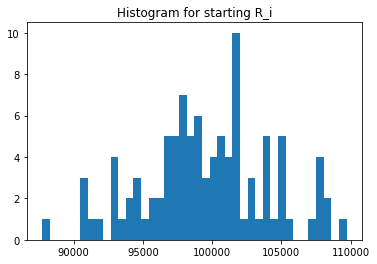

In [22]:
import matplotlib.pyplot as plt
a = starting_Ri.unique()
_ = plt.hist(a, bins=40)  # arguments are passed to np.histogram
plt.title("Histogram for starting R_i")
plt.show()

In [23]:
experiments.UNI_Qi.unique()

array([205026.15838291, 334029.55696897, 333029.55696897, ...,
       215721.412781  , 216721.412781  , 217721.412781  ])

In [24]:
experiments.UNI_Si.unique()

array([10000., 15180., 15310., 15278., 14935., 14899., 15098., 15435.,
       15038., 14908., 15053., 14744., 15074., 15258., 15322., 15184.,
       15082., 15185., 15173., 15483., 14754., 15734., 15478., 15095.,
       15182., 15216., 14920., 15277., 15365., 15638., 15035., 15129.,
       15040., 15003., 15121., 15079., 15283., 15316., 15168., 15229.,
       15394., 15556., 14919., 15455., 14890., 15265., 15070., 14838.,
       15465., 14729., 15236., 15485., 15039., 15252., 15385., 15696.,
       15275., 15323., 15054., 14736., 14973., 14790., 15326., 15085.,
       14868., 15306., 15273., 15004., 15186., 15893., 14761., 14936.,
       15019., 15211., 15077., 15135., 14709., 15133., 14802., 15342.,
       15066., 15100., 15523., 15597., 15476., 15368., 15537., 14961.,
       15280., 15712., 15704., 15231., 15107., 15349., 15233., 15288.,
       15118., 15112., 15608., 15506., 15958., 14845., 15340., 15298.,
       14913., 14751., 15420., 14854., 14852., 14990., 15296., 15030.,
      

In [25]:
experiments.UNI_Qj.unique()

array([186343.73391167, 240791.876189  , 239791.876189  , ...,
       239229.61370074, 240229.61370074, 241229.61370074])

In [26]:
experiments.UNI_Rj.unique()

array([93171.86695584, 87145.9380945 , 87507.9380945 , ...,
       73340.80685037, 73036.80685037, 72735.80685037])

In [27]:
starting_Rj = experiments[experiments.timestep == 0]
starting_Rj = starting_Rj['UNI_Rj']
starting_Rj.reset_index(drop=True)
starting_Rj.unique()

array([ 93171.86695584,  97515.57566217, 102395.9380945 ,  95807.31682737,
       104372.20448362,  97209.94026981,  94220.91542352, 100499.18764652,
        96493.42857807,  94830.22166713,  97793.52547021,  92544.11105846,
       109771.47281761, 100343.18845208, 107261.10799307,  93964.97662644,
        95557.59867715, 104011.33182204,  93234.8315986 , 104031.84945424,
       105960.22711168, 111566.92199068, 103335.12804697,  95170.9056478 ,
       103175.76886971, 102975.87383561,  95246.33352613,  92709.88486477,
       101075.54340927, 101495.06244386, 102392.89224575,  92281.73090249,
       101259.54885171, 101143.07354494, 106749.66679158, 103983.98850869,
       103632.18300399,  93614.80685037,  94006.2484466 ,  98889.59447385,
       100926.86210036, 102642.38695564, 101307.07140089, 101167.30410958,
       108052.64221304,  95856.94526681,  96161.77841487,  95509.68609682,
       101475.22332588,  94789.53200103, 102440.15248603, 101746.23127726,
       104148.80135547,  

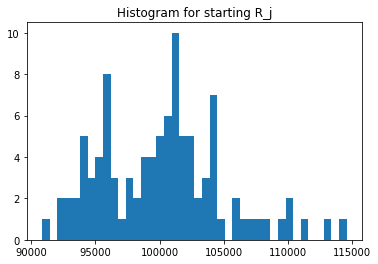

In [28]:
a = starting_Rj.unique()
_ = plt.hist(a, bins=40)  # arguments are passed to np.histogram
plt.title("Histogram for starting R_j")
plt.show()

In [29]:
experiments.UNI_Sj.unique()

array([10000], dtype=int64)

In [30]:
experiments.UNI_ij.unique()

array([102513.07919145,  98466.77848448,  97043.27335419,  98553.01252306,
       101800.46479606, 100486.26323049, 104959.25280134, 101895.05002056,
       101669.05907735,  94410.89003523, 104763.46857136, 102597.90769785,
        99932.57873647, 109697.46842654,  95893.24101737,  97038.09499273,
        98878.1631456 ,  99076.57452013, 100338.00021993,  98376.04253656,
        90545.61599107,  93128.21875062,  96552.74514085, 107598.51912228,
        94621.8066266 , 100555.8056843 ,  98908.32856475, 104995.44809824,
        97316.44990982,  97634.06196207,  97724.53202172, 105286.79281704,
        94851.98731243, 104680.38172341,  91567.2063905 , 101731.84459587,
        99423.78601802, 101632.59194111, 103758.95504834,  97443.51230388,
       100988.54597121, 100859.98339642,  97523.95035638,  96040.57295324,
        96466.94784422, 105424.31550476,  98506.68343208,  92878.31799834,
       103103.66221462, 107664.3768275 ,  97387.58207516,  94081.93986744,
       104195.7937909 , 1

In [31]:
experiments.UNI_ji.unique()

array([ 93171.86695584, 102395.9380945 , 100499.18764652,  97515.57566217,
        95807.31682737,  97793.52547021, 104372.20448362,  97209.94026981,
        94220.91542352,  95170.9056478 ,  96493.42857807,  92709.88486477,
        94830.22166713, 100343.18845208, 109771.47281761,  92544.11105846,
        95557.59867715, 104011.33182204, 107261.10799307,  93964.97662644,
       114559.43301381,  93234.8315986 , 101075.54340927, 104031.84945424,
       105960.22711168, 111566.92199068, 103175.76886971, 103335.12804697,
       102975.87383561,  95246.33352613,  94006.2484466 , 101475.22332588,
       102394.70760902, 102392.89224575, 101495.06244386, 102642.38695564,
        92281.73090249, 101259.54885171, 101143.07354494, 102440.15248603,
        94034.8428942 , 106749.66679158, 103632.18300399,  98889.59447385,
       103983.98850869,  93614.80685037, 100926.86210036, 101307.07140089,
       101167.30410958,  94789.53200103,  95856.94526681, 108052.64221304,
        95509.68609682,  

In [32]:
experiments.UNI_Sij.unique()

array([9.55133498e+09, 1.00825982e+10, 9.75277014e+09, 9.61045375e+09,
       9.75322938e+09, 9.82690594e+09, 1.09548286e+10, 9.90521173e+09,
       9.57935182e+09, 8.98516991e+09, 1.01089863e+10, 9.51184021e+09,
       9.47662859e+09, 1.10073937e+10, 1.05263423e+10, 8.98030424e+09,
       9.44855983e+09, 1.03050865e+10, 1.07623651e+10, 9.24390254e+09,
       1.03728544e+10, 8.68279379e+09, 9.75912118e+09, 1.11936729e+10,
       1.00261481e+10, 1.12187017e+10, 1.02049428e+10, 1.08497181e+10,
       1.00212465e+10, 9.29928643e+09, 9.18671664e+09, 1.06840008e+10,
       9.71234151e+09, 1.07185270e+10, 9.29361933e+09, 1.04419994e+10,
       9.17499907e+09, 1.02912704e+10, 1.04944996e+10, 9.98212826e+09,
       9.49644205e+09, 1.07667696e+10, 1.01066199e+10, 9.49741331e+09,
       1.00310180e+10, 9.86927693e+09, 9.94197045e+09, 9.40923039e+09,
       1.04307196e+10, 1.02054559e+10, 9.33527612e+09, 1.01658022e+10,
       9.95170756e+09, 9.71706418e+09, 9.98071364e+09, 9.74610495e+09,
      

In [33]:
def get_M(k, v):
    if k == 'sim_config':
        k, v = 'M', v['M']
    return k, v

config_ids = [
    dict(
        get_M(k, v) for k, v in config.__dict__.items() if k in ['simulation_id', 'run_id', 'sim_config', 'subset_id']
    ) for config in configs
]

# Agent sequences

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4459: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


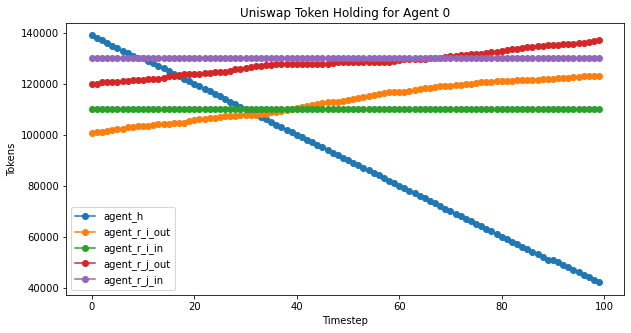

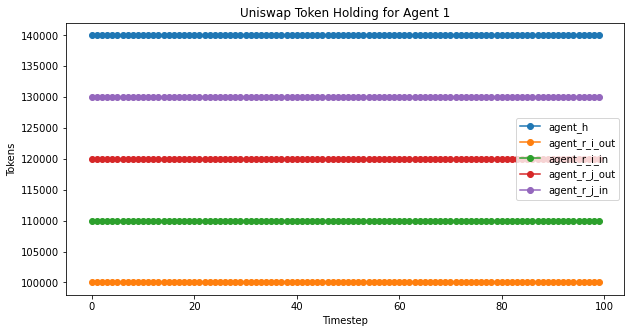

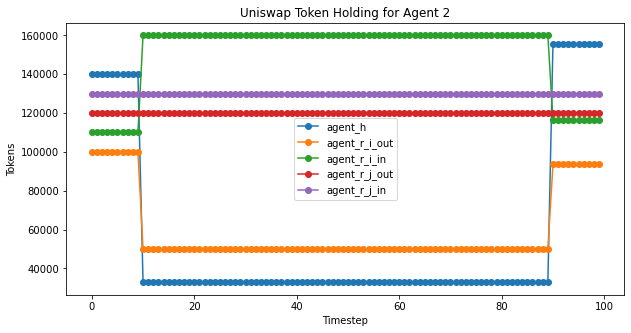

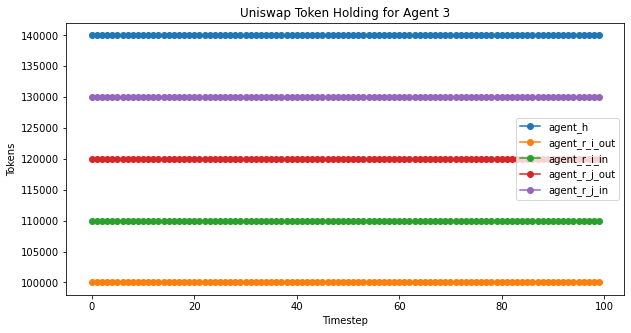

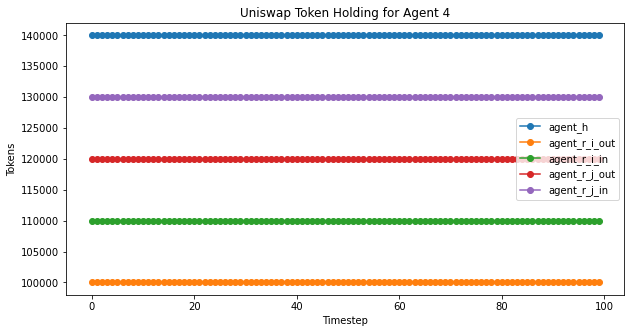

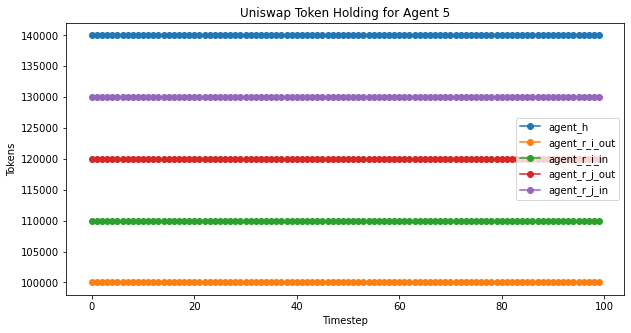

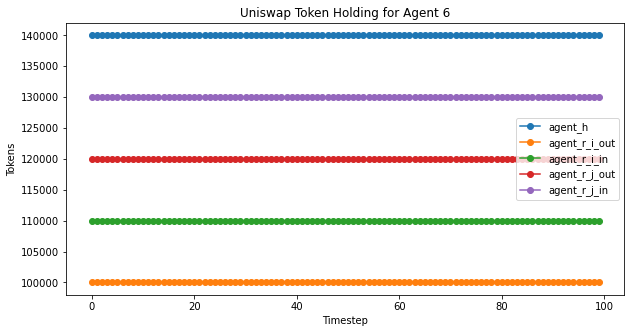

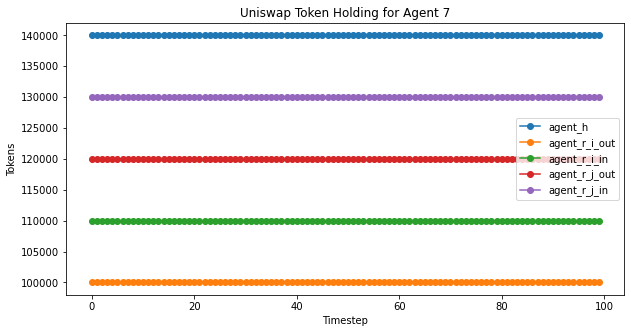

In [34]:
agent_plot(experiment2,'Uniswap Token Holding for Agent ', 100) #,4,'j')

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4459: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


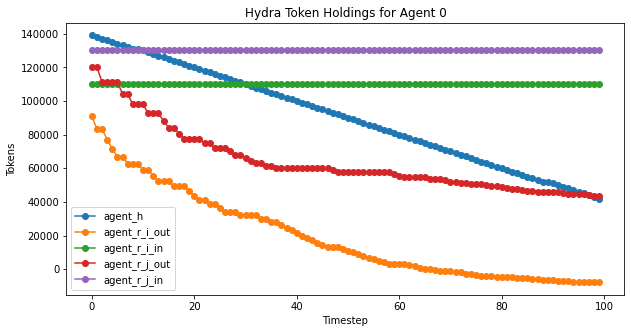

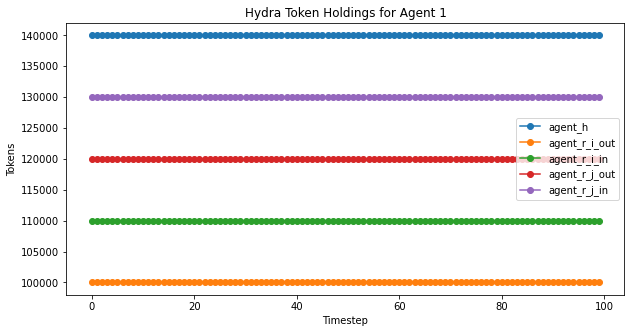

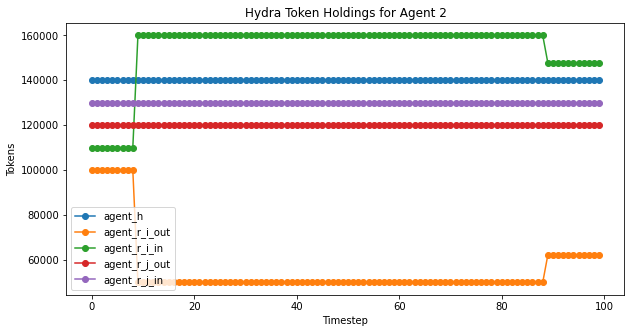

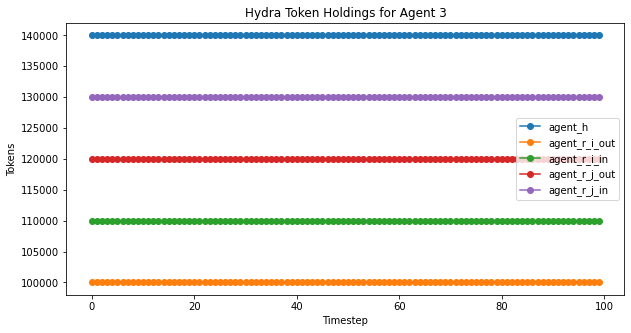

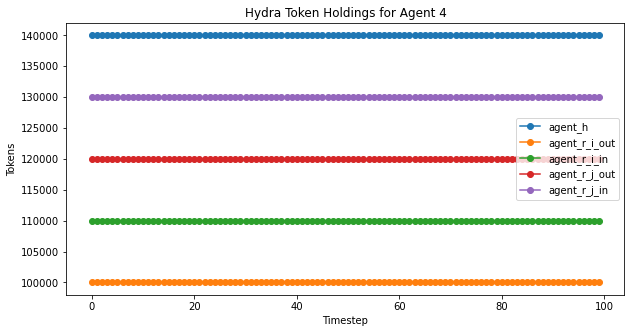

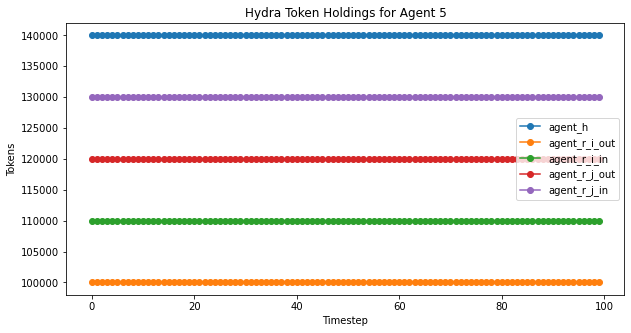

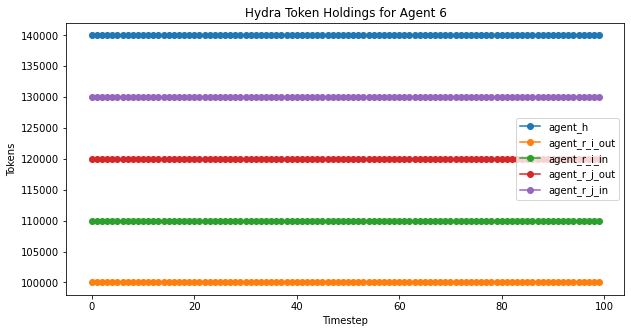

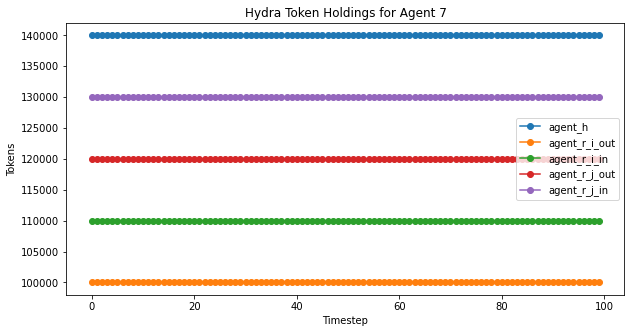

In [35]:
hydra_agent_plot(experiment2,'Hydra Token Holdings for Agent ', 100)

# Liquidity dynamics

Movement of the Uniswap variables

- 'UNI_Ri', 'UNI_Qi', 'UNI_Si'
- 'UNI_Rj', 'UNI_Qj', 'UNI_Sj'
- 'UNI_ij', 'UNI_ji', 'UNI_Sij'

## Uniswap -- Ri-Q instance

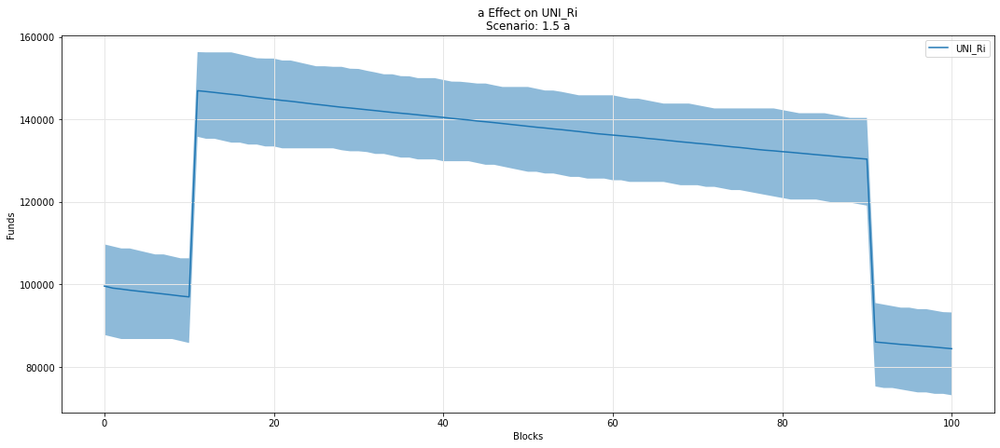

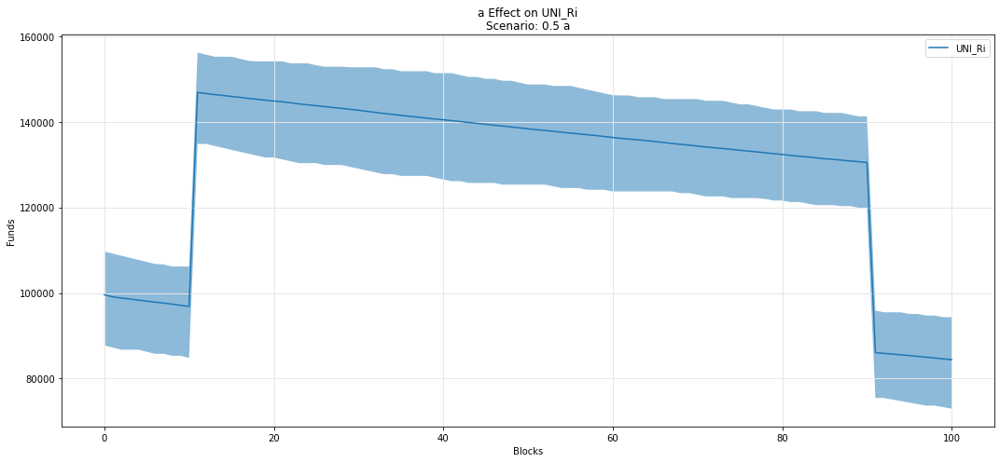

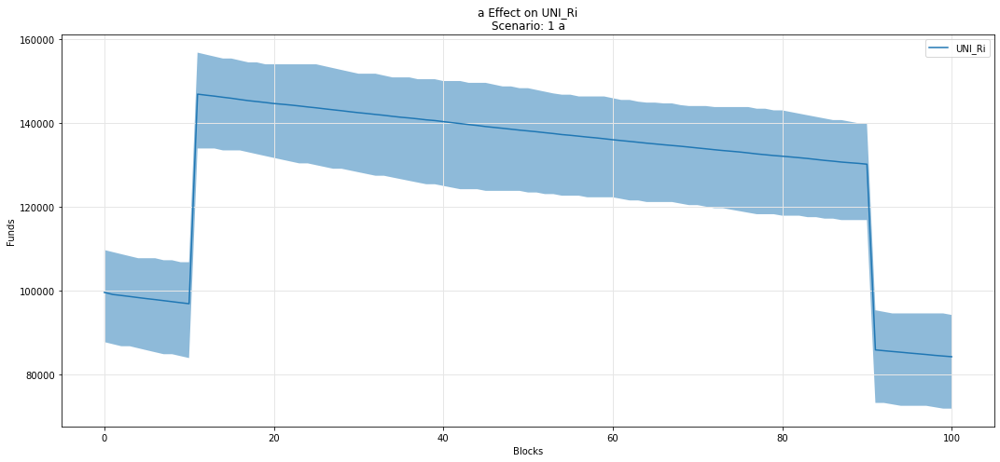

In [36]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Ri')

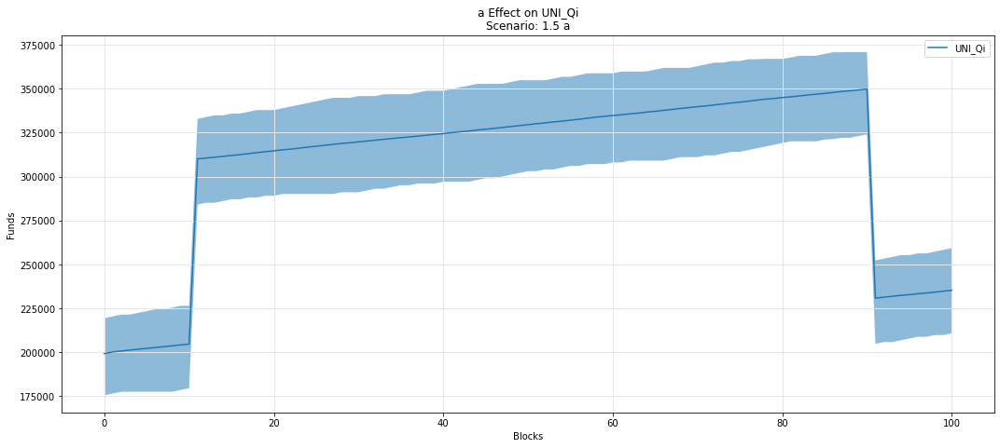

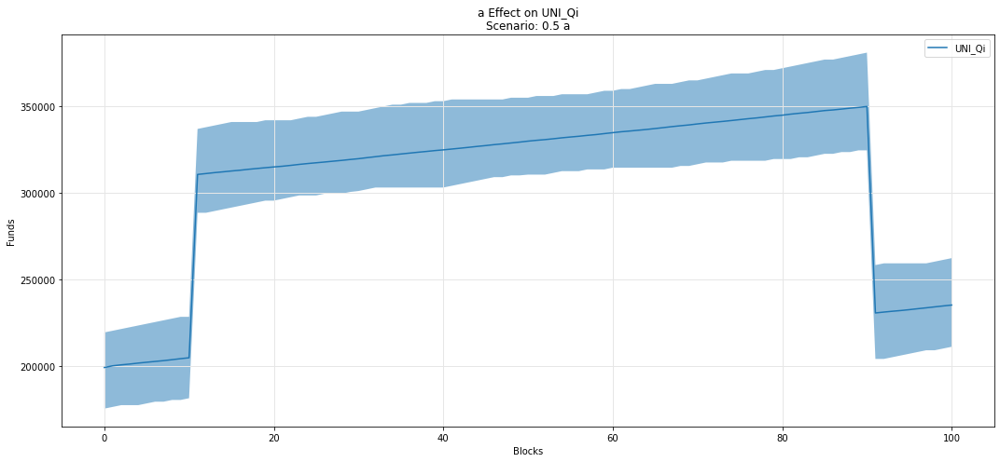

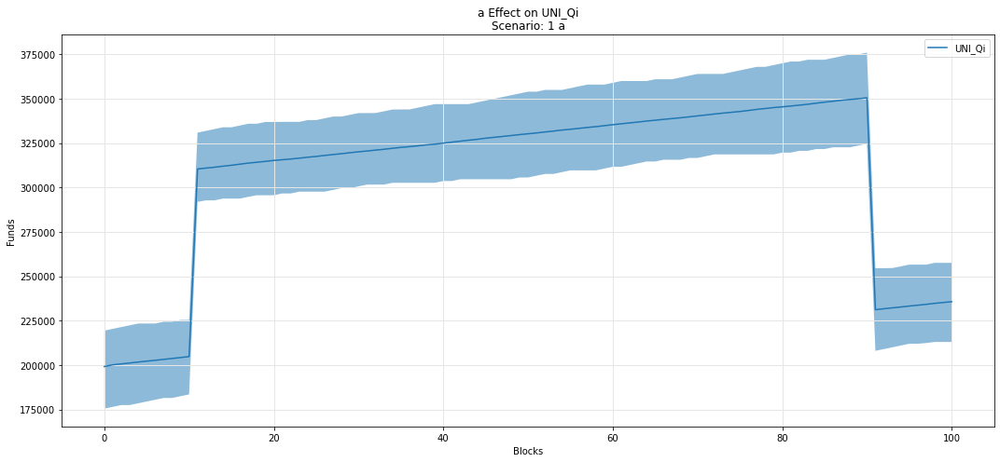

In [37]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Qi')

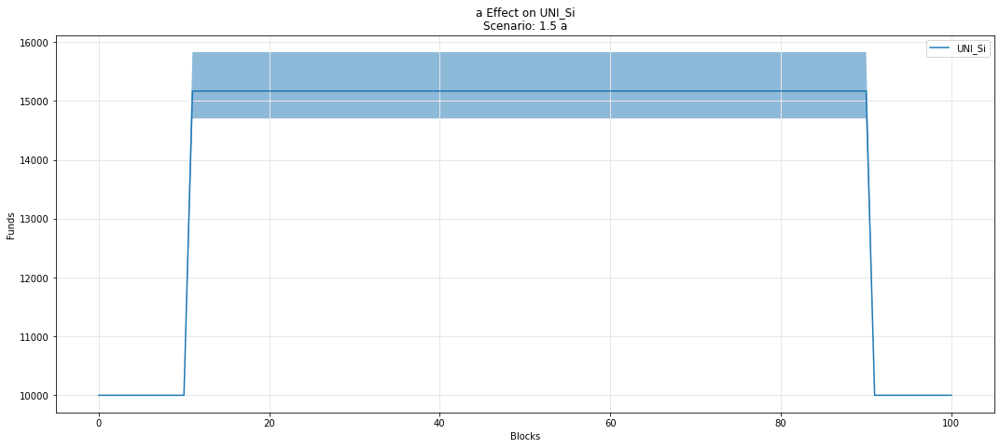

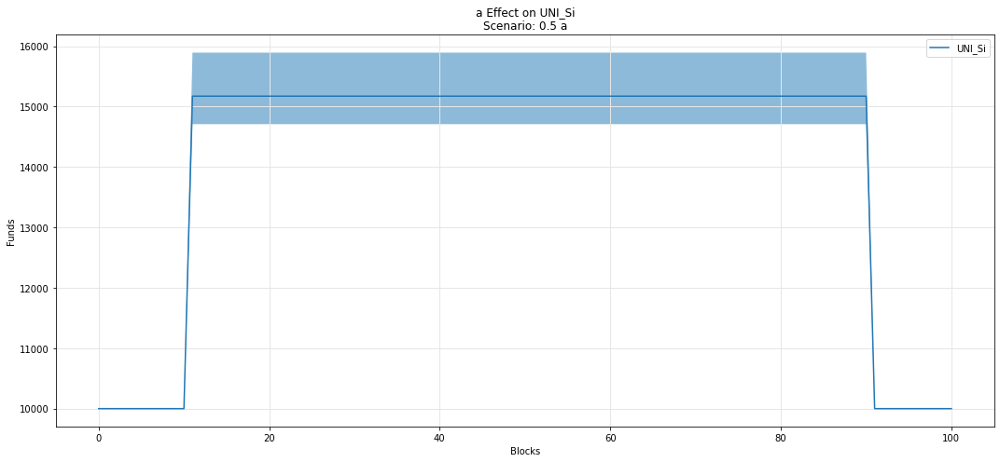

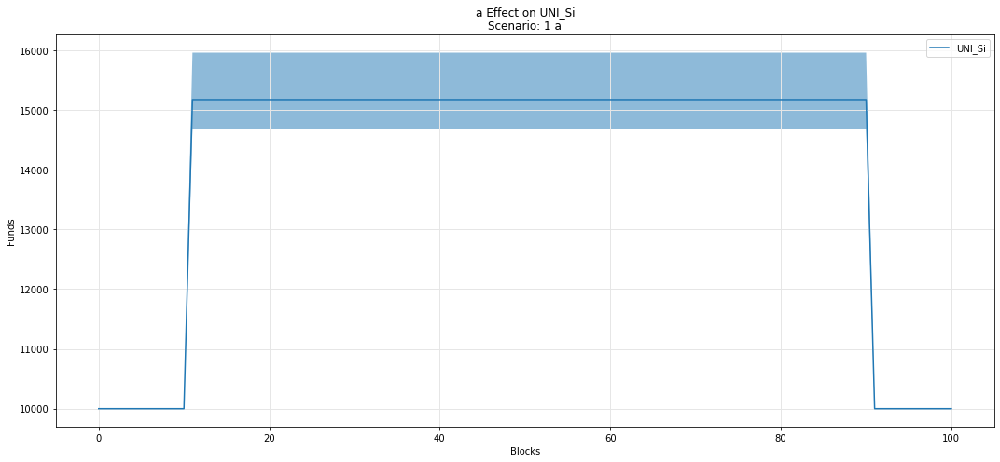

In [38]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Si')

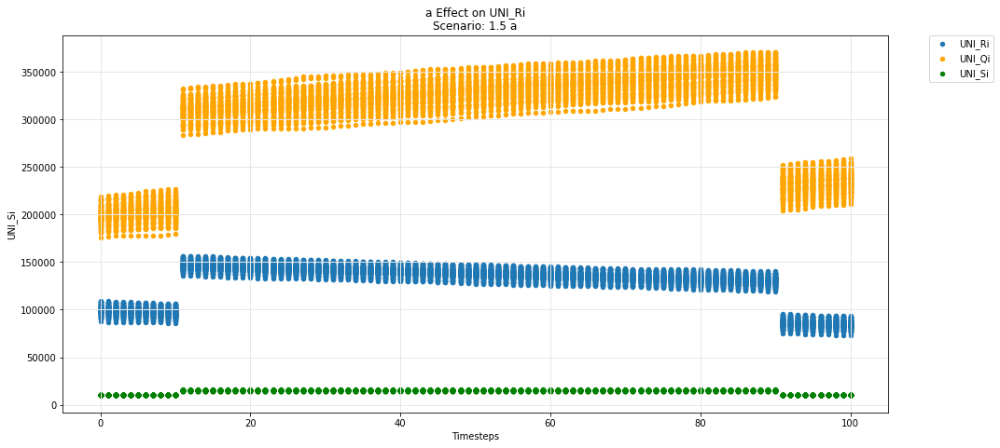

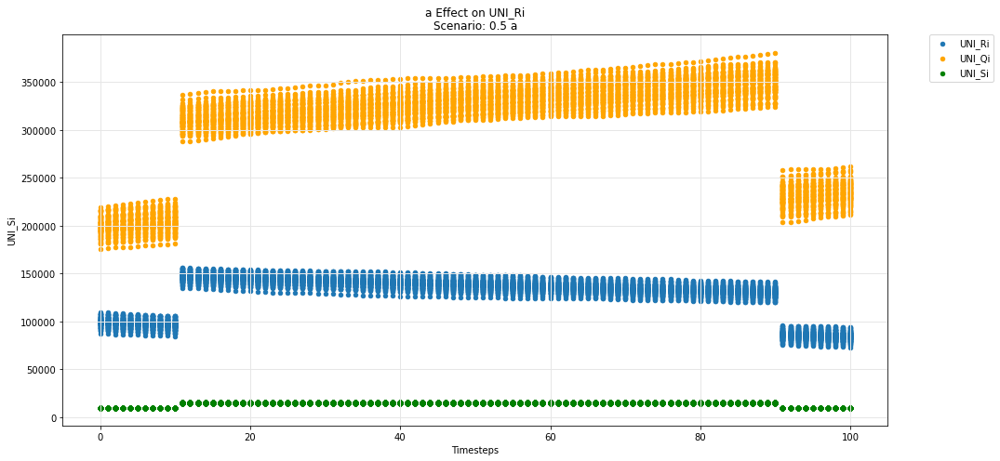

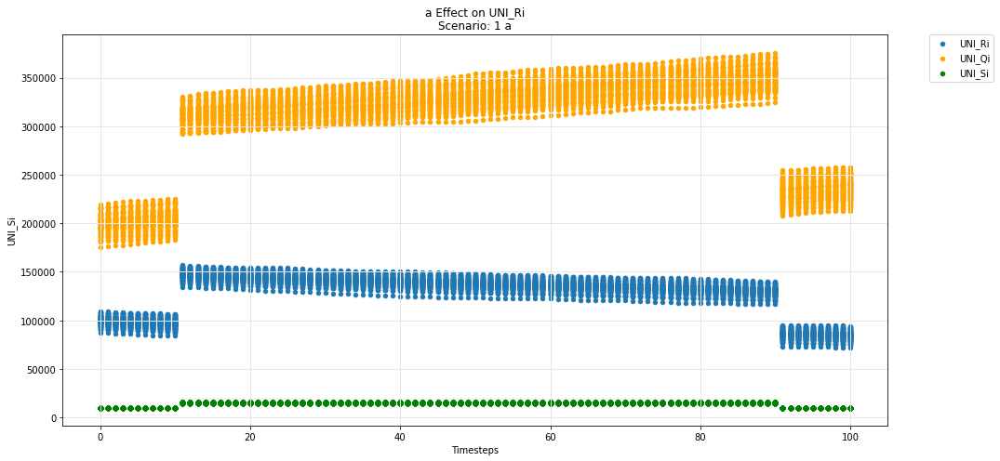

In [39]:
param_test_plot(experiments, config_ids, 'a', 'UNI_Ri', 'UNI_Qi', 'UNI_Si')

## Uniswap -- Rj-Q instance

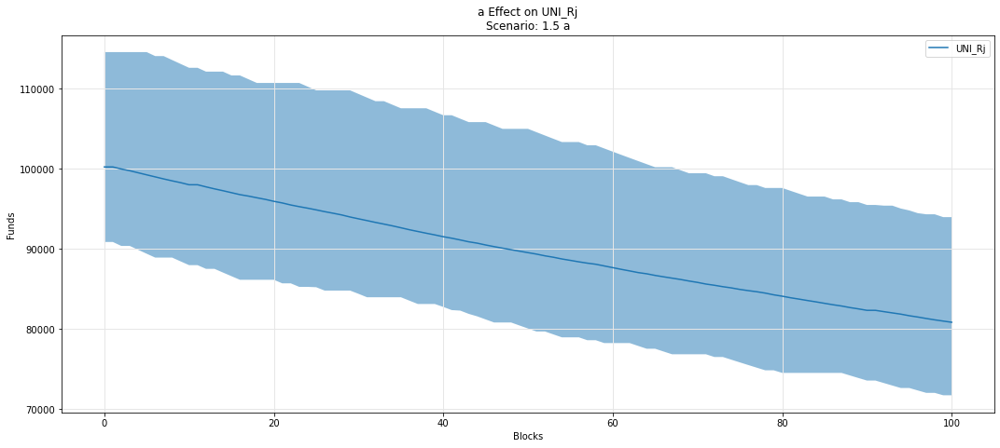

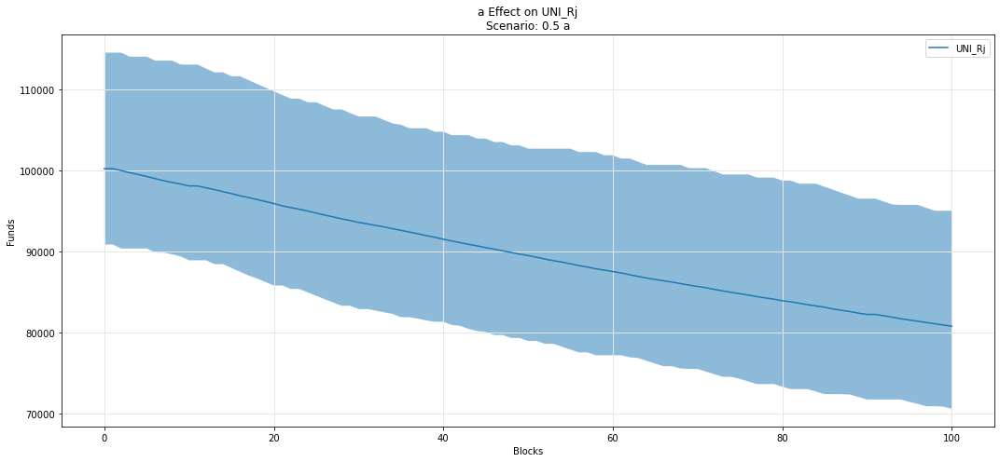

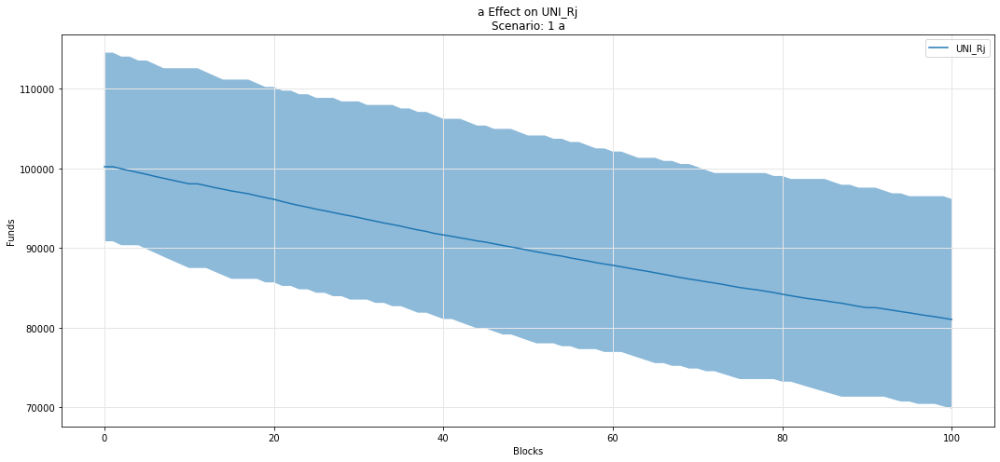

In [40]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Rj')

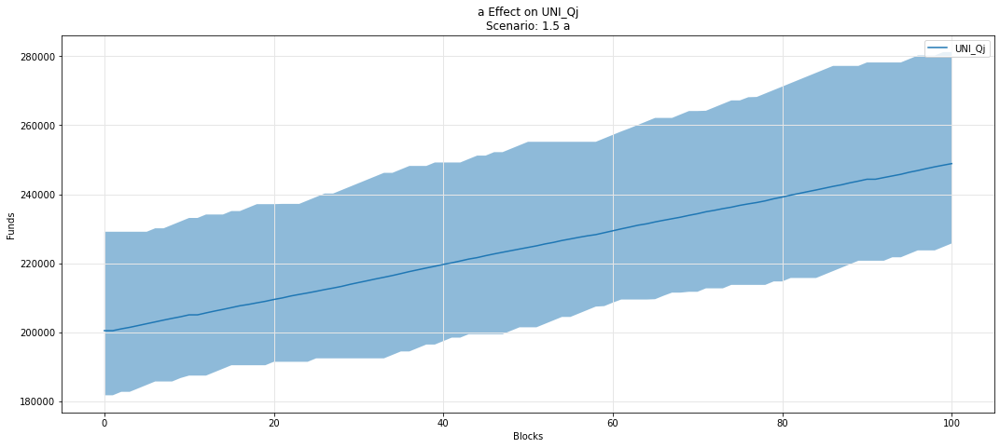

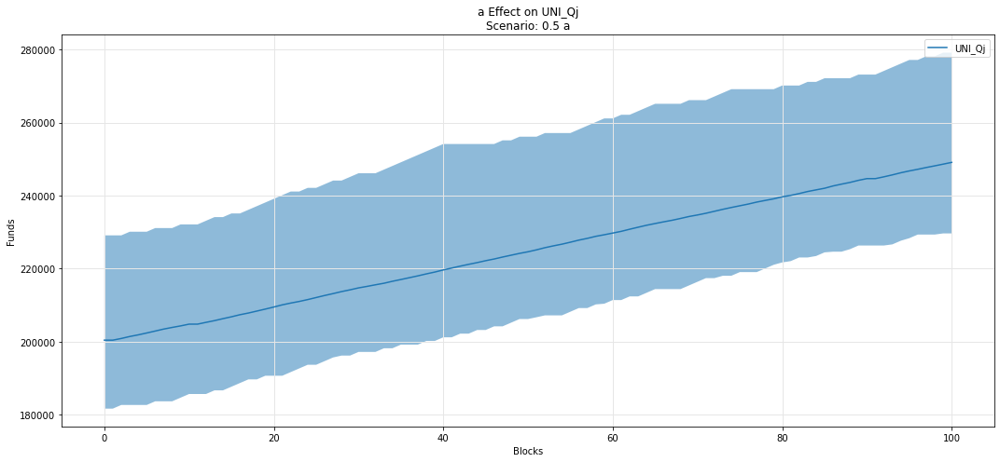

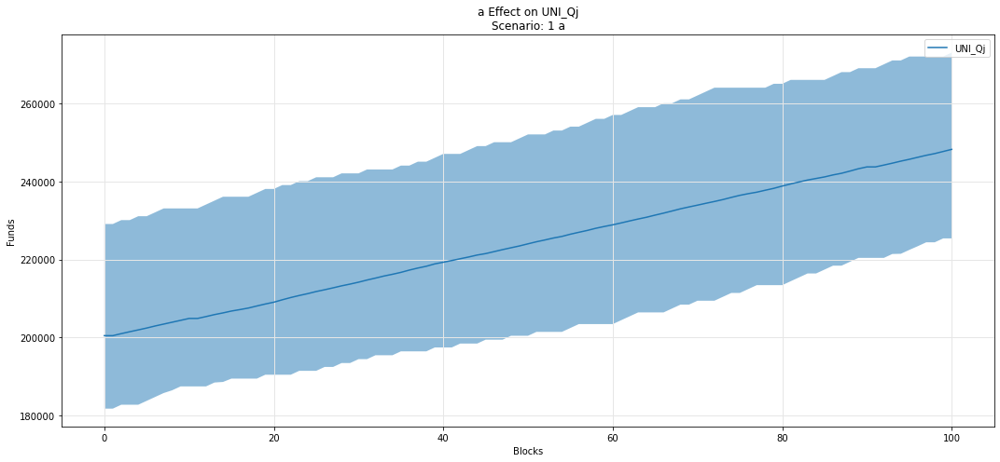

In [41]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Qj')

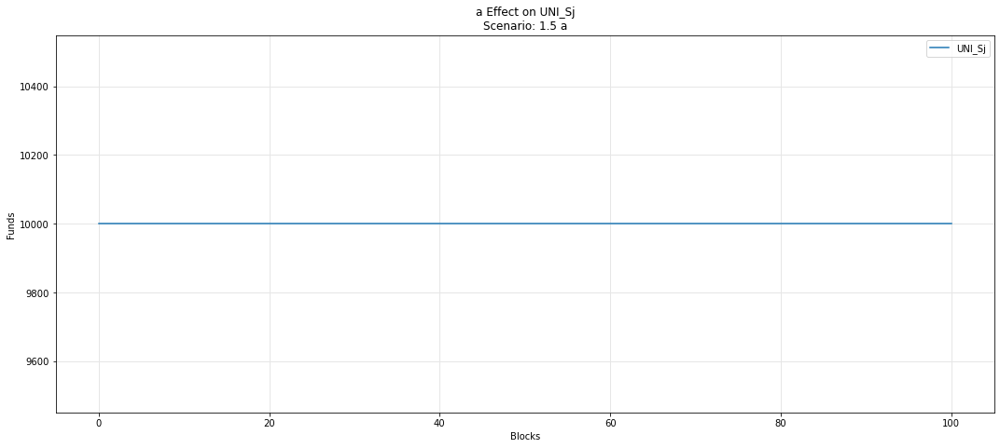

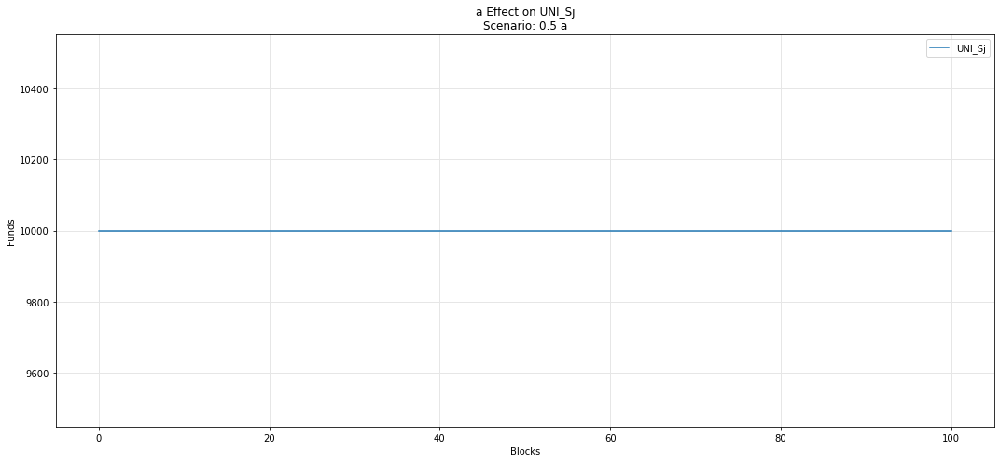

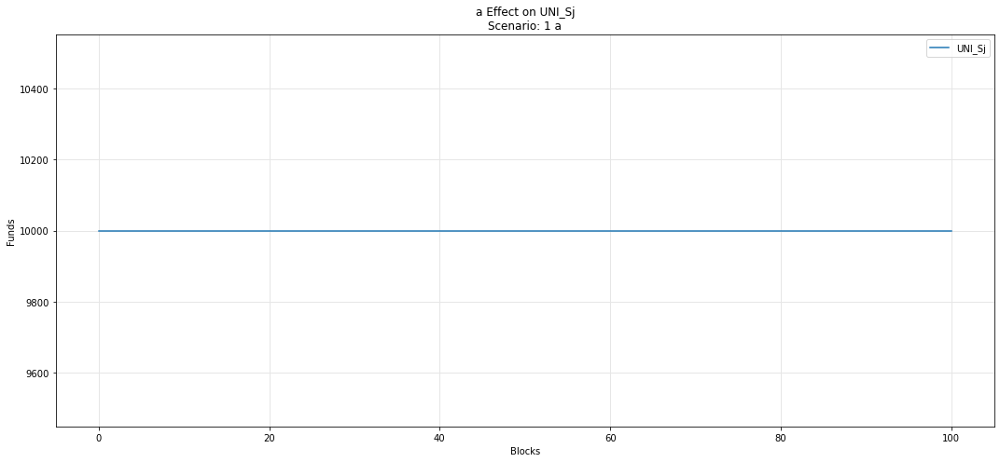

In [42]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Sj')

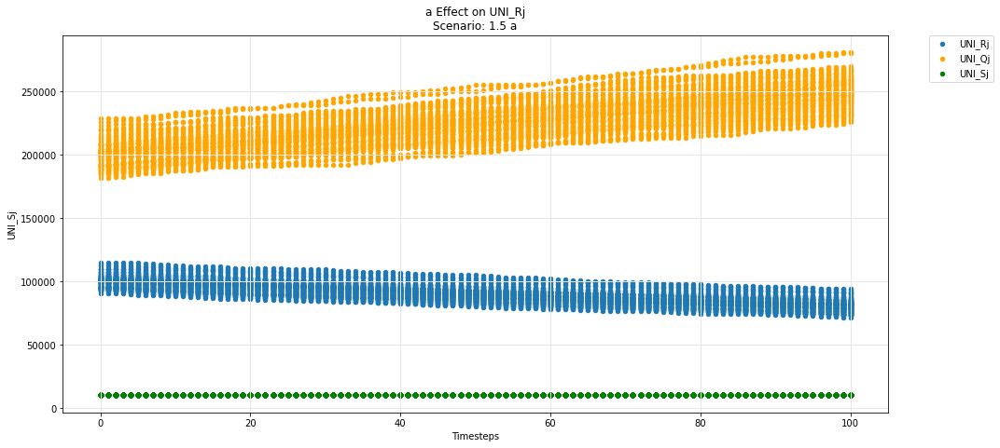

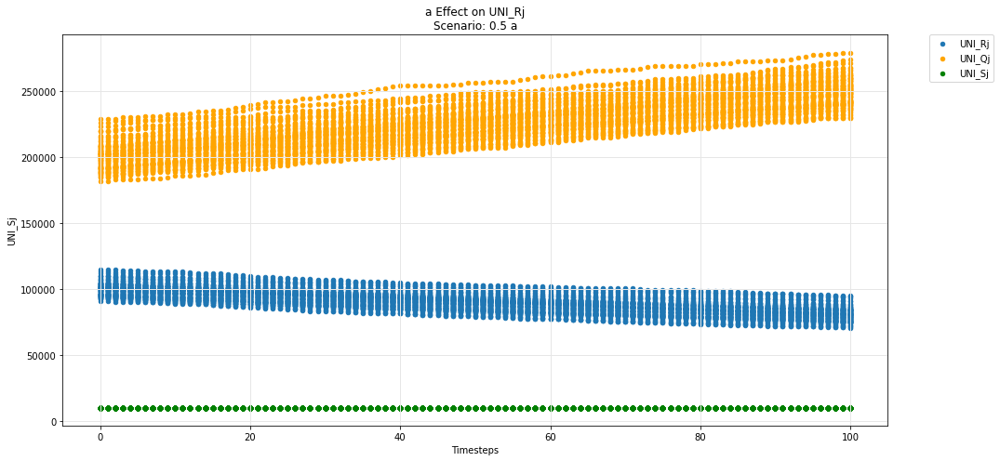

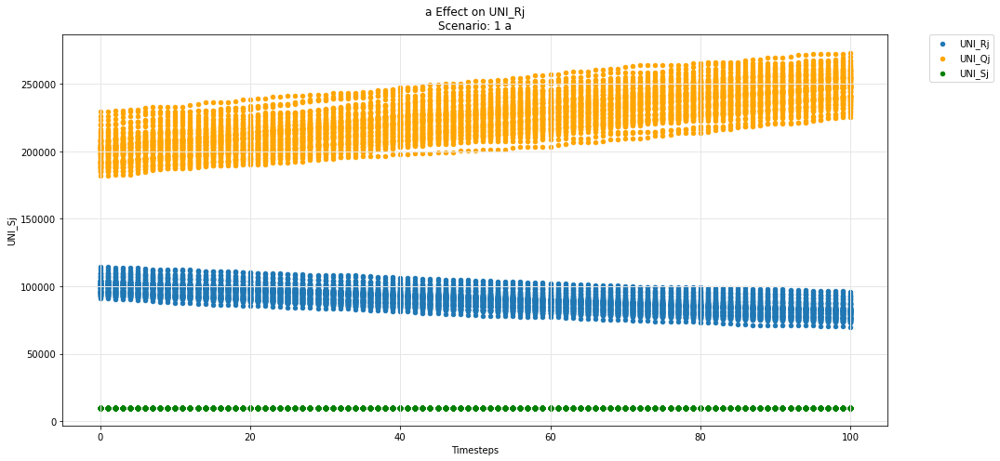

In [43]:
param_test_plot(experiments, config_ids, 'a', 'UNI_Rj', 'UNI_Qj', 'UNI_Sj')

## Uniswap -- ij-Q instance

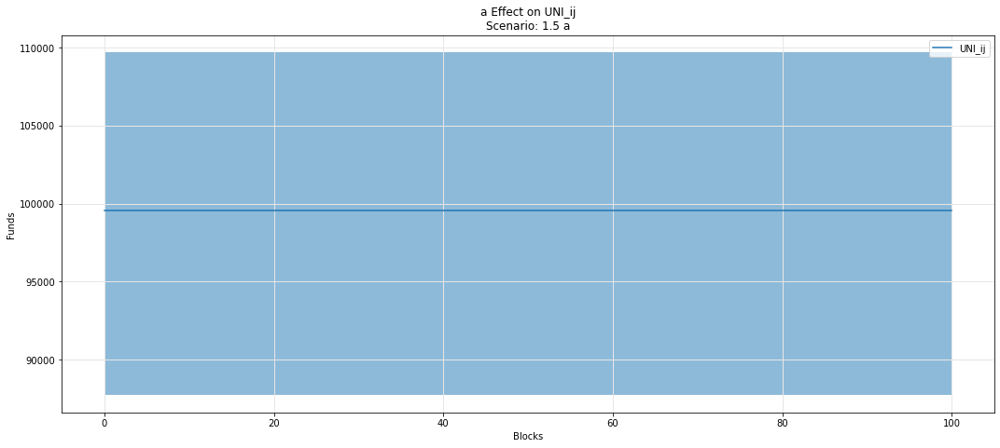

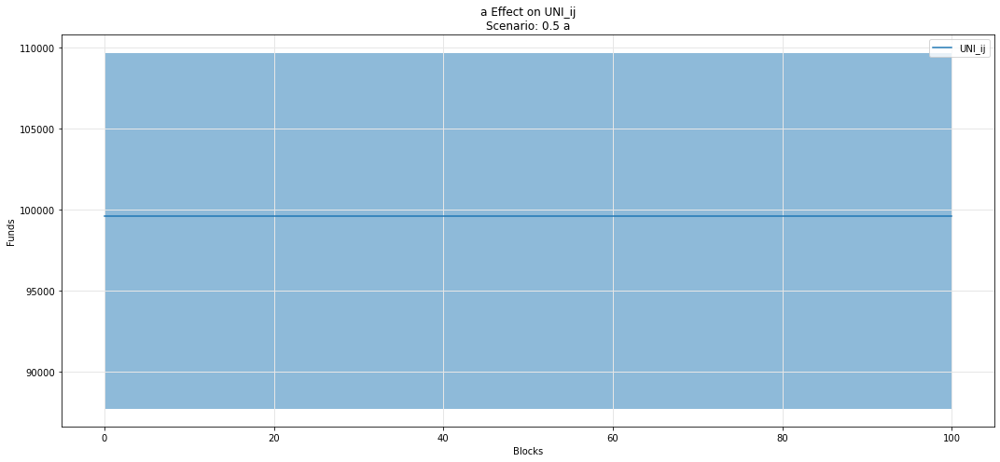

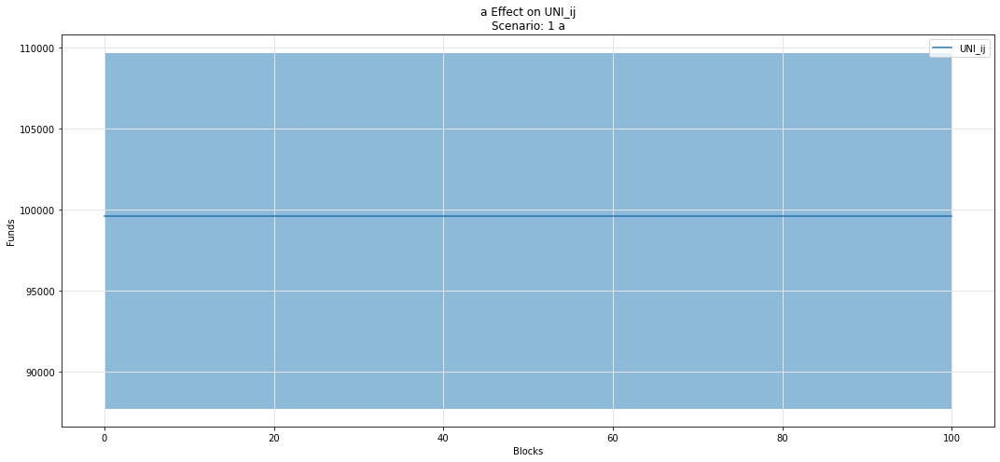

In [44]:
param_fan_plot3(experiments, config_ids, 'a','UNI_ij')

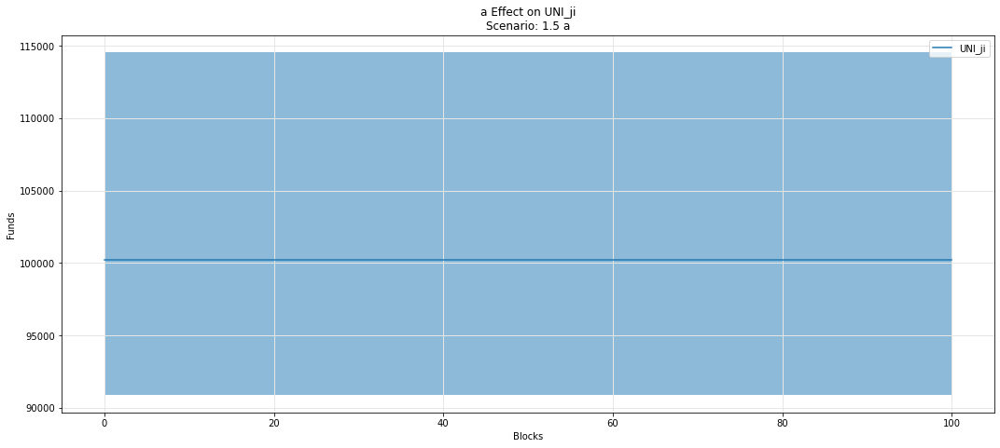

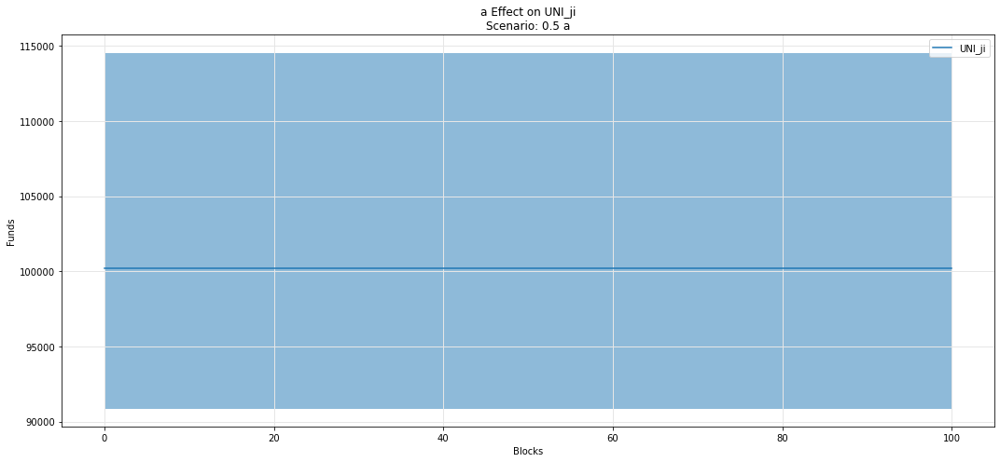

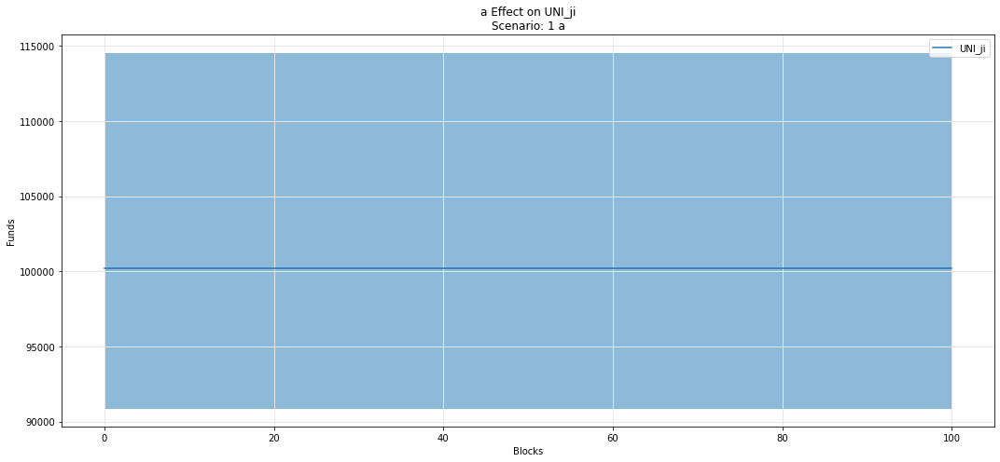

In [45]:
param_fan_plot3(experiments, config_ids, 'a','UNI_ji')

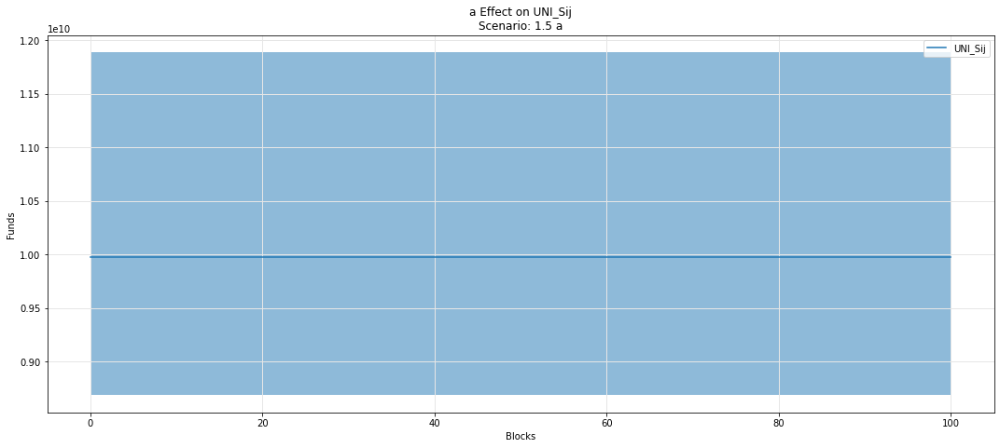

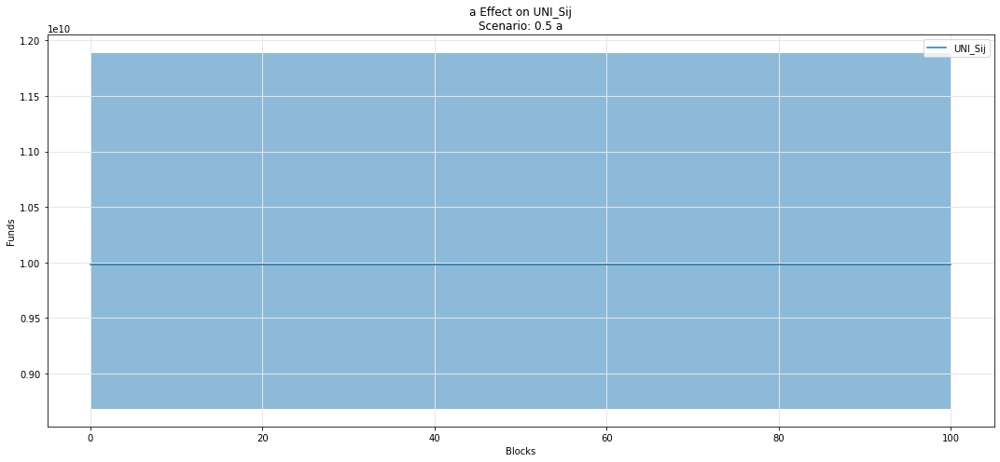

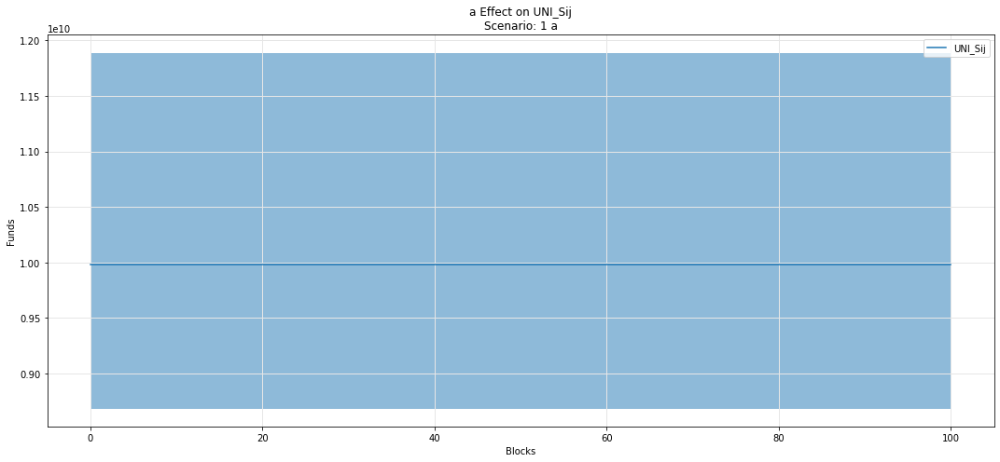

In [46]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Sij')

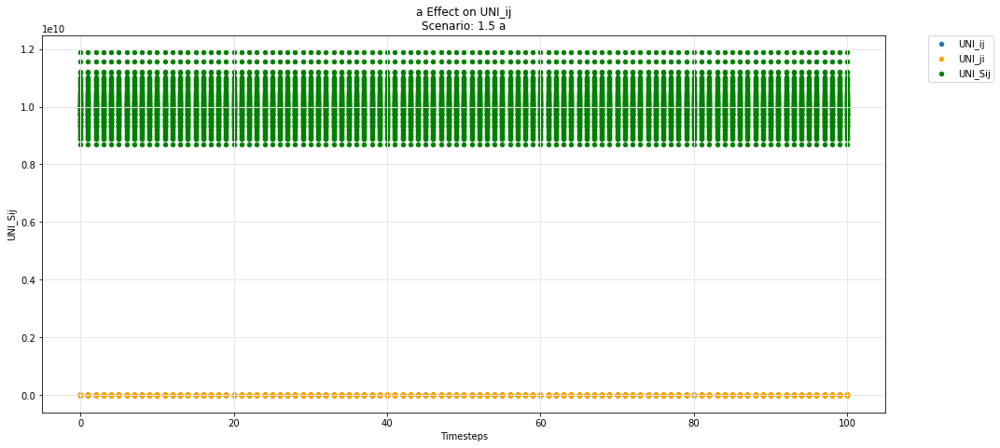

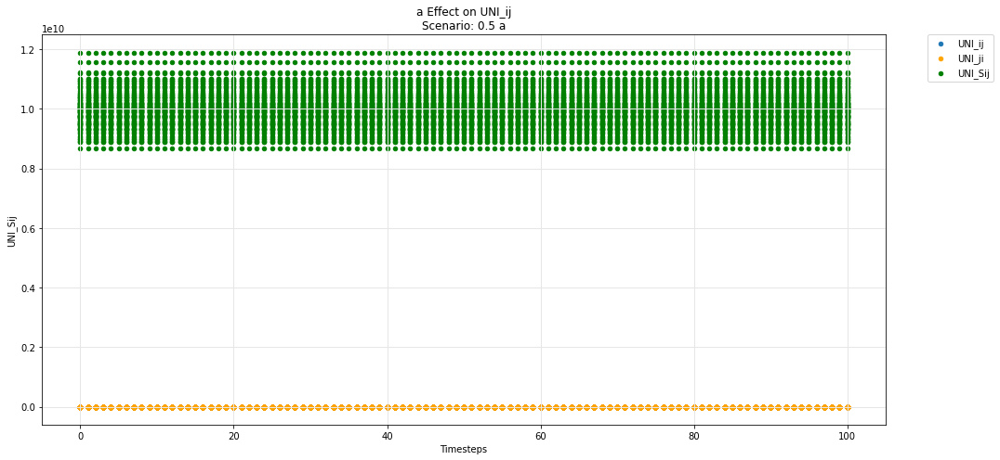

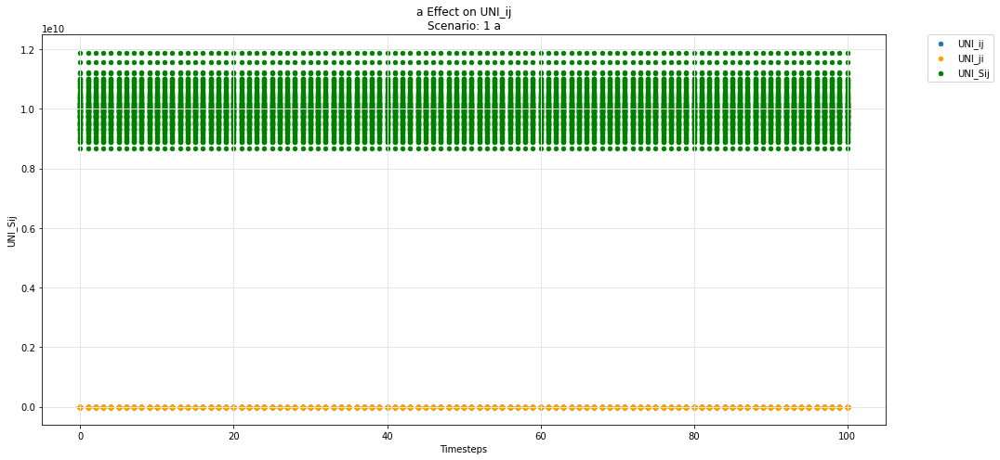

In [47]:
param_test_plot(experiments, config_ids, 'a', 'UNI_ij', 'UNI_ji', 'UNI_Sij')

## Hydra -- base

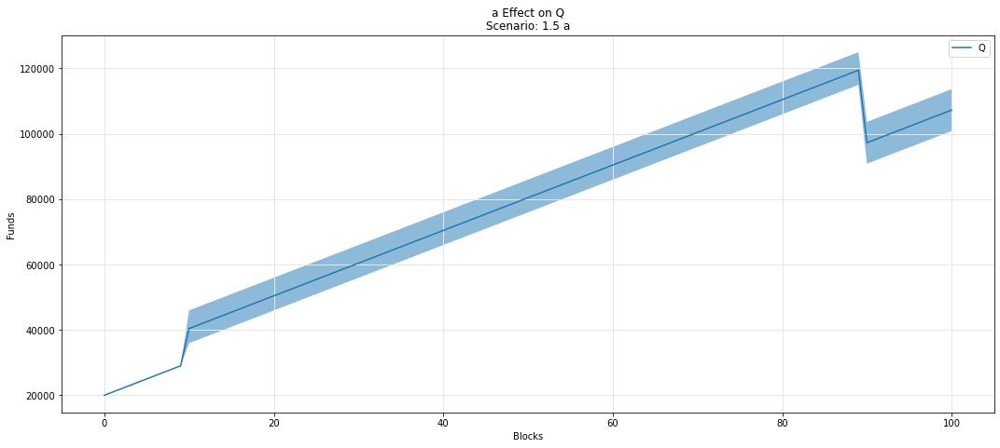

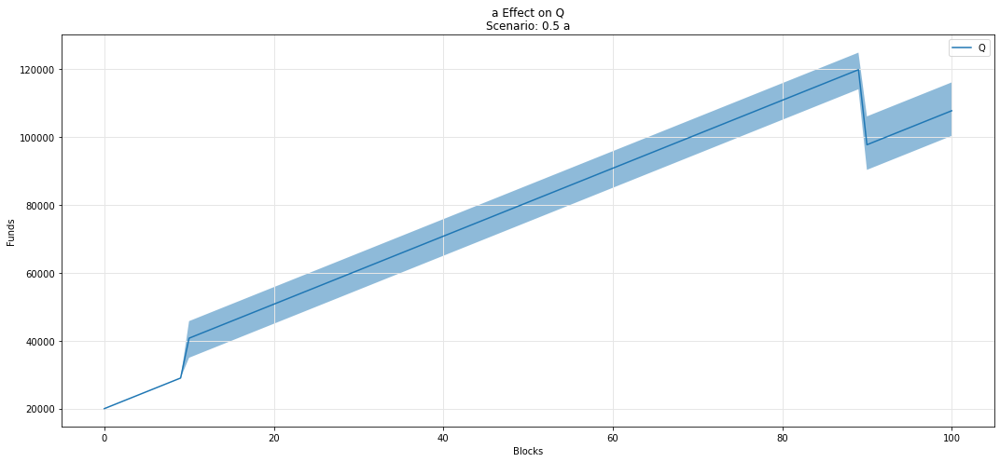

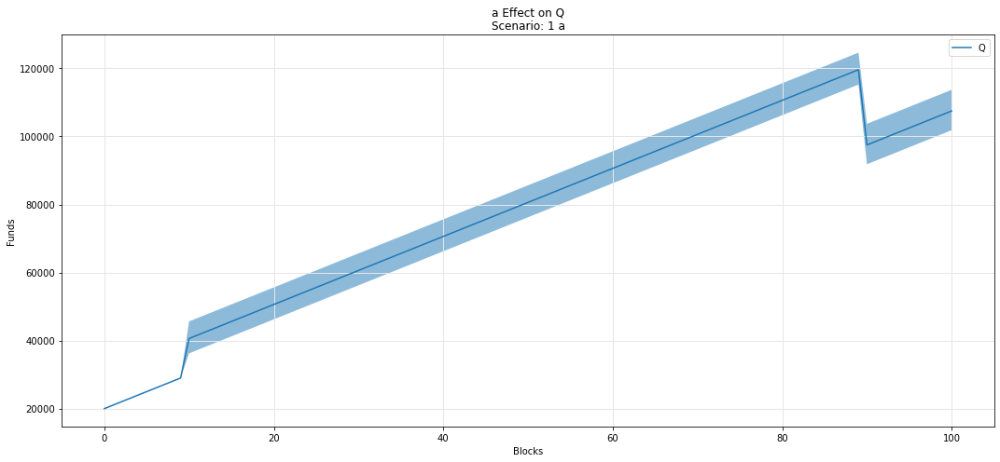

In [48]:
param_fan_plot3(experiments, config_ids, 'a','Q')

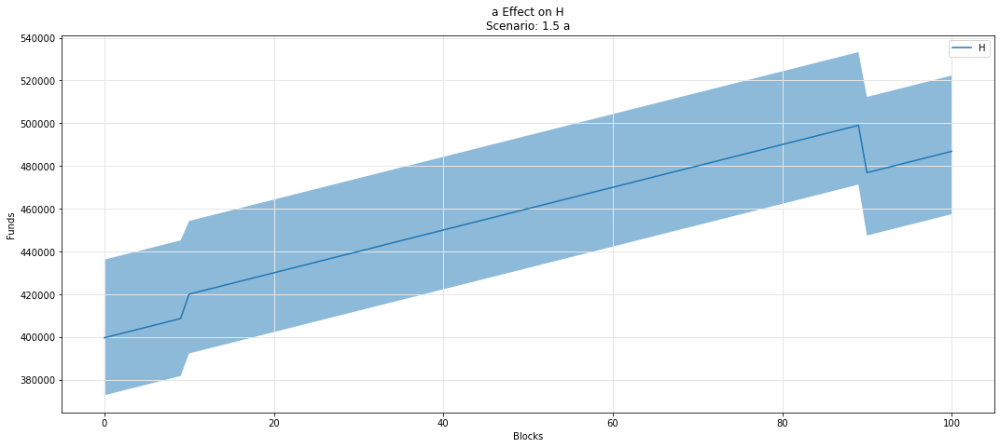

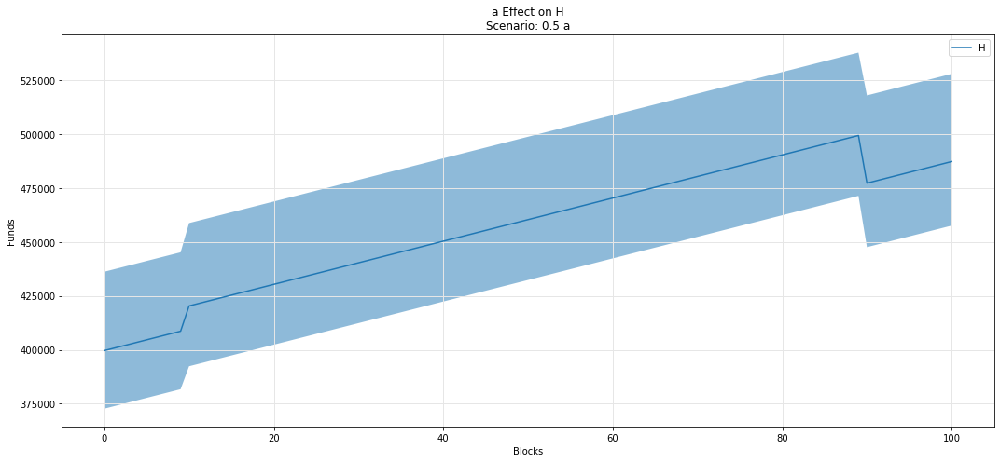

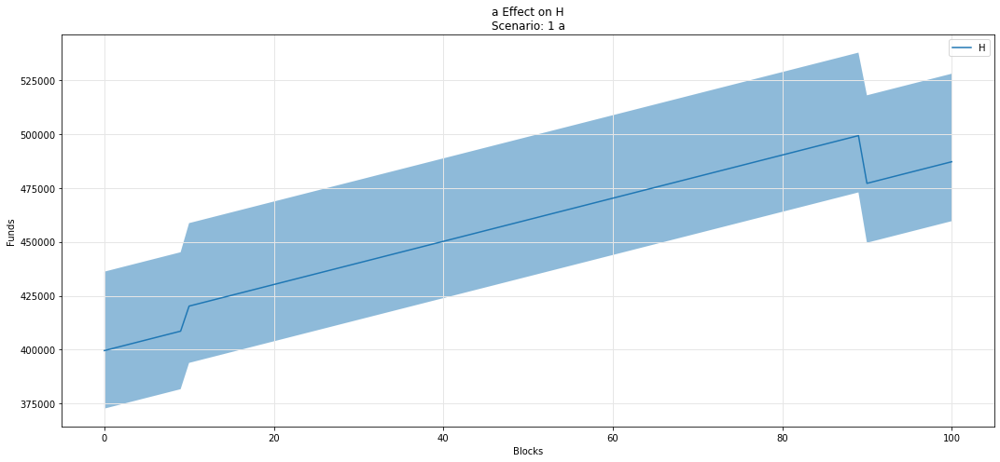

In [49]:
param_fan_plot3(experiments, config_ids, 'a','H')

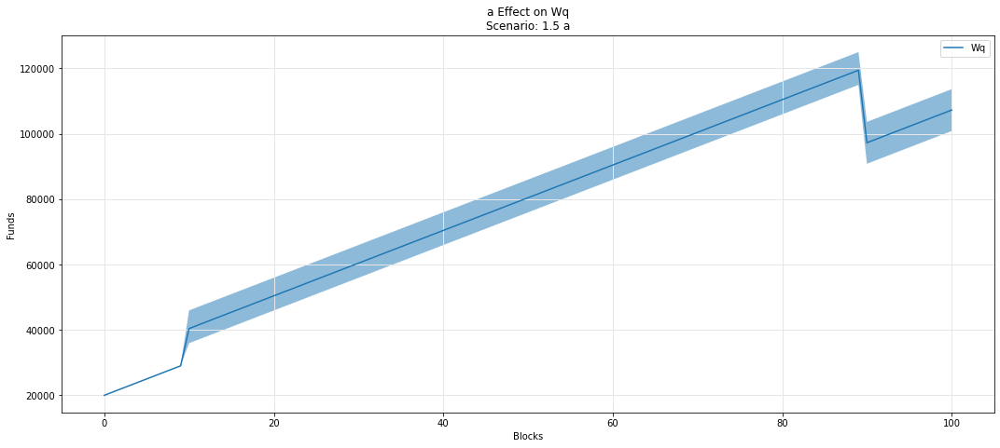

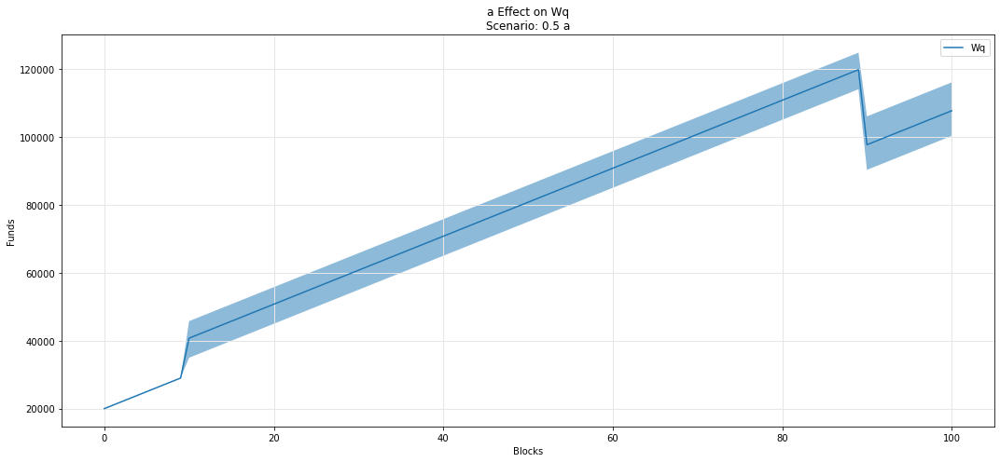

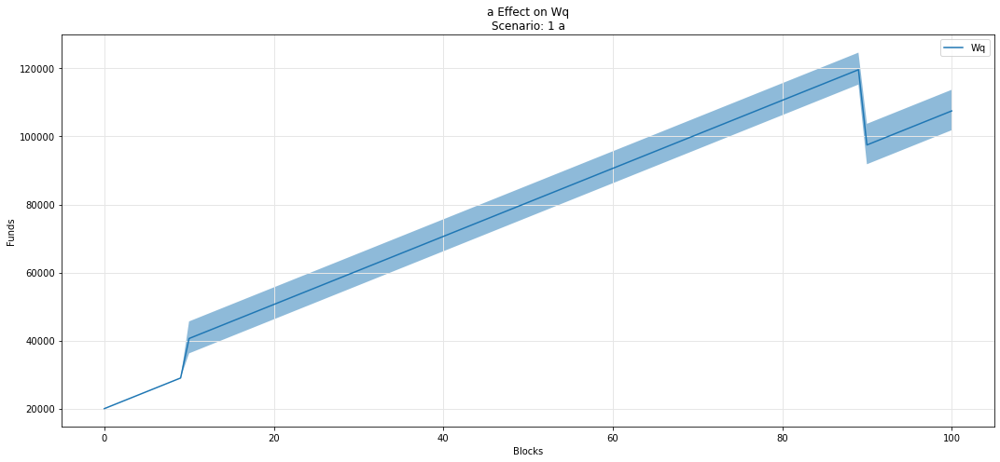

In [50]:
param_fan_plot3(experiments, config_ids, 'a','Wq')

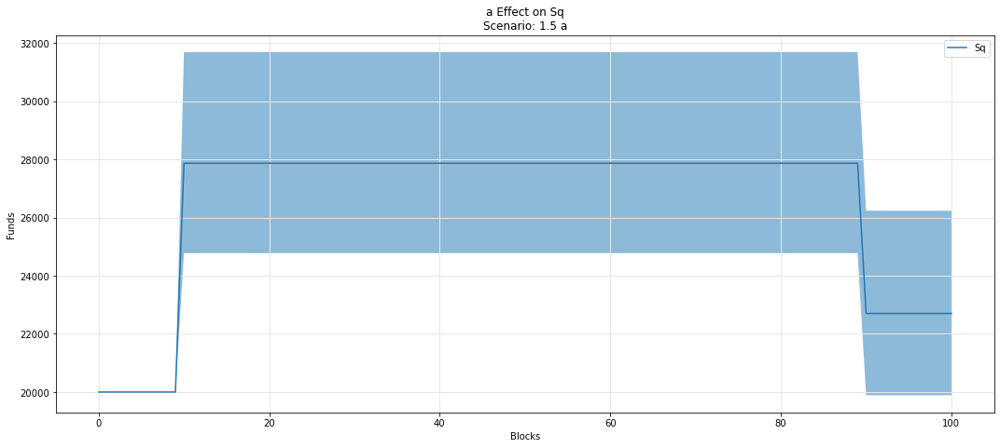

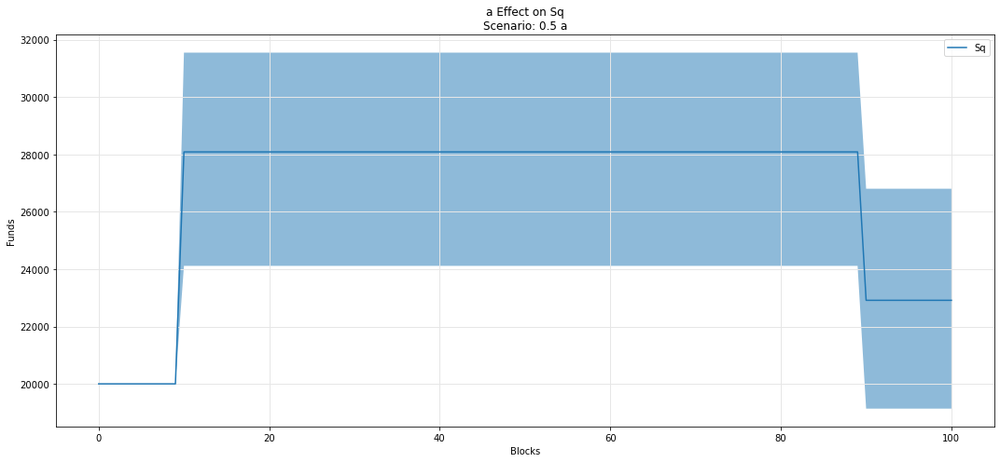

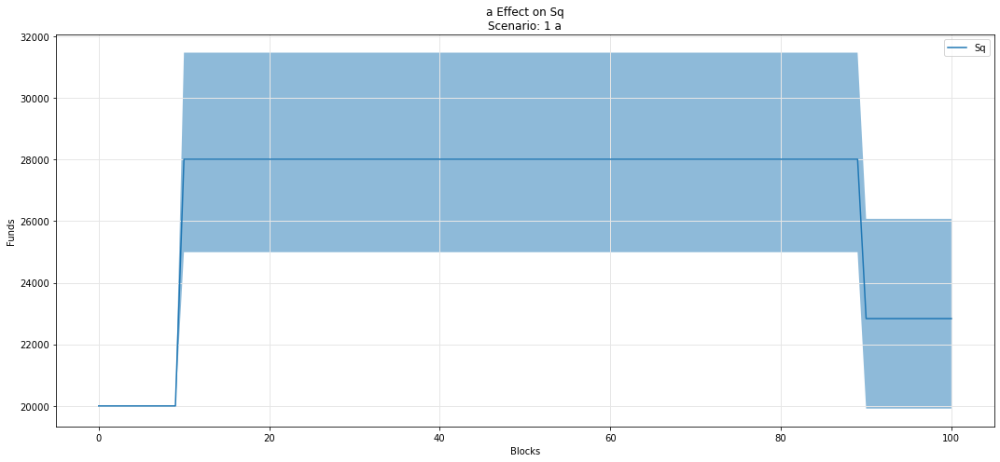

In [51]:
param_fan_plot3(experiments, config_ids, 'a','Sq')

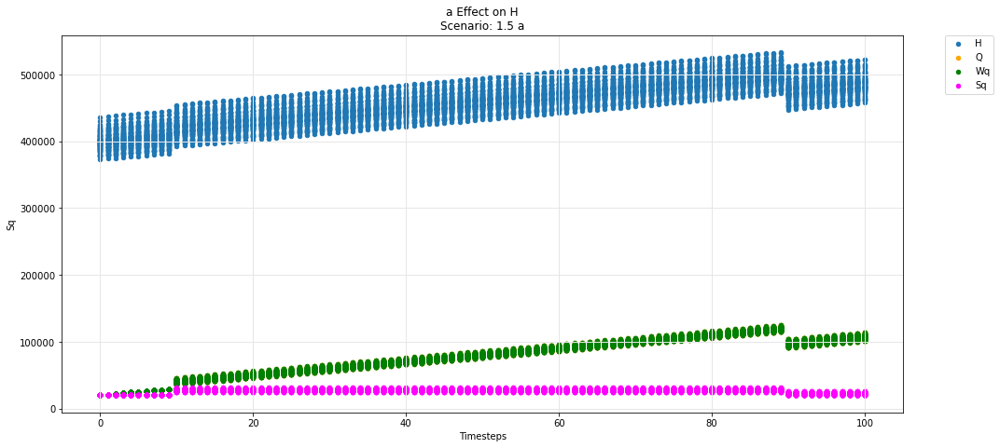

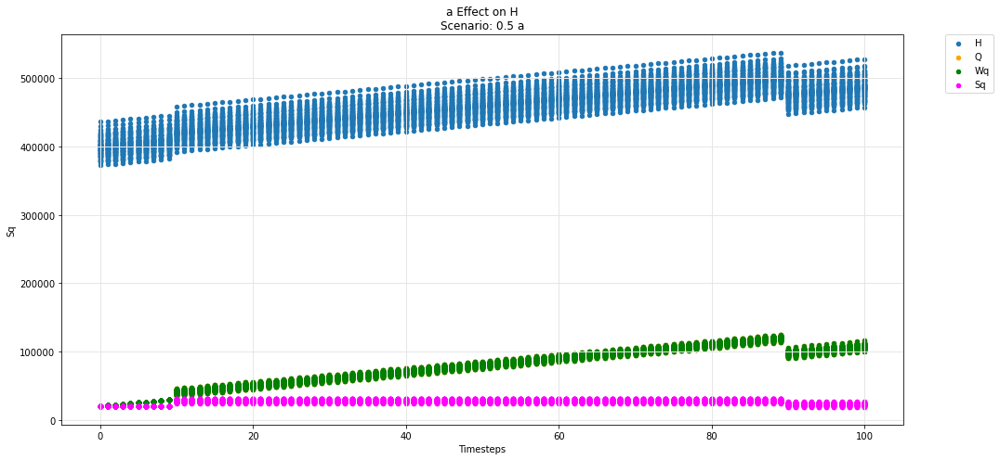

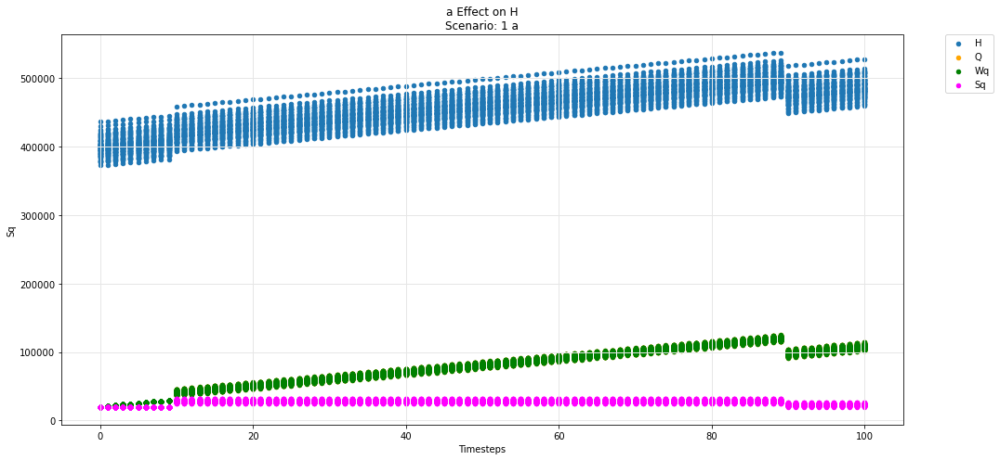

In [52]:
param_test_plot(experiments, config_ids, 'a', 'H', 'Q', 'Wq', 'Sq')

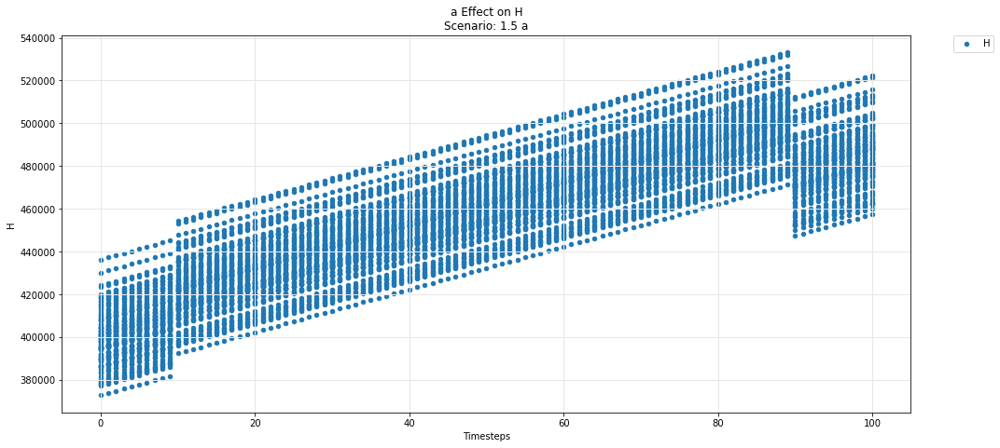

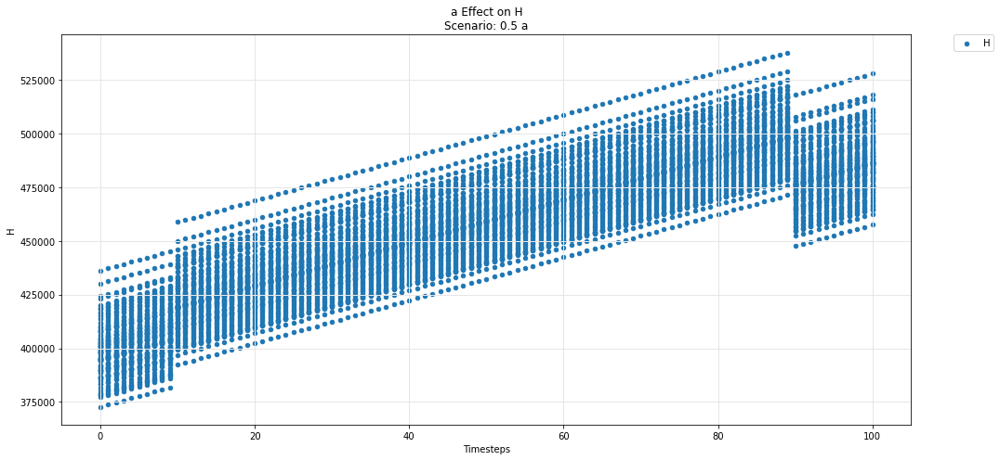

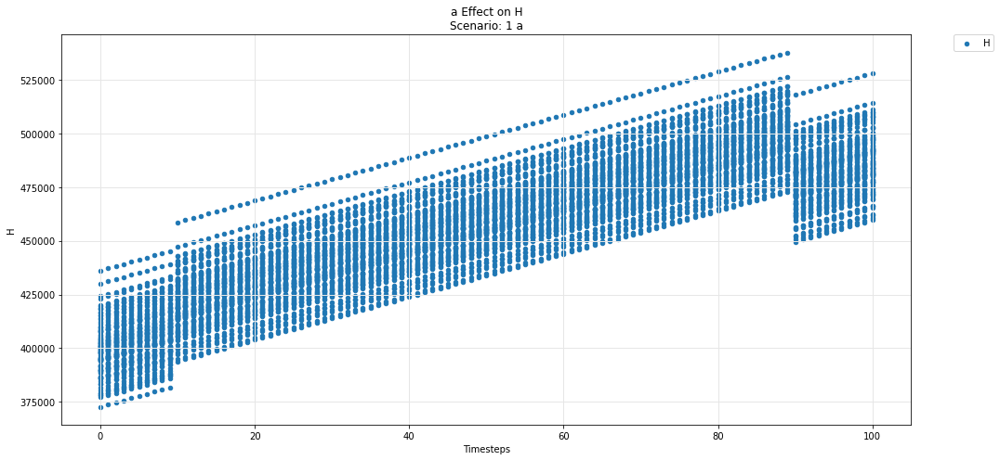

In [53]:
param_test_plot(experiments, config_ids, 'a', 'H')

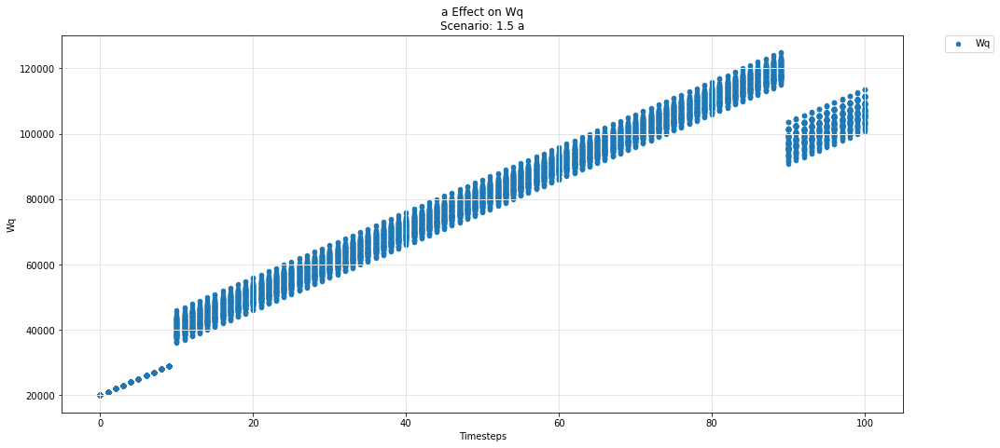

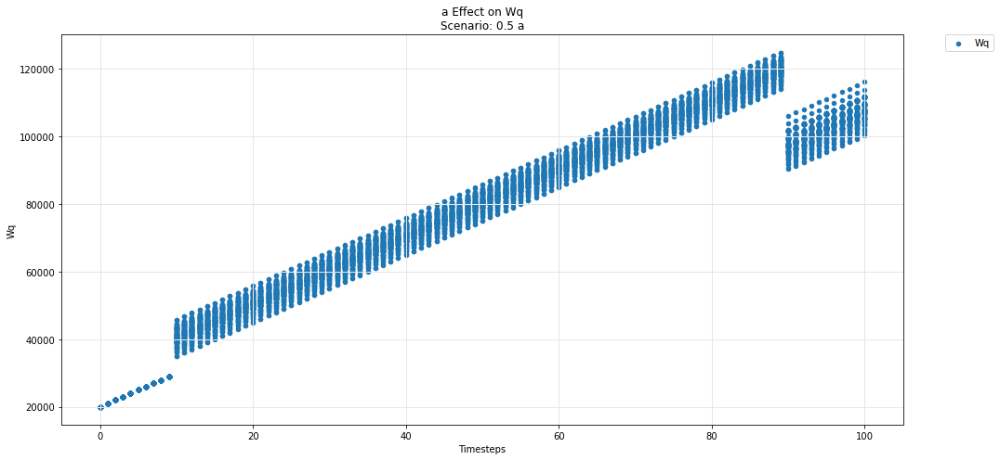

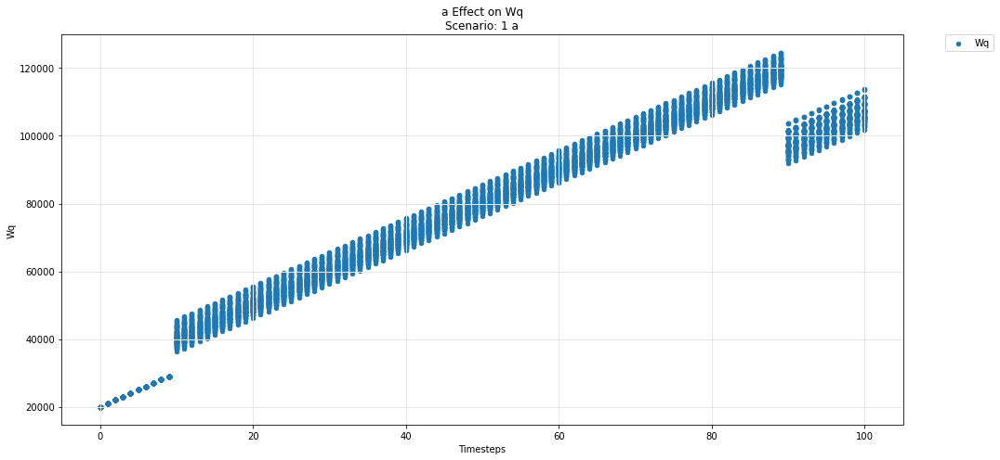

In [54]:
param_test_plot(experiments, config_ids, 'a', 'Wq')

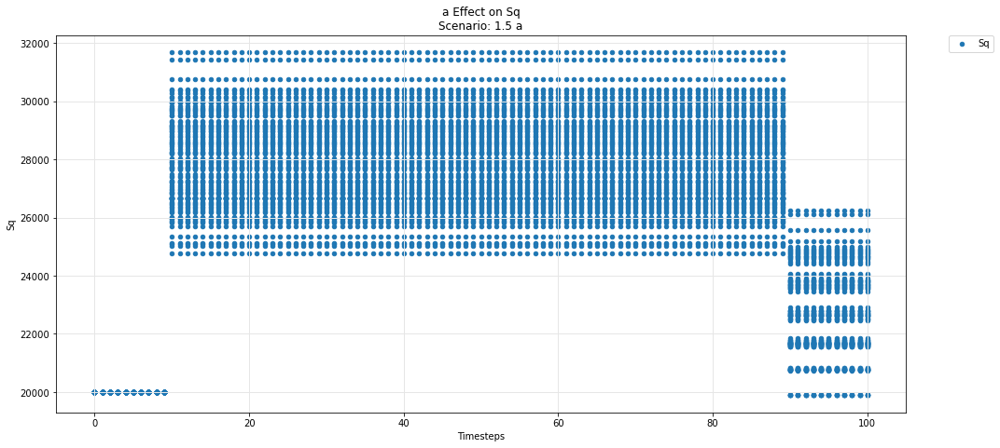

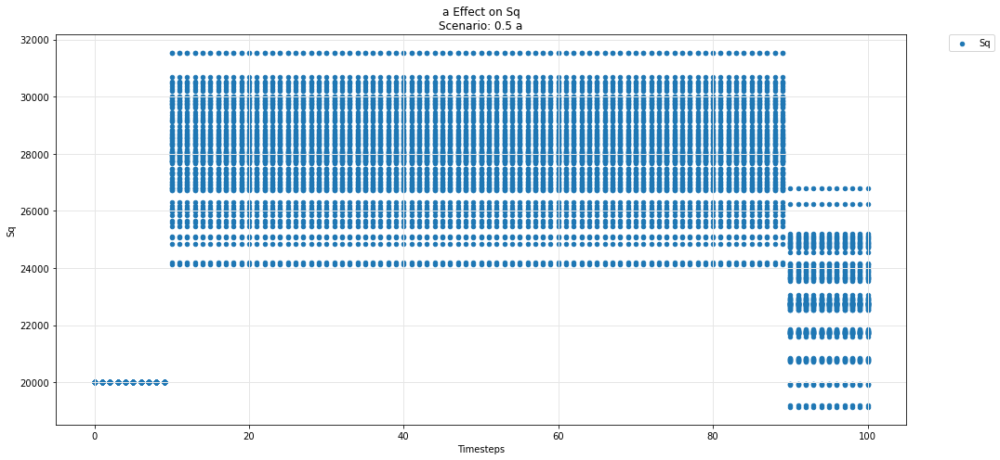

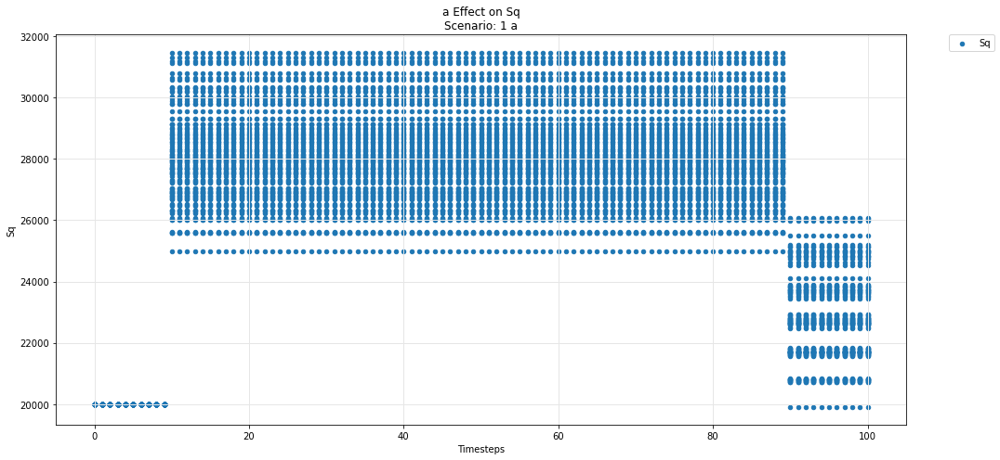

In [55]:
param_test_plot(experiments, config_ids, 'a', 'Sq')

## Hydra -- pool

Movement of the Omnipool variables
- Asset i
- Asset j
- Asset k

over the course of the simulation

In [56]:
def param_pool_simulation_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        df = df.groupby('timestep').agg({df_label: ['min', 'mean', 'max']}).reset_index()
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=(df_label,'mean'), label=df_label, ax=ax, legend=True, kind ='scatter')
        ax.fill_between(df.timestep, df[(df_label,'min')], df[(df_label,'max')], alpha=0.3)    
        for count, arg in enumerate(args):
            df = sub_experiments.copy()
            
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))
            df = df.groupby('timestep').agg({df_arg_label: ['min', 'mean', 'max']}).reset_index()

            df.plot(x='timestep', y=(df_arg_label,'mean'), label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')
            ax.fill_between(df.timestep, df[(df_arg_label,'min')], df[(df_arg_label,'max')], alpha=0.3)    

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

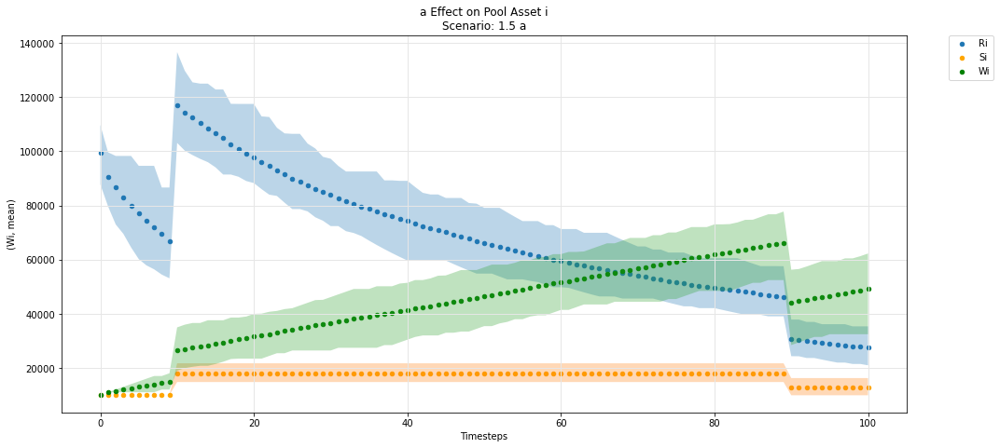

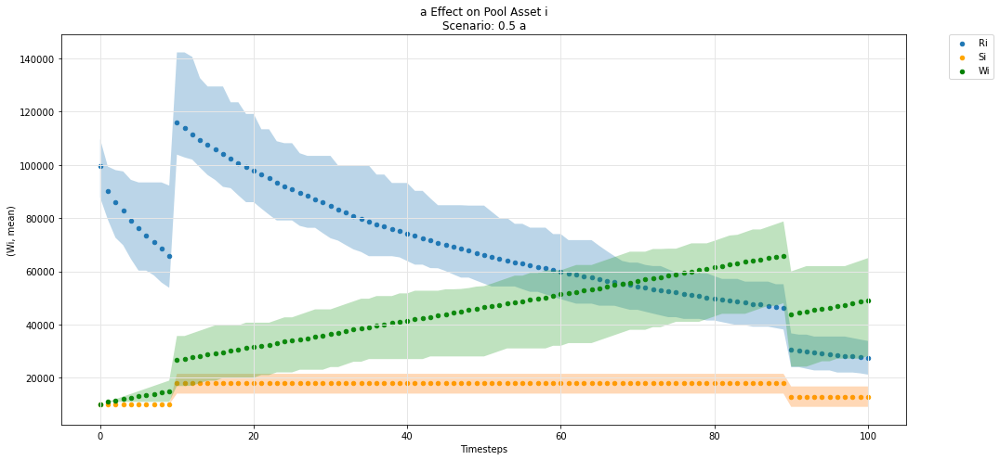

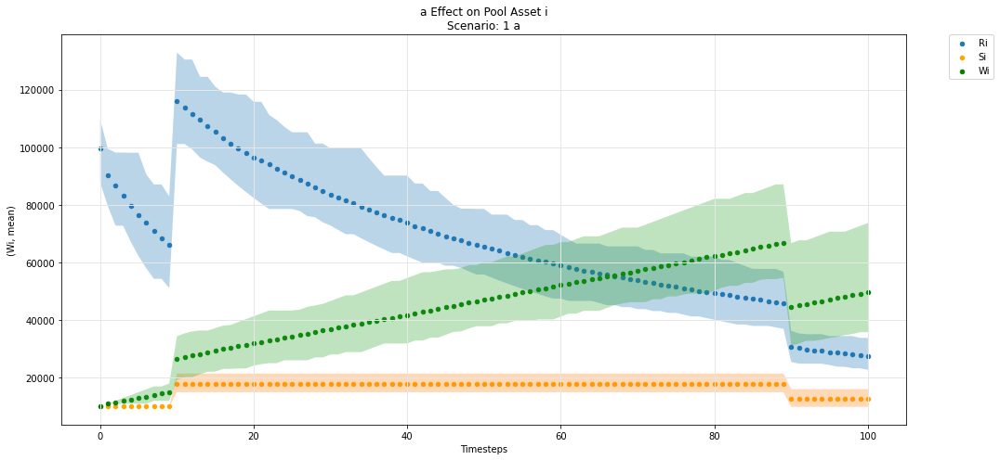

In [57]:
param_pool_simulation_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

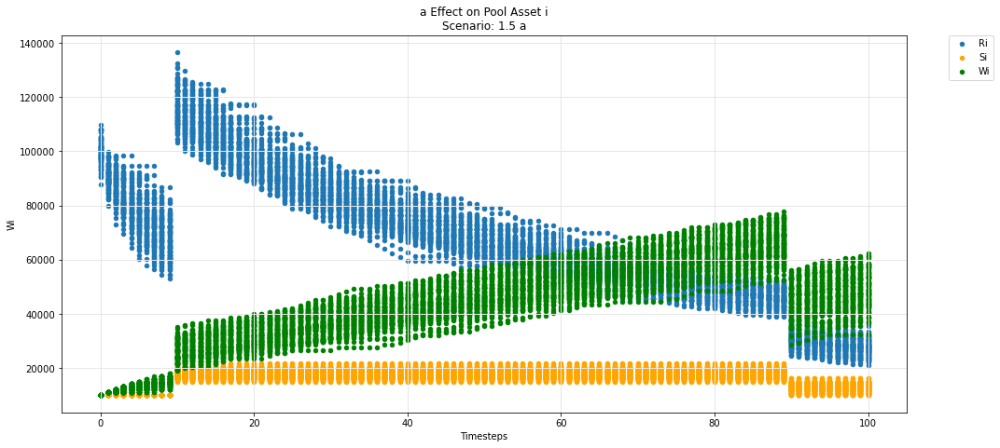

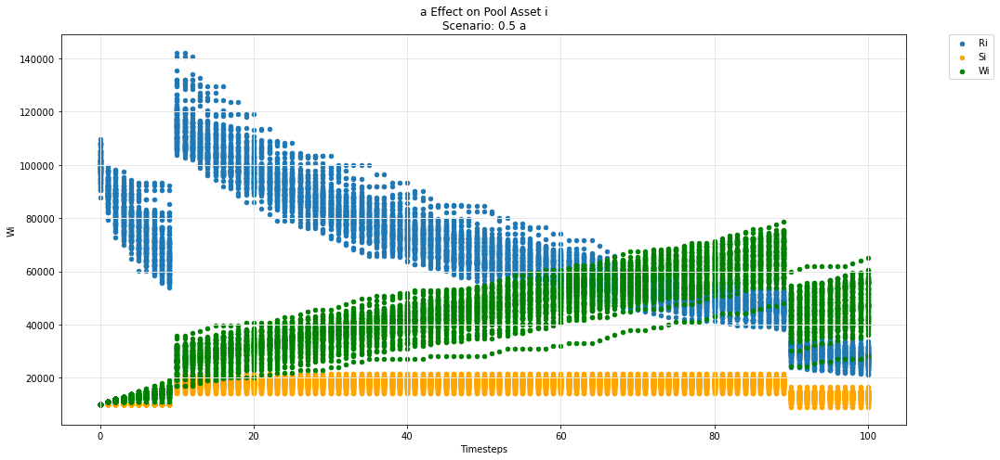

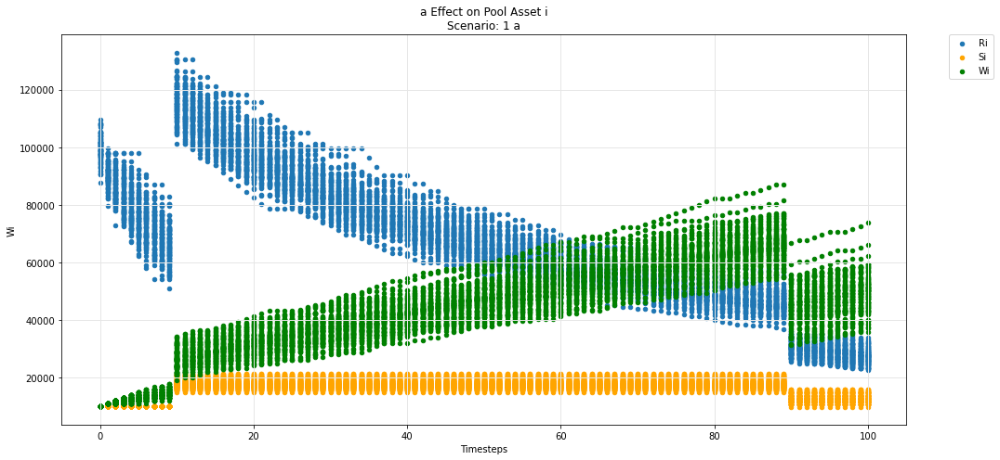

In [58]:
param_pool_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

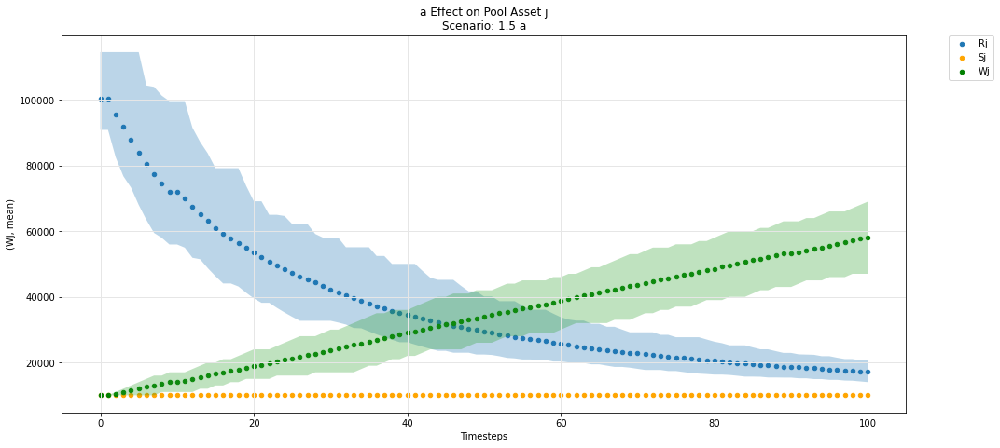

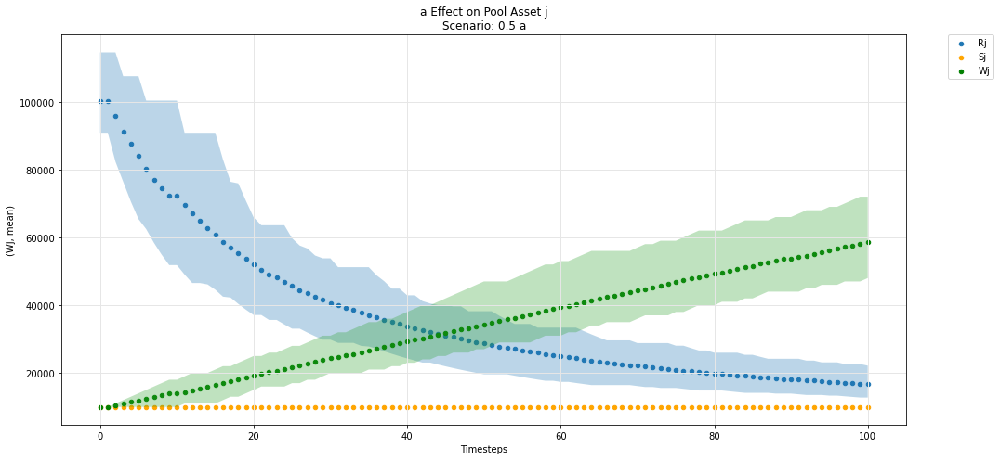

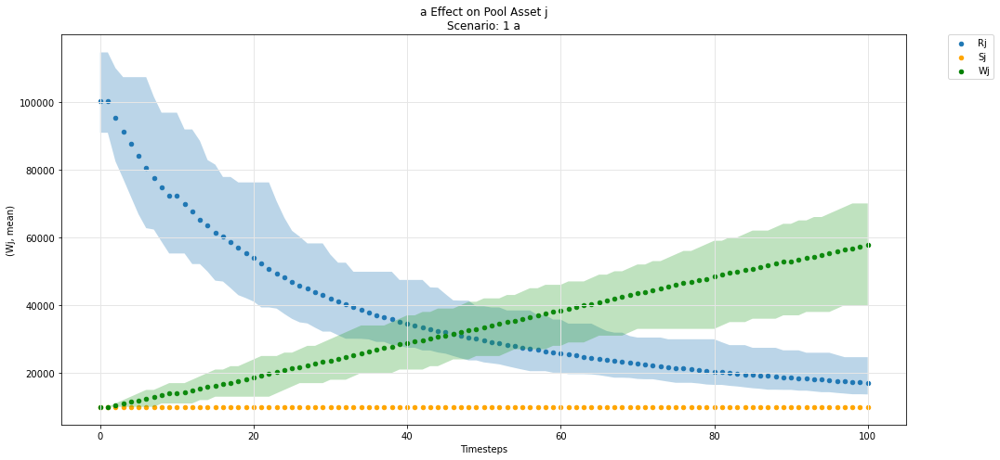

In [59]:
param_pool_simulation_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

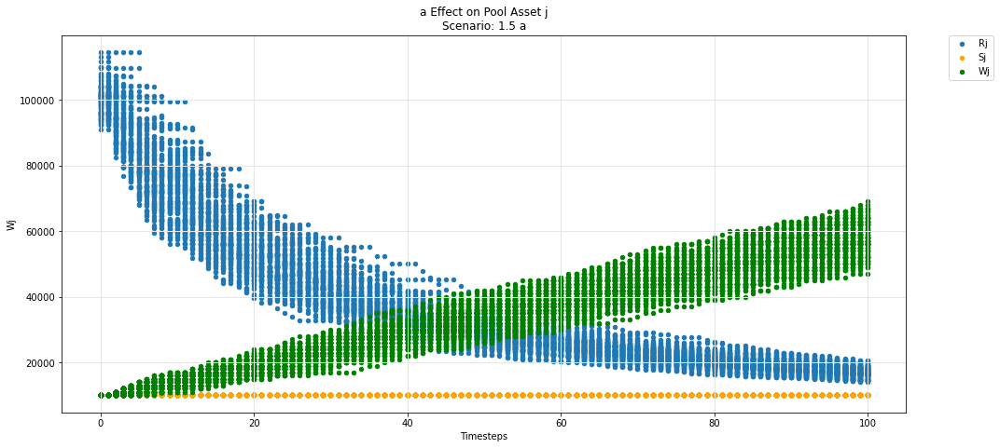

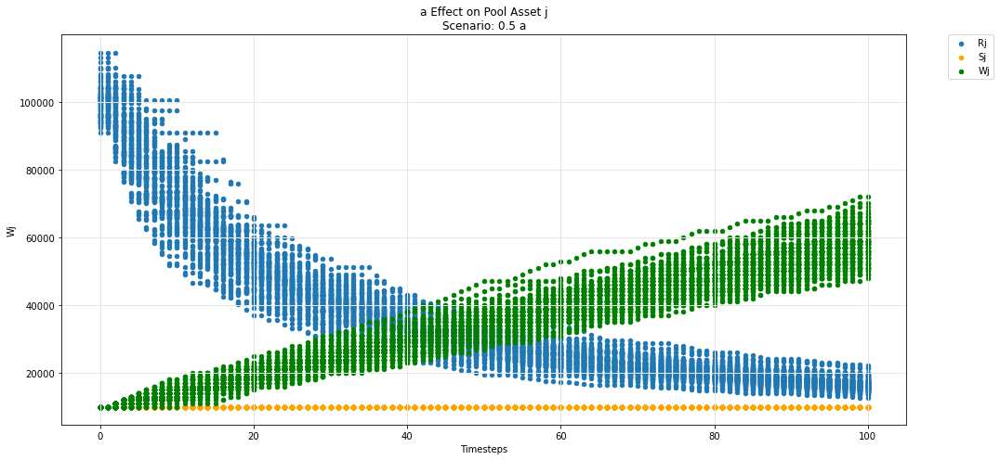

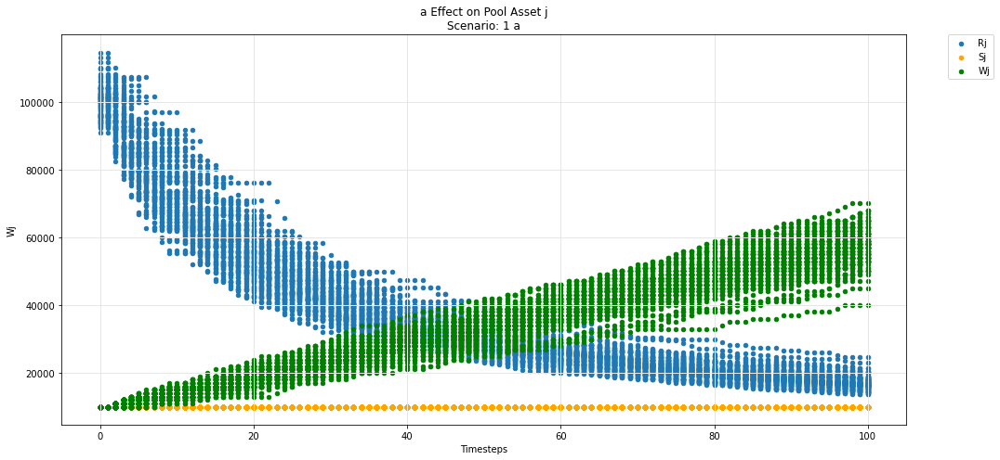

In [60]:
param_pool_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

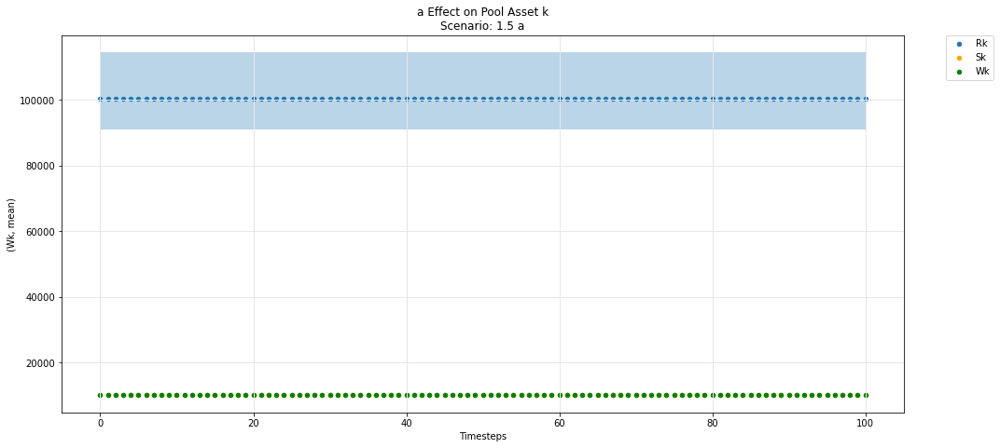

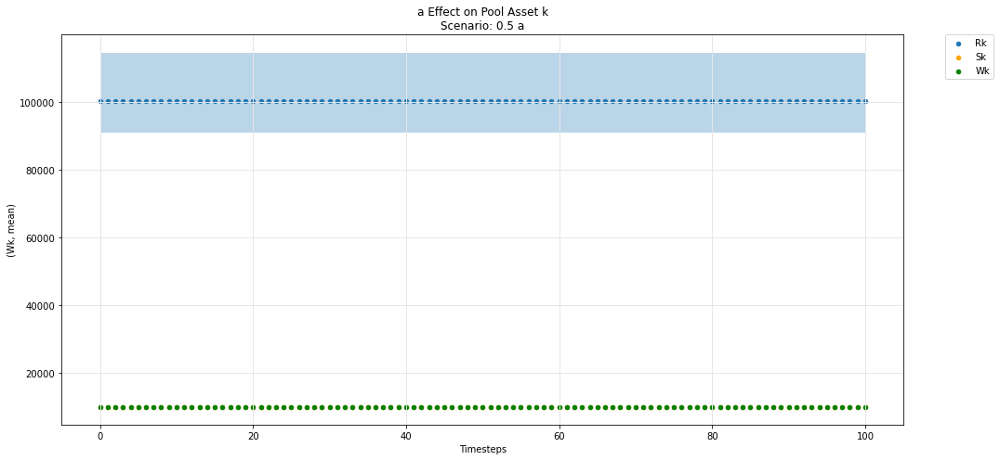

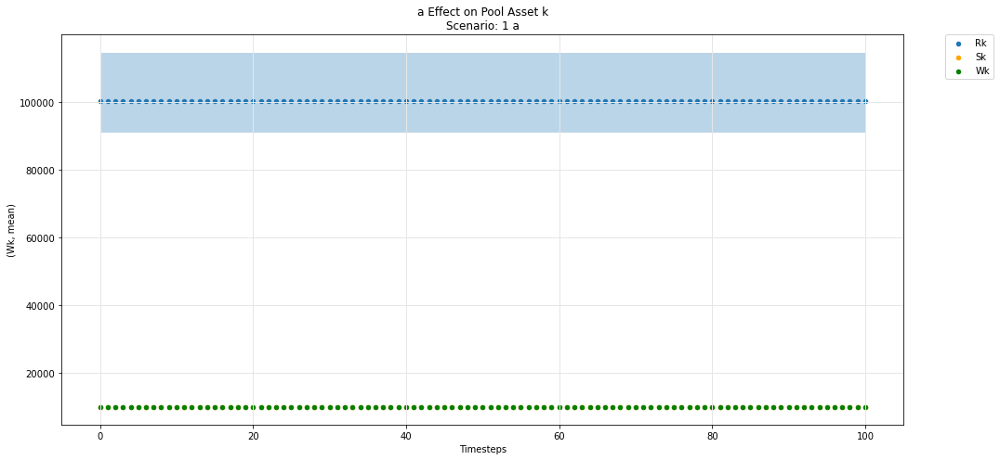

In [61]:
param_pool_simulation_plot(experiments, config_ids, 'a','k', 'R', 'S', 'W')

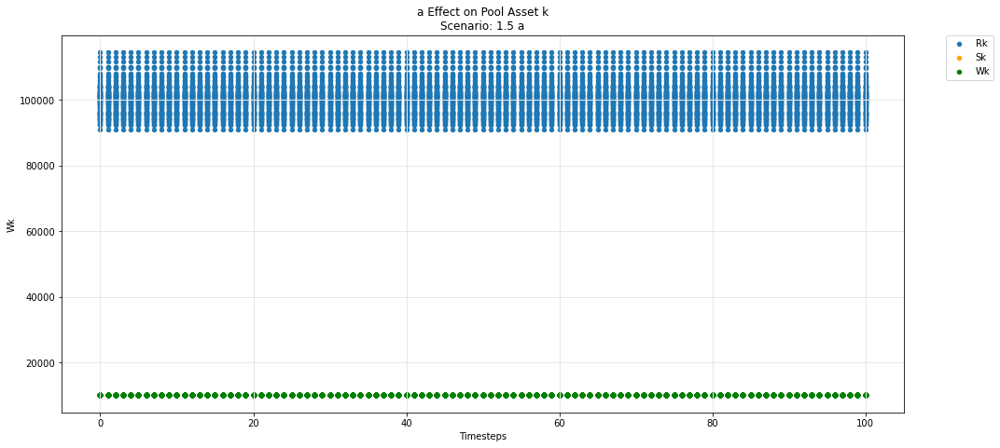

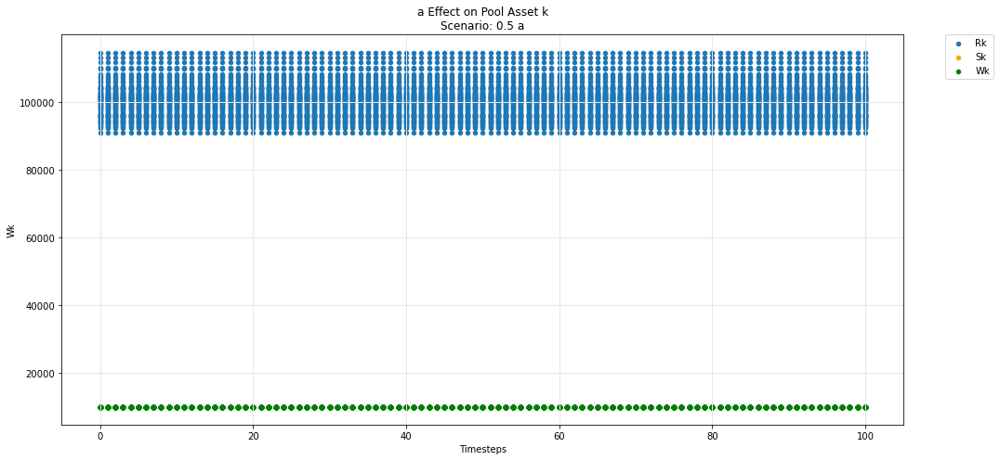

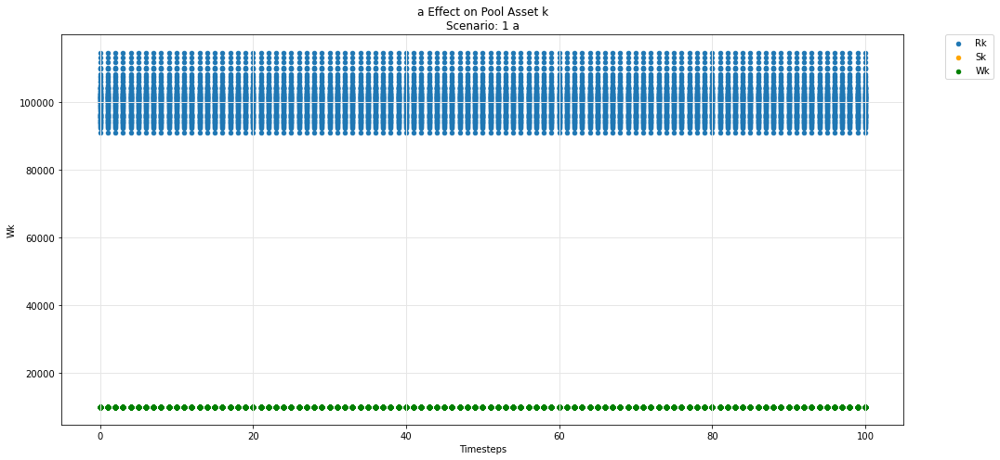

In [62]:
param_pool_plot(experiments, config_ids, 'a','k', 'R', 'S', 'W')

In [63]:
def param_pool_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=df_label, label=df_label, ax=ax, legend=True, kind ='scatter')

        for count, arg in enumerate(args):
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))

            df.plot(x='timestep', y=df_arg_label, label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

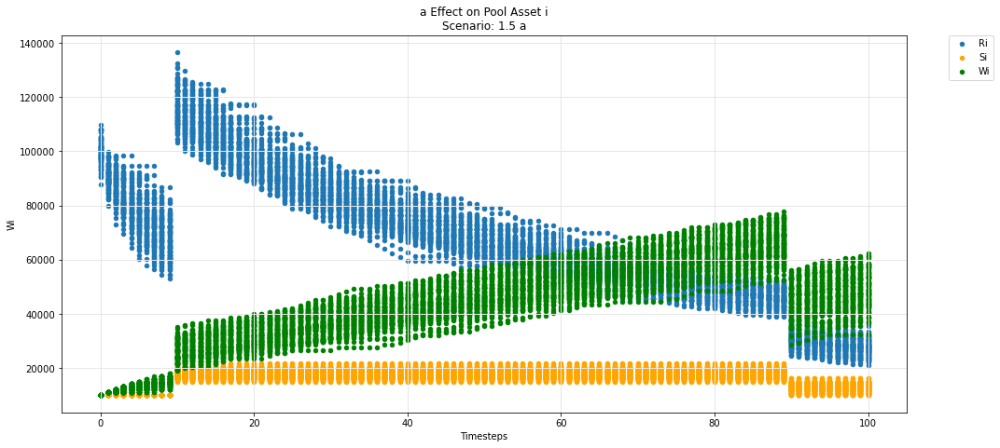

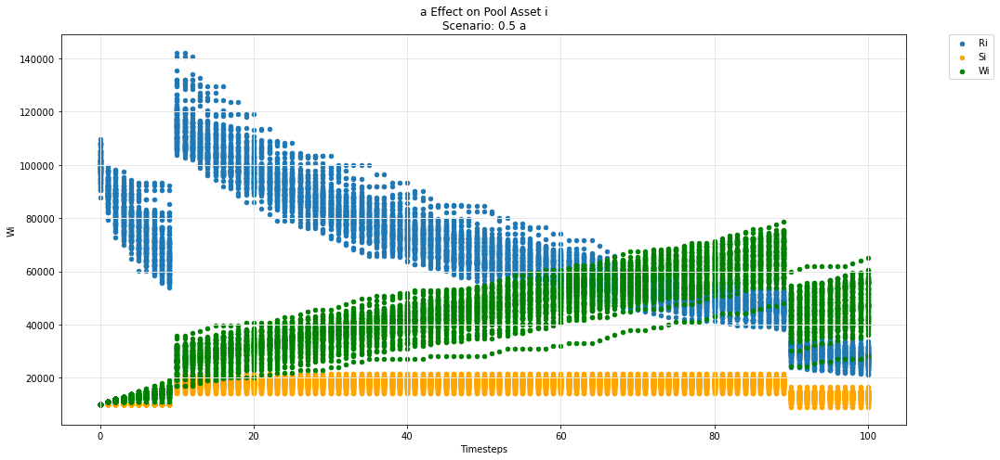

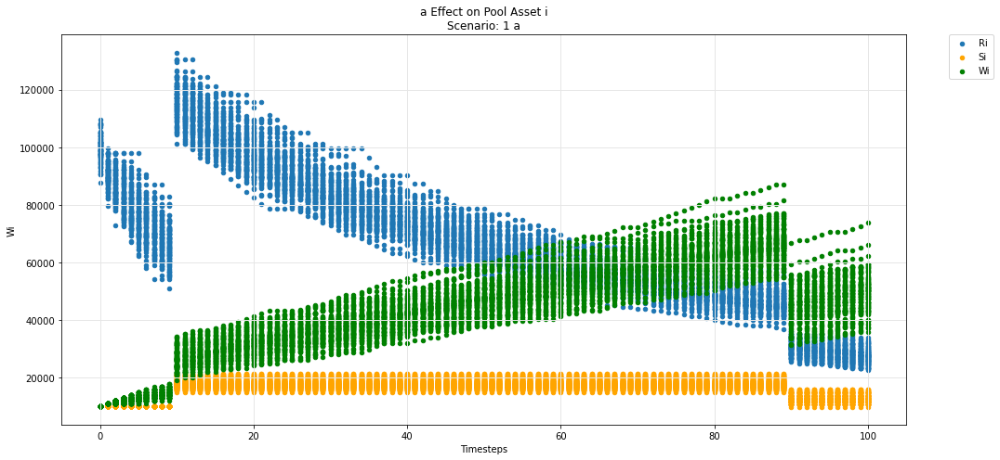

In [64]:
param_pool_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

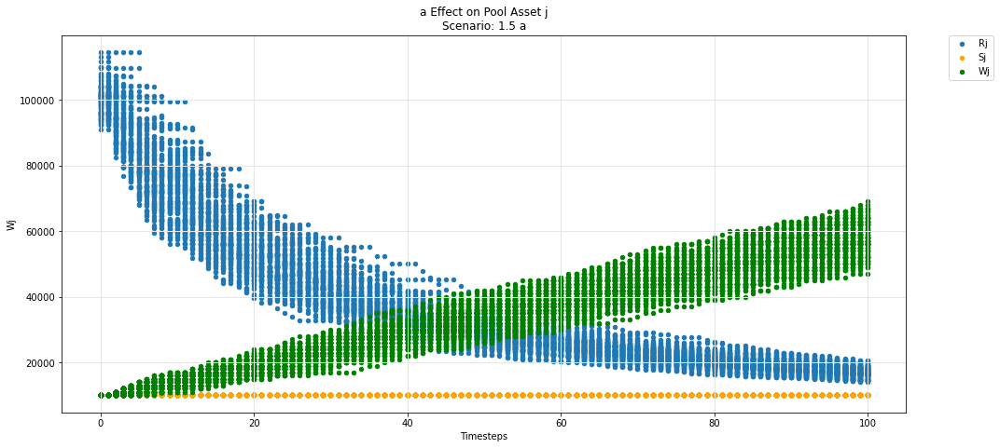

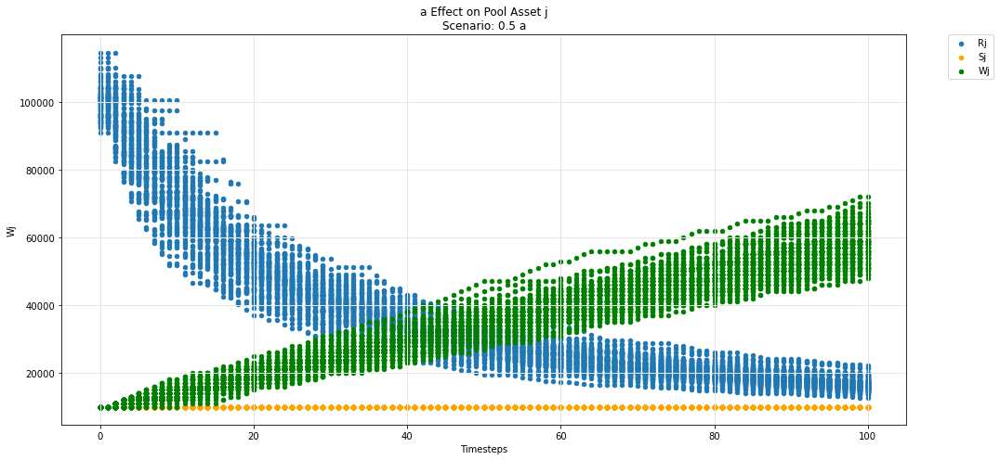

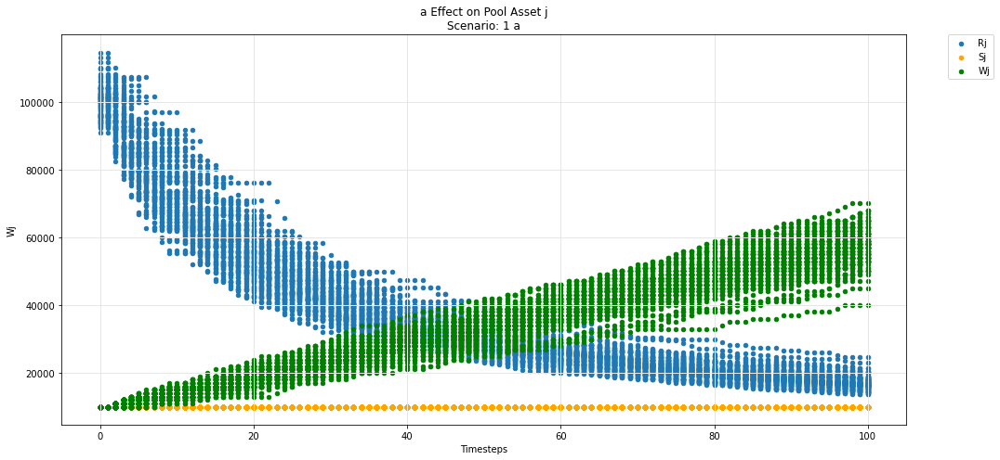

In [65]:
param_pool_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

In [66]:
def param_pool_simulation_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        df = df.groupby('timestep').agg({df_label: ['min', 'mean', 'max']}).reset_index()
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=(df_label,'mean'), label=df_label, ax=ax, legend=True, kind ='scatter')
        ax.fill_between(df.timestep, df[(df_label,'min')], df[(df_label,'max')], alpha=0.3)    
        for count, arg in enumerate(args):
            df = sub_experiments.copy()
            
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))
            df = df.groupby('timestep').agg({df_arg_label: ['min', 'mean', 'max']}).reset_index()

            df.plot(x='timestep', y=(df_arg_label,'mean'), label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')
            ax.fill_between(df.timestep, df[(df_arg_label,'min')], df[(df_arg_label,'max')], alpha=0.3)    

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

# Prices

## Uniswap

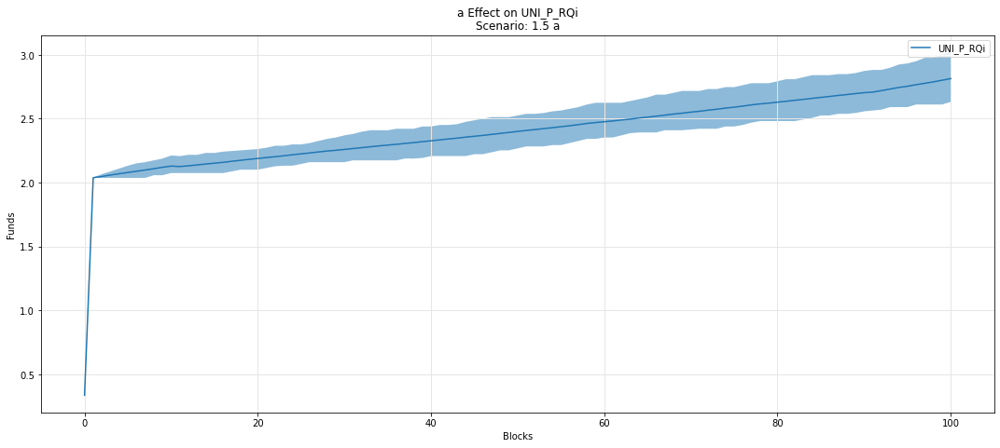

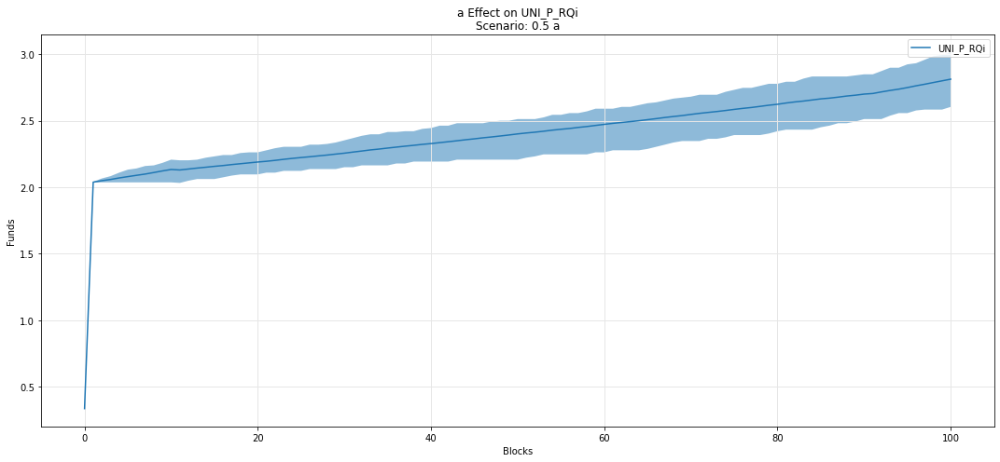

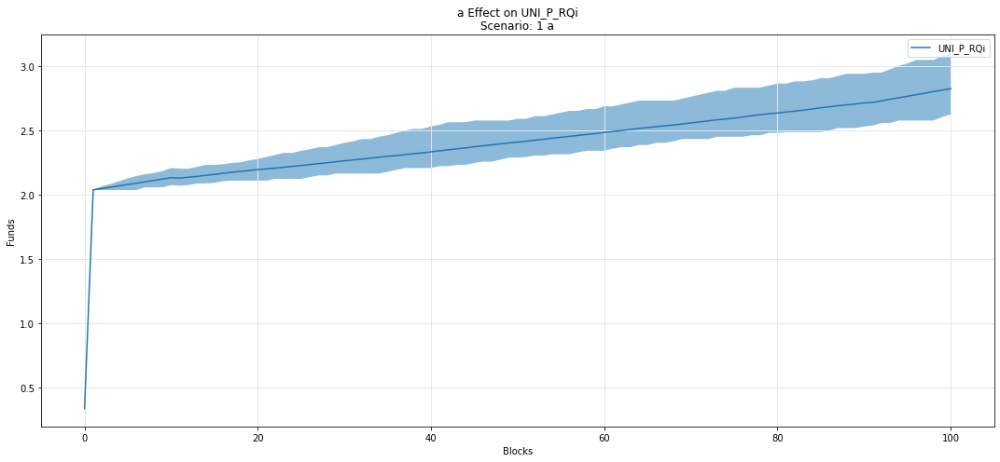

In [67]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_RQi')

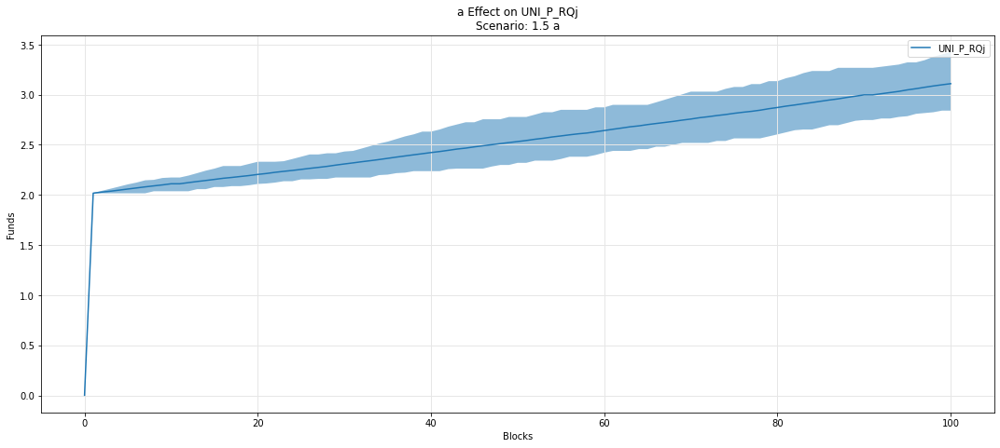

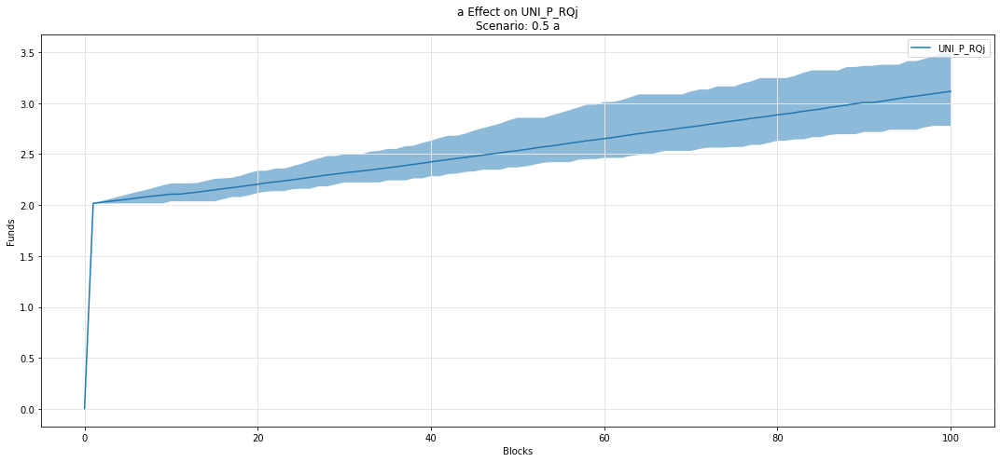

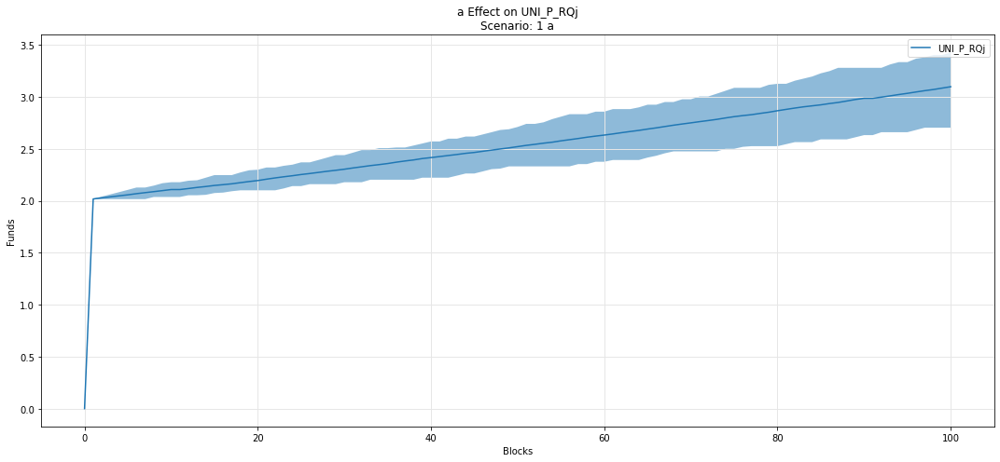

In [68]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_RQj')

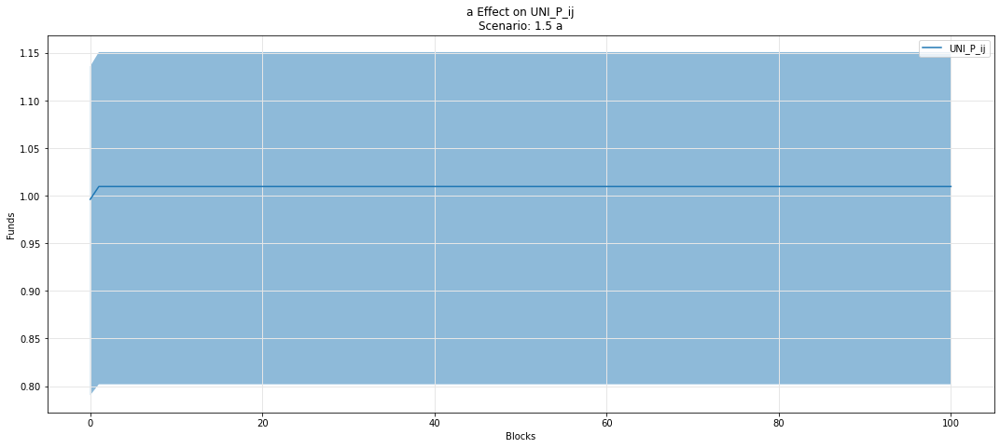

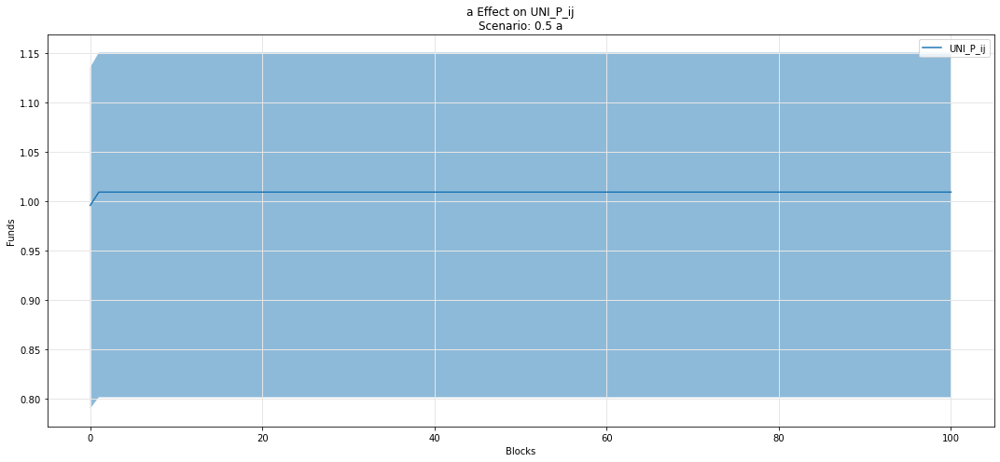

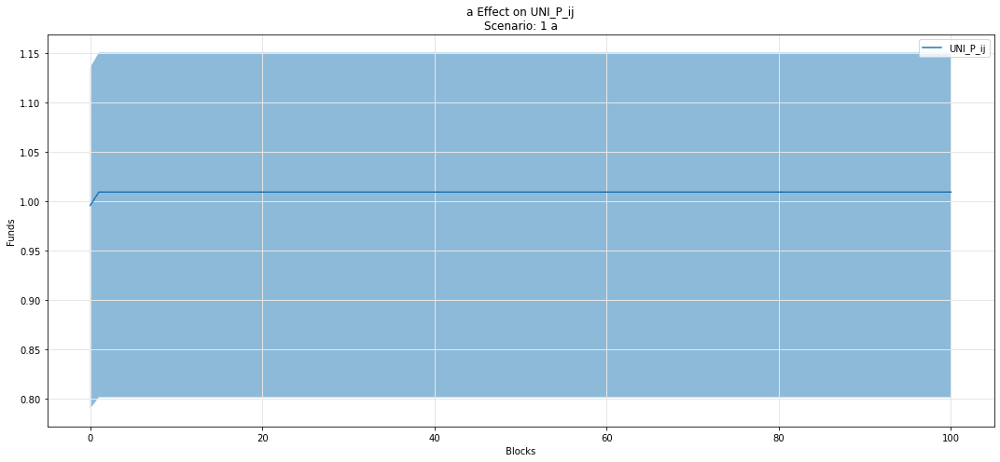

In [69]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_ij')

## Omnipool

## Asset i

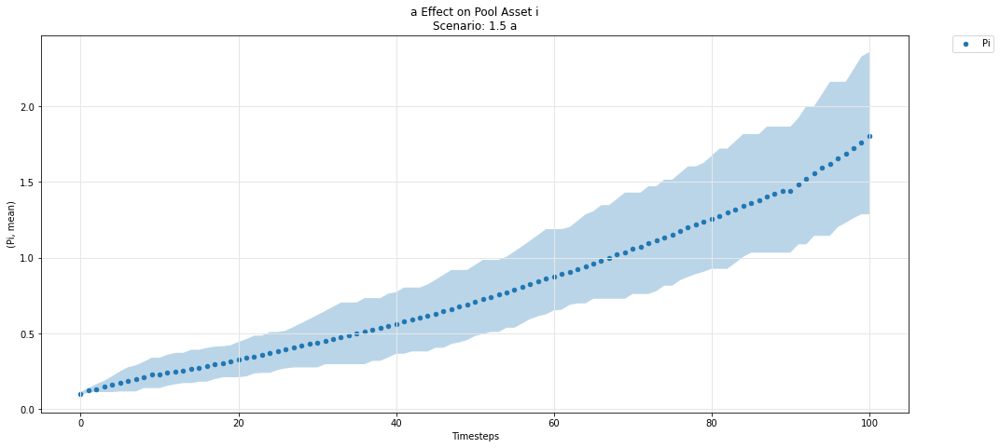

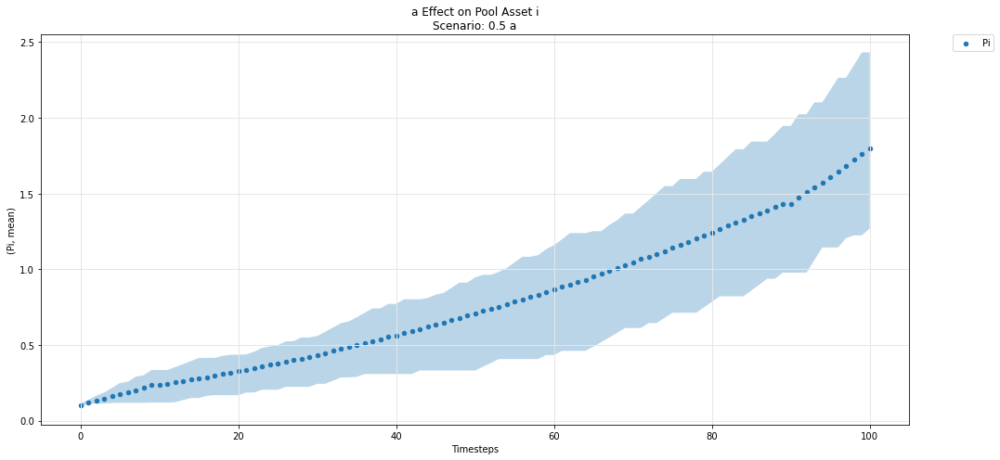

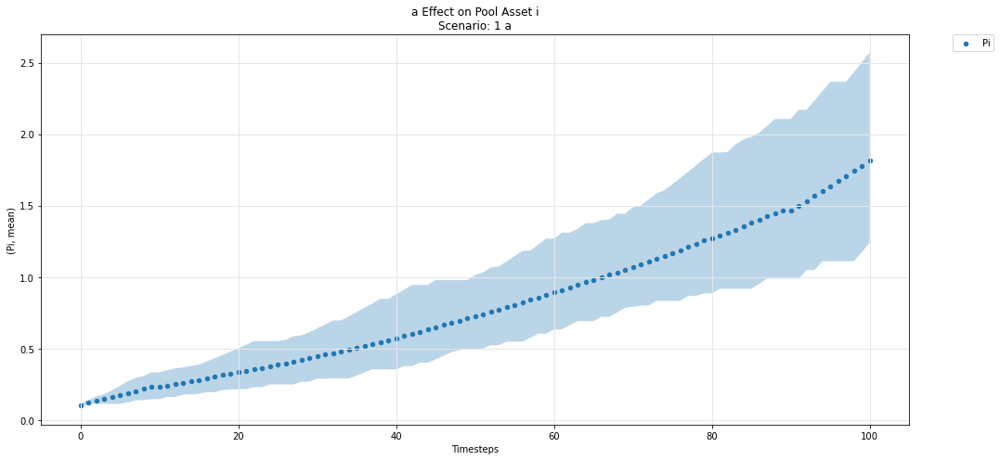

In [70]:
param_pool_simulation_plot(experiments, config_ids, 'a','i','P')

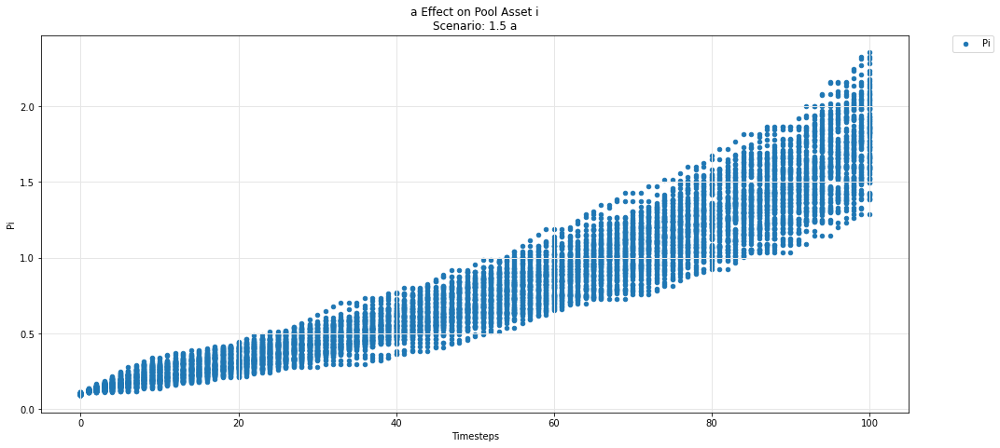

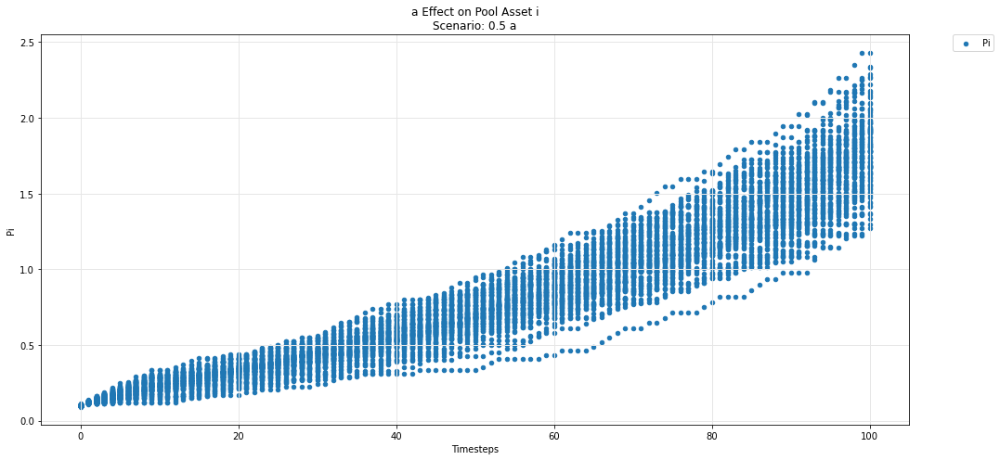

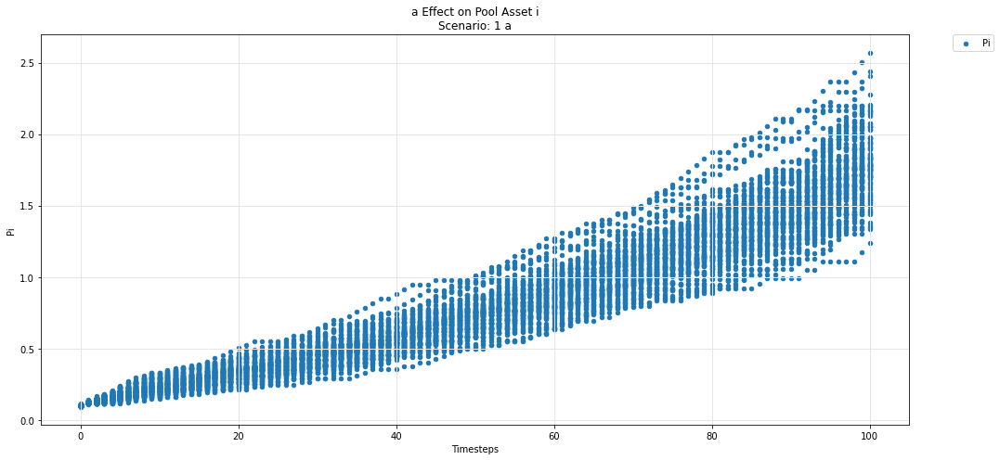

In [71]:
param_pool_plot(experiments, config_ids, 'a','i','P')

## Asset j

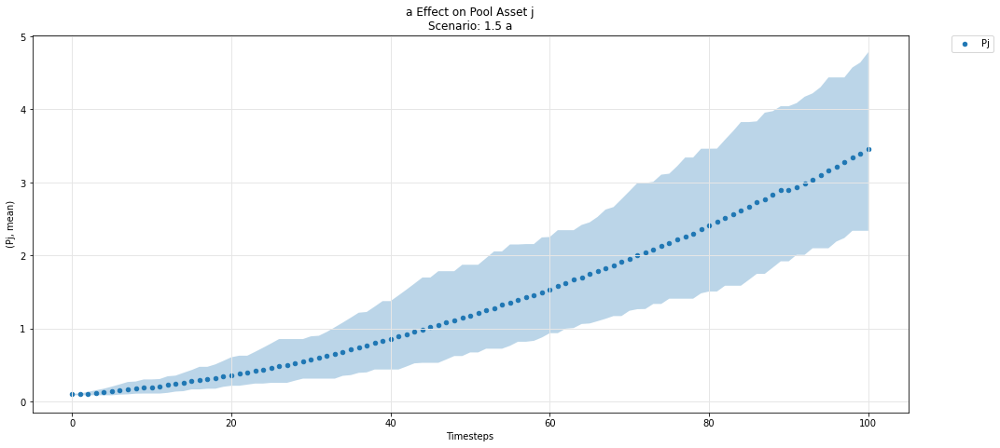

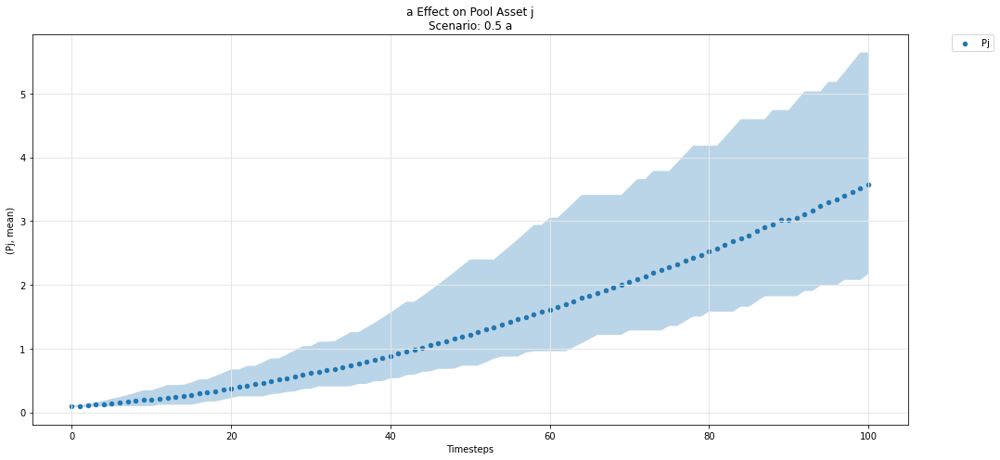

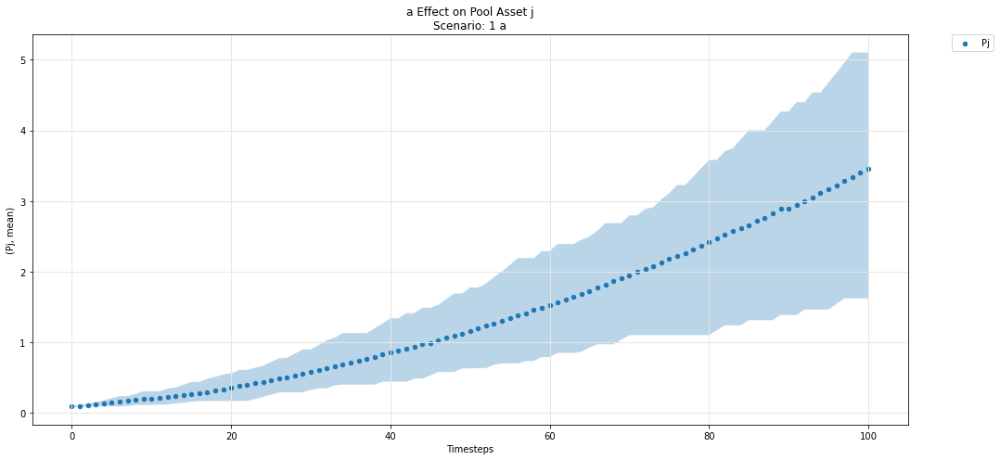

In [72]:
param_pool_simulation_plot(experiments, config_ids, 'a','j','P')

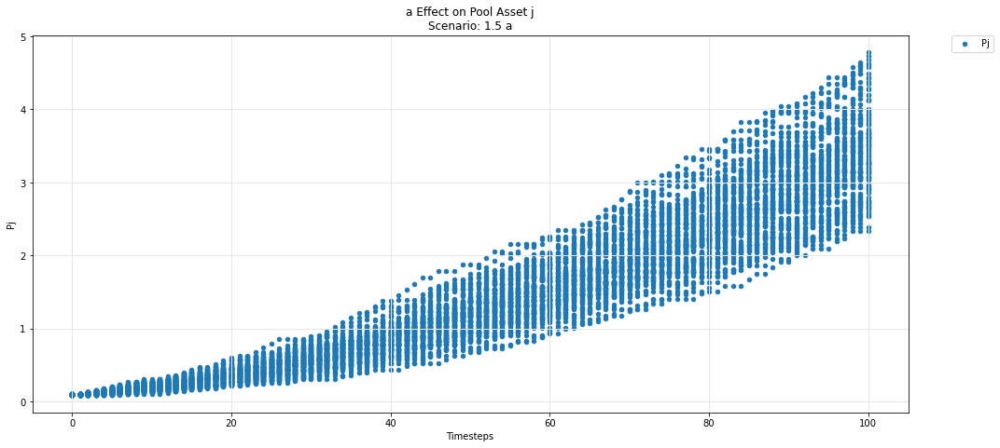

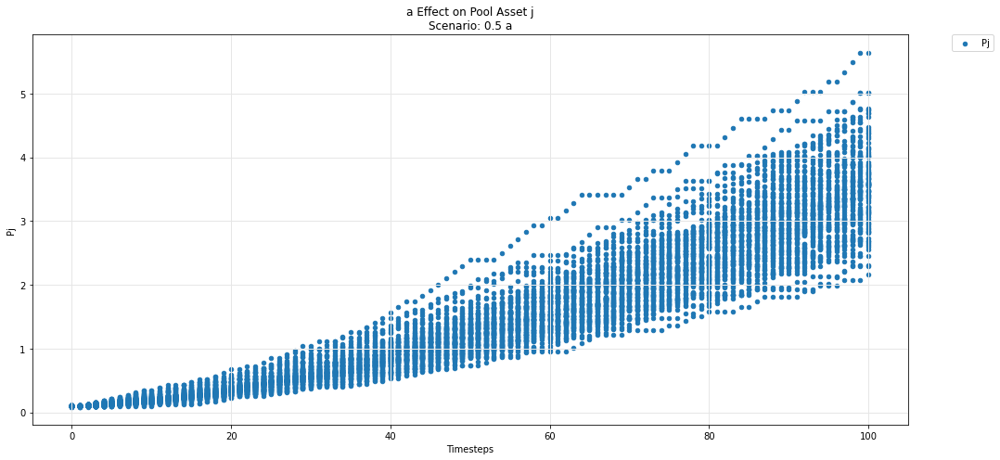

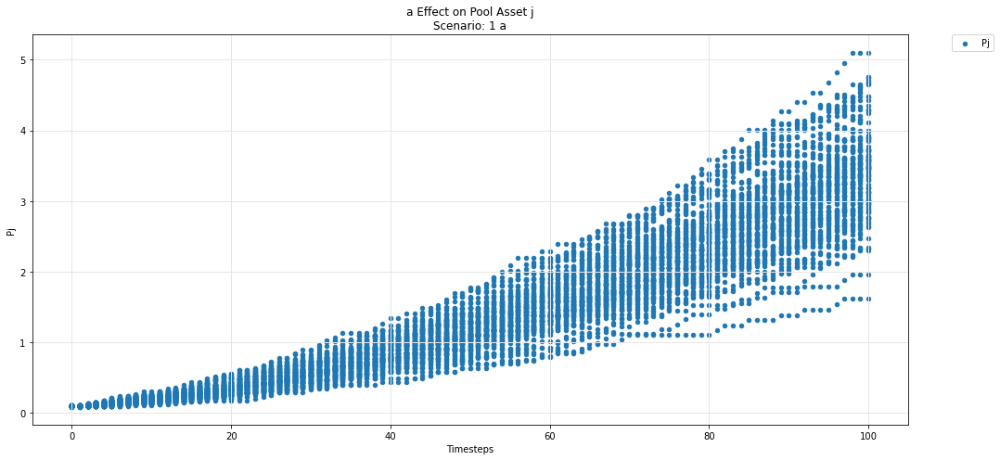

In [73]:
param_pool_plot(experiments, config_ids, 'a','j','P')

## Asset k

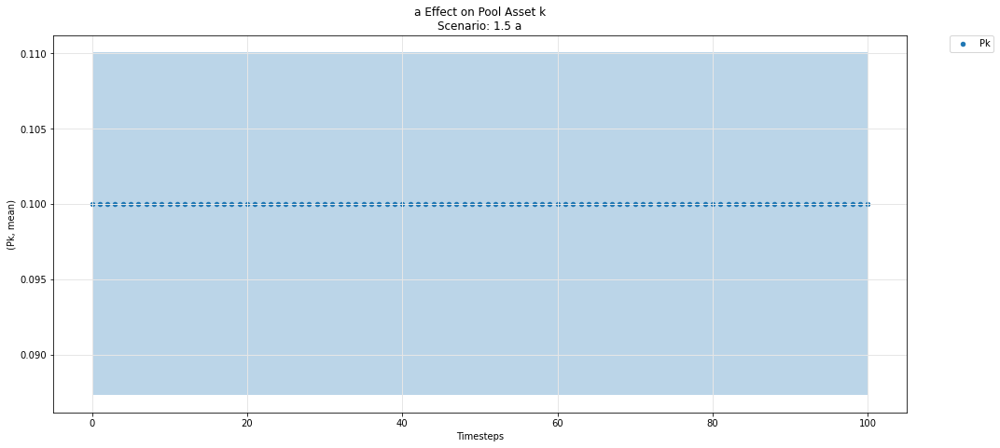

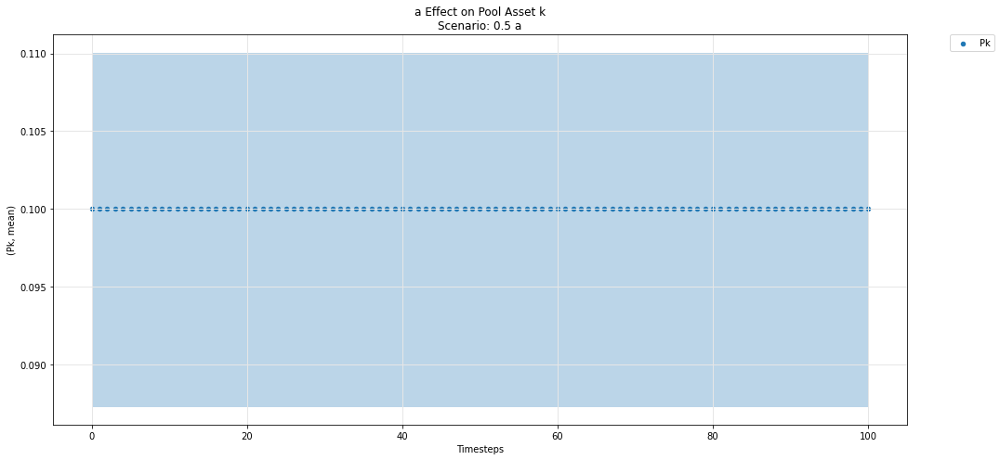

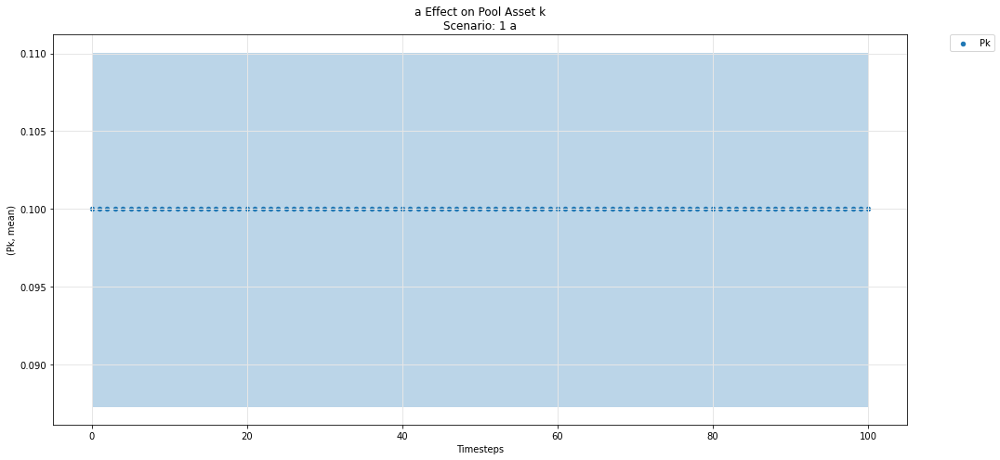

In [74]:
param_pool_simulation_plot(experiments, config_ids, 'a','k','P')

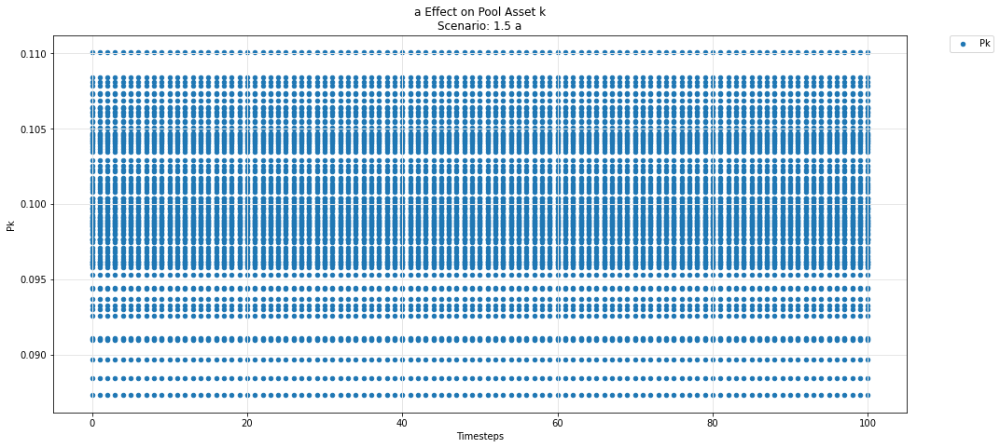

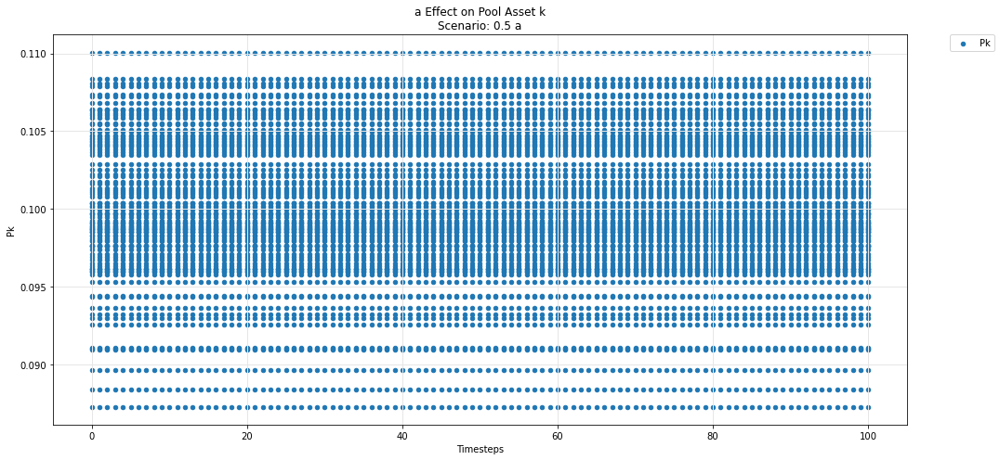

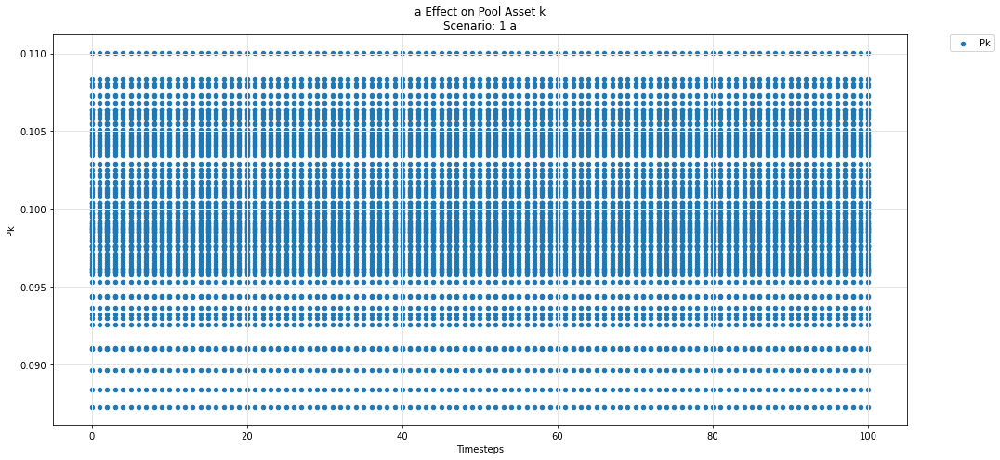

In [75]:
param_pool_plot(experiments, config_ids, 'a','k','P')